In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot
    
# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for temperature
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for temperature
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for temperature
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    #print("Agg:")
    agg.columns = names
    #print(type(agg))
    #print(agg)

    #print("Test columns:")
    #print(agg.iloc[:, -36]) # Column containing response actual values (temperature) at time t

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    print(n_vars)
    print(len(data))
    print(type(data))

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    #print("Diff values:")
    #print(len(diff_values))
    #print(len(diff_values[0]))
    #print(len(diff_values_for_training))
    #print(len(diff_values_for_training[0]))
    
    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    #diff_values_training = np.array(diff_values_for_training)
    #diff_values_training = diff_values_training.reshape(1, -1) 
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (temperatures) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    #print("Scaled values rows:")
    #print(len(scaled_values))

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        #print("Batch "+str(ws+1)+":")
        #print("Range: "+str(first)+"-"+str(last))
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
        #print("Supervised count:")
        #print(len(supervised_values))
        #print(len(supervised_values[0]))
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    print(n_vars)
    print(len(data))
    print(type(data))

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    #print("Diff values:")
    #print(len(diff_values))
    #print(len(diff_values[0]))
    #print(len(diff_values_for_training))
    #print(len(diff_values_for_training[0]))
    
    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        #print("Batch "+str(ws+1)+":")
        #print("Range: "+str(first)+"-"+str(last))
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
        #print("Supervised count:")
        #print(len(supervised_values))
        #print(len(supervised_values[0]))
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)
    
X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    #new_df = new_df.iloc[:180, :]
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['temperatures'].iloc[j])
    y.append(add_to_y)
    #new_df = new_df.drop(['temperatures'], axis=1)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
    #print("Train_X Fold "+str(i)+":")
    #print(len(train_X[i]))
    #print(len(train_X[i][0]))
    #print(len(train_X[i][0][0])) 
    #print("Train_y Fold "+str(i)+":")
    #print(len(train_y[i]))
    #print(len(train_y[i][0]))
    #print(train_y[i][0][0])
    #print("Validation_X Fold "+str(i)+":")
    #print(len(val_X[i]))
    #print(len(val_X[i][0]))
    #print(len(val_X[i][0][0]))
    #print("Validation_y Fold "+str(i)+":")
    #print(len(val_y[i]))
    #print(len(val_y[i][0]))
    #print(val_y[i][0][0])
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df)
     

    #print(len(dataset))
    #print(len(dataset[0]))
    #print(len(dataset_scaling))
    #print(len(dataset_scaling[:][0]))
    #print("Stop")
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['temperatures']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['temperatures']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + 12*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
    #X_train = train1[:][:-n_seq]
    #y_train = train1[:][-n_seq:]
    #X_test = test1[:][:-n_seq]
    #y_test = test1[:][-n_seq:]


Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
Fold 1
Fold 2
Fold 3
Fold 4
Fold 5
Fold 1:
12
84
<class 'list'>
12
21
<class 'list'>
(84, 1, 1, 2040)
(11, 1, 1, 2040)
(10, 1, 1, 2040)
(84, 1, 2040)
(11, 1, 2040)
(10, 1, 2040)
(84, 2040)
(11, 2040)
(10, 2040)
[[0.39307412 0.69695044 0.32924264 ... 0.45808019 0.42952612 0.37788578]
 [0.45747266 0.51683609 0.42215989 ... 0.49422843 0.47691373 0.38882139]
 [0.38487242 0.62674714 0.3411641  ... 0.51032807 0.38244228 0.37363305]
 ...
 [0.54100851 0.46473952 0.46949509 ... 0.48025516 0.45504253 0.40583232]
 [0.44896719 0.51620076 0.3997195  ... 0.49696233 0.45170109 0.39611179]
 [0.46780073 0.52414231 0.42356241 ... 0.49301337 0.4881531  0.43772783]]
Fold 2:
12
84
<class 'list'>
12
21
<class 'list'>
(84, 1, 1, 2040)
(11, 1, 1, 2040)
(10, 1, 1, 2040)
(84, 1, 2040)
(11, 1, 2040)
(10, 1, 2040)
(84, 2040)
(11, 2040)
(10, 2040)
[[0.38166311 0.

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 2040)
(11, 2040)


[I 2025-05-18 16:23:06,047] A new study created in memory with name: no-name-ac3df8a7-0fb3-43b7-b910-98d23076524d
[I 2025-05-18 16:27:03,139] Trial 0 finished with value: 0.5060068368911743 and parameters: {'lr': 0.29698174272055783, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.31780389114660235}. Best is trial 0 with value: 0.5060068368911743.


Cross Validation Accuracies:
[0.49511605501174927, 0.6201498508453369, 0.41846200823783875, 0.6492351293563843, 0.3470711410045624]
Mean Cross Validation Accuracy:
0.5060068368911743
Standard Deviation of Cross Validation Accuracy:
0.11540037519686716


[I 2025-05-18 16:30:51,575] Trial 1 finished with value: 0.09516151249408722 and parameters: {'lr': 0.014408806903418623, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.27970674126273687}. Best is trial 1 with value: 0.09516151249408722.


Cross Validation Accuracies:
[0.08902981132268906, 0.10314986854791641, 0.08787543326616287, 0.09257730841636658, 0.10317514091730118]
Mean Cross Validation Accuracy:
0.09516151249408722
Standard Deviation of Cross Validation Accuracy:
0.006714088075596214


[I 2025-05-18 16:35:34,501] Trial 2 finished with value: 0.05120259001851082 and parameters: {'lr': 0.013948192237791243, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.26131834248266084}. Best is trial 2 with value: 0.05120259001851082.


Cross Validation Accuracies:
[0.042854923754930496, 0.04557938873767853, 0.056579384952783585, 0.06261538714170456, 0.048383865505456924]
Mean Cross Validation Accuracy:
0.05120259001851082
Standard Deviation of Cross Validation Accuracy:
0.007326813693738397


[I 2025-05-18 16:39:07,386] Trial 3 finished with value: 0.15685375928878784 and parameters: {'lr': 0.0030713017275097046, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4084100067306007}. Best is trial 2 with value: 0.05120259001851082.


Cross Validation Accuracies:
[0.18653105199337006, 0.14725950360298157, 0.1697692722082138, 0.12897655367851257, 0.1517324149608612]
Mean Cross Validation Accuracy:
0.15685375928878784
Standard Deviation of Cross Validation Accuracy:
0.019712781025378854


[I 2025-05-18 16:43:01,335] Trial 4 finished with value: 0.06099615097045898 and parameters: {'lr': 0.03349523209513895, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.16281084571279902}. Best is trial 2 with value: 0.05120259001851082.


Cross Validation Accuracies:
[0.04556339979171753, 0.07825231552124023, 0.05568418279290199, 0.06982030719518661, 0.05566054955124855]
Mean Cross Validation Accuracy:
0.06099615097045898
Standard Deviation of Cross Validation Accuracy:
0.011580124398736336


[I 2025-05-18 16:50:14,336] Trial 5 finished with value: 17.81078758239746 and parameters: {'lr': 0.1932509916120153, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.3390576290742664}. Best is trial 2 with value: 0.05120259001851082.


Cross Validation Accuracies:
[16.146427154541016, 16.648284912109375, 17.80168342590332, 19.007369995117188, 19.450172424316406]
Mean Cross Validation Accuracy:
17.81078758239746
Standard Deviation of Cross Validation Accuracy:
1.2838211018869146


[I 2025-05-18 16:55:48,528] Trial 6 finished with value: 0.32445245385169985 and parameters: {'lr': 0.17343645647495137, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.16647972054399568}. Best is trial 2 with value: 0.05120259001851082.


Cross Validation Accuracies:
[0.33255502581596375, 0.25240468978881836, 0.3324074447154999, 0.27985355257987976, 0.4250415563583374]
Mean Cross Validation Accuracy:
0.32445245385169985
Standard Deviation of Cross Validation Accuracy:
0.05903734986647732


[I 2025-05-18 17:02:30,462] Trial 7 finished with value: 0.06206820383667946 and parameters: {'lr': 0.0030268843589711107, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.18913646351791505}. Best is trial 2 with value: 0.05120259001851082.


Cross Validation Accuracies:
[0.05151995271444321, 0.055699750781059265, 0.07033677399158478, 0.0749289020895958, 0.05785563960671425]
Mean Cross Validation Accuracy:
0.06206820383667946
Standard Deviation of Cross Validation Accuracy:
0.008981484347368592


[I 2025-05-18 17:06:49,479] Trial 8 finished with value: 2.110949087142944 and parameters: {'lr': 0.1825251466617383, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.1680497930900442}. Best is trial 2 with value: 0.05120259001851082.


Cross Validation Accuracies:
[2.4176864624023438, 2.3084030151367188, 1.8812508583068848, 1.929060459136963, 2.0183446407318115]
Mean Cross Validation Accuracy:
2.110949087142944
Standard Deviation of Cross Validation Accuracy:
0.2133055104232564


[I 2025-05-18 17:12:20,792] Trial 9 finished with value: 0.2333028256893158 and parameters: {'lr': 0.046984255323140364, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.35356112717638477}. Best is trial 2 with value: 0.05120259001851082.


Cross Validation Accuracies:
[0.22767725586891174, 0.18928135931491852, 0.27025270462036133, 0.22872374951839447, 0.2505790591239929]
Mean Cross Validation Accuracy:
0.2333028256893158
Standard Deviation of Cross Validation Accuracy:
0.027034297737666163


[I 2025-05-18 17:15:50,809] Trial 10 finished with value: 0.050633519887924194 and parameters: {'lr': 0.9980624671028815, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.49642884101317575}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04076169803738594, 0.04463436082005501, 0.05510783568024635, 0.06243911758065224, 0.05022458732128143]
Mean Cross Validation Accuracy:
0.050633519887924194
Standard Deviation of Cross Validation Accuracy:
0.007655085116527337


[I 2025-05-18 17:19:09,990] Trial 11 finished with value: 0.05115214958786964 and parameters: {'lr': 0.9000925852865834, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.48531285855512724}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04125293716788292, 0.04493257403373718, 0.05781799927353859, 0.06283874809741974, 0.04891848936676979]
Mean Cross Validation Accuracy:
0.05115214958786964
Standard Deviation of Cross Validation Accuracy:
0.008033391579504346


[I 2025-05-18 17:22:18,276] Trial 12 finished with value: 0.05167665258049965 and parameters: {'lr': 0.8209007340400255, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.497191934808085}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.03947872668504715, 0.049594130367040634, 0.054687999188899994, 0.06555619835853577, 0.0490662083029747]
Mean Cross Validation Accuracy:
0.05167665258049965
Standard Deviation of Cross Validation Accuracy:
0.008504712971606838


[I 2025-05-18 17:24:58,041] Trial 13 finished with value: 0.051234462112188336 and parameters: {'lr': 0.8268432729051752, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4891443813453797}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.041623517870903015, 0.044134728610515594, 0.05605212599039078, 0.06481456756591797, 0.04954737052321434]
Mean Cross Validation Accuracy:
0.051234462112188336
Standard Deviation of Cross Validation Accuracy:
0.008405377949993808


[I 2025-05-18 17:27:10,779] Trial 14 finished with value: 0.05258800908923149 and parameters: {'lr': 0.9632630155749831, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.41936069005519505}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04389183223247528, 0.04641476646065712, 0.057789500802755356, 0.06534470617771149, 0.04949923977255821]
Mean Cross Validation Accuracy:
0.05258800908923149
Standard Deviation of Cross Validation Accuracy:
0.007912796585530856


[I 2025-05-18 17:29:21,618] Trial 15 finished with value: 0.5053215026855469 and parameters: {'lr': 0.0010483298206350631, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.44304962149576377}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.5002774000167847, 0.5065346956253052, 0.5150234699249268, 0.49077874422073364, 0.5139932036399841]
Mean Cross Validation Accuracy:
0.5053215026855469
Standard Deviation of Cross Validation Accuracy:
0.009030317805760536


[I 2025-05-18 17:31:51,734] Trial 16 finished with value: 0.05371336936950684 and parameters: {'lr': 0.4016309532510117, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4535782251581964}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.045630645006895065, 0.047614578157663345, 0.05813783034682274, 0.06409512460231781, 0.05308866873383522]
Mean Cross Validation Accuracy:
0.05371336936950684
Standard Deviation of Cross Validation Accuracy:
0.006786348574979257


[I 2025-05-18 17:35:24,129] Trial 17 finished with value: 0.05528087541460991 and parameters: {'lr': 0.08001572530134655, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.38014342100576887}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.05710998922586441, 0.046562209725379944, 0.05919357389211655, 0.06389933079481125, 0.049639273434877396]
Mean Cross Validation Accuracy:
0.05528087541460991
Standard Deviation of Cross Validation Accuracy:
0.00633680430736509


[I 2025-05-18 17:39:17,994] Trial 18 finished with value: 0.054469408094882966 and parameters: {'lr': 0.08983702819353191, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.235998507160264}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04566151276230812, 0.0472976453602314, 0.06036296859383583, 0.06532197445631027, 0.0537029393017292]
Mean Cross Validation Accuracy:
0.054469408094882966
Standard Deviation of Cross Validation Accuracy:
0.007511496885529679


[I 2025-05-18 17:41:17,755] Trial 19 finished with value: 0.054272673279047015 and parameters: {'lr': 0.46788183950155443, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4673491532007089}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.048090044409036636, 0.04566169157624245, 0.059503257274627686, 0.06353984028100967, 0.05456853285431862]
Mean Cross Validation Accuracy:
0.054272673279047015
Standard Deviation of Cross Validation Accuracy:
0.006718643191831086


[I 2025-05-18 17:42:29,638] Trial 20 finished with value: 0.05171536356210708 and parameters: {'lr': 0.014569649378879508, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3869638834592674}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04609682410955429, 0.0469045527279377, 0.05329485237598419, 0.06135964021086693, 0.05092094838619232]
Mean Cross Validation Accuracy:
0.05171536356210708
Standard Deviation of Cross Validation Accuracy:
0.005492719525421898


[I 2025-05-18 17:44:24,716] Trial 21 finished with value: 0.051897817850112916 and parameters: {'lr': 0.013553105825205318, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.10338783434295443}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04236256703734398, 0.04529568925499916, 0.05775947868824005, 0.06398032605648041, 0.05009102821350098]
Mean Cross Validation Accuracy:
0.051897817850112916
Standard Deviation of Cross Validation Accuracy:
0.007976461260207672


[I 2025-05-18 17:46:20,390] Trial 22 finished with value: 0.05128640010952949 and parameters: {'lr': 0.00756798071281617, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.26338796720246355}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04272444546222687, 0.04542502388358116, 0.056797321885824203, 0.06254743784666061, 0.04893777146935463]
Mean Cross Validation Accuracy:
0.05128640010952949
Standard Deviation of Cross Validation Accuracy:
0.007353367730170433


[I 2025-05-18 17:47:17,630] Trial 23 finished with value: 0.05358706191182137 and parameters: {'lr': 0.07898942390414265, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.2417252243497029}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04646776616573334, 0.04904163256287575, 0.0585821233689785, 0.06329023092985153, 0.05055355653166771]
Mean Cross Validation Accuracy:
0.05358706191182137
Standard Deviation of Cross Validation Accuracy:
0.006319012307808582


[I 2025-05-18 17:49:11,724] Trial 24 finished with value: 0.3394468367099762 and parameters: {'lr': 0.0065878605977781534, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.30744695308536624}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.3293604850769043, 0.3252300024032593, 0.37356722354888916, 0.27369120717048645, 0.3953852653503418]
Mean Cross Validation Accuracy:
0.3394468367099762
Standard Deviation of Cross Validation Accuracy:
0.04223970710101


[I 2025-05-18 17:50:08,540] Trial 25 finished with value: 0.055935341864824295 and parameters: {'lr': 0.4012362288533934, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.21597493616298086}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.05163329467177391, 0.050638068467378616, 0.05948922783136368, 0.06682898104190826, 0.051087137311697006]
Mean Cross Validation Accuracy:
0.055935341864824295
Standard Deviation of Cross Validation Accuracy:
0.00634626319768014


[I 2025-05-18 17:52:03,458] Trial 26 finished with value: 0.05574812740087509 and parameters: {'lr': 0.03152831193914176, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.43953452066202026}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.050075460225343704, 0.05300244316458702, 0.058232132345438004, 0.06516464799642563, 0.0522659532725811]
Mean Cross Validation Accuracy:
0.05574812740087509
Standard Deviation of Cross Validation Accuracy:
0.0054163569335957265


[I 2025-05-18 17:53:00,393] Trial 27 finished with value: 0.05181351378560066 and parameters: {'lr': 0.5571647550743268, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.380081737167246}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042915355414152145, 0.046122923493385315, 0.058802880346775055, 0.062148336321115494, 0.0490780733525753]
Mean Cross Validation Accuracy:
0.05181351378560066
Standard Deviation of Cross Validation Accuracy:
0.007412185594099932


[I 2025-05-18 17:54:11,326] Trial 28 finished with value: 1.3142987012863159 and parameters: {'lr': 0.022353895609591425, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.4717491043589646}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.9929751753807068, 0.7471227049827576, 1.7781994342803955, 1.190519094467163, 1.8626770973205566]
Mean Cross Validation Accuracy:
1.3142987012863159
Standard Deviation of Cross Validation Accuracy:
0.437305743263722


[I 2025-05-18 17:56:05,598] Trial 29 finished with value: 0.05855252370238304 and parameters: {'lr': 0.2532515277285152, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.34088787976057244}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.05566832795739174, 0.0503695048391819, 0.06485157459974289, 0.06595654040575027, 0.055916670709848404]
Mean Cross Validation Accuracy:
0.05855252370238304
Standard Deviation of Cross Validation Accuracy:
0.0059451763533213435


[I 2025-05-18 17:57:26,660] Trial 30 finished with value: 0.23188124299049379 and parameters: {'lr': 0.12297135019855206, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2872594970494031}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.2179366648197174, 0.2592393457889557, 0.1980637162923813, 0.23247720301151276, 0.25168928503990173]
Mean Cross Validation Accuracy:
0.23188124299049379
Standard Deviation of Cross Validation Accuracy:
0.022267715910022835


[I 2025-05-18 17:58:21,442] Trial 31 finished with value: 0.05156188309192657 and parameters: {'lr': 0.7222723970967063, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4924084190721662}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042287904769182205, 0.04575890675187111, 0.05567916855216026, 0.06434151530265808, 0.049741920083761215]
Mean Cross Validation Accuracy:
0.05156188309192657
Standard Deviation of Cross Validation Accuracy:
0.007787997338054042


[I 2025-05-18 17:59:16,166] Trial 32 finished with value: 0.05196512937545776 and parameters: {'lr': 0.619932212868821, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.49920832892768746}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04300757870078087, 0.04569827392697334, 0.05565278232097626, 0.06469158828258514, 0.050775423645973206]
Mean Cross Validation Accuracy:
0.05196512937545776
Standard Deviation of Cross Validation Accuracy:
0.007700495199476003


[I 2025-05-18 18:00:10,990] Trial 33 finished with value: 0.05118766725063324 and parameters: {'lr': 0.9922870639417618, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.42712507324011423}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.044123753905296326, 0.04550706222653389, 0.0549783930182457, 0.06133345142006874, 0.049995675683021545]
Mean Cross Validation Accuracy:
0.05118766725063324
Standard Deviation of Cross Validation Accuracy:
0.0063386990360091745


[I 2025-05-18 18:01:17,748] Trial 34 finished with value: 0.058665980398654935 and parameters: {'lr': 0.3107713401921615, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.42061095247784897}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.05769883096218109, 0.04745245352387428, 0.05708417668938637, 0.06482882052659988, 0.06626562029123306]
Mean Cross Validation Accuracy:
0.058665980398654935
Standard Deviation of Cross Validation Accuracy:
0.006706948500145634


[I 2025-05-18 18:02:18,596] Trial 35 finished with value: 2.061997580528259 and parameters: {'lr': 0.2979279987801557, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.46636132265015384}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[2.9262921810150146, 1.4882571697235107, 1.6842068433761597, 1.9464020729064941, 2.264829635620117]
Mean Cross Validation Accuracy:
2.061997580528259
Standard Deviation of Cross Validation Accuracy:
0.5046607217634455


[I 2025-05-18 18:03:13,217] Trial 36 finished with value: 0.05105341747403145 and parameters: {'lr': 0.0054779779742564014, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.4029388206511233}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042119160294532776, 0.04513082280755043, 0.05655968189239502, 0.06264844536781311, 0.048808977007865906]
Mean Cross Validation Accuracy:
0.05105341747403145
Standard Deviation of Cross Validation Accuracy:
0.0075458493443949165


[I 2025-05-18 18:04:08,066] Trial 37 finished with value: 0.5007291495800018 and parameters: {'lr': 0.0014997029269822751, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.40074133855741356}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.5035052299499512, 0.4991954565048218, 0.5045709013938904, 0.4893297255039215, 0.5070444345474243]
Mean Cross Validation Accuracy:
0.5007291495800018
Standard Deviation of Cross Validation Accuracy:
0.006239352324638534


[I 2025-05-18 18:05:05,163] Trial 38 finished with value: 0.23998537063598632 and parameters: {'lr': 0.002715649615311279, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.4263741505338019}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.1552112102508545, 0.3280297815799713, 0.22620178759098053, 0.19330467283725739, 0.2971794009208679]
Mean Cross Validation Accuracy:
0.23998537063598632
Standard Deviation of Cross Validation Accuracy:
0.06415404644485045


[I 2025-05-18 18:06:17,381] Trial 39 finished with value: 0.07560375928878785 and parameters: {'lr': 0.00674705629274846, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3567801355105379}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.06820381432771683, 0.06620052456855774, 0.08477935194969177, 0.0901472195982933, 0.06868788599967957]
Mean Cross Validation Accuracy:
0.07560375928878785
Standard Deviation of Cross Validation Accuracy:
0.009866235862116995


[I 2025-05-18 18:07:39,030] Trial 40 finished with value: 0.10314770638942719 and parameters: {'lr': 0.4872112519590104, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.4531354014179937}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.06042986735701561, 0.04878710210323334, 0.06075393781065941, 0.07791096717119217, 0.2678566575050354]
Mean Cross Validation Accuracy:
0.10314770638942719
Standard Deviation of Cross Validation Accuracy:
0.08287708038805702


[I 2025-05-18 18:09:31,509] Trial 41 finished with value: 0.06037379056215286 and parameters: {'lr': 0.0044186671241770725, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4720008119849116}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.07389560341835022, 0.04494350031018257, 0.05644563212990761, 0.06918922066688538, 0.05739499628543854]
Mean Cross Validation Accuracy:
0.06037379056215286
Standard Deviation of Cross Validation Accuracy:
0.010226912849157397


[I 2025-05-18 18:10:28,413] Trial 42 finished with value: 0.05117906332015991 and parameters: {'lr': 0.013081968670755109, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.32692567858844235}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042478520423173904, 0.04522868990898132, 0.0566975362598896, 0.06263450533151627, 0.048856064677238464]
Mean Cross Validation Accuracy:
0.05117906332015991
Standard Deviation of Cross Validation Accuracy:
0.007459000045473208


[I 2025-05-18 18:11:25,344] Trial 43 finished with value: 0.051165948063135146 and parameters: {'lr': 0.011517813543258417, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.31984574762557}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04249661788344383, 0.045213814824819565, 0.056661561131477356, 0.06241835653781891, 0.049039389938116074]
Mean Cross Validation Accuracy:
0.051165948063135146
Standard Deviation of Cross Validation Accuracy:
0.007374630631947895


[I 2025-05-18 18:12:21,397] Trial 44 finished with value: 0.05101452022790909 and parameters: {'lr': 0.01036707107495608, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3151721911403335}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04289058595895767, 0.04481053724884987, 0.05636318773031235, 0.06258324533700943, 0.04842504486441612]
Mean Cross Validation Accuracy:
0.05101452022790909
Standard Deviation of Cross Validation Accuracy:
0.007397793457106384


[I 2025-05-18 18:13:18,667] Trial 45 finished with value: 0.05124574676156044 and parameters: {'lr': 0.009819015004846367, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2888157264893921}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.0424063615500927, 0.04550166428089142, 0.056676410138607025, 0.06256602704524994, 0.04907827079296112]
Mean Cross Validation Accuracy:
0.05124574676156044
Standard Deviation of Cross Validation Accuracy:
0.007395512381870281


[I 2025-05-18 18:14:15,107] Trial 46 finished with value: 0.0529729388654232 and parameters: {'lr': 0.004669033049406575, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.32162078092441765}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.0424254834651947, 0.04810556024312973, 0.06319020688533783, 0.06225388124585152, 0.048889562487602234]
Mean Cross Validation Accuracy:
0.0529729388654232
Standard Deviation of Cross Validation Accuracy:
0.008272153407367585


[I 2025-05-18 18:15:26,406] Trial 47 finished with value: 0.07746086865663529 and parameters: {'lr': 0.019868114547475224, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3691976357253277}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.07912344485521317, 0.07820636034011841, 0.09416373074054718, 0.08066189289093018, 0.05514891445636749]
Mean Cross Validation Accuracy:
0.07746086865663529
Standard Deviation of Cross Validation Accuracy:
0.012572791063592782


[I 2025-05-18 18:16:27,695] Trial 48 finished with value: 0.07640332132577896 and parameters: {'lr': 0.043103465723001284, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3118579776383651}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.0687599778175354, 0.06505382061004639, 0.0725092664361, 0.07816150784492493, 0.09753203392028809]
Mean Cross Validation Accuracy:
0.07640332132577896
Standard Deviation of Cross Validation Accuracy:
0.011418487165143472


[I 2025-05-18 18:17:24,746] Trial 49 finished with value: 0.09226350858807564 and parameters: {'lr': 0.0041920574843385666, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.39764525398348943}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.15779340267181396, 0.11493396013975143, 0.06917332857847214, 0.0676213726401329, 0.05179547891020775]
Mean Cross Validation Accuracy:
0.09226350858807564
Standard Deviation of Cross Validation Accuracy:
0.03895168570201917


[I 2025-05-18 18:18:32,035] Trial 50 finished with value: 0.3562938868999481 and parameters: {'lr': 0.002039336487440665, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.3420556698664082}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.325153648853302, 0.379838764667511, 0.35945212841033936, 0.3475613594055176, 0.3694635331630707]
Mean Cross Validation Accuracy:
0.3562938868999481
Standard Deviation of Cross Validation Accuracy:
0.01888780984267887


[I 2025-05-18 18:19:28,756] Trial 51 finished with value: 0.051129596680402754 and parameters: {'lr': 0.010355079053119876, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2677747095818496}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042531128972768784, 0.04500840604305267, 0.056491829454898834, 0.06287523359060287, 0.04874138534069061]
Mean Cross Validation Accuracy:
0.051129596680402754
Standard Deviation of Cross Validation Accuracy:
0.0075341847853005505


[I 2025-05-18 18:20:25,630] Trial 52 finished with value: 0.051146432757377625 and parameters: {'lr': 0.009744986292357625, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.26742511467119445}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042774174362421036, 0.04558233171701431, 0.05639117583632469, 0.06249237433075905, 0.048492107540369034]
Mean Cross Validation Accuracy:
0.051146432757377625
Standard Deviation of Cross Validation Accuracy:
0.007270998466891448


[I 2025-05-18 18:21:20,572] Trial 53 finished with value: 0.051286022365093234 and parameters: {'lr': 0.018945250375942742, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.26324196005617573}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04269124194979668, 0.04611726850271225, 0.05619018152356148, 0.06246700510382652, 0.04896441474556923]
Mean Cross Validation Accuracy:
0.051286022365093234
Standard Deviation of Cross Validation Accuracy:
0.007142006452972655


[I 2025-05-18 18:22:15,318] Trial 54 finished with value: 0.05087483674287796 and parameters: {'lr': 0.009229188441615811, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.20233349593059152}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042344093322753906, 0.044997166842222214, 0.05610760673880577, 0.06242304667830467, 0.04850227013230324]
Mean Cross Validation Accuracy:
0.05087483674287796
Standard Deviation of Cross Validation Accuracy:
0.007398549771754583


[I 2025-05-18 18:23:12,409] Trial 55 finished with value: 0.05117783322930336 and parameters: {'lr': 0.009253646980148527, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.19402808456303408}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04250810295343399, 0.04537586867809296, 0.056686174124479294, 0.06254282593727112, 0.04877619445323944]
Mean Cross Validation Accuracy:
0.05117783322930336
Standard Deviation of Cross Validation Accuracy:
0.007404049745783045


[I 2025-05-18 18:24:07,881] Trial 56 finished with value: 0.05117224454879761 and parameters: {'lr': 0.00594326753258139, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.24280201978317223}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042579203844070435, 0.04552124813199043, 0.056497618556022644, 0.06255534291267395, 0.048707809299230576]
Mean Cross Validation Accuracy:
0.05117224454879761
Standard Deviation of Cross Validation Accuracy:
0.007345503207183106


[I 2025-05-18 18:25:07,168] Trial 57 finished with value: 0.05125132203102112 and parameters: {'lr': 0.026328607636254282, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.13231401721925973}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04241979494690895, 0.04488905891776085, 0.05728549137711525, 0.06300368905067444, 0.0486585758626461]
Mean Cross Validation Accuracy:
0.05125132203102112
Standard Deviation of Cross Validation Accuracy:
0.007742427597535019


[I 2025-05-18 18:26:02,076] Trial 58 finished with value: 0.05123756304383278 and parameters: {'lr': 0.008372914074088564, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.21118115518185845}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.0428713858127594, 0.045443084090948105, 0.05669654905796051, 0.06262695044279099, 0.048549845814704895]
Mean Cross Validation Accuracy:
0.05123756304383278
Standard Deviation of Cross Validation Accuracy:
0.007352705696910426


[I 2025-05-18 18:27:17,111] Trial 59 finished with value: 0.06087909862399101 and parameters: {'lr': 0.003320629471157802, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.15448851218878298}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.050009336322546005, 0.054733194410800934, 0.06793726980686188, 0.0727851390838623, 0.05893055349588394]
Mean Cross Validation Accuracy:
0.06087909862399101
Standard Deviation of Cross Validation Accuracy:
0.00838203172366573


[I 2025-05-18 18:28:18,642] Trial 60 finished with value: 0.05099768415093422 and parameters: {'lr': 0.016697888810956192, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.21883623853446413}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04301609471440315, 0.04485991969704628, 0.056143343448638916, 0.06257372349500656, 0.04839533939957619]
Mean Cross Validation Accuracy:
0.05099768415093422
Standard Deviation of Cross Validation Accuracy:
0.007329837885427493


[I 2025-05-18 18:29:15,103] Trial 61 finished with value: 0.05147626176476479 and parameters: {'lr': 0.017393981190335618, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.22366243040251466}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.043329477310180664, 0.045495811849832535, 0.056689489632844925, 0.06301507353782654, 0.04885145649313927]
Mean Cross Validation Accuracy:
0.05147626176476479
Standard Deviation of Cross Validation Accuracy:
0.007339583132400581


[I 2025-05-18 18:30:11,633] Trial 62 finished with value: 0.051228398084640504 and parameters: {'lr': 0.0056391121084280104, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.27650213286210545}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042812664061784744, 0.04536869004368782, 0.05651320144534111, 0.06254235655069351, 0.04890507832169533]
Mean Cross Validation Accuracy:
0.051228398084640504
Standard Deviation of Cross Validation Accuracy:
0.007300594152839811


[I 2025-05-18 18:31:12,066] Trial 63 finished with value: 0.05110460072755814 and parameters: {'lr': 0.01040518030658935, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1904662475677858}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042975880205631256, 0.045036520808935165, 0.05664405971765518, 0.062423527240753174, 0.0484430156648159]
Mean Cross Validation Accuracy:
0.05110460072755814
Standard Deviation of Cross Validation Accuracy:
0.0073319223888783725


[I 2025-05-18 18:32:11,292] Trial 64 finished with value: 0.05101017132401466 and parameters: {'lr': 0.015246669215792825, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.19834409952204282}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042513586580753326, 0.045088786631822586, 0.05650857463479042, 0.06224726140499115, 0.048692647367715836]
Mean Cross Validation Accuracy:
0.05101017132401466
Standard Deviation of Cross Validation Accuracy:
0.0073366245469738585


[I 2025-05-18 18:33:12,172] Trial 65 finished with value: 0.05102658942341805 and parameters: {'lr': 0.04379227015055495, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1862144428988687}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.040609318763017654, 0.045284729450941086, 0.05544658005237579, 0.06342758238315582, 0.05036473646759987]
Mean Cross Validation Accuracy:
0.05102658942341805
Standard Deviation of Cross Validation Accuracy:
0.007940371236135465


[I 2025-05-18 18:34:09,106] Trial 66 finished with value: 0.051178717613220216 and parameters: {'lr': 0.015367155763467522, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.17338326050570974}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.0422576405107975, 0.04552554711699486, 0.05664964020252228, 0.0626484677195549, 0.04881229251623154]
Mean Cross Validation Accuracy:
0.051178717613220216
Standard Deviation of Cross Validation Accuracy:
0.0074649860354366595


[I 2025-05-18 18:35:18,731] Trial 67 finished with value: 0.051289044320583344 and parameters: {'lr': 0.026026402984923588, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.15357383407083947}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.0425432063639164, 0.04492229223251343, 0.057720281183719635, 0.06296142935752869, 0.04829801246523857]
Mean Cross Validation Accuracy:
0.051289044320583344
Standard Deviation of Cross Validation Accuracy:
0.007792006998397457


[I 2025-05-18 18:36:21,508] Trial 68 finished with value: 0.20489020943641661 and parameters: {'lr': 0.038080973520784045, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.20378063346237058}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.17720986902713776, 0.22712673246860504, 0.1464909017086029, 0.20602408051490784, 0.2675994634628296]
Mean Cross Validation Accuracy:
0.20489020943641661
Standard Deviation of Cross Validation Accuracy:
0.041484646675593886


[I 2025-05-18 18:37:17,214] Trial 69 finished with value: 0.05158682838082314 and parameters: {'lr': 0.0557308259981527, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.17772345302679238}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042248718440532684, 0.04559166729450226, 0.05684429407119751, 0.06425211578607559, 0.04899734631180763]
Mean Cross Validation Accuracy:
0.05158682838082314
Standard Deviation of Cross Validation Accuracy:
0.007973683234700893


[I 2025-05-18 18:38:13,805] Trial 70 finished with value: 0.04941210076212883 and parameters: {'lr': 0.057985701700996824, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2304602014121111}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.03847917914390564, 0.043218716979026794, 0.055227283388376236, 0.06213202327489853, 0.04800330102443695]
Mean Cross Validation Accuracy:
0.04941210076212883
Standard Deviation of Cross Validation Accuracy:
0.00843189506817298


[I 2025-05-18 18:39:10,593] Trial 71 finished with value: 0.05133620500564575 and parameters: {'lr': 0.056031511603623387, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.24771269408315133}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04098176956176758, 0.046640798449516296, 0.05657607689499855, 0.06181385740637779, 0.05066852271556854]
Mean Cross Validation Accuracy:
0.05133620500564575
Standard Deviation of Cross Validation Accuracy:
0.0073067699153136385


[I 2025-05-18 18:40:07,828] Trial 72 finished with value: 0.05733947157859802 and parameters: {'lr': 0.13132067195663524, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.22784838248140743}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.0506073459982872, 0.056863151490688324, 0.060050226747989655, 0.06640152633190155, 0.05277510732412338]
Mean Cross Validation Accuracy:
0.05733947157859802
Standard Deviation of Cross Validation Accuracy:
0.005583025105496159


[I 2025-05-18 18:41:05,279] Trial 73 finished with value: 0.051363945752382276 and parameters: {'lr': 0.02678779895040711, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.13448231794256807}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04285254329442978, 0.04561549425125122, 0.056337401270866394, 0.06302886456251144, 0.048985425382852554]
Mean Cross Validation Accuracy:
0.051363945752382276
Standard Deviation of Cross Validation Accuracy:
0.007374979542366323


[I 2025-05-18 18:42:02,766] Trial 74 finished with value: 0.05084395930171013 and parameters: {'lr': 0.032606010996866545, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2004928680576964}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04305226355791092, 0.04533463716506958, 0.05594463273882866, 0.06262960284948349, 0.047258660197257996]
Mean Cross Validation Accuracy:
0.05084395930171013
Standard Deviation of Cross Validation Accuracy:
0.007332609167068705


[I 2025-05-18 18:42:59,941] Trial 75 finished with value: 0.05111144781112671 and parameters: {'lr': 0.03265029067101093, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2032644469880603}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04202714562416077, 0.04561185464262962, 0.05648599937558174, 0.06258207559585571, 0.0488501638174057]
Mean Cross Validation Accuracy:
0.05111144781112671
Standard Deviation of Cross Validation Accuracy:
0.007461160537585771


[I 2025-05-18 18:43:57,862] Trial 76 finished with value: 0.052065926045179366 and parameters: {'lr': 0.05539063009254613, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.17836184269376862}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04410469904541969, 0.04808243736624718, 0.057841990143060684, 0.06262338906526566, 0.047677114605903625]
Mean Cross Validation Accuracy:
0.052065926045179366
Standard Deviation of Cross Validation Accuracy:
0.006976158328617893


[I 2025-05-18 18:47:35,996] Trial 77 finished with value: 5.1490504264831545 and parameters: {'lr': 0.06904452103470694, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.21845123016490992}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[4.776567459106445, 6.43551778793335, 4.592682361602783, 4.292056083679199, 5.648428440093994]
Mean Cross Validation Accuracy:
5.1490504264831545
Standard Deviation of Cross Validation Accuracy:
0.7857614091767304


[I 2025-05-18 18:48:31,476] Trial 78 finished with value: 0.05104346573352814 and parameters: {'lr': 0.015833586880058852, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.229776861638574}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04275273531675339, 0.04515543207526207, 0.05660469830036163, 0.0626346617937088, 0.048069801181554794]
Mean Cross Validation Accuracy:
0.05104346573352814
Standard Deviation of Cross Validation Accuracy:
0.007450247859502771


[I 2025-05-18 18:49:27,565] Trial 79 finished with value: 0.05116663053631783 and parameters: {'lr': 0.022111178506033214, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1605606094235222}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04237431287765503, 0.045970574021339417, 0.055691029876470566, 0.06311721354722977, 0.04868002235889435]
Mean Cross Validation Accuracy:
0.05116663053631783
Standard Deviation of Cross Validation Accuracy:
0.007399644545997925


[I 2025-05-18 18:50:37,477] Trial 80 finished with value: 0.056874577701091764 and parameters: {'lr': 0.11248423147675819, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.13830086012265888}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.05036699399352074, 0.04299604892730713, 0.06606906652450562, 0.07012763619422913, 0.054813142865896225]
Mean Cross Validation Accuracy:
0.056874577701091764
Standard Deviation of Cross Validation Accuracy:
0.009993937205746014


[I 2025-05-18 18:51:34,951] Trial 81 finished with value: 0.051140548288822175 and parameters: {'lr': 0.0156860687359567, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.23130240720747922}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04219070449471474, 0.04553718492388725, 0.056463561952114105, 0.06249069795012474, 0.049020592123270035]
Mean Cross Validation Accuracy:
0.051140548288822175
Standard Deviation of Cross Validation Accuracy:
0.007391237661932407


[I 2025-05-18 18:52:33,682] Trial 82 finished with value: 0.05120643377304077 and parameters: {'lr': 0.012060384240064163, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1977963235766358}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04253422096371651, 0.04517320543527603, 0.05686889588832855, 0.06262999773025513, 0.04882584884762764]
Mean Cross Validation Accuracy:
0.05120643377304077
Standard Deviation of Cross Validation Accuracy:
0.007481117489580763


[I 2025-05-18 18:53:30,472] Trial 83 finished with value: 0.05133330374956131 and parameters: {'lr': 0.03726780759211114, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.185718637260016}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.042577680200338364, 0.04661112651228905, 0.056483980268239975, 0.06341292709112167, 0.04758080467581749]
Mean Cross Validation Accuracy:
0.05133330374956131
Standard Deviation of Cross Validation Accuracy:
0.0075562943241830605


[I 2025-05-18 18:54:27,126] Trial 84 finished with value: 0.05113290622830391 and parameters: {'lr': 0.01726968188944019, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2114737056378802}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04264068976044655, 0.04491112753748894, 0.056531548500061035, 0.06292541325092316, 0.04865575209259987]
Mean Cross Validation Accuracy:
0.05113290622830391
Standard Deviation of Cross Validation Accuracy:
0.007552127163698846


[I 2025-05-18 18:55:29,404] Trial 85 finished with value: 0.051384180784225464 and parameters: {'lr': 0.007222771879453456, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.25148672191403}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04165898635983467, 0.045470770448446274, 0.05896860361099243, 0.062481652945280075, 0.04834089055657387]
Mean Cross Validation Accuracy:
0.051384180784225464
Standard Deviation of Cross Validation Accuracy:
0.00799358244821166


[I 2025-05-18 18:56:26,271] Trial 86 finished with value: 0.05096536874771118 and parameters: {'lr': 0.022655614900128365, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.23770329523227512}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04194872826337814, 0.04581849277019501, 0.05605965480208397, 0.062397148460149765, 0.04860281944274902]
Mean Cross Validation Accuracy:
0.05096536874771118
Standard Deviation of Cross Validation Accuracy:
0.0073485932662996556


[I 2025-05-18 18:57:23,745] Trial 87 finished with value: 0.05491100996732712 and parameters: {'lr': 0.046107542644897866, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.255135920897142}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04766698181629181, 0.04711512103676796, 0.058520928025245667, 0.064348004758358, 0.05690401419997215]
Mean Cross Validation Accuracy:
0.05491100996732712
Standard Deviation of Cross Validation Accuracy:
0.006622873591014377


[I 2025-05-18 18:59:17,401] Trial 88 finished with value: 0.0510696567595005 and parameters: {'lr': 0.022338753377401117, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.18526518839616612}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.042719464749097824, 0.04511847347021103, 0.056778792291879654, 0.06254888325929642, 0.04818267002701759]
Mean Cross Validation Accuracy:
0.0510696567595005
Standard Deviation of Cross Validation Accuracy:
0.007454446339031951


[I 2025-05-18 19:00:13,785] Trial 89 finished with value: 0.05117003843188286 and parameters: {'lr': 0.027117099716478018, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2403126184996429}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04314391687512398, 0.04461844265460968, 0.05688166245818138, 0.06259835511445999, 0.04860781505703926]
Mean Cross Validation Accuracy:
0.05117003843188286
Standard Deviation of Cross Validation Accuracy:
0.007444945860250558


[I 2025-05-18 19:01:08,947] Trial 90 finished with value: 0.05109236538410187 and parameters: {'lr': 0.013395784704298482, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.20410807439442796}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04235191270709038, 0.0457637682557106, 0.05658650025725365, 0.062246665358543396, 0.048512980341911316]
Mean Cross Validation Accuracy:
0.05109236538410187
Standard Deviation of Cross Validation Accuracy:
0.007294472064184798


[I 2025-05-18 19:02:05,163] Trial 91 finished with value: 0.0515819139778614 and parameters: {'lr': 0.032051541720143246, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.22043181534562928}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.041214704513549805, 0.04732857644557953, 0.05682668834924698, 0.06277889758348465, 0.04976070299744606]
Mean Cross Validation Accuracy:
0.0515819139778614
Standard Deviation of Cross Validation Accuracy:
0.0075068877938457785


[I 2025-05-18 19:03:01,494] Trial 92 finished with value: 0.05085935443639755 and parameters: {'lr': 0.02070184753089932, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.21186782293224482}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04240499436855316, 0.044687382876873016, 0.05601789057254791, 0.06238377466797829, 0.048802729696035385]
Mean Cross Validation Accuracy:
0.05085935443639755
Standard Deviation of Cross Validation Accuracy:
0.0073921836983809825


[I 2025-05-18 19:03:58,406] Trial 93 finished with value: 0.05130203738808632 and parameters: {'lr': 0.021182598888473195, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.212159991399431}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04315275326371193, 0.04622470960021019, 0.05615091323852539, 0.06248563528060913, 0.048496175557374954]
Mean Cross Validation Accuracy:
0.05130203738808632
Standard Deviation of Cross Validation Accuracy:
0.00705191333827883


[I 2025-05-18 19:04:54,730] Trial 94 finished with value: 0.06501976400613785 and parameters: {'lr': 0.2358548245777431, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1657334603825348}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04834612458944321, 0.06019552797079086, 0.07072124630212784, 0.08051500469446182, 0.06532091647386551]
Mean Cross Validation Accuracy:
0.06501976400613785
Standard Deviation of Cross Validation Accuracy:
0.010714322954737647


[I 2025-05-18 19:06:05,918] Trial 95 finished with value: 0.052716927230358125 and parameters: {'lr': 0.019063611532985088, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.23516848663814222}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.044292546808719635, 0.05060224235057831, 0.05599837005138397, 0.06343374401330948, 0.049257732927799225]
Mean Cross Validation Accuracy:
0.052716927230358125
Standard Deviation of Cross Validation Accuracy:
0.0065272679093035715


[I 2025-05-18 19:07:01,528] Trial 96 finished with value: 0.05144221559166908 and parameters: {'lr': 0.038657409728258145, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.19577481088188534}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04339125379920006, 0.046306464821100235, 0.05502527579665184, 0.06350932270288467, 0.048978760838508606]
Mean Cross Validation Accuracy:
0.05144221559166908
Standard Deviation of Cross Validation Accuracy:
0.007151446364871158


[I 2025-05-18 19:07:58,665] Trial 97 finished with value: 0.050808680802583696 and parameters: {'lr': 0.029008489370959397, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.11312376992419157}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.042220339179039, 0.04512418806552887, 0.055751021951436996, 0.06297165900468826, 0.04797619581222534]
Mean Cross Validation Accuracy:
0.050808680802583696
Standard Deviation of Cross Validation Accuracy:
0.007569158678710127


[I 2025-05-18 19:08:54,726] Trial 98 finished with value: 0.06283197700977325 and parameters: {'lr': 0.008364313546692327, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.11965084655086525}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.08364452421665192, 0.05153108015656471, 0.06380491703748703, 0.06347272545099258, 0.05170663818717003]
Mean Cross Validation Accuracy:
0.06283197700977325
Standard Deviation of Cross Validation Accuracy:
0.011713263641748928


[I 2025-05-18 19:10:04,412] Trial 99 finished with value: 0.05104229599237442 and parameters: {'lr': 0.012332860517227314, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.3021036622751122}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04218493402004242, 0.04499541223049164, 0.05661538615822792, 0.06263148784637451, 0.04878425970673561]
Mean Cross Validation Accuracy:
0.05104229599237442
Standard Deviation of Cross Validation Accuracy:
0.007556256930934142
Number of finished trials: 100
Best trial: {'lr': 0.057985701700996824, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2304602014121111}
Best hyperparameters:  {'lr': 0.057985701700996824, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2304602014121111}
Fold 1:
Epoch 1/100
84/84 [==============================] - 5s 21ms/step - loss: 0.1386 - val_loss: 0.0640
Epoch 2/100
84/84 [==============================] - 1s 8ms/step - loss: 0.0627 - val_loss: 0.0666
Epoch 3/100
84/84 [==============================] - 1s 8ms/step - loss: 0.0639 - val_loss: 0.0700
Epoch 4/100
84/84 [==============================] - 1s 8ms/step - loss: 0.0645 - val_loss: 0.0

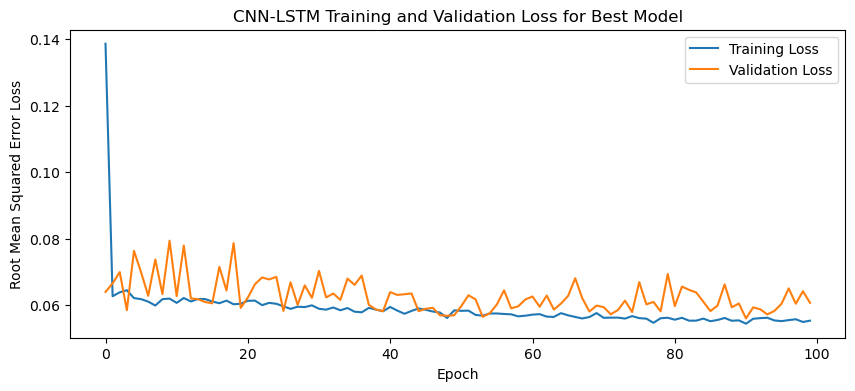

1/1 - 1s - loss: 0.0459 - 872ms/epoch - 872ms/step
Test Loss: 0.04589606821537018


NameError: name 'make_forecasts' is not defined

In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):

    cv_accuracies = []
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    #print("Forecasts:")
    #print(forecasts)
    #print("Actual:")
    #print(actual)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

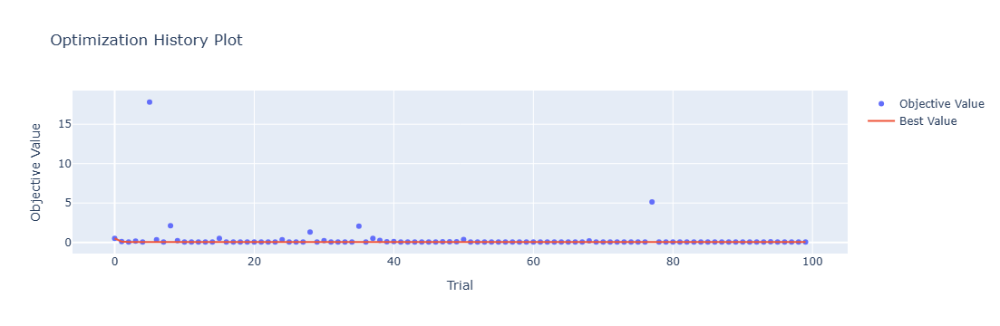

In [4]:
optuna.visualization.plot_optimization_history(study)

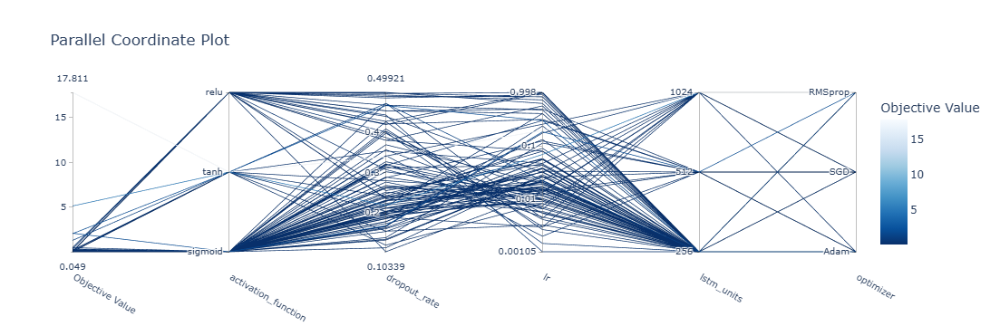

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

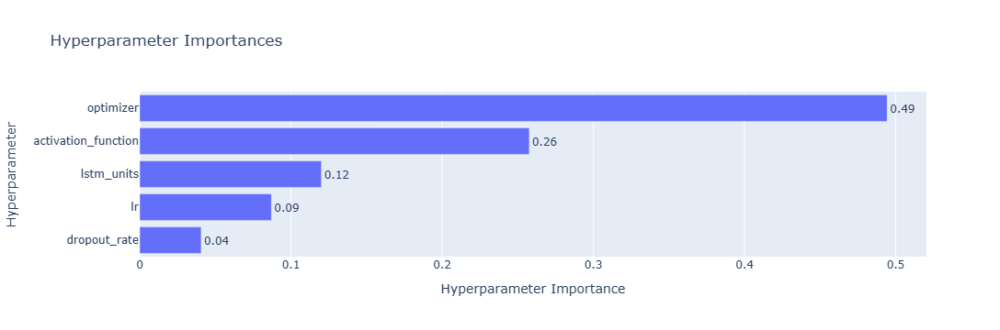

In [6]:
optuna.visualization.plot_param_importances(study)

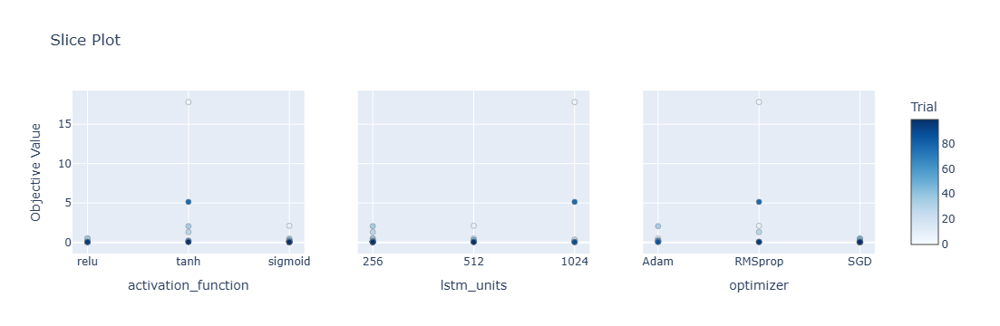

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

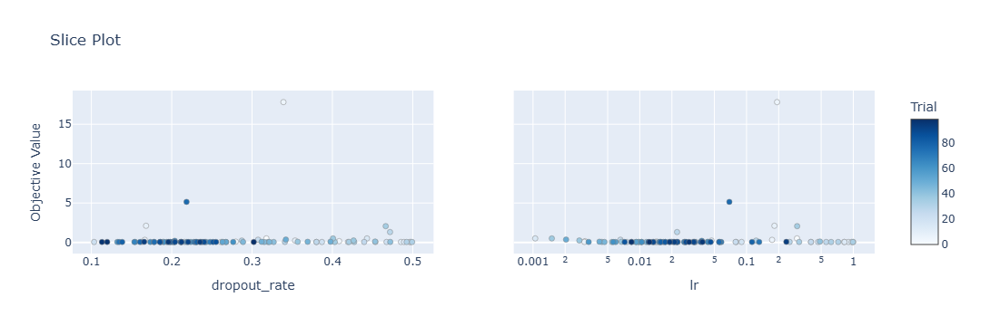

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

[[12.21  8.17 15.68 ... 23.86 20.59 15.82]
 [14.52 12.85 16.77 ... 26.49 23.17 21.15]
 [ 8.91  6.23 11.39 ... 22.62 16.72 14.05]
 ...
 [ 7.87  5.76 10.62 ... 21.07 15.24 12.04]
 [ 6.49  2.73  9.77 ... 21.93 16.5  11.44]
 [ 5.29  1.27  5.84 ... 22.11 15.37  9.87]]
Epoch 1/100
84/84 [==============================] - 50s 304ms/step - loss: 0.1769 - accuracy: 0.3095 - mae: 0.1422 - rmse: 0.1769 - mape: inf - pearson: 0.6282 - val_loss: 0.0805 - val_accuracy: 0.4000 - val_mae: 0.0629 - val_rmse: 0.0805 - val_mape: 14.2490 - val_pearson: 0.7068
Epoch 2/100
84/84 [==============================] - 16s 191ms/step - loss: 0.0633 - accuracy: 0.5000 - mae: 0.0499 - rmse: 0.0633 - mape: inf - pearson: 0.8235 - val_loss: 0.0702 - val_accuracy: 0.4000 - val_mae: 0.0566 - val_rmse: 0.0702 - val_mape: 12.8265 - val_pearson: 0.7742
Epoch 3/100
84/84 [==============================] - 17s 201ms/step - loss: 0.0625 - accuracy: 0.4881 - mae: 0.0493 - rmse: 0.0625 - mape: inf - pearson: 0.8299 - val_loss:

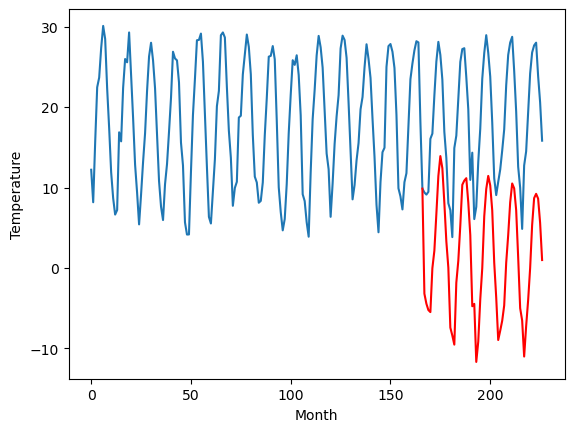

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.39		3.73		0.34
2.49		2.48		-0.01
2.11		1.68		-0.43
2.86		1.42		-1.44
8.69		6.87		-1.82
9.18		9.04		-0.14
11.95		13.62		1.67
15.70		18.33		2.63
16.18		20.80		4.62
16.81		19.29		2.48
13.83		14.99		1.16
11.20		10.21		-0.99
7.78		6.95		-0.83
0.57		-0.51		-1.08
1.23		-1.49		-2.72
1.14		-2.61		-3.75
6.20		5.07		-1.13
7.60		7.80		0.20
11.62		12.19		0.57
15.10		17.24		2.14
16.32		17.77		1.45
16.66		18.06		1.40
14.53		15.05		0.52
11.90		11.00		-0.90
6.39		2.14		-4.25
6.15		2.45		-3.70
-0.53		-4.77		-4.24
2.24		-2.24		-4.48
6.10		2.98		-3.12
9.07		6.88		-2.19
13.38		13.32		-0.06
17.07		16.72		-0.35
17.21		18.36		1.15
16.66		17.19		0.53
15.64		14.08		-1.56
10.04		7.58		-2.46
7.35		3.23		-4.12
3.50		-2.03		-5.53
4.29		-0.88		-5.17
5.39		0.37		-5.02
6.98		2.26		-4.72
9.13		7.55		-1.58
12.31		10.98		-1.33
15.39		15.05		-0.34
17.22		17.39		0.17
18.81		16.78		-2.03
15.43		14.08		-1.35
10.32		8.23		-2.09
5.

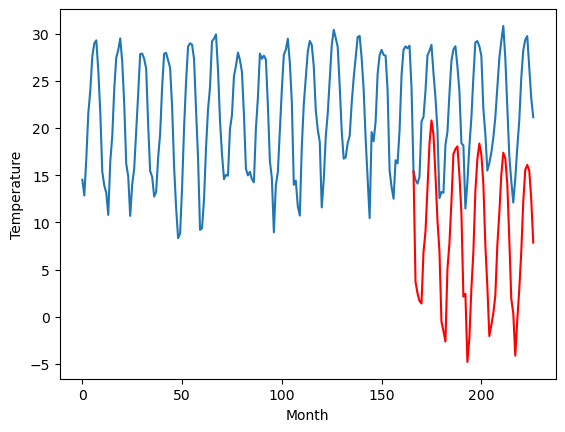

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.93		6.03		1.10
4.82		4.79		-0.03
4.20		3.98		-0.22
4.82		3.73		-1.09
11.07		9.18		-1.89
10.83		11.35		0.52
14.52		15.93		1.41
18.24		20.64		2.40
20.61		23.11		2.50
19.85		21.61		1.76
16.46		17.30		0.84
12.74		12.52		-0.22
7.81		9.25		1.44
0.81		1.80		0.99
1.63		0.82		-0.81
2.49		-0.30		-2.79
8.47		7.38		-1.09
10.11		10.11		-0.00
14.09		14.49		0.40
18.23		19.55		1.32
19.99		20.08		0.09
20.27		20.36		0.09
16.70		17.35		0.65
12.82		13.30		0.48
4.46		4.45		-0.01
6.64		4.75		-1.89
0.63		-2.47		-3.10
4.58		0.06		-4.52
8.08		5.29		-2.79
10.82		9.17		-1.65
16.58		15.61		-0.97
20.36		19.01		-1.35
21.28		20.64		-0.64
20.05		19.48		-0.57
16.93		16.38		-0.55
9.79		9.87		0.08
7.31		5.52		-1.79
2.79		0.27		-2.52
4.74		1.42		-3.32
7.52		2.66		-4.86
7.50		4.56		-2.94
10.57		9.86		-0.71
13.98		13.27		-0.71
17.30		17.35		0.05
20.40		19.68		-0.72
20.01		19.07		-0.94
16.56		16.37		-0.19
10.58		10.52		-0.06
5.4

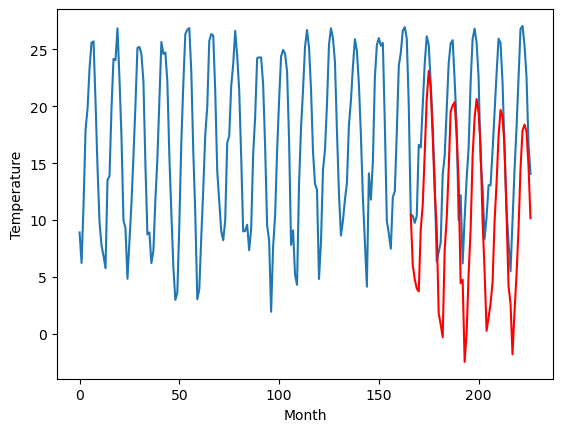

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.13		0.42		-0.71
1.11		-0.82		-1.93
1.15		-1.62		-2.77
1.15		-1.89		-3.04
8.07		3.56		-4.51
8.15		5.74		-2.41
11.04		10.32		-0.72
13.95		15.02		1.07
14.92		17.49		2.57
15.26		15.98		0.72
12.93		11.68		-1.25
8.87		6.90		-1.97
6.03		3.63		-2.40
-1.43		-3.83		-2.40
-1.34		-4.81		-3.47
-2.91		-5.93		-3.02
5.00		1.74		-3.26
6.79		4.47		-2.32
10.76		8.85		-1.91
14.04		13.91		-0.13
14.67		14.43		-0.24
14.72		14.71		-0.01
12.21		11.69		-0.52
9.90		7.64		-2.26
1.81		-1.22		-3.03
4.58		-0.91		-5.49
-2.77		-8.13		-5.36
-0.33		-5.60		-5.27
3.46		-0.38		-3.84
8.25		3.50		-4.75
12.77		9.94		-2.83
15.20		13.33		-1.87
15.18		14.96		-0.22
13.99		13.79		-0.20
12.75		10.68		-2.07
7.13		4.18		-2.95
3.02		-0.17		-3.19
0.84		-5.43		-6.27
2.28		-4.28		-6.56
2.69		-3.04		-5.73
6.21		-1.15		-7.36
7.63		4.14		-3.49
12.06		7.56		-4.50
15.81		11.63		-4.18
16.93		13.96		-2.97
18.46		13.36		-5.10
15.02		10.65		-4.37
8.77

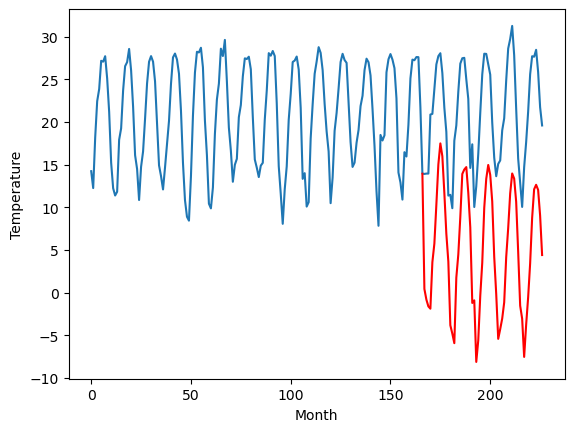

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.34		5.74		-1.60
5.29		4.49		-0.80
6.03		3.70		-2.33
5.36		3.43		-1.93
13.11		8.88		-4.23
13.36		11.05		-2.31
18.34		15.63		-2.71
22.54		20.34		-2.20
24.15		22.81		-1.34
24.64		21.31		-3.33
18.93		17.01		-1.92
14.05		12.23		-1.82
11.53		8.96		-2.57
5.06		1.50		-3.56
4.18		0.52		-3.66
1.09		-0.61		-1.70
10.99		7.08		-3.91
12.92		9.80		-3.12
16.78		14.19		-2.59
21.98		19.25		-2.73
22.41		19.77		-2.64
23.17		20.06		-3.11
21.16		17.04		-4.12
16.81		12.99		-3.82
9.24		4.13		-5.11
11.57		4.44		-7.13
3.12		-2.78		-5.90
2.89		-0.24		-3.13
9.38		4.97		-4.41
15.42		8.85		-6.57
20.13		15.29		-4.84
24.47		18.68		-5.79
26.83		20.31		-6.52
24.47		19.14		-5.33
21.52		16.05		-5.47
15.60		9.54		-6.06
8.67		5.18		-3.49
5.94		-0.07		-6.01
6.91		1.08		-5.83
7.04		2.31		-4.73
11.76		4.21		-7.55
13.26		9.50		-3.76
18.79		12.92		-5.87
23.34		17.00		-6.34
26.33		19.33		-7.00
28.07		18.73		-9.34
23.59		16.02		-7.57


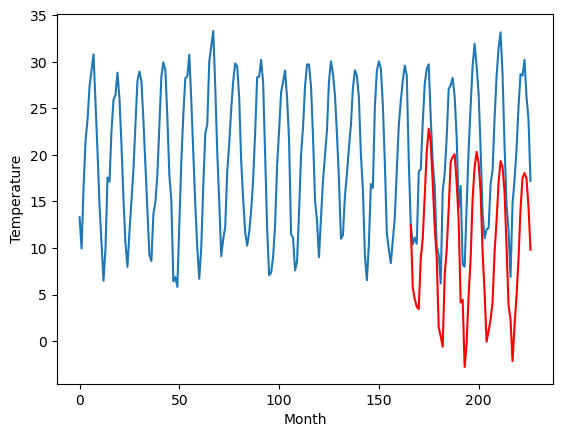

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.63		4.82		0.19
4.06		3.57		-0.49
3.53		2.77		-0.76
3.22		2.50		-0.72
6.81		7.95		1.14
8.78		10.12		1.34
12.47		14.70		2.23
16.82		19.41		2.59
20.56		21.88		1.32
19.71		20.37		0.66
16.68		16.07		-0.61
12.59		11.29		-1.30
8.47		8.01		-0.46
1.72		0.55		-1.17
-0.06		-0.43		-0.37
0.59		-1.56		-2.15
5.49		6.13		0.64
8.86		8.85		-0.01
12.37		13.23		0.86
16.94		18.28		1.34
18.93		18.81		-0.12
19.41		19.10		-0.31
16.40		16.08		-0.32
12.80		12.03		-0.77
4.63		3.17		-1.46
5.68		3.48		-2.20
-0.70		-3.75		-3.05
2.91		-1.21		-4.12
6.83		4.01		-2.82
9.70		7.89		-1.81
14.33		14.33		0.00
17.90		17.74		-0.16
20.04		19.37		-0.67
19.19		18.20		-0.99
16.54		15.10		-1.44
9.98		8.60		-1.38
8.29		4.24		-4.05
1.77		-1.02		-2.79
3.46		0.13		-3.33
4.95		1.37		-3.58
5.86		3.26		-2.60
10.54		8.56		-1.98
12.06		11.97		-0.09
15.88		16.04		0.16
19.71		18.38		-1.33
19.23		17.77		-1.46
15.71		15.06		-0.65
11.36		9.21		-2.15

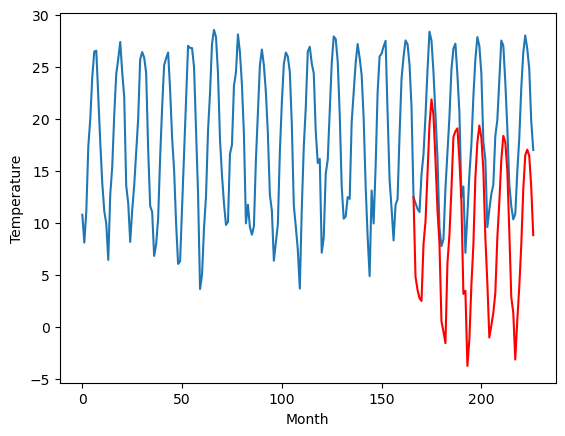

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.68		2.31		1.63
0.32		1.06		0.74
-0.15		0.25		0.40
0.96		-0.02		-0.98
6.38		5.44		-0.94
7.62		7.61		-0.01
9.96		12.19		2.23
15.21		16.90		1.69
18.28		19.37		1.09
17.25		17.87		0.62
13.36		13.56		0.20
9.36		8.79		-0.57
5.18		5.51		0.33
-1.75		-1.94		-0.19
-2.33		-2.92		-0.59
-1.69		-4.05		-2.36
5.29		3.63		-1.66
6.32		6.36		0.04
10.03		10.73		0.70
14.36		15.79		1.43
15.98		16.31		0.33
15.92		16.60		0.68
11.87		13.58		1.71
8.64		9.53		0.89
-0.01		0.68		0.69
1.93		0.98		-0.95
-4.72		-6.24		-1.52
-0.74		-3.71		-2.97
3.60		1.51		-2.09
6.52		5.39		-1.13
11.59		11.83		0.24
15.50		15.24		-0.26
16.60		16.86		0.26
15.31		15.70		0.39
12.25		12.60		0.35
5.31		6.10		0.79
3.08		1.74		-1.34
-3.43		-3.51		-0.08
-0.24		-2.36		-2.12
2.76		-1.12		-3.88
3.24		0.77		-2.47
6.80		6.06		-0.74
9.49		9.48		-0.01
12.84		13.55		0.71
16.55		15.89		-0.66
15.86		15.28		-0.58
12.35		12.57		0.22
7.14		6.72		-0.42
1.27		0.39

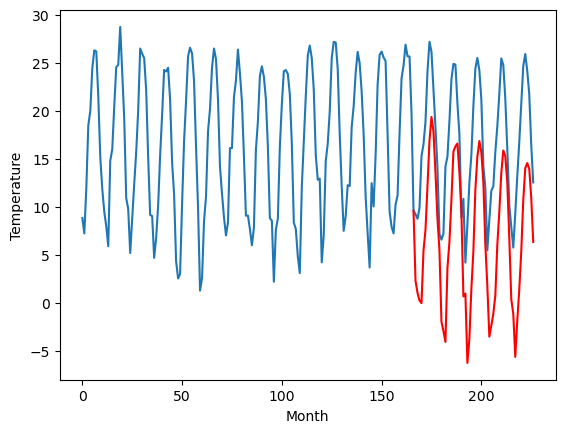

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.37		0.37		1.74
-1.74		-0.88		0.86
-1.86		-1.69		0.17
-0.82		-1.95		-1.13
4.76		3.50		-1.26
5.66		5.67		0.01
8.78		10.26		1.48
14.30		14.96		0.66
17.56		17.44		-0.12
16.19		15.93		-0.26
11.32		11.62		0.30
7.48		6.85		-0.63
3.25		3.57		0.32
-3.68		-3.88		-0.20
-4.62		-4.87		-0.25
-4.00		-5.99		-1.99
2.52		1.69		-0.83
6.15		4.42		-1.73
9.17		8.79		-0.38
13.96		13.85		-0.11
16.08		14.37		-1.71
16.03		14.67		-1.36
11.52		11.65		0.13
7.67		7.60		-0.07
-1.83		-1.26		0.57
0.23		-0.96		-1.19
-6.95		-8.19		-1.24
-2.71		-5.65		-2.94
2.13		-0.43		-2.56
5.45		3.44		-2.01
10.43		9.89		-0.54
14.43		13.30		-1.13
16.30		14.92		-1.38
14.62		13.76		-0.86
10.92		10.66		-0.26
3.73		4.16		0.43
1.53		-0.20		-1.73
-5.64		-5.45		0.19
-2.47		-4.30		-1.83
0.50		-3.06		-3.56
1.18		-1.17		-2.35
5.80		4.12		-1.68
8.09		7.54		-0.55
11.84		11.61		-0.23
15.98		13.95		-2.03
14.84		13.34		-1.50
11.08		10.63		-0.45
5.69		4.7

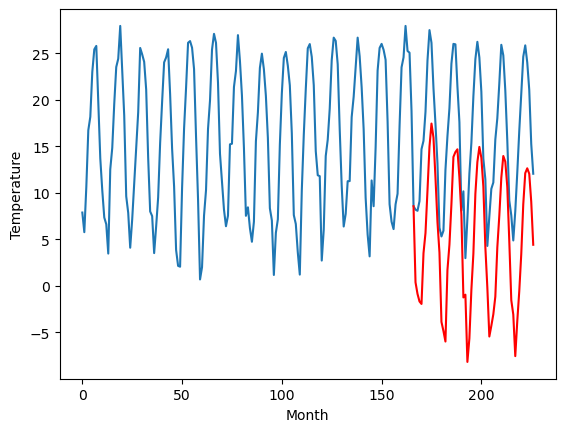

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.95		-0.61		0.34
-1.11		-1.85		-0.74
-2.30		-2.65		-0.35
-1.80		-2.91		-1.11
4.77		2.55		-2.22
7.05		4.72		-2.33
11.93		9.30		-2.63
17.86		14.01		-3.85
20.60		16.48		-4.12
17.59		14.98		-2.61
14.03		10.67		-3.36
6.77		5.89		-0.88
3.91		2.62		-1.29
-2.80		-4.83		-2.03
-3.59		-5.82		-2.23
-7.86		-6.95		0.91
4.61		0.74		-3.87
7.21		3.47		-3.74
11.90		7.86		-4.04
18.09		12.91		-5.18
18.66		13.43		-5.23
18.60		13.73		-4.87
14.86		10.71		-4.15
10.90		6.65		-4.25
0.86		-2.20		-3.06
2.66		-1.90		-4.56
-5.85		-9.12		-3.27
-3.81		-6.59		-2.78
3.41		-1.37		-4.78
7.36		2.51		-4.85
14.20		8.96		-5.24
18.72		12.37		-6.35
21.05		14.00		-7.05
18.17		12.83		-5.34
14.53		9.74		-4.79
7.97		3.24		-4.73
2.00		-1.11		-3.11
-3.29		-6.38		-3.09
-0.73		-5.22		-4.49
0.88		-3.98		-4.86
2.70		-2.08		-4.78
8.48		3.21		-5.27
14.07		6.63		-7.44
17.94		10.71		-7.23
19.43		13.04		-6.39
18.17		12.44		-5.73
15.00		9.74		-5.2

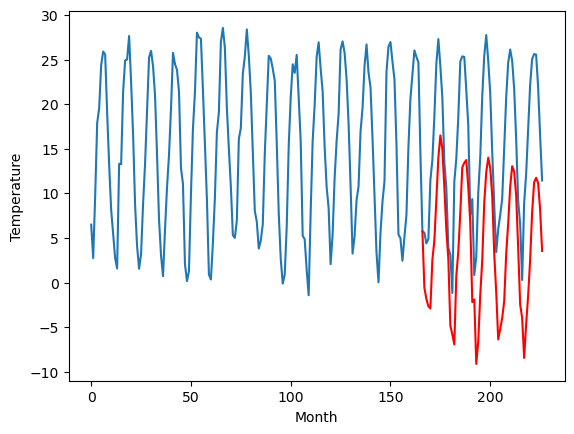

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.56		-1.98		2.58
-4.38		-3.23		1.15
-5.66		-4.03		1.63
-6.53		-4.30		2.23
0.66		1.16		0.50
2.32		3.34		1.02
7.41		7.93		0.52
14.39		12.64		-1.75
17.02		15.11		-1.91
14.64		13.59		-1.05
10.97		9.29		-1.68
4.58		4.51		-0.07
0.90		1.24		0.34
-6.61		-6.21		0.40
-8.20		-7.19		1.01
-10.37		-8.32		2.05
0.38		-0.64		-1.02
3.44		2.09		-1.35
7.91		6.47		-1.44
14.39		11.53		-2.86
15.40		12.05		-3.35
16.00		12.36		-3.64
12.14		9.33		-2.81
7.67		5.28		-2.39
-2.99		-3.58		-0.59
-1.76		-3.29		-1.53
-10.73		-10.52		0.21
-7.15		-7.99		-0.84
-0.17		-2.77		-2.60
2.56		1.12		-1.44
10.73		7.56		-3.17
14.63		10.98		-3.65
16.66		12.60		-4.06
14.75		11.44		-3.31
11.02		8.34		-2.68
3.98		1.84		-2.14
-1.04		-2.50		-1.46
-6.75		-7.77		-1.02
-4.86		-6.61		-1.75
-2.82		-5.37		-2.55
-2.48		-3.47		-0.99
3.80		1.82		-1.98
8.76		5.25		-3.51
12.60		9.33		-3.27
15.43		11.66		-3.77
14.63		11.05		-3.58
12.02		8.35		-3.67
5.44

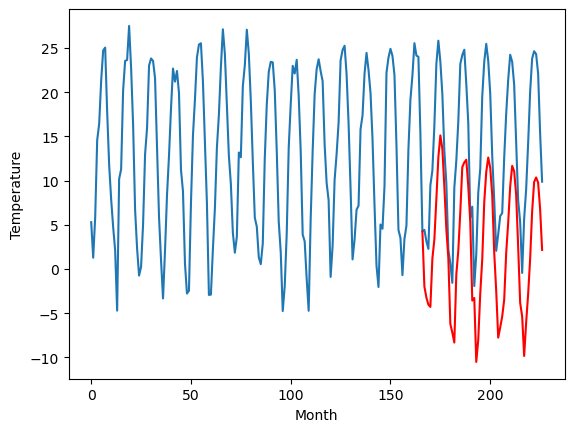

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-5.06		-3.18		1.88
-5.73		-4.42		1.31
-6.76		-5.23		1.53
-8.22		-5.49		2.73
-2.08		-0.03		2.05
0.57		2.14		1.57
7.00		6.73		-0.27
14.96		11.44		-3.52
18.12		13.91		-4.21
15.43		12.38		-3.05
10.60		8.08		-2.52
3.85		3.30		-0.55
0.37		0.03		-0.34
-6.66		-7.42		-0.76
-8.27		-8.40		-0.13
-12.58		-9.53		3.05
-0.85		-1.84		-0.99
3.12		0.90		-2.22
8.27		5.29		-2.98
15.58		10.34		-5.24
16.17		10.86		-5.31
16.88		11.17		-5.71
12.83		8.15		-4.68
8.48		4.10		-4.38
-2.38		-4.76		-2.38
-3.28		-4.47		-1.19
-12.23		-11.70		0.53
-8.99		-9.18		-0.19
-2.08		-3.96		-1.88
1.53		-0.06		-1.59
10.85		6.40		-4.45
15.61		9.82		-5.79
16.72		11.45		-5.27
15.60		10.28		-5.32
11.76		7.18		-4.58
4.52		0.69		-3.83
-0.51		-3.66		-3.15
-6.69		-8.93		-2.24
-5.56		-7.76		-2.20
-5.15		-6.51		-1.36
-3.29		-4.62		-1.33
3.56		0.68		-2.88
8.58		4.11		-4.47
14.09		8.20		-5.89
16.55		10.55		-6.00
14.74		9.93		-4.81
12.36		7.23		-5.1

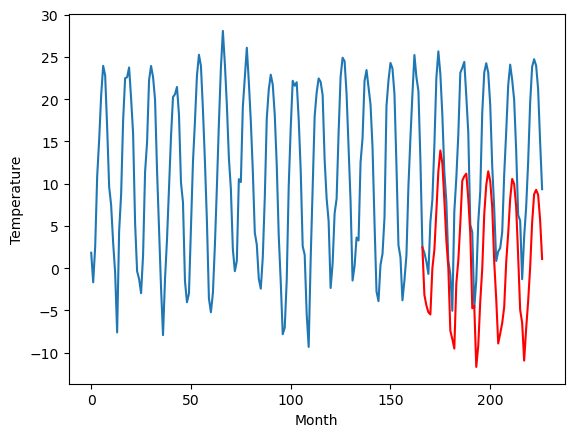

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -2.98  -3.190320
1                 1    3.39   3.726027
2                 2    4.93   6.034093
3                 3    1.13   0.421388
4                 4    7.34   5.741630
5                 5    4.63   4.817912
6                 6    0.68   2.307247
7                 7   -1.37   0.368212
8                 8   -0.95  -0.608746
9                 9   -4.56  -1.984922
10               10   -5.06  -3.179183


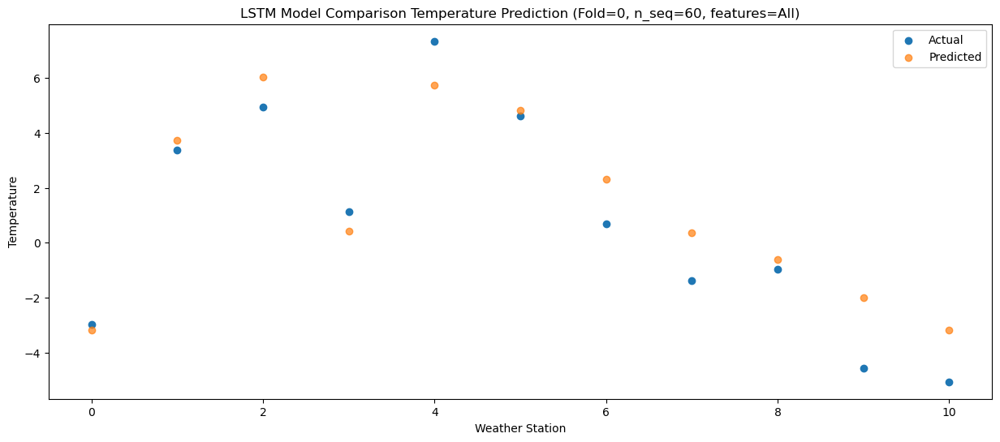

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -3.45  -4.433446
1                 1    2.49   2.481727
2                 2    4.82   4.790530
3                 3    1.11  -0.824956
4                 4    5.29   4.494468
5                 5    4.06   3.570036
6                 6    0.32   1.059575
7                 7   -1.74  -0.876931
8                 8   -1.11  -1.847648
9                 9   -4.38  -3.228627
10               10   -5.73  -4.424939


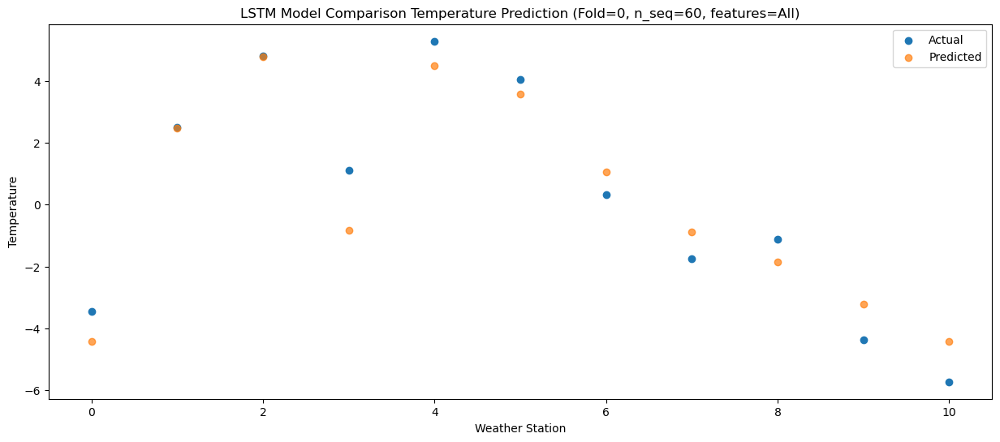

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -3.72  -5.223738
1                 1    2.11   1.679557
2                 2    4.20   3.984693
3                 3    1.15  -1.623987
4                 4    6.03   3.699864
5                 5    3.53   2.766901
6                 6   -0.15   0.251683
7                 7   -1.86  -1.688568
8                 8   -2.30  -2.650234
9                 9   -5.66  -4.034870
10               10   -6.76  -5.228266


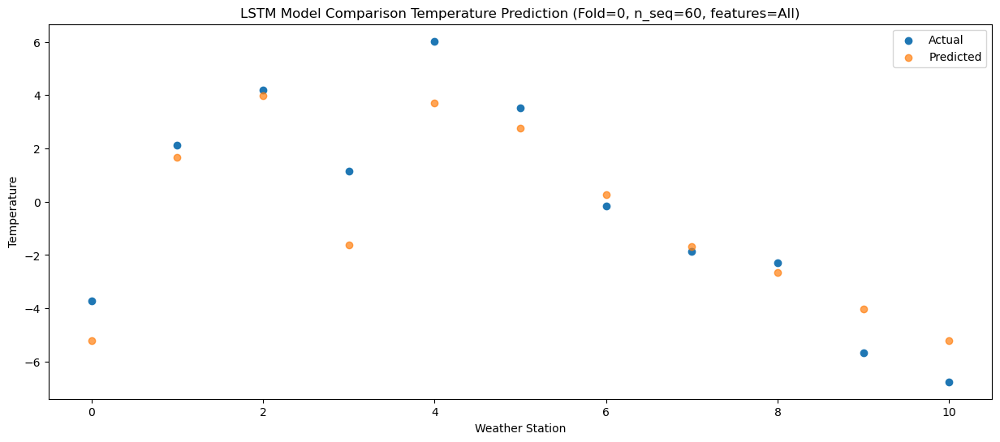

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -3.37  -5.478084
1                 1    2.86   1.418557
2                 2    4.82   3.726904
3                 3    1.15  -1.890180
4                 4    5.36   3.428775
5                 5    3.22   2.499522
6                 6    0.96  -0.015192
7                 7   -0.82  -1.954576
8                 8   -1.80  -2.913227
9                 9   -6.53  -4.296132
10               10   -8.22  -5.493942


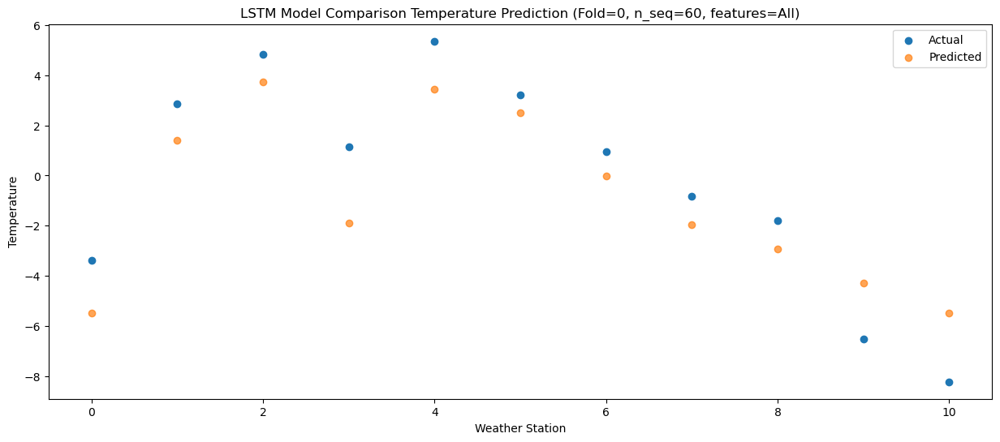

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.21  -0.028151
1                 1    8.69   6.866379
2                 2   11.07   9.176919
3                 3    8.07   3.560198
4                 4   13.11   8.881373
5                 5    6.81   7.953646
6                 6    6.38   5.441058
7                 7    4.76   3.503147
8                 8    4.77   2.546880
9                 9    0.66   1.164681
10               10   -2.08  -0.033405


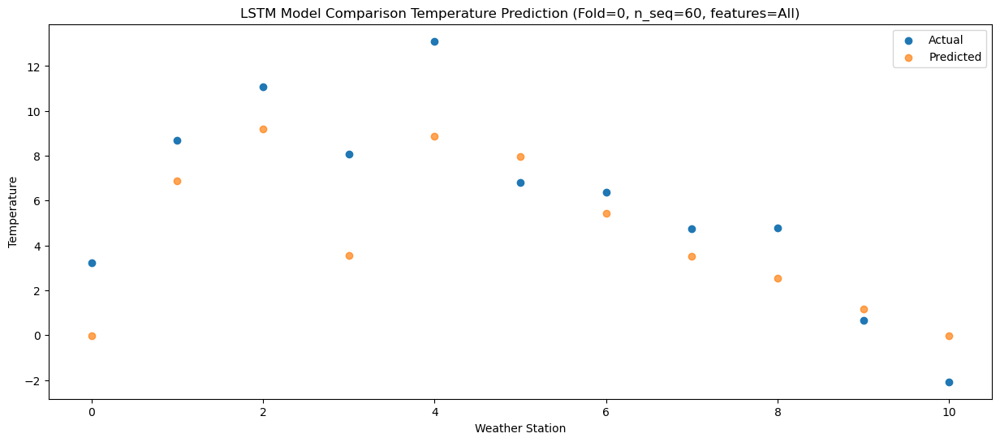

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.86   2.153012
1                 1    9.18   9.044993
2                 2   10.83  11.352598
3                 3    8.15   5.735483
4                 4   13.36  11.052819
5                 5    8.78  10.123132
6                 6    7.62   7.613163
7                 7    5.66   5.674886
8                 8    7.05   4.723253
9                 9    2.32   3.343056
10               10    0.57   2.139836


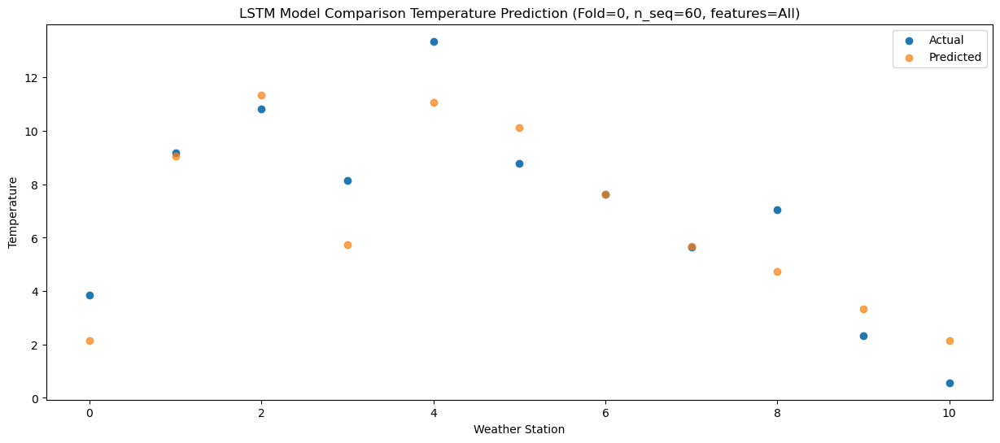

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.59   6.722772
1                 1   11.95  13.618844
2                 2   14.52  15.927477
3                 3   11.04  10.315452
4                 4   18.34  15.627135
5                 5   12.47  14.704102
6                 6    9.96  12.192634
7                 7    8.78  10.255371
8                 8   11.93   9.304288
9                 9    7.41   7.927603
10               10    7.00   6.732470


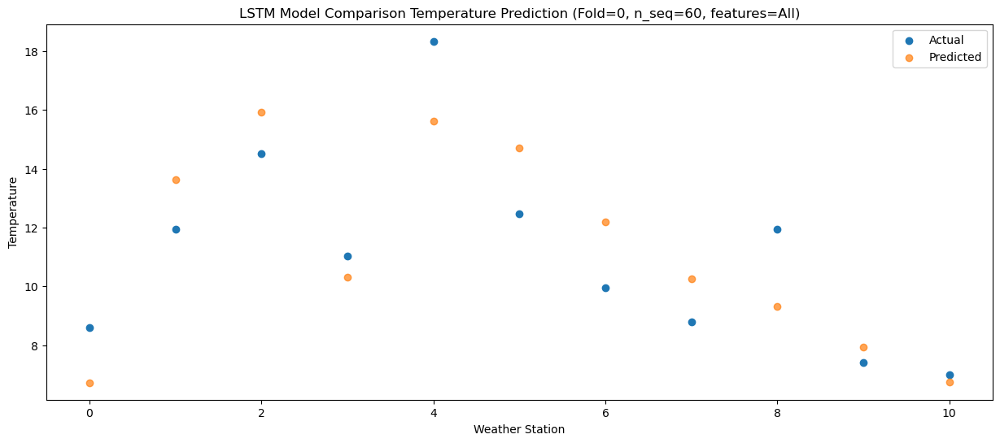

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.81  11.433715
1                 1   15.70  18.327910
2                 2   18.24  20.637892
3                 3   13.95  15.024562
4                 4   22.54  20.336076
5                 5   16.82  19.412086
6                 6   15.21  16.903018
7                 7   14.30  14.963612
8                 8   17.86  14.012191
9                 9   14.39  12.636833
10               10   14.96  11.439259


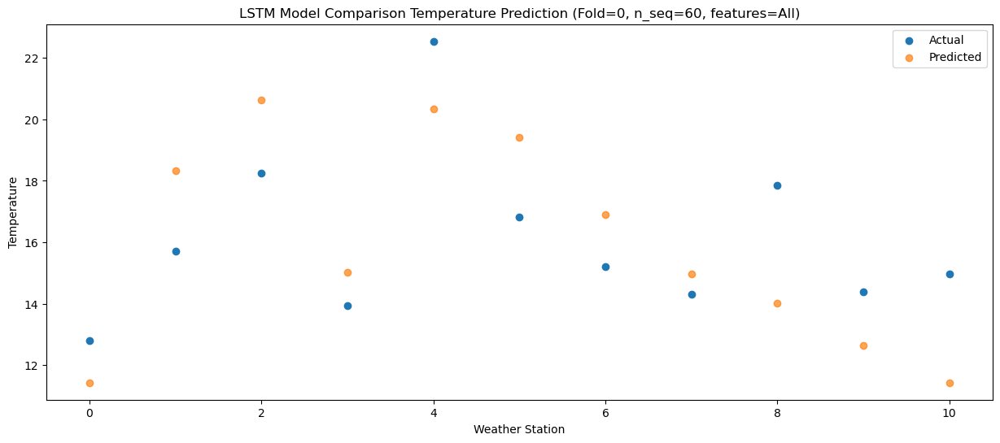

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   15.26  13.904828
1                 1   16.18  20.798173
2                 2   20.61  23.110096
3                 3   14.92  17.487522
4                 4   24.15  22.809750
5                 5   20.56  21.879685
6                 6   18.28  19.373597
7                 7   17.56  17.435604
8                 8   20.60  16.482258
9                 9   17.02  15.106878
10               10   18.12  13.905419


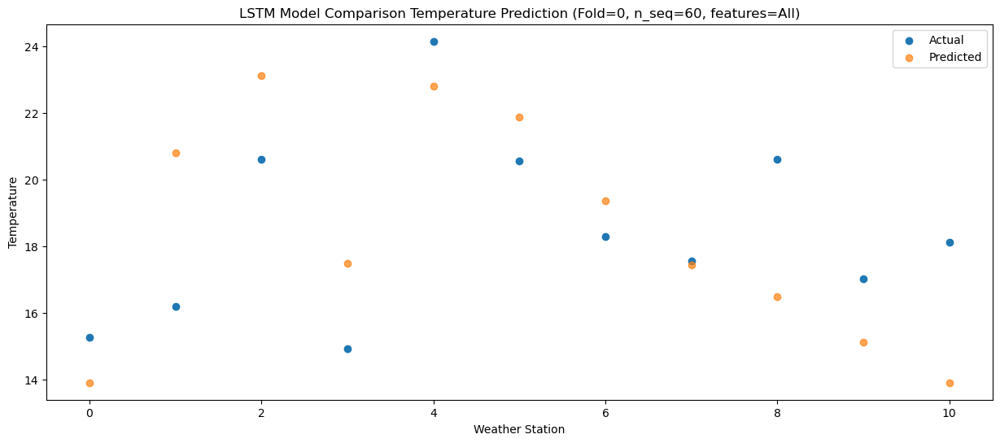

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   13.63  12.406787
1                 1   16.81  19.294743
2                 2   19.85  21.606025
3                 3   15.26  15.980746
4                 4   24.64  21.309111
5                 5   19.71  20.369452
6                 6   17.25  17.866205
7                 7   16.19  15.929798
8                 8   17.59  14.976742
9                 9   14.64  13.594784
10               10   15.43  12.384676


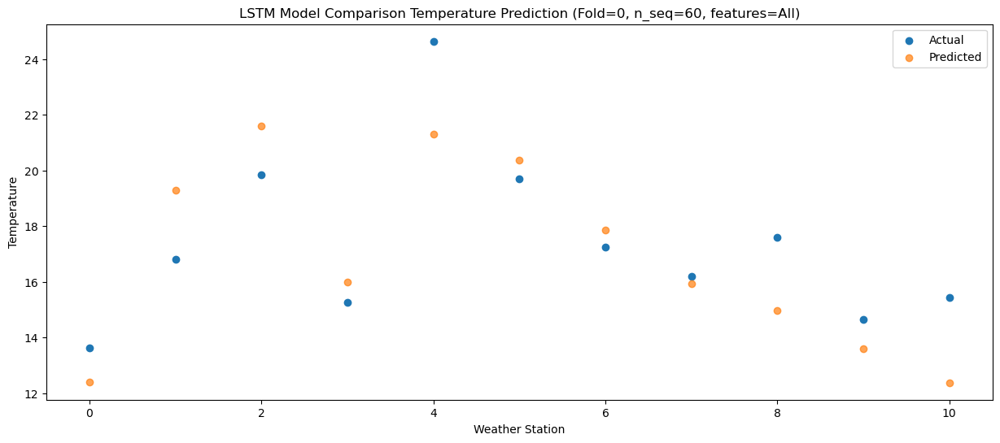

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   10.57   8.100712
1                 1   13.83  14.992337
2                 2   16.46  17.302618
3                 3   12.93  11.681230
4                 4   18.93  17.012442
5                 5   16.68  16.067648
6                 6   13.36  13.564014
7                 7   11.32  11.623657
8                 8   14.03  10.671638
9                 9   10.97   9.290018
10               10   10.60   8.083502


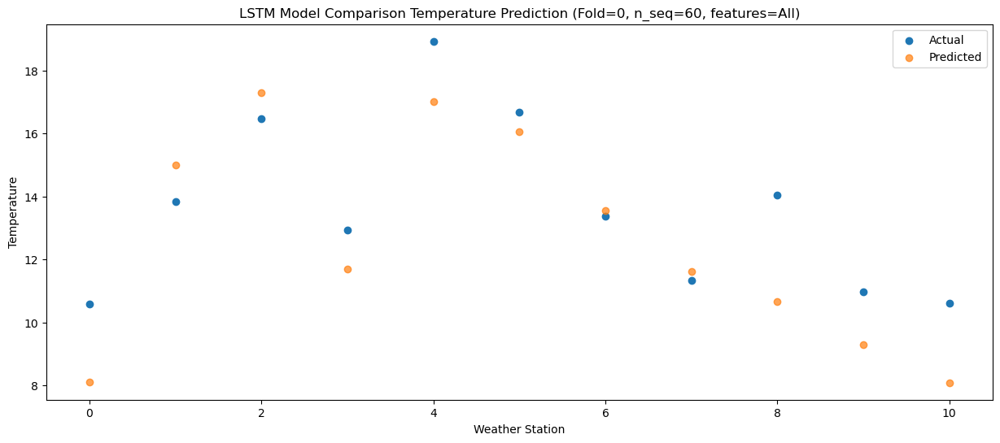

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.07   3.312526
1                 1   11.20  10.210592
2                 2   12.74  12.523197
3                 3    8.87   6.895819
4                 4   14.05  12.229365
5                 5   12.59  11.288094
6                 6    9.36   8.788139
7                 7    7.48   6.849016
8                 8    6.77   5.892100
9                 9    4.58   4.510116
10               10    3.85   3.302408


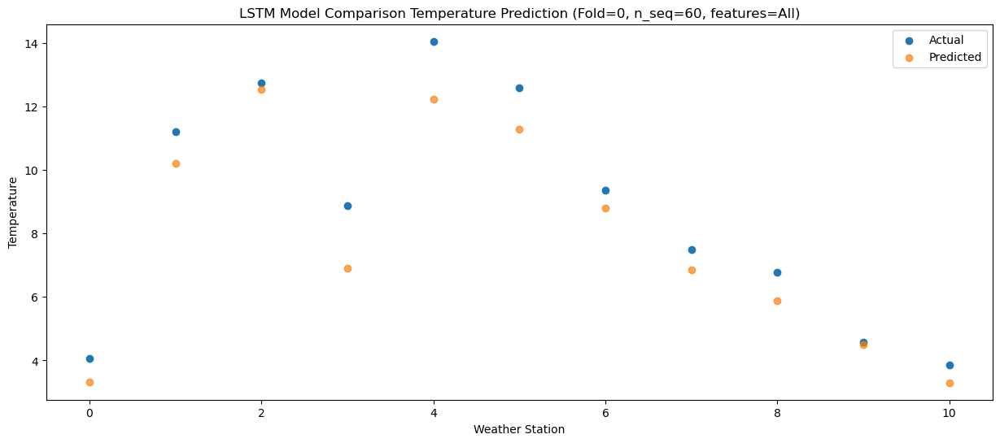

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    0.83   0.045768
1                 1    7.78   6.946648
2                 2    7.81   9.253612
3                 3    6.03   3.629674
4                 4   11.53   8.959966
5                 5    8.47   8.013299
6                 6    5.18   5.512995
7                 7    3.25   3.571234
8                 8    3.91   2.622156
9                 9    0.90   1.239025
10               10    0.37   0.029593


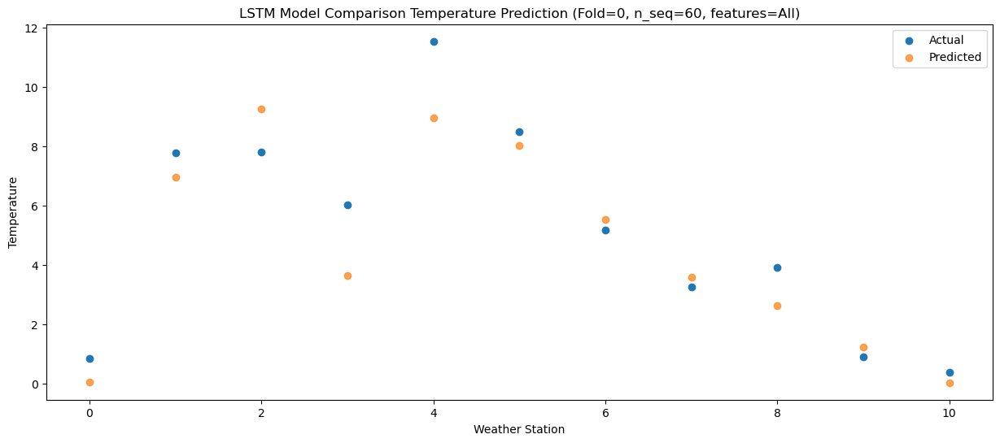

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.79  -7.403878
1                 1    0.57  -0.507119
2                 2    0.81   1.799179
3                 3   -1.43  -3.832496
4                 4    5.06   1.498009
5                 5    1.72   0.553033
6                 6   -1.75  -1.944916
7                 7   -3.68  -3.883508
8                 8   -2.80  -4.832722
9                 9   -6.61  -6.213539
10               10   -6.66  -7.418874


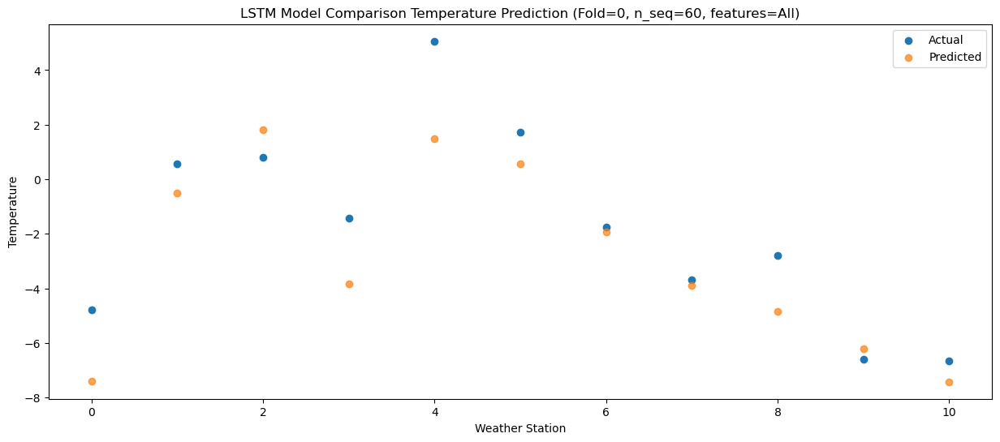

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -5.65  -8.387637
1                 1    1.23  -1.489097
2                 2    1.63   0.819998
3                 3   -1.34  -4.812068
4                 4    4.18   0.516971
5                 5   -0.06  -0.432792
6                 6   -2.33  -2.924587
7                 7   -4.62  -4.865150
8                 8   -3.59  -5.820643
9                 9   -8.20  -7.194808
10               10   -8.27  -8.403160


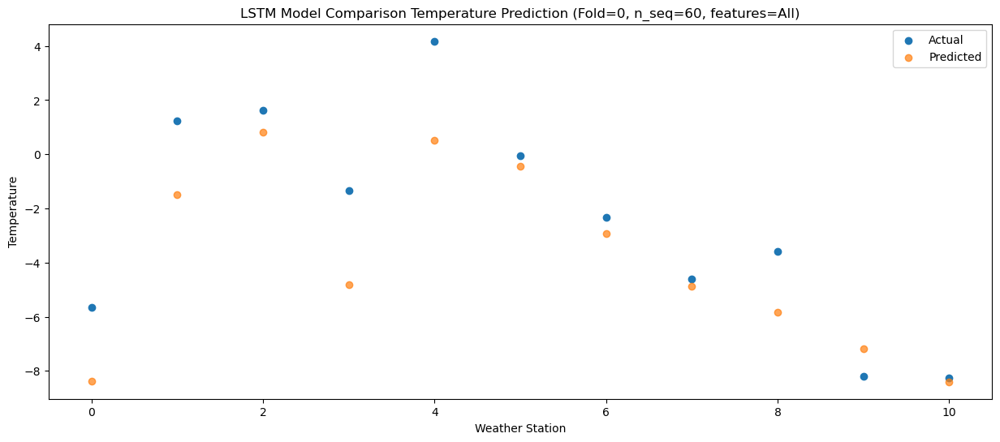

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -9.00  -9.518291
1                 1    1.14  -2.610003
2                 2    2.49  -0.301907
3                 3   -2.91  -5.932633
4                 4    1.09  -0.609859
5                 5    0.59  -1.559019
6                 6   -1.69  -4.051251
7                 7   -4.00  -5.994220
8                 8   -7.86  -6.948489
9                 9  -10.37  -8.323890
10               10  -12.58  -9.532394


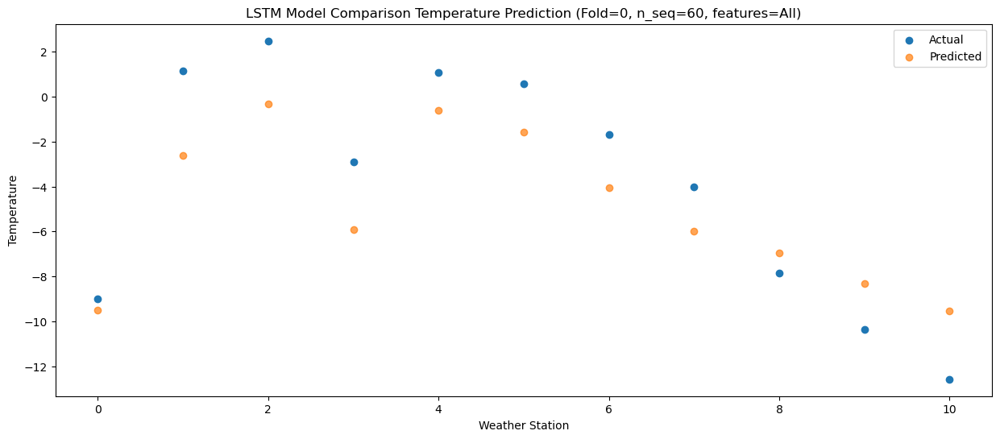

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.07  -1.827296
1                 1    6.20   5.071944
2                 2    8.47   7.380730
3                 3    5.00   1.743938
4                 4   10.99   7.077391
5                 5    5.49   6.125525
6                 6    5.29   3.631050
7                 7    2.52   1.689304
8                 8    4.61   0.736953
9                 9    0.38  -0.640323
10               10   -0.85  -1.842707


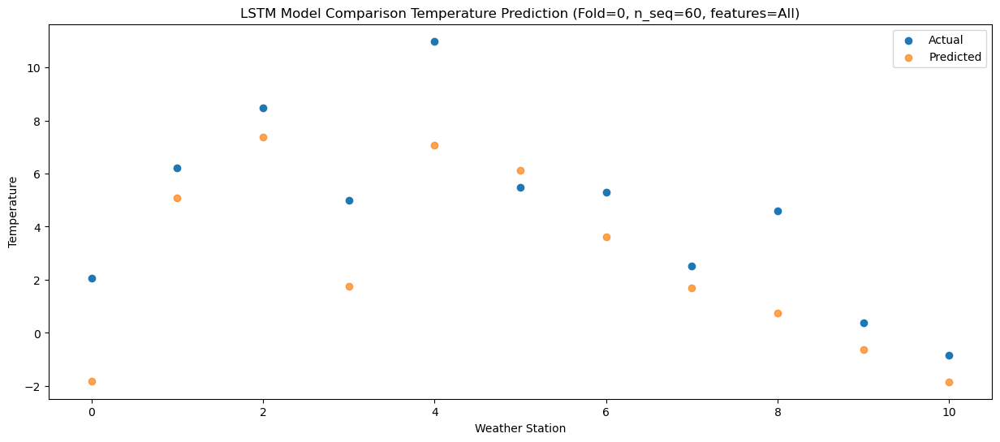

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    3.60   0.906581
1                 1    7.60   7.802029
2                 2   10.11  10.108953
3                 3    6.79   4.470891
4                 4   12.92   9.804814
5                 5    8.86   8.851088
6                 6    6.32   6.355681
7                 7    6.15   4.415159
8                 8    7.21   3.468179
9                 9    3.44   2.092702
10               10    3.12   0.899376


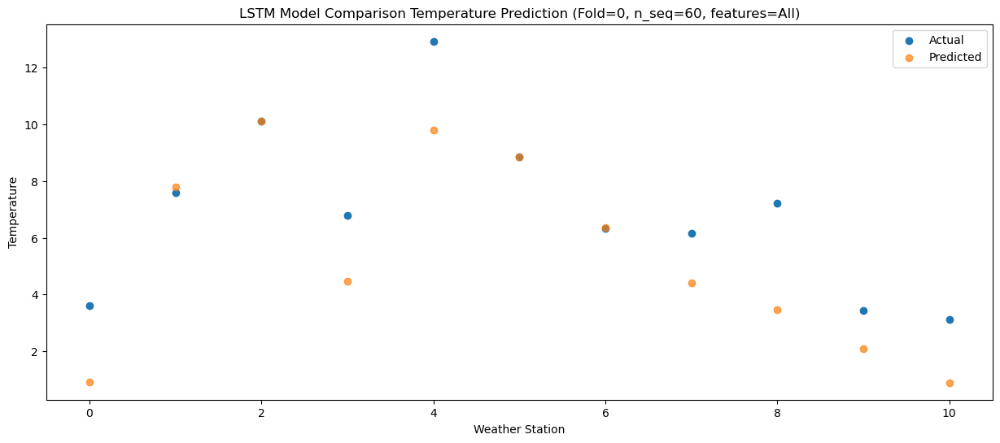

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.10   5.289971
1                 1   11.62  12.186585
2                 2   14.09  14.487589
3                 3   10.76   8.851928
4                 4   16.78  14.193237
5                 5   12.37  13.228779
6                 6   10.03  10.733865
7                 7    9.17   8.794199
8                 8   11.90   7.855688
9                 9    7.91   6.474846
10               10    8.27   5.285966


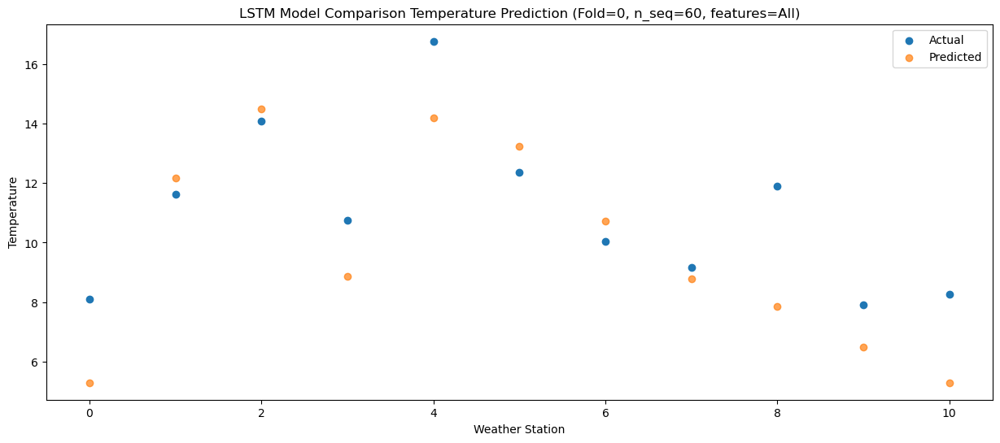

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.77  10.341124
1                 1   15.10  17.243516
2                 2   18.23  19.547883
3                 3   14.04  13.905431
4                 4   21.98  19.249989
5                 5   16.94  18.277576
6                 6   14.36  15.787140
7                 7   13.96  13.849236
8                 8   18.09  12.907427
9                 9   14.39  11.531278
10               10   15.58  10.337652


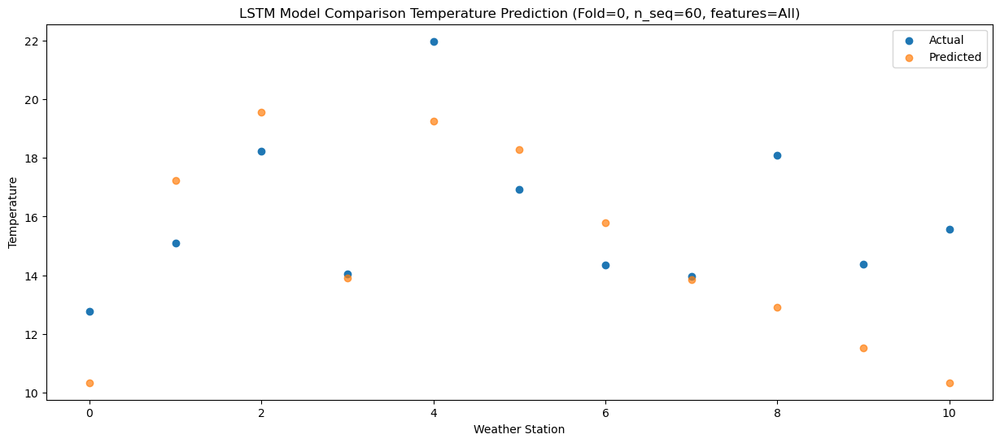

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   14.36  10.861650
1                 1   16.32  17.771230
2                 2   19.99  20.077559
3                 3   14.67  14.426275
4                 4   22.41  19.773159
5                 5   18.93  18.807368
6                 6   15.98  16.313656
7                 7   16.08  14.374941
8                 8   18.66  13.427836
9                 9   15.40  12.051032
10               10   16.17  10.859128


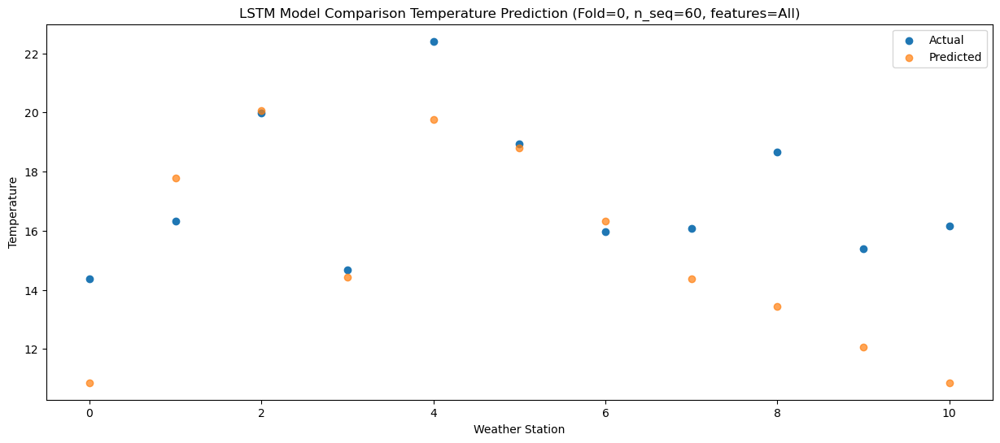

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   14.47  11.160414
1                 1   16.66  18.060007
2                 2   20.27  20.364931
3                 3   14.72  14.709832
4                 4   23.17  20.062436
5                 5   19.41  19.096625
6                 6   15.92  16.602273
7                 7   16.03  14.668458
8                 8   18.60  13.729561
9                 9   16.00  12.356593
10               10   16.88  11.171679


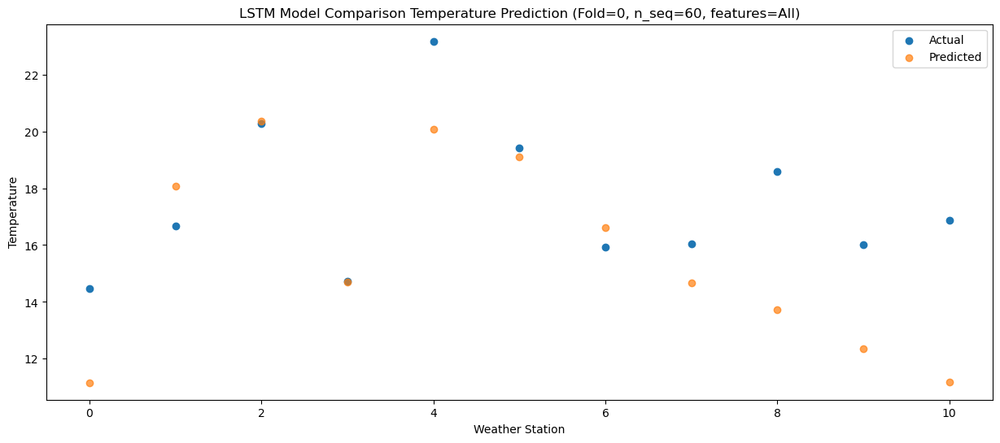

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.89   8.143563
1                 1   14.53  15.045456
2                 2   16.70  17.348788
3                 3   12.21  11.687318
4                 4   21.16  17.044041
5                 5   16.40  16.078108
6                 6   11.87  13.583310
7                 7   11.52  11.648723
8                 8   14.86  10.705648
9                 9   12.14   9.330138
10               10   12.83   8.149512


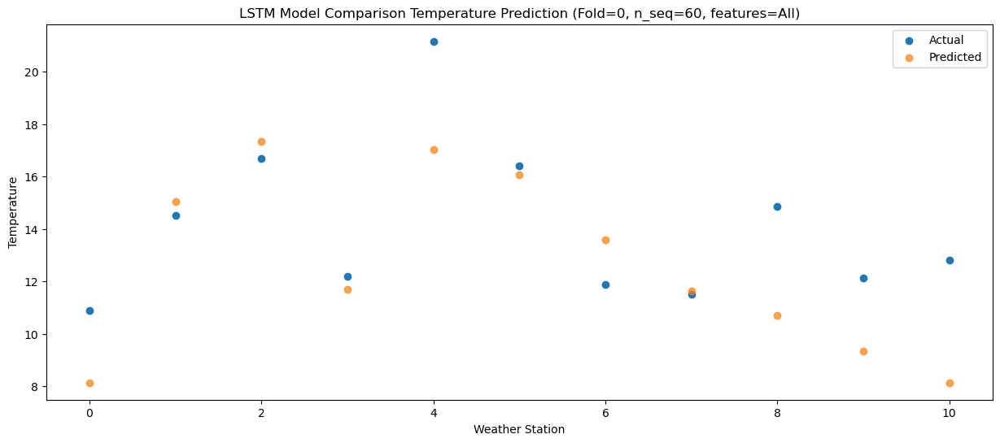

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.87   4.092782
1                 1   11.90  10.996640
2                 2   12.82  13.297314
3                 3    9.90   7.637563
4                 4   16.81  12.992448
5                 5   12.80  12.033428
6                 6    8.64   9.534772
7                 7    7.67   7.599333
8                 8   10.90   6.654510
9                 9    7.67   5.276918
10               10    8.48   4.102247


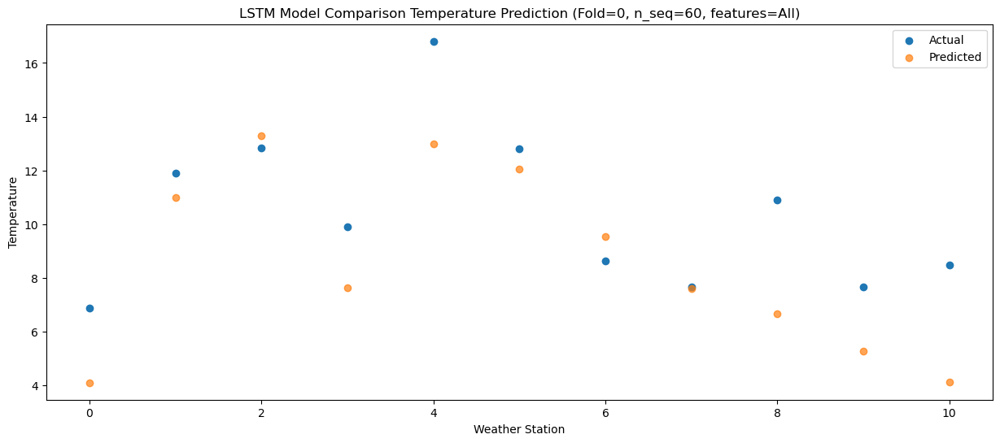

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.89  -4.750874
1                 1    6.39   2.144186
2                 2    4.46   4.446003
3                 3    1.81  -1.218467
4                 4    9.24   4.134975
5                 5    4.63   3.174707
6                 6   -0.01   0.678662
7                 7   -1.83  -1.256765
8                 8    0.86  -2.196451
9                 9   -2.99  -3.576300
10               10   -2.38  -4.757919


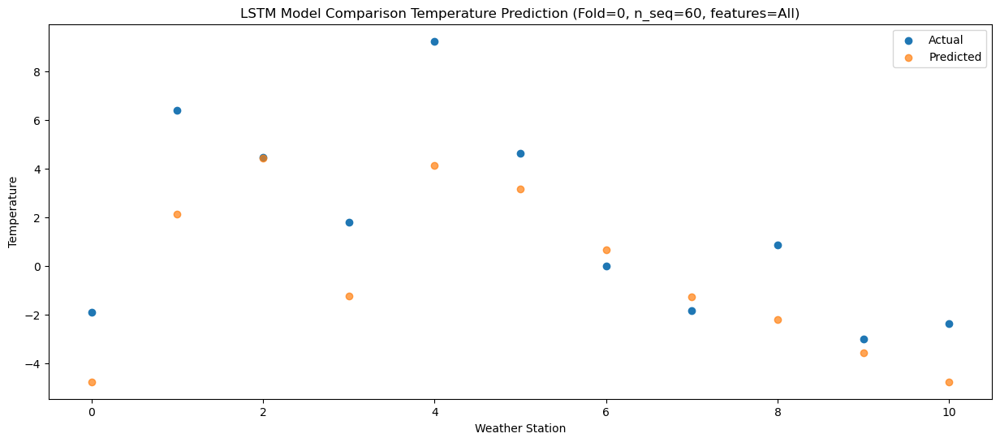

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.49  -4.455471
1                 1    6.15   2.445593
2                 2    6.64   4.750256
3                 3    4.58  -0.912358
4                 4   11.57   4.441160
5                 5    5.68   3.476595
6                 6    1.93   0.982085
7                 7    0.23  -0.957589
8                 8    2.66  -1.896949
9                 9   -1.76  -3.287362
10               10   -3.28  -4.473418


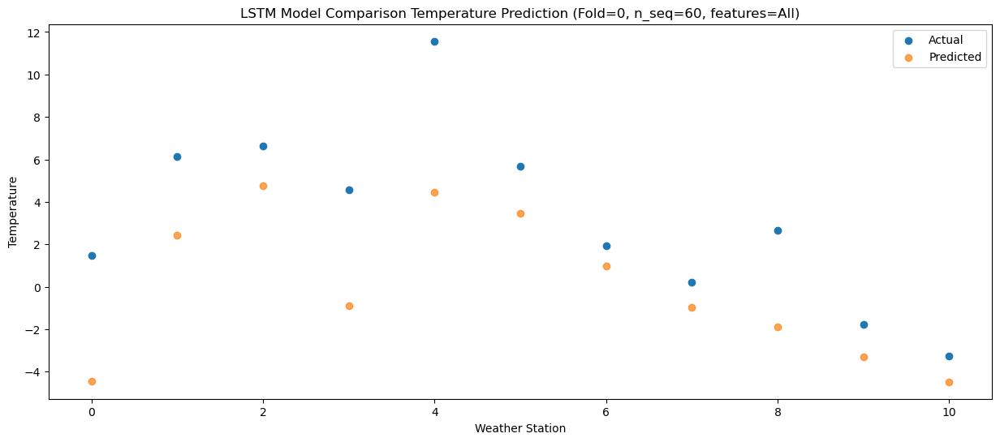

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -6.76 -11.668986
1                 1   -0.53  -4.771247
2                 2    0.63  -2.472437
3                 3   -2.77  -8.130998
4                 4    3.12  -2.777593
5                 5   -0.70  -3.746406
6                 6   -4.72  -6.244169
7                 7   -6.95  -8.185875
8                 8   -5.85  -9.123496
9                 9  -10.73 -10.515843
10               10  -12.23 -11.701846


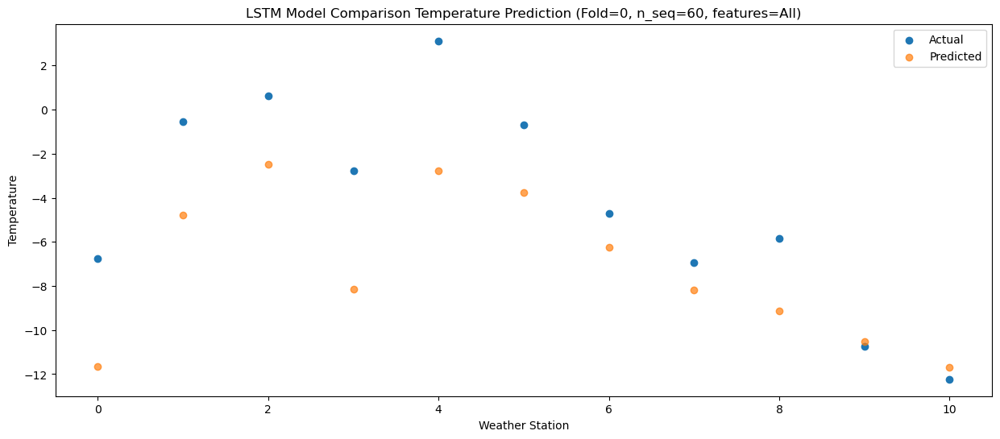

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -5.24  -9.135923
1                 1    2.24  -2.241459
2                 2    4.58   0.062778
3                 3   -0.33  -5.600880
4                 4    2.89  -0.244944
5                 5    2.91  -1.213270
6                 6   -0.74  -3.713182
7                 7   -2.71  -5.654172
8                 8   -3.81  -6.592013
9                 9   -7.15  -7.990315
10               10   -8.99  -9.177262


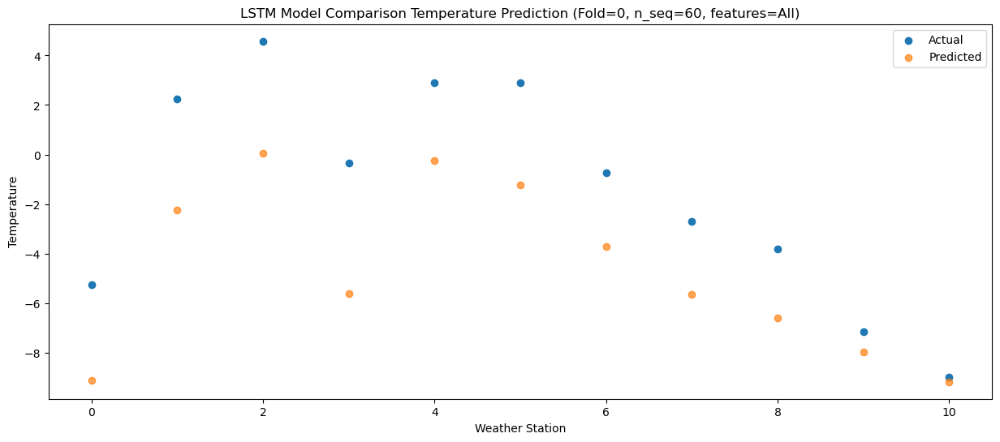

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    0.34  -3.913244
1                 1    6.10   2.981324
2                 2    8.08   5.288413
3                 3    3.46  -0.384704
4                 4    9.38   4.968251
5                 5    6.83   4.006473
6                 6    3.60   1.507707
7                 7    2.13  -0.432492
8                 8    3.41  -1.369911
9                 9   -0.17  -2.771811
10               10   -2.08  -3.959312


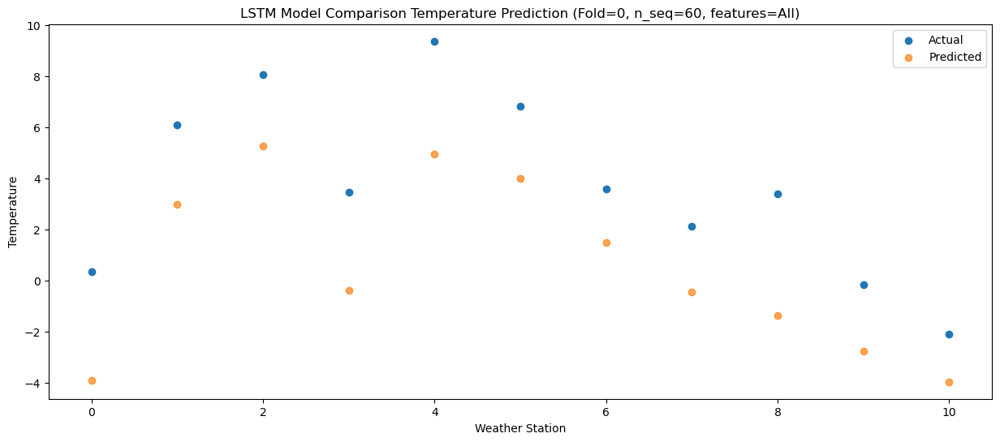

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    4.47  -0.024233
1                 1    9.07   6.875358
2                 2   10.82   9.170535
3                 3    8.25   3.495375
4                 4   15.42   8.845013
5                 5    9.70   7.890234
6                 6    6.52   5.387565
7                 7    5.45   3.444836
8                 8    7.36   2.513079
9                 9    2.56   1.116594
10               10    1.53  -0.057570


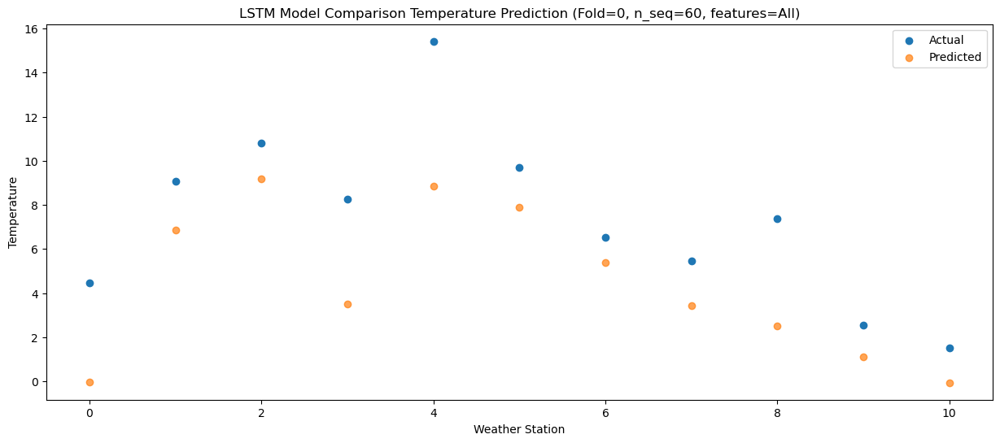

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.66   6.423661
1                 1   13.38  13.321885
2                 2   16.58  15.613616
3                 3   12.77   9.935950
4                 4   20.13  15.285838
5                 5   14.33  14.332475
6                 6   11.59  11.828957
7                 7   10.43   9.885227
8                 8   14.20   8.957879
9                 9   10.73   7.563466
10               10   10.85   6.401067


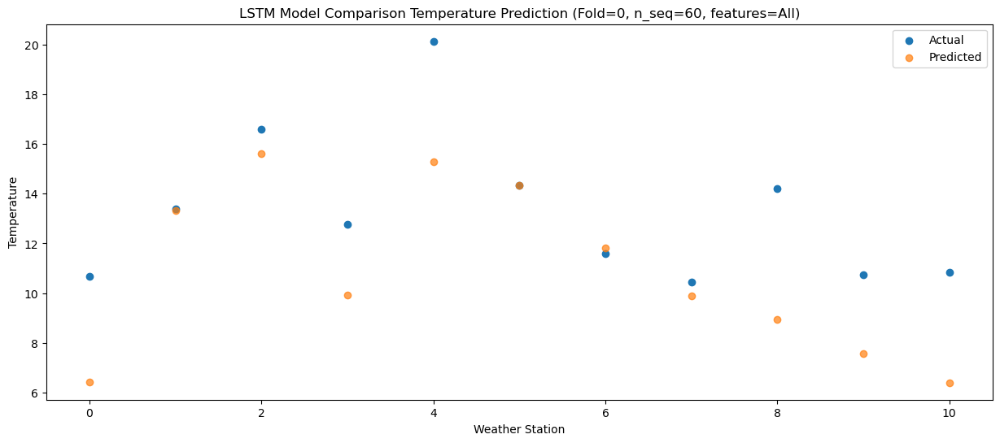

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   13.87   9.813638
1                 1   17.07  16.718757
2                 2   20.36  19.013986
3                 3   15.20  13.333317
4                 4   24.47  18.681697
5                 5   17.90  17.739882
6                 6   15.50  15.239595
7                 7   14.43  13.297167
8                 8   18.72  12.369348
9                 9   14.63  10.976380
10               10   15.61   9.818464


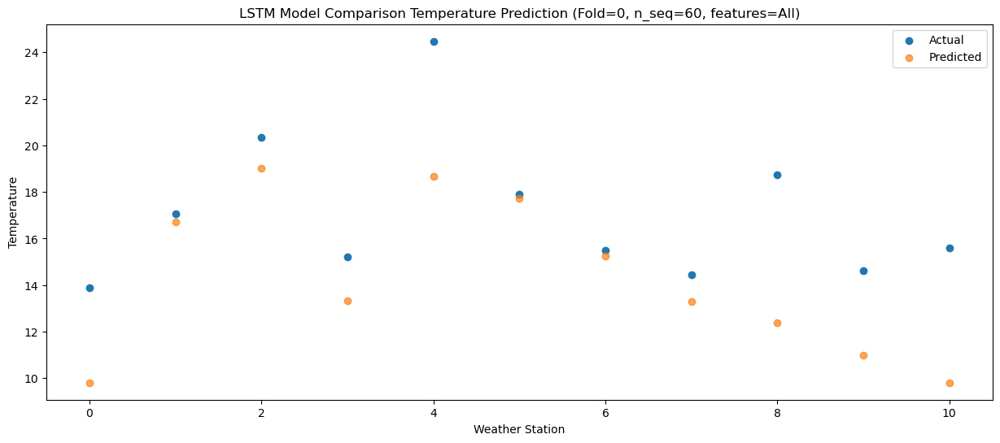

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   16.09  11.445669
1                 1   17.21  18.355953
2                 2   21.28  20.643889
3                 3   15.18  14.961516
4                 4   26.83  20.309681
5                 5   20.04  19.366290
6                 6   16.60  16.864316
7                 7   16.30  14.923004
8                 8   21.05  13.995944
9                 9   16.66  12.604810
10               10   16.72  11.449316


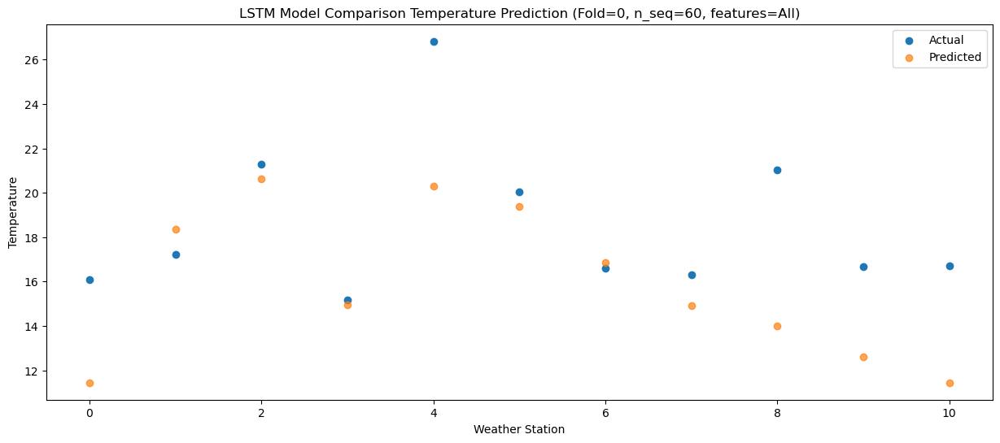

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.91  10.264176
1                 1   16.66  17.186068
2                 2   20.05  19.476966
3                 3   13.99  13.791209
4                 4   24.47  19.141382
5                 5   19.19  18.202419
6                 6   15.31  15.700619
7                 7   14.62  13.756832
8                 8   18.17  12.827357
9                 9   14.75  11.436517
10               10   15.60  10.279288


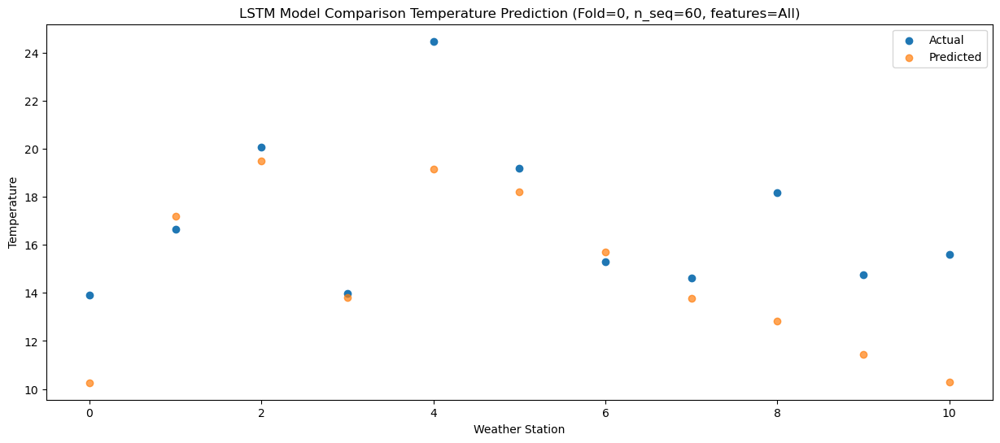

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   10.94   7.169991
1                 1   15.64  14.081340
2                 2   16.93  16.377428
3                 3   12.75  10.683732
4                 4   21.52  16.045490
5                 5   16.54  15.100305
6                 6   12.25  12.598703
7                 7   10.92  10.659009
8                 8   14.53   9.736680
9                 9   11.02   8.340907
10               10   11.76   7.180543


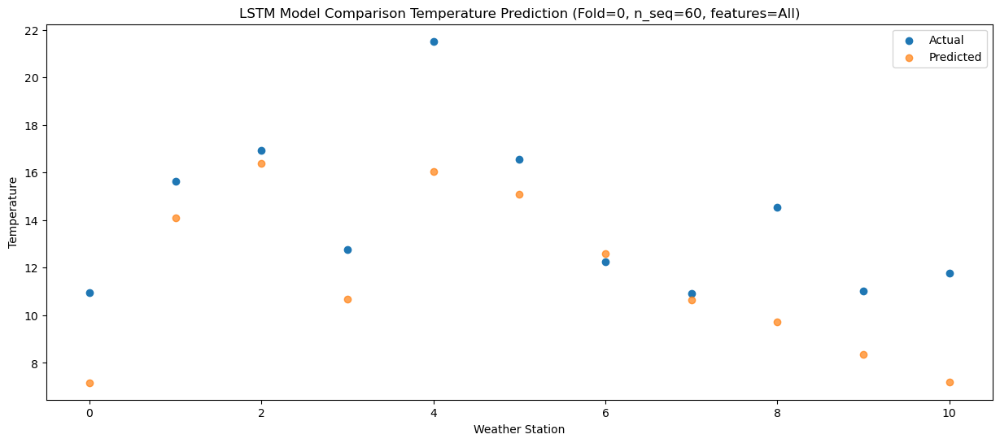

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    5.26   0.663433
1                 1   10.04   7.575316
2                 2    9.79   9.871740
3                 3    7.13   4.175723
4                 4   15.60   9.536397
5                 5    9.98   8.598147
6                 6    5.31   6.096695
7                 7    3.73   4.158002
8                 8    7.97   3.237712
9                 9    3.98   1.841756
10               10    4.52   0.685856


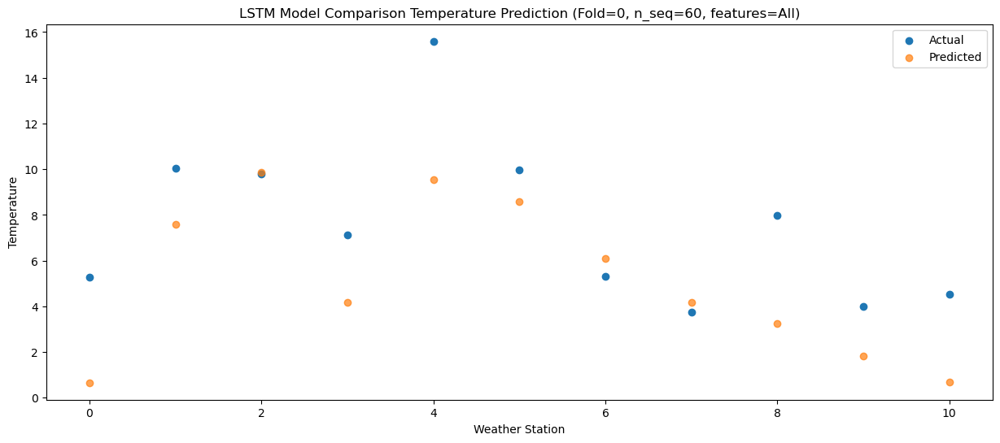

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -3.687498
1                 1    7.35   3.228268
2                 2    7.31   5.521933
3                 3    3.02  -0.174060
4                 4    8.67   5.177996
5                 5    8.29   4.240258
6                 6    3.08   1.743643
7                 7    1.53  -0.196036
8                 8    2.00  -1.114451
9                 9   -1.04  -2.501333
10               10   -0.51  -3.658125


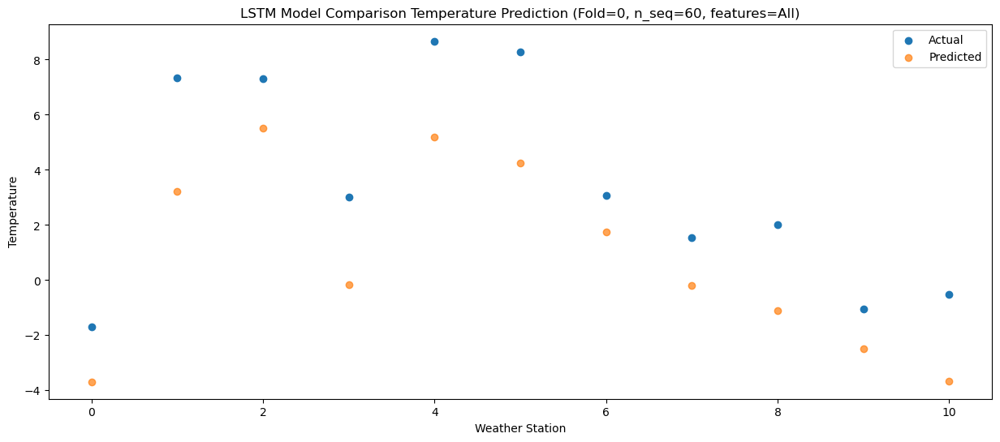

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -3.78  -8.945687
1                 1    3.50  -2.028620
2                 2    2.79   0.267678
3                 3    0.84  -5.426341
4                 4    5.94  -0.073504
5                 5    1.77  -1.015819
6                 6   -3.43  -3.512345
7                 7   -5.64  -5.453919
8                 8   -3.29  -6.376282
9                 9   -6.75  -7.768276
10               10   -6.69  -8.925968


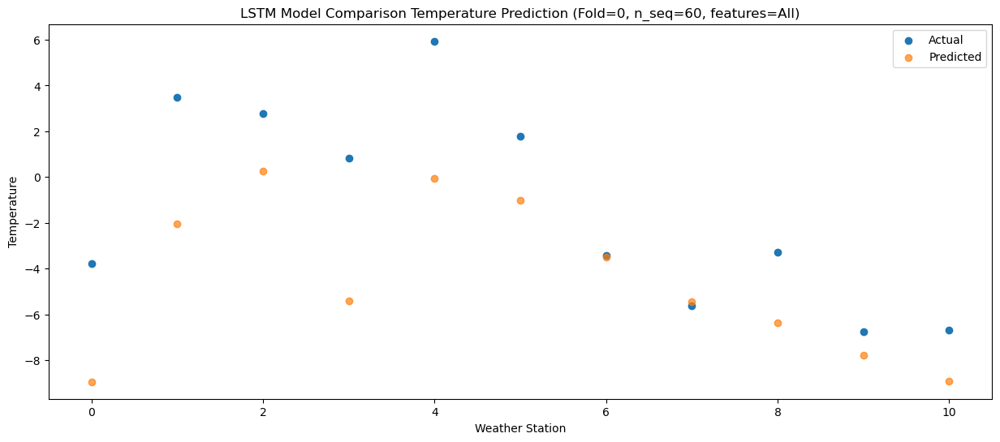

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -2.14  -7.791180
1                 1    4.29  -0.878537
2                 2    4.74   1.417560
3                 3    2.28  -4.282972
4                 4    6.91   1.077833
5                 5    3.46   0.134437
6                 6   -0.24  -2.361150
7                 7   -2.47  -4.301577
8                 8   -0.73  -5.217320
9                 9   -4.86  -6.611610
10               10   -5.56  -7.759045


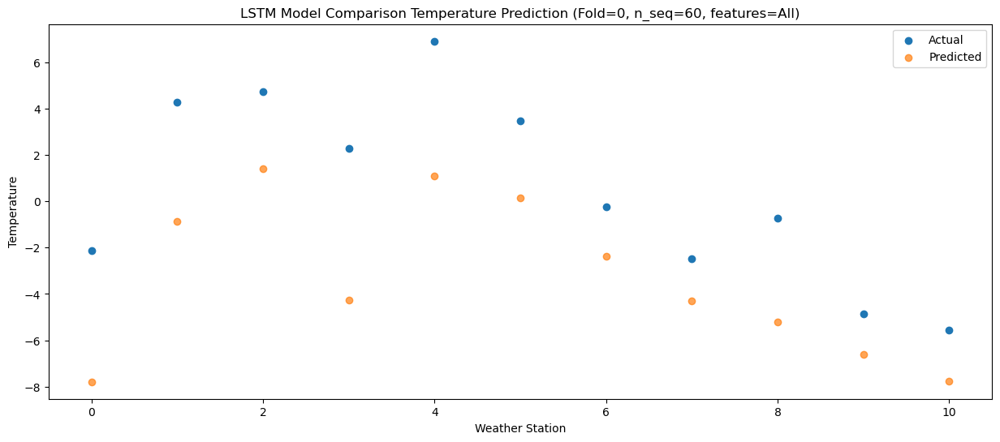

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -0.61  -6.549050
1                 1    5.39   0.365740
2                 2    7.52   2.657067
3                 3    2.69  -3.043730
4                 4    7.04   2.312011
5                 5    4.95   1.367892
6                 6    2.76  -1.123092
7                 7    0.50  -3.064812
8                 8    0.88  -3.981371
9                 9   -2.82  -5.369829
10               10   -5.15  -6.511441


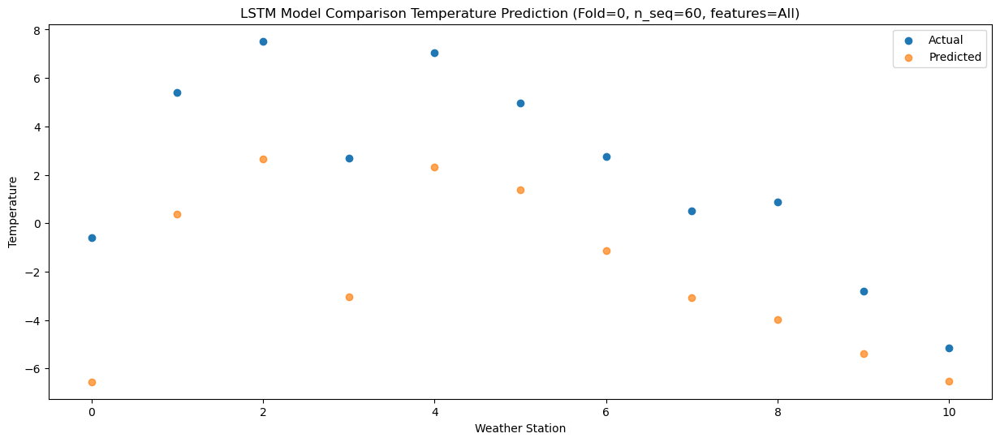

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.76  -4.645513
1                 1    6.98   2.260395
2                 2    7.50   4.561465
3                 3    6.21  -1.145522
4                 4   11.76   4.212746
5                 5    5.86   3.263575
6                 6    3.24   0.772704
7                 7    1.18  -1.168480
8                 8    2.70  -2.082488
9                 9   -2.48  -3.474040
10               10   -3.29  -4.618128


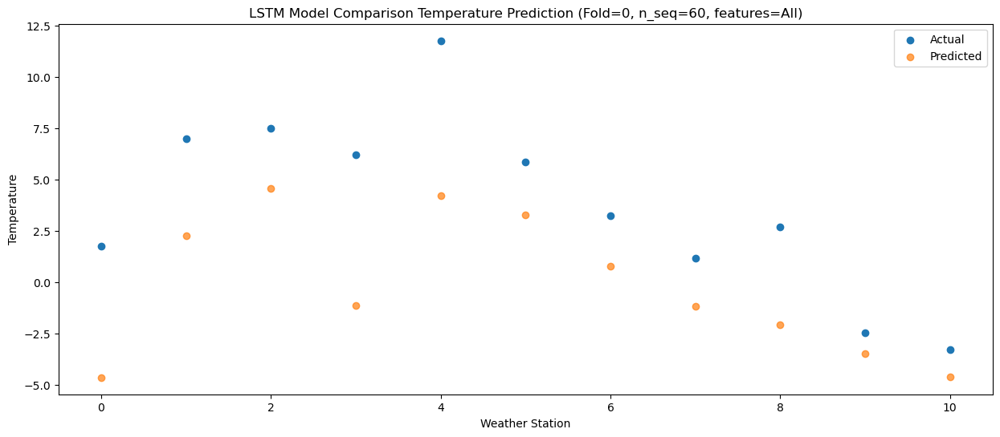

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    4.38   0.653652
1                 1    9.13   7.553618
2                 2   10.57   9.855326
3                 3    7.63   4.144075
4                 4   13.26   9.503081
5                 5   10.54   8.555461
6                 6    6.80   6.063487
7                 7    5.80   4.123142
8                 8    8.48   3.210983
9                 9    3.80   1.821659
10               10    3.56   0.676429


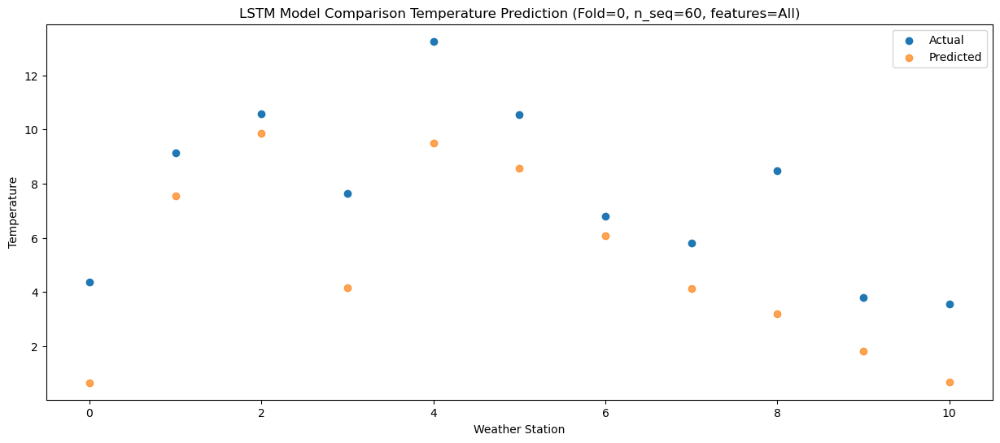

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    9.85   4.084713
1                 1   12.31  10.977107
2                 2   13.98  13.273489
3                 3   12.06   7.562376
4                 4   18.79  12.924878
5                 5   12.06  11.969735
6                 6    9.49   9.479262
7                 7    8.09   7.539840
8                 8   14.07   6.631226
9                 9    8.76   5.247874
10               10    8.58   4.112827


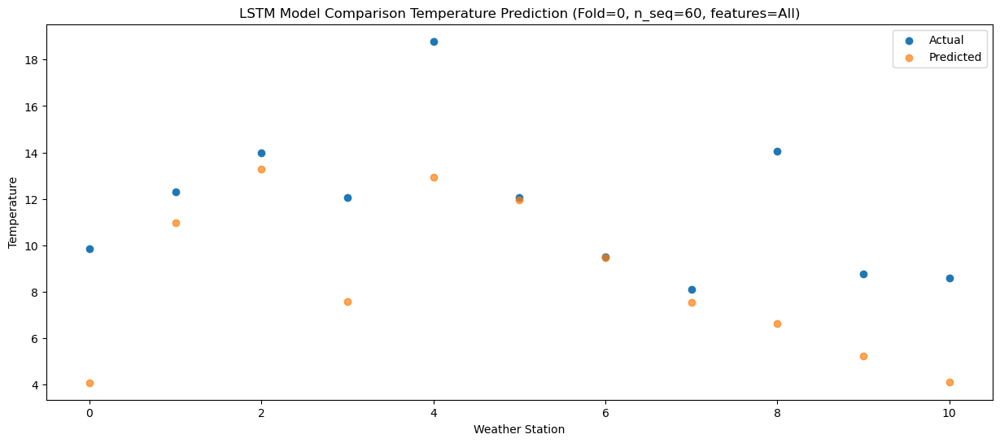

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   13.63   8.155634
1                 1   15.39  15.046657
2                 2   17.30  17.345211
3                 3   15.81  11.631439
4                 4   23.34  16.997409
5                 5   15.88  16.039736
6                 6   12.84  13.549620
7                 7   11.84  11.610850
8                 8   17.94  10.708312
9                 9   12.60   9.326649
10               10   14.09   8.197945


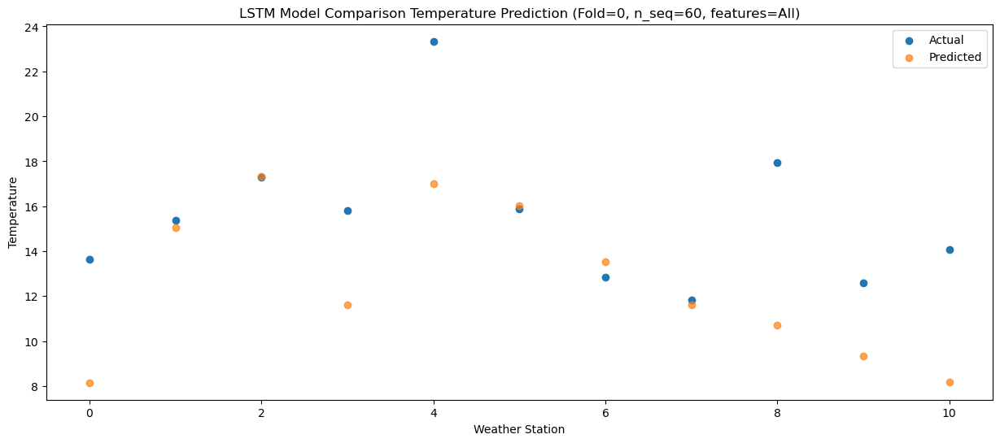

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   15.17  10.503551
1                 1   17.22  17.387222
2                 2   20.40  19.684968
3                 3   16.93  13.962118
4                 4   26.33  19.331643
5                 5   19.71  18.375805
6                 6   16.55  15.885197
7                 7   15.98  13.948371
8                 8   19.43  13.042769
9                 9   15.43  11.664991
10               10   16.55  10.546276


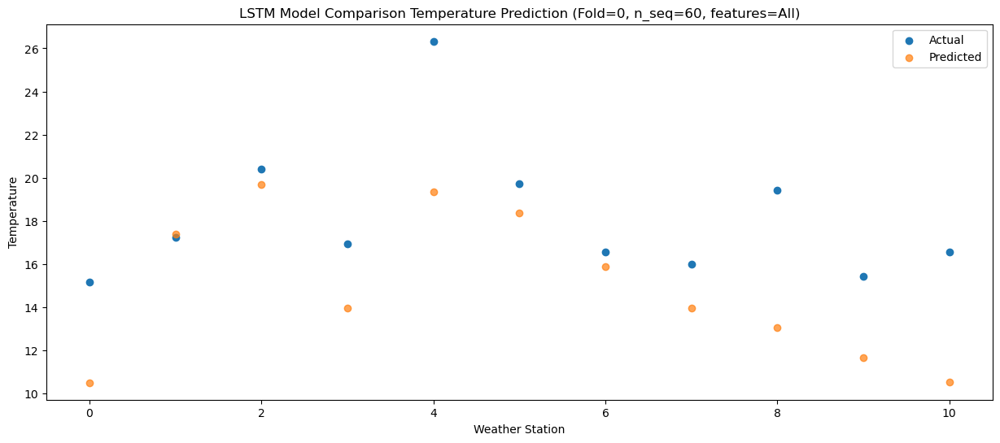

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   15.89   9.893629
1                 1   18.81  16.784374
2                 2   20.01  19.074463
3                 3   18.46  13.356703
4                 4   28.07  18.734629
5                 5   19.23  17.773920
6                 6   15.86  15.278732
7                 7   14.84  13.335669
8                 8   18.17  12.438277
9                 9   14.63  11.049208
10               10   14.74   9.932934


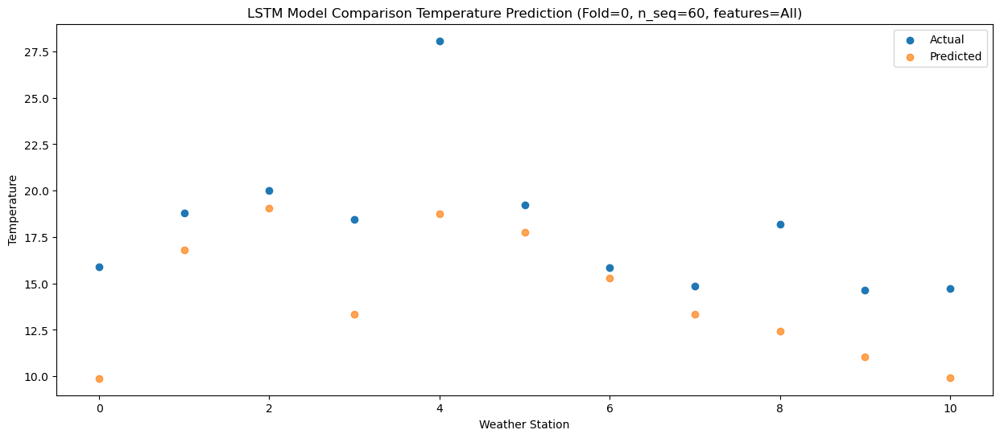

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   11.66   7.186625
1                 1   15.43  14.078906
2                 2   16.56  16.372263
3                 3   15.02  10.645211
4                 4   23.59  16.022895
5                 5   15.71  15.059062
6                 6   12.35  12.569635
7                 7   11.08  10.628702
8                 8   15.00   9.735877
9                 9   12.02   8.347030
10               10   12.36   7.231566


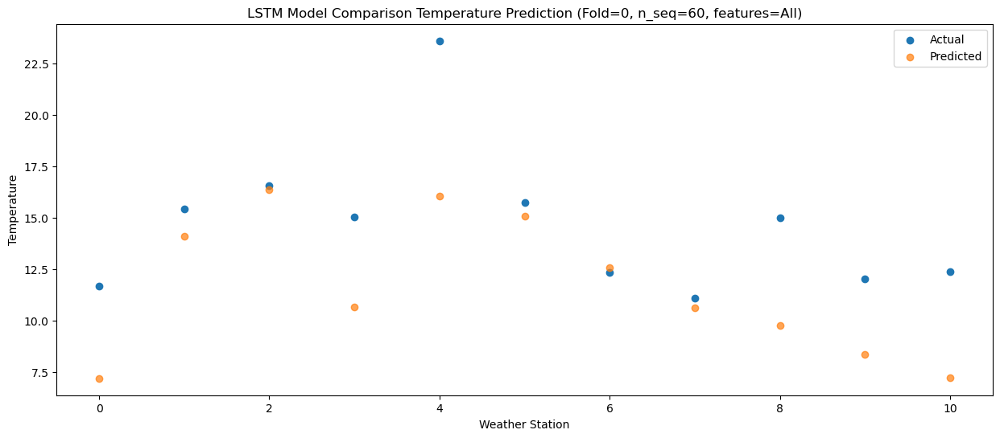

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    6.60   1.336215
1                 1   10.32   8.232606
2                 2   10.58  10.523243
3                 3    8.77   4.792843
4                 4   15.93  10.172139
5                 5   11.36   9.209211
6                 6    7.14   6.720038
7                 7    5.69   4.777578
8                 8    9.40   3.884677
9                 9    5.44   2.499170
10               10    6.40   1.386356


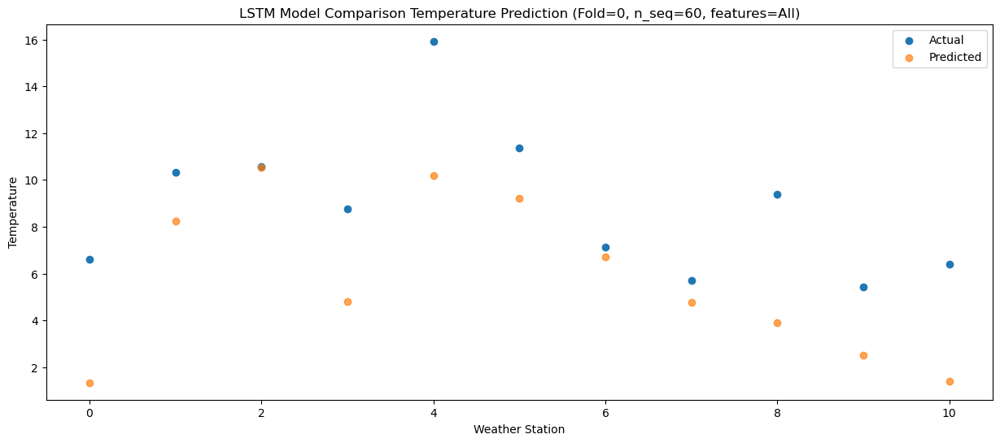

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -0.26  -4.991970
1                 1    5.08   1.902700
2                 2    5.49   4.190579
3                 3    2.91  -1.538841
4                 4    9.57   3.842438
5                 5    5.92   2.876409
6                 6    1.27   0.387909
7                 7   -0.76  -1.553620
8                 8    2.41  -2.447056
9                 9   -1.06  -3.830510
10               10   -1.24  -4.949819


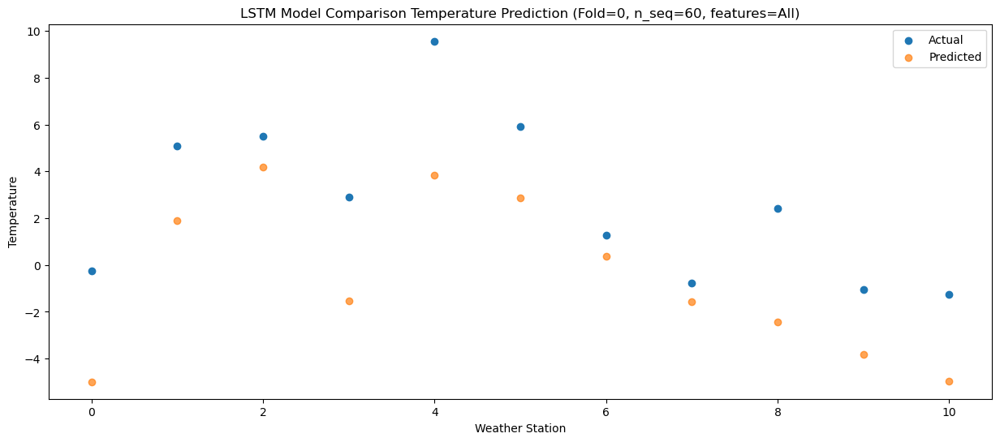

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -2.86  -6.521957
1                 1    2.38   0.372543
2                 2    2.46   2.661801
3                 3    0.12  -3.067301
4                 4    6.78   2.312023
5                 5    3.78   1.342144
6                 6   -1.02  -1.147294
7                 7   -2.35  -3.091291
8                 8   -0.15  -3.979972
9                 9   -3.49  -5.362363
10               10   -1.92  -6.478324


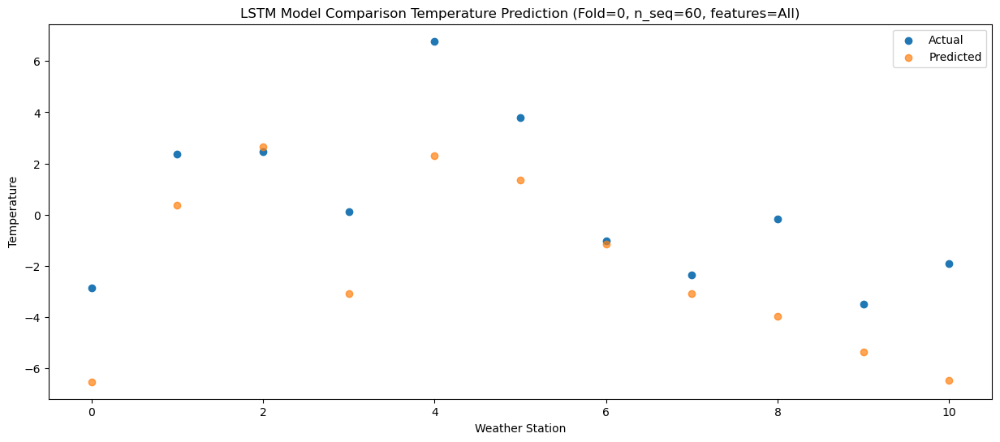

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -7.98 -10.999956
1                 1    0.11  -4.106104
2                 2   -0.05  -1.810108
3                 3   -2.76  -7.543869
4                 4    1.80  -2.150544
5                 5    2.51  -3.126643
6                 6   -3.15  -5.617299
7                 7   -5.05  -7.563084
8                 8   -6.41  -8.451698
9                 9   -9.25  -9.841903
10               10   -8.84 -10.954405


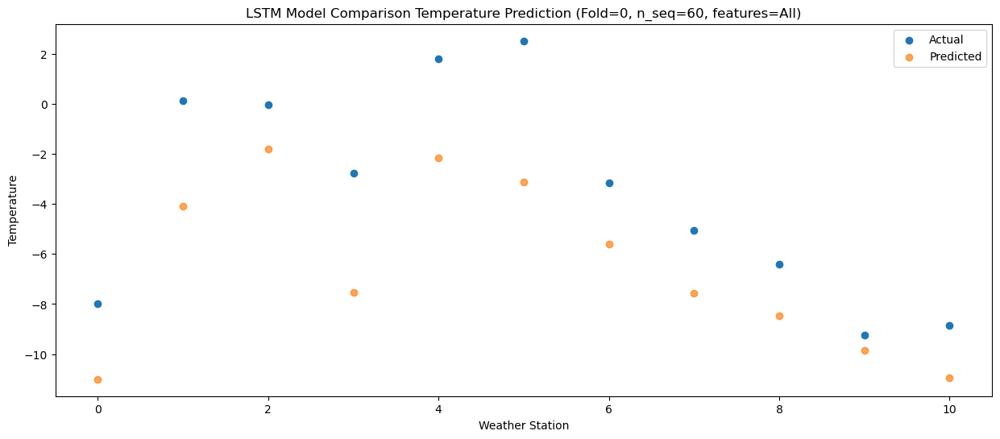

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -0.10  -7.225495
1                 1    2.61  -0.336022
2                 2    4.46   1.961064
3                 3    1.89  -3.774284
4                 4    9.67   1.625524
5                 5    3.03   0.639416
6                 6    0.41  -1.853147
7                 7   -1.91  -3.800443
8                 8    2.21  -4.682280
9                 9   -3.11  -6.069860
10               10   -3.83  -7.173640


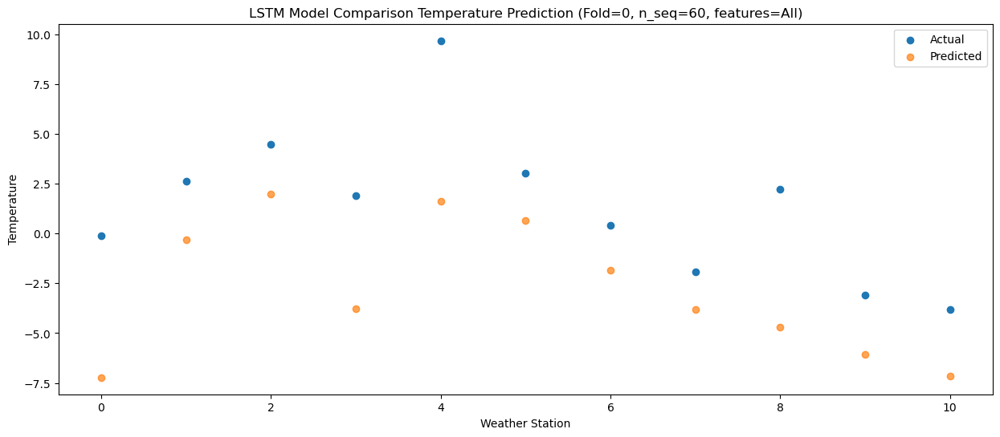

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    1.65  -3.993835
1                 1    5.91   2.888522
2                 2    8.84   5.183615
3                 3    4.83  -0.560538
4                 4   12.22   4.841492
5                 5    7.08   3.854473
6                 6    4.25   1.366855
7                 7    2.24  -0.576428
8                 8    5.49  -1.457100
9                 9    0.21  -2.842168
10               10   -0.33  -3.941678


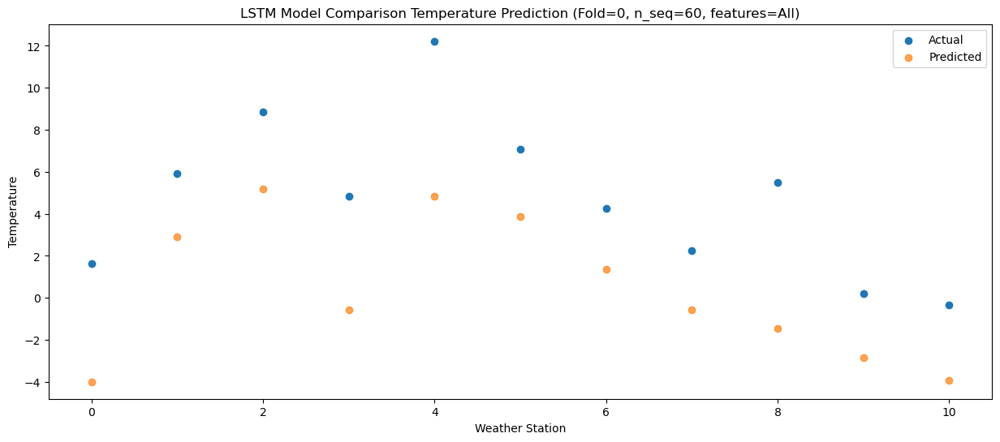

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    6.42  -0.007423
1                 1    8.79   6.872861
2                 2   12.53   9.171489
3                 3    8.40   3.417753
4                 4   15.49   8.821266
5                 5   10.30   7.839277
6                 6    7.84   5.352214
7                 7    6.72   3.412804
8                 8   10.37   2.529540
9                 9    5.43   1.143958
10               10    5.01   0.045392


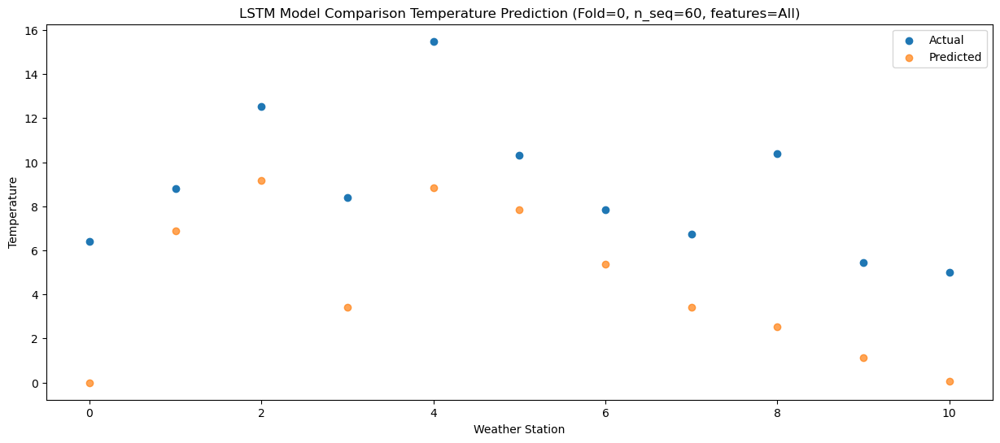

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   11.33   5.335273
1                 1   13.28  12.201095
2                 2   17.01  14.503900
3                 3   12.79   8.749696
4                 4   20.07  14.161301
5                 5   15.11  13.166514
6                 6   11.84  10.684620
7                 7   10.68   8.744609
8                 8   15.44   7.866757
9                 9   11.23   6.477074
10               10   11.98   5.380930


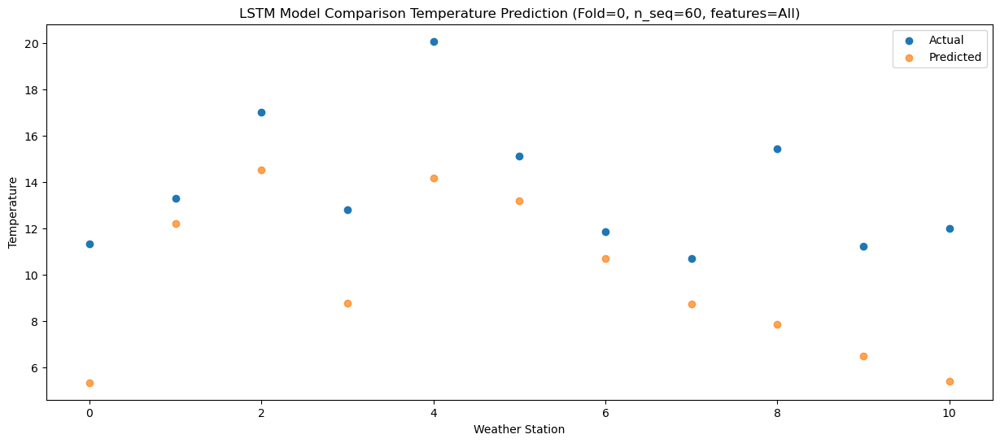

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   13.94   8.686410
1                 1   16.21  15.557344
2                 2   21.25  17.862167
3                 3   14.91  12.108311
4                 4   23.57  17.521586
5                 5   18.54  16.523002
6                 6   15.75  14.044406
7                 7   14.70  12.105493
8                 8   18.37  11.227180
9                 9   14.99   9.834022
10               10   16.30   8.733929


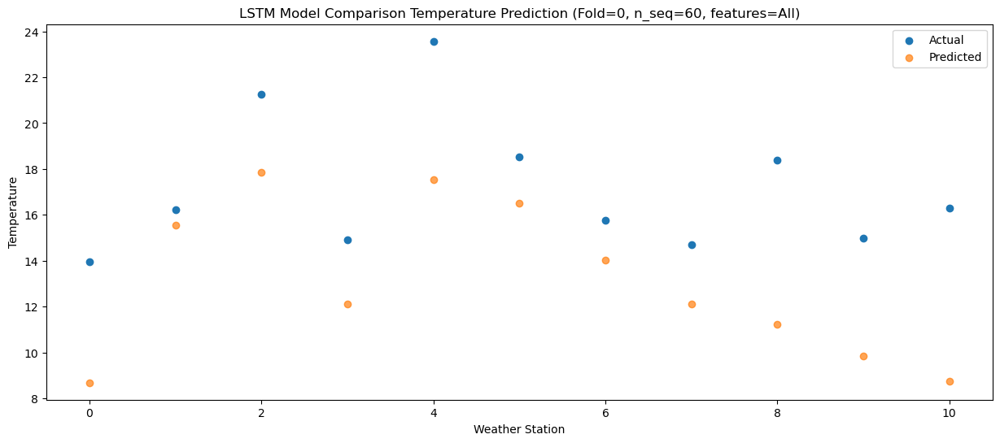

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   14.82   9.216951
1                 1   17.34  16.087742
2                 2   21.52  18.392044
3                 3   14.85  12.634255
4                 4   23.43  18.048062
5                 5   20.20  17.049796
6                 6   17.01  14.570239
7                 7   15.92  12.625740
8                 8   18.92  11.745887
9                 9   15.83  10.350579
10               10   17.19   9.256512


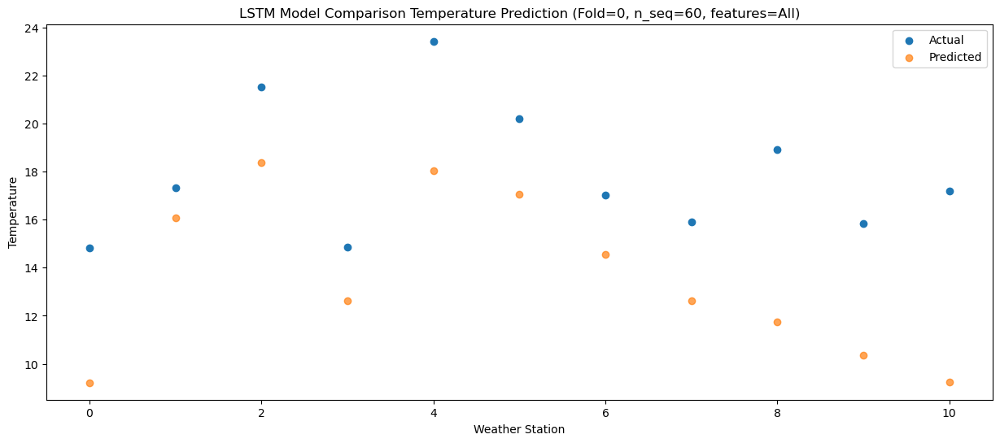

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   15.16   8.623392
1                 1   17.73  15.494602
2                 2   19.84  17.799246
3                 3   15.66  12.040316
4                 4   25.11  17.452182
5                 5   18.93  16.460368
6                 6   15.26  13.980192
7                 7   14.08  12.036027
8                 8   18.86  11.160993
9                 9   15.50   9.768357
10               10   16.44   8.674313


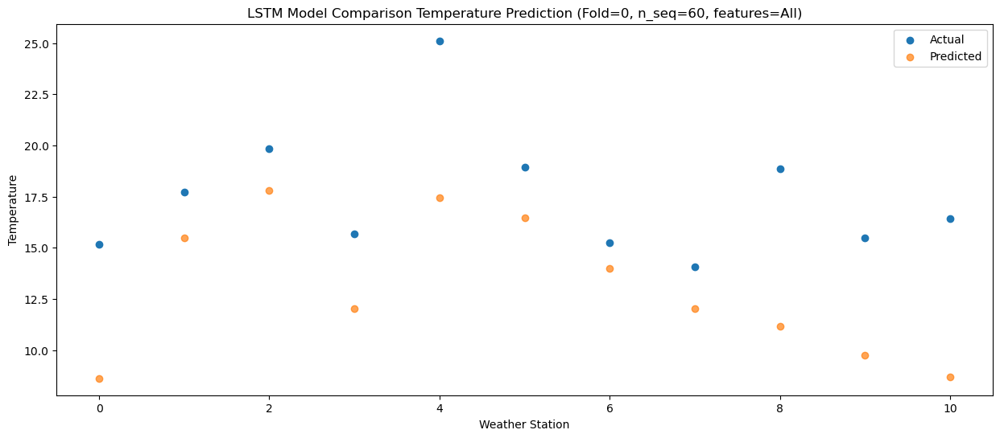

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   11.02   5.608450
1                 1   14.49  12.481202
2                 2   17.07  14.784791
3                 3   13.07   9.027072
4                 4   21.19  14.435256
5                 5   16.99  13.448192
6                 6   12.83  10.971387
7                 7   11.15   9.029026
8                 8   15.24   8.160128
9                 9   13.31   6.772972
10               10   13.66   5.688194


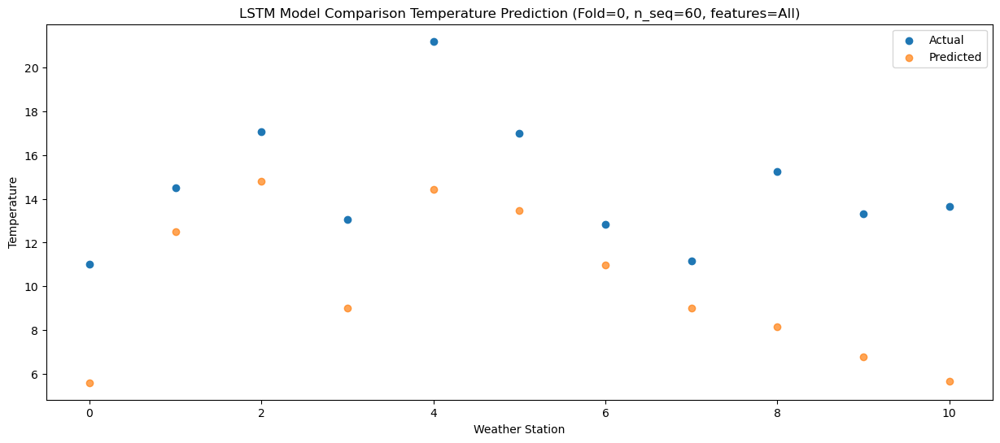

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    7.75   0.988813
1                 1   11.17   7.862468
2                 2   11.17  10.164170
3                 3    8.93   4.399879
4                 4   18.74   9.806752
5                 5   11.96   8.826834
6                 6    7.56   6.350132
7                 7    5.32   4.407294
8                 8    9.81   3.538027
9                 9    6.57   2.154249
10               10    7.43   1.072775


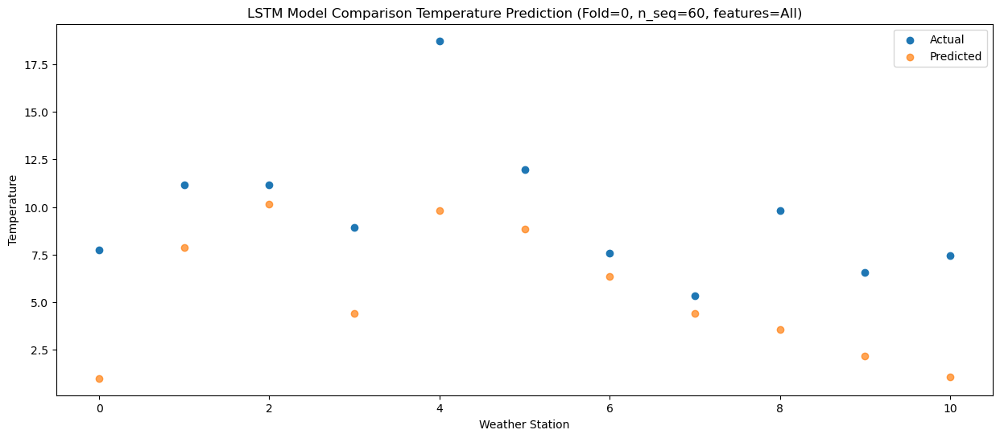

f, t:
[[-2.980e+00  3.390e+00  4.930e+00  1.130e+00  7.340e+00  4.630e+00
   6.800e-01 -1.370e+00 -9.500e-01 -4.560e+00 -5.060e+00]
 [-3.450e+00  2.490e+00  4.820e+00  1.110e+00  5.290e+00  4.060e+00
   3.200e-01 -1.740e+00 -1.110e+00 -4.380e+00 -5.730e+00]
 [-3.720e+00  2.110e+00  4.200e+00  1.150e+00  6.030e+00  3.530e+00
  -1.500e-01 -1.860e+00 -2.300e+00 -5.660e+00 -6.760e+00]
 [-3.370e+00  2.860e+00  4.820e+00  1.150e+00  5.360e+00  3.220e+00
   9.600e-01 -8.200e-01 -1.800e+00 -6.530e+00 -8.220e+00]
 [ 3.210e+00  8.690e+00  1.107e+01  8.070e+00  1.311e+01  6.810e+00
   6.380e+00  4.760e+00  4.770e+00  6.600e-01 -2.080e+00]
 [ 3.860e+00  9.180e+00  1.083e+01  8.150e+00  1.336e+01  8.780e+00
   7.620e+00  5.660e+00  7.050e+00  2.320e+00  5.700e-01]
 [ 8.590e+00  1.195e+01  1.452e+01  1.104e+01  1.834e+01  1.247e+01
   9.960e+00  8.780e+00  1.193e+01  7.410e+00  7.000e+00]
 [ 1.281e+01  1.570e+01  1.824e+01  1.395e+01  2.254e+01  1.682e+01
   1.521e+01  1.430e+01  1.786e+01  1.439e+0

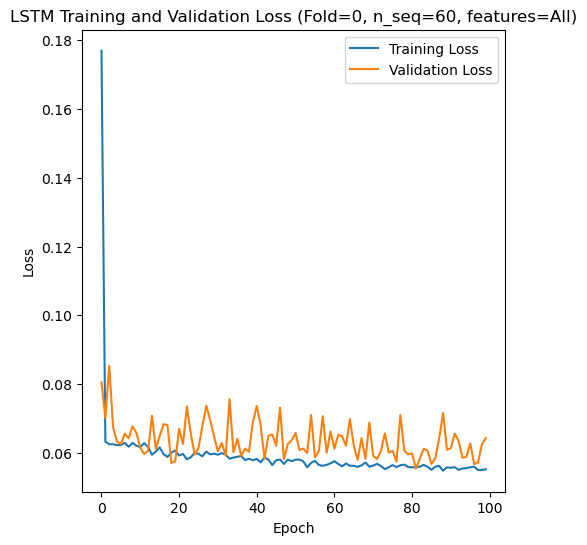

[[12.2  10.03 13.86 ... 24.46 19.58 17.03]
 [ 8.35  6.22 11.74 ... 22.47 18.02 13.98]
 [10.82  7.37 13.36 ... 24.57 19.57 16.15]
 ...
 [ 7.69  4.56 11.66 ... 25.3  19.83 13.28]
 [ 8.93  6.7  14.14 ... 25.37 21.51 12.55]
 [ 7.96  5.46 11.14 ... 25.13 20.28 10.63]]
Epoch 1/100
84/84 [==============================] - 47s 335ms/step - loss: 0.1555 - accuracy: 0.4167 - mae: 0.1248 - rmse: 0.1555 - mape: inf - pearson: 0.6615 - val_loss: 0.0643 - val_accuracy: 0.6000 - val_mae: 0.0520 - val_rmse: 0.0643 - val_mape: 11.6361 - val_pearson: 0.8488
Epoch 2/100
84/84 [==============================] - 17s 199ms/step - loss: 0.0623 - accuracy: 0.4881 - mae: 0.0492 - rmse: 0.0623 - mape: inf - pearson: 0.8219 - val_loss: 0.0712 - val_accuracy: 0.0000e+00 - val_mae: 0.0551 - val_rmse: 0.0712 - val_mape: 12.8682 - val_pearson: 0.8099
Epoch 3/100
84/84 [==============================] - 17s 204ms/step - loss: 0.0626 - accuracy: 0.4762 - mae: 0.0492 - rmse: 0.0626 - mape: inf - pearson: 0.8223 - val_l

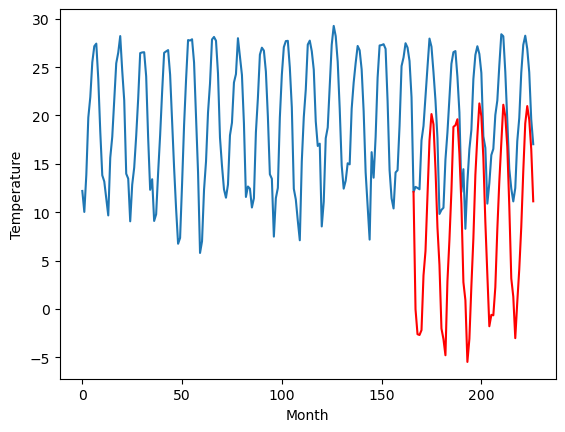

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.52		4.20		0.68
2.61		1.63		-0.98
1.50		1.54		0.04
1.59		2.05		0.46
7.59		7.70		0.11
8.81		10.23		1.42
12.16		15.95		3.79
16.51		21.63		5.12
19.88		24.38		4.50
18.47		23.32		4.85
14.93		18.74		3.81
11.21		12.66		1.45
7.11		8.79		1.68
0.22		2.22		2.00
0.02		1.13		1.11
0.68		-0.55		-1.23
7.45		7.12		-0.33
9.59		11.40		1.81
13.32		16.47		3.15
17.46		23.07		5.61
18.84		23.23		4.39
19.11		23.86		4.75
15.37		20.29		4.92
11.59		15.10		3.51
3.93		7.01		3.08
5.56		5.14		-0.42
-1.17		-1.24		-0.07
3.06		1.15		-1.91
6.63		6.61		-0.02
9.63		11.53		1.90
15.51		18.10		2.59
19.48		22.12		2.64
19.98		25.49		5.51
18.52		24.17		5.65
15.43		19.88		4.45
9.09		13.21		4.12
6.09		7.79		1.70
0.28		2.44		2.16
2.47		3.62		1.15
5.84		3.58		-2.26
6.61		6.49		-0.12
9.88		12.45		2.57
13.16		17.41		4.25
16.35		21.39		5.04
19.95		25.35		5.40
19.41		24.16		4.75
15.90		21.01		5.11
10.89		14.86		3.97
5.27		7.39		2.12
2.13		5.5

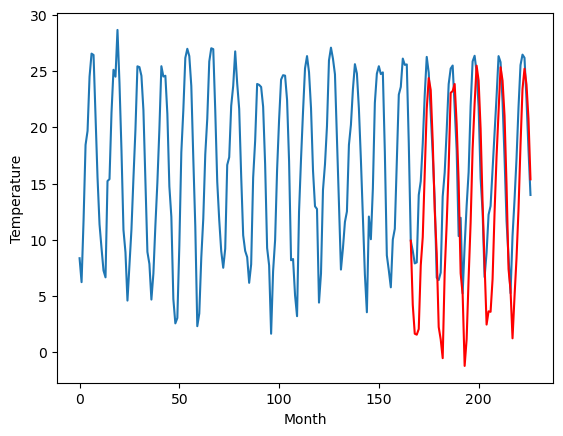

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.48		0.35		1.83
-1.05		-2.21		-1.16
-1.58		-2.30		-0.72
-1.30		-1.80		-0.50
5.80		3.86		-1.94
4.83		6.38		1.55
8.98		12.11		3.13
13.21		17.78		4.57
14.68		20.53		5.85
14.67		19.48		4.81
11.87		14.90		3.03
7.52		8.82		1.30
2.72		4.96		2.24
-4.34		-1.60		2.74
-3.92		-2.70		1.22
-3.43		-4.38		-0.95
3.63		3.28		-0.35
5.03		7.57		2.54
9.15		12.64		3.49
13.03		19.24		6.21
13.80		19.41		5.61
14.46		20.03		5.57
11.44		16.47		5.03
7.66		11.28		3.62
-0.08		3.19		3.27
2.52		1.32		-1.20
-4.37		-5.06		-0.69
-1.02		-2.68		-1.66
2.98		2.79		-0.19
6.57		7.71		1.14
11.93		14.29		2.36
14.90		18.31		3.41
15.61		21.68		6.07
14.00		20.36		6.36
11.61		16.07		4.46
4.92		9.40		4.48
1.60		3.97		2.37
-1.56		-1.38		0.18
-0.56		-0.20		0.36
2.03		-0.24		-2.27
3.46		2.67		-0.79
6.15		8.63		2.48
9.39		13.59		4.20
13.14		17.57		4.43
15.51		21.52		6.01
15.95		20.33		4.38
12.99		17.19		4.20
6.95		11.03		4.08
0.39		3.56		3.1

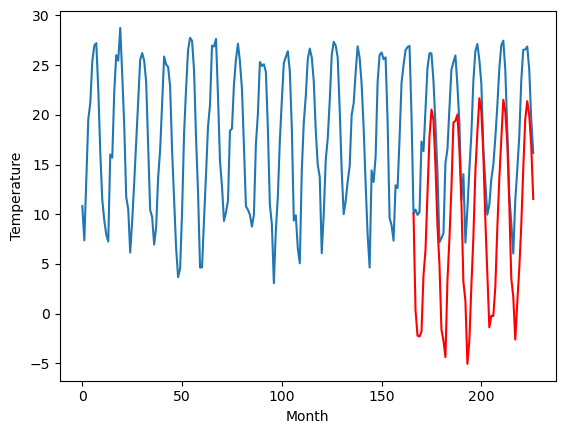

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.05		2.83		-1.22
2.63		0.27		-2.36
3.38		0.19		-3.19
2.85		0.68		-2.17
10.49		6.34		-4.15
10.37		8.86		-1.51
14.12		14.58		0.46
16.90		20.26		3.36
18.55		23.01		4.46
18.79		21.96		3.17
15.38		17.38		2.00
10.84		11.30		0.46
7.94		7.43		-0.51
1.76		0.88		-0.88
1.66		-0.22		-1.88
0.07		-1.89		-1.96
7.44		5.76		-1.68
9.78		10.05		0.27
13.67		15.10		1.43
17.56		21.71		4.15
17.44		21.88		4.44
18.41		22.51		4.10
15.40		18.95		3.55
12.71		13.76		1.05
5.55		5.68		0.13
8.92		3.79		-5.13
0.87		-2.59		-3.46
0.40		-0.22		-0.62
6.24		5.25		-0.99
12.24		10.18		-2.06
16.67		16.74		0.07
19.67		20.76		1.09
20.61		24.13		3.52
18.97		22.80		3.83
16.20		18.51		2.31
10.64		11.84		1.20
5.59		6.41		0.82
3.50		1.06		-2.44
4.21		2.24		-1.97
5.21		2.19		-3.02
9.04		5.11		-3.93
9.88		11.06		1.18
14.47		16.02		1.55
18.62		19.99		1.37
20.34		23.94		3.60
22.31		22.75		0.44
19.23		19.60		0.37
11.97		13.44		1.47
5.69		5.97	

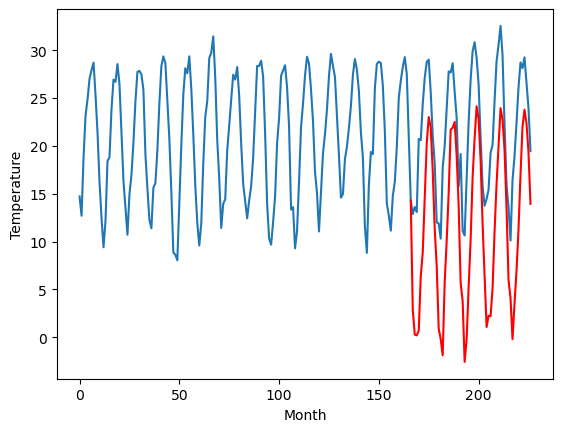

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.11		6.73		-1.38
6.22		4.17		-2.05
7.03		4.08		-2.95
6.65		4.58		-2.07
14.69		10.23		-4.46
14.43		12.76		-1.67
18.23		18.48		0.25
21.26		24.16		2.90
23.30		26.91		3.61
23.54		25.87		2.33
19.96		21.29		1.33
15.02		15.20		0.18
11.92		11.34		-0.58
5.56		4.78		-0.78
5.55		3.69		-1.86
3.85		2.01		-1.84
11.46		9.66		-1.80
13.76		13.94		0.18
17.88		18.99		1.11
21.35		25.60		4.25
21.44		25.78		4.34
22.41		26.41		4.00
18.83		22.85		4.02
15.79		17.67		1.88
8.24		9.58		1.34
12.12		7.70		-4.42
3.64		1.31		-2.33
3.33		3.68		0.35
9.11		9.14		0.03
15.38		14.08		-1.30
20.00		20.64		0.64
23.37		24.65		1.28
24.46		28.02		3.56
22.45		26.70		4.25
19.27		22.40		3.13
13.88		15.72		1.84
8.88		10.29		1.41
6.86		4.94		-1.92
7.34		6.12		-1.22
8.52		6.07		-2.45
12.34		8.99		-3.35
13.30		14.94		1.64
17.94		19.89		1.95
22.83		23.86		1.03
24.78		27.80		3.02
26.21		26.60		0.39
22.36		23.46		1.10
14.96		17.30		2.34
8.76		9

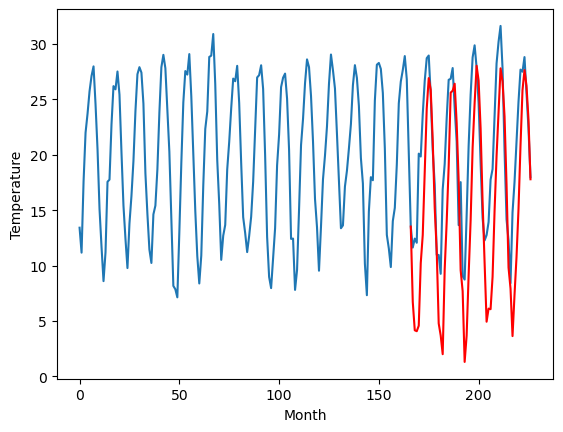

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.80		5.44		-2.36
5.77		2.87		-2.90
5.11		2.79		-2.32
4.59		3.28		-1.31
11.94		8.94		-3.00
14.73		11.48		-3.25
19.92		17.20		-2.72
22.64		22.88		0.24
25.34		25.63		0.29
25.19		24.59		-0.60
17.66		20.01		2.35
14.82		13.93		-0.89
11.10		10.07		-1.03
4.35		3.51		-0.84
2.84		2.41		-0.43
3.22		0.73		-2.49
10.56		8.38		-2.18
12.83		12.67		-0.16
18.42		17.72		-0.70
22.69		24.33		1.64
22.03		24.50		2.47
21.44		25.13		3.69
21.08		21.58		0.50
16.76		16.40		-0.36
10.29		8.32		-1.97
10.55		6.44		-4.11
3.23		0.06		-3.17
3.12		2.43		-0.69
10.07		7.90		-2.17
16.98		12.83		-4.15
22.38		19.39		-2.99
24.44		23.40		-1.04
25.36		26.77		1.41
22.51		25.44		2.93
19.46		21.14		1.68
13.38		14.45		1.07
6.42		9.02		2.60
5.30		3.66		-1.64
5.76		4.84		-0.92
5.90		4.78		-1.12
10.96		7.70		-3.26
14.12		13.64		-0.48
18.73		18.59		-0.14
25.42		22.56		-2.86
26.52		26.49		-0.03
25.71		25.29		-0.42
23.43		22.15		-1.28
15.83		15

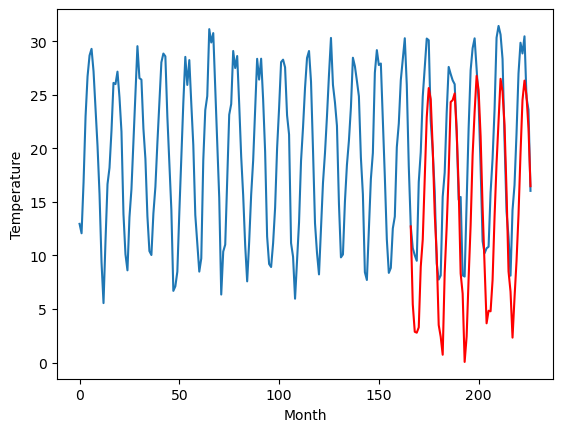

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.88		4.96		1.08
3.15		2.39		-0.76
2.34		2.31		-0.03
2.41		2.80		0.39
8.08		8.46		0.38
9.71		10.99		1.28
12.49		16.71		4.22
17.16		22.39		5.23
20.34		25.14		4.80
18.71		24.09		5.38
15.29		19.51		4.22
11.80		13.43		1.63
7.65		9.57		1.92
0.44		3.01		2.57
0.24		1.90		1.66
1.02		0.22		-0.80
7.30		7.87		0.57
9.87		12.16		2.29
13.64		17.21		3.57
17.65		23.81		6.16
19.01		23.98		4.97
19.27		24.60		5.33
15.94		21.05		5.11
11.99		15.87		3.88
4.39		7.78		3.39
5.91		5.90		-0.01
-0.48		-0.48		0.00
3.33		1.90		-1.43
7.17		7.36		0.19
9.93		12.28		2.35
15.85		18.85		3.00
19.43		22.86		3.43
20.17		26.23		6.06
18.67		24.90		6.23
15.78		20.60		4.82
9.44		13.91		4.47
6.55		8.48		1.93
0.54		3.13		2.59
2.67		4.31		1.64
6.26		4.26		-2.00
6.93		7.17		0.24
10.19		13.12		2.93
13.19		18.07		4.88
16.47		22.04		5.57
19.92		25.98		6.06
19.50		24.78		5.28
16.33		21.64		5.31
11.32		15.47		4.15
5.63		8.00		2.37
2.89		6.11		

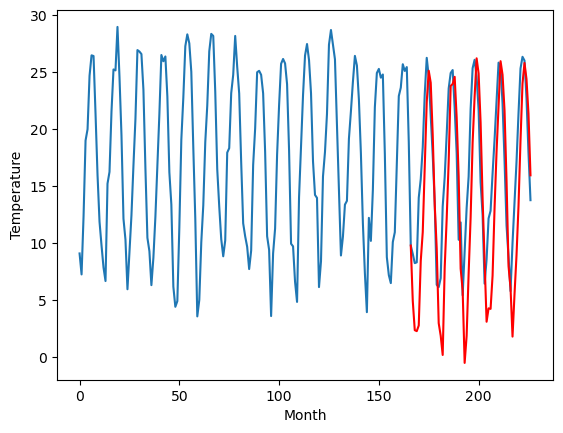

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.92		1.13		0.21
0.30		-1.44		-1.74
-0.55		-1.52		-0.97
0.13		-1.03		-1.16
7.05		4.63		-2.42
8.19		7.17		-1.02
12.69		12.89		0.20
18.25		18.57		0.32
20.79		21.32		0.53
18.77		20.26		1.49
15.47		15.70		0.23
8.70		9.61		0.91
5.03		5.75		0.72
-1.57		-0.82		0.75
-1.88		-1.93		-0.05
-4.88		-3.61		1.27
6.44		4.05		-2.39
8.15		8.33		0.18
12.81		13.39		0.58
18.89		19.99		1.10
19.88		20.16		0.28
21.10		20.79		-0.31
17.39		17.23		-0.16
12.19		12.04		-0.15
2.89		3.96		1.07
5.30		2.08		-3.22
-3.53		-4.30		-0.77
-1.48		-1.93		-0.45
4.47		3.53		-0.94
9.66		8.46		-1.20
15.13		15.02		-0.11
19.19		19.04		-0.15
23.32		22.41		-0.91
20.45		21.07		0.62
16.61		16.76		0.15
9.94		10.07		0.13
3.34		4.64		1.30
-0.40		-0.72		-0.32
0.79		0.46		-0.33
2.29		0.41		-1.88
5.12		3.33		-1.79
9.52		9.28		-0.24
14.87		14.23		-0.64
18.68		18.20		-0.48
20.98		22.13		1.15
21.48		20.94		-0.54
17.86		17.80		-0.06
11.55		11.64		0.09
4

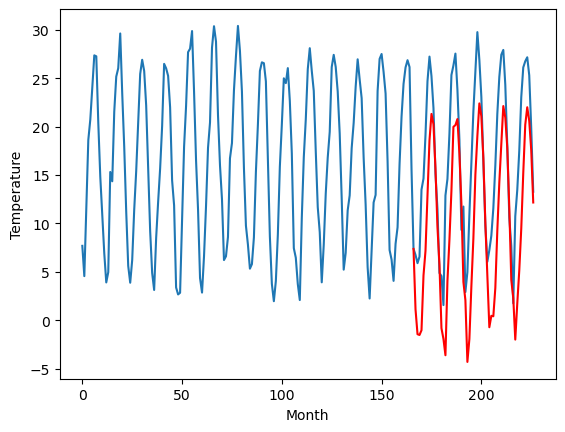

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.44		-0.29		-0.73
-1.41		-2.87		-1.46
-1.23		-2.95		-1.72
-1.74		-2.46		-0.72
6.09		3.21		-2.88
7.47		5.75		-1.72
13.58		11.46		-2.12
18.69		17.15		-1.54
21.23		19.89		-1.34
20.30		18.84		-1.46
13.65		14.27		0.62
7.47		8.19		0.72
4.59		4.33		-0.26
-2.09		-2.24		-0.15
-2.44		-3.35		-0.91
-7.22		-5.04		2.18
5.34		2.63		-2.71
7.14		6.90		-0.24
11.95		11.97		0.02
17.98		18.57		0.59
19.49		18.75		-0.74
19.88		19.37		-0.51
17.37		15.81		-1.56
11.12		10.62		-0.50
3.37		2.55		-0.82
2.56		0.66		-1.90
-5.06		-5.72		-0.66
-4.08		-3.35		0.73
3.17		2.11		-1.06
10.28		7.04		-3.24
15.64		13.60		-2.04
19.93		17.61		-2.32
24.08		20.98		-3.10
21.41		19.64		-1.77
17.58		15.33		-2.25
9.35		8.64		-0.71
1.50		3.20		1.70
-2.13		-2.16		-0.03
-1.27		-0.98		0.29
-0.90		-1.03		-0.13
3.53		1.89		-1.64
7.86		7.84		-0.02
13.55		12.79		-0.76
18.48		16.75		-1.73
21.36		20.68		-0.68
23.17		19.49		-3.68
18.53		16.35		-2.18
9

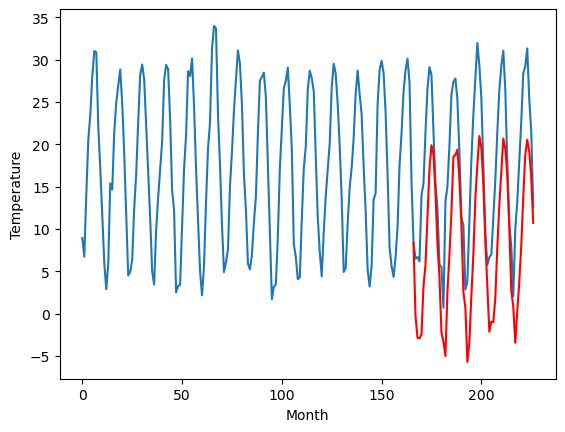

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.68		0.94		-3.74
3.32		-1.63		-4.95
2.87		-1.71		-4.58
1.63		-1.22		-2.85
9.59		4.45		-5.14
11.90		7.00		-4.90
18.43		12.71		-5.72
24.81		18.39		-6.42
26.39		21.13		-5.26
25.16		20.08		-5.08
18.41		15.50		-2.91
11.81		9.42		-2.39
8.63		5.56		-3.07
1.36		-1.01		-2.37
1.47		-2.12		-3.59
-2.90		-3.81		-0.91
7.81		3.86		-3.95
11.57		8.14		-3.43
16.12		13.19		-2.93
23.23		19.80		-3.43
23.90		19.97		-3.93
23.75		20.59		-3.16
21.80		17.03		-4.77
14.36		11.85		-2.51
8.11		3.78		-4.33
6.50		1.89		-4.61
-0.42		-4.50		-4.08
-0.36		-2.13		-1.77
6.57		3.34		-3.23
13.05		8.26		-4.79
18.50		14.83		-3.67
23.07		18.84		-4.23
26.67		22.20		-4.47
23.84		20.86		-2.98
21.43		16.55		-4.88
12.89		9.84		-3.05
3.90		4.40		0.50
1.55		-0.96		-2.51
1.83		0.21		-1.62
2.98		0.16		-2.82
6.71		3.08		-3.63
12.06		9.03		-3.03
17.17		13.97		-3.20
20.40		17.93		-2.47
25.02		21.86		-3.16
25.42		20.67		-4.75
21.90		17.54		-4.36

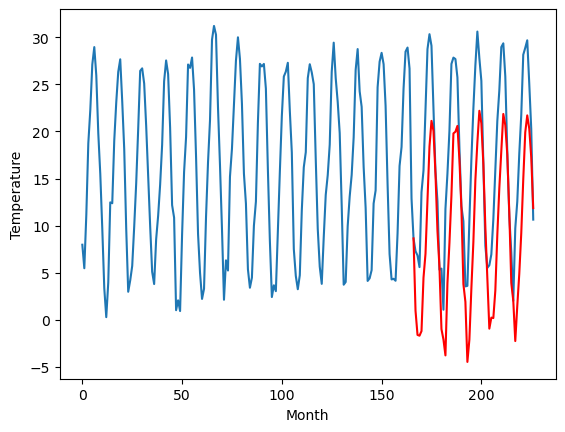

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.56		-0.04		1.52
-4.37		-2.61		1.76
-4.03		-2.69		1.34
-3.29		-2.20		1.09
1.03		3.47		2.44
2.66		6.01		3.35
8.12		11.72		3.60
15.44		17.40		1.96
19.31		20.15		0.84
17.12		19.09		1.97
12.59		14.51		1.92
7.05		8.43		1.38
2.85		4.57		1.72
-4.16		-2.00		2.16
-6.00		-3.12		2.88
-6.96		-4.82		2.14
0.26		2.85		2.59
4.91		7.13		2.22
9.45		12.18		2.73
15.54		18.78		3.24
17.77		18.95		1.18
17.55		19.57		2.02
13.85		16.01		2.16
9.43		10.83		1.40
0.11		2.75		2.64
-0.66		0.86		1.52
-7.68		-5.52		2.16
-3.78		-3.14		0.64
0.78		2.32		1.54
4.13		7.24		3.11
11.11		13.81		2.70
15.50		17.82		2.32
19.44		21.19		1.75
18.90		19.86		0.96
13.99		15.55		1.56
5.89		8.86		2.97
2.38		3.43		1.05
-4.77		-1.93		2.84
-1.81		-0.75		1.06
-2.13		-0.80		1.33
-1.01		2.12		3.13
6.21		8.07		1.86
8.77		13.02		4.25
13.14		16.98		3.84
18.28		20.92		2.64
16.54		19.73		3.19
13.35		16.60		3.25
8.00		10.44		2.44
0.06		2.97		2.91
-1.63	

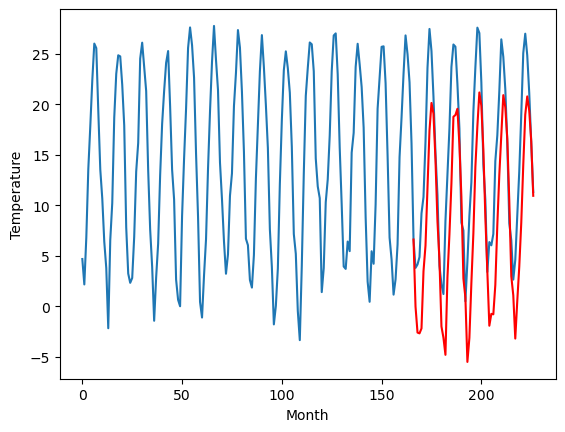

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -1.84  -0.036694
1                 1    3.52   4.201365
2                 2   -1.48   0.353082
3                 3    4.05   2.833199
4                 4    8.11   6.726766
5                 5    7.80   5.437234
6                 6    3.88   4.959669
7                 7    0.92   1.130830
8                 8    0.44  -0.294824
9                 9    4.68   0.943140
10               10   -1.56  -0.035970


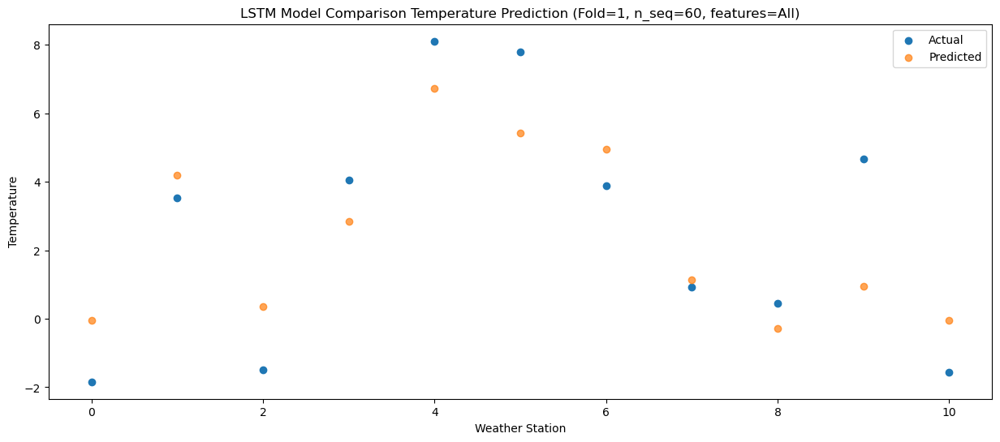

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -1.31  -2.609871
1                 1    2.61   1.631005
2                 2   -1.05  -2.212968
3                 3    2.63   0.270837
4                 4    6.22   4.166237
5                 5    5.77   2.873641
6                 6    3.15   2.391149
7                 7    0.30  -1.439257
8                 8   -1.41  -2.868867
9                 9    3.32  -1.626704
10               10   -4.37  -2.608772


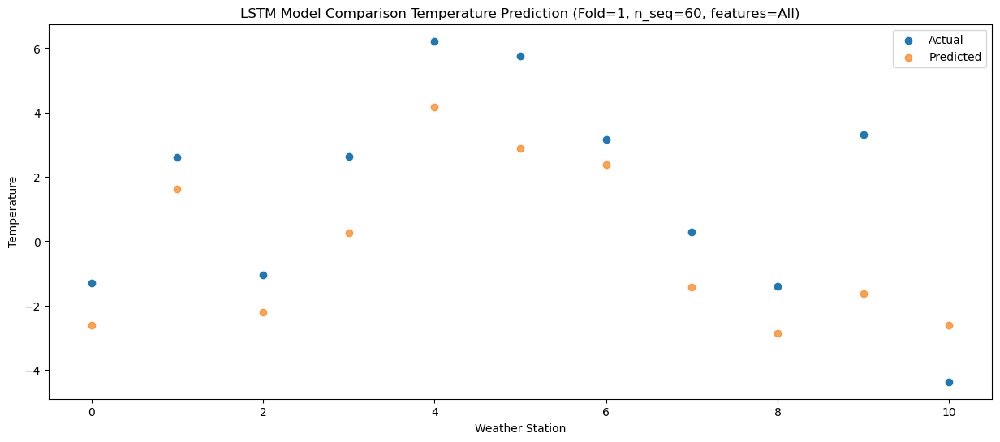

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.42  -2.692353
1                 1    1.50   1.543710
2                 2   -1.58  -2.300545
3                 3    3.38   0.187331
4                 4    7.03   4.083207
5                 5    5.11   2.786413
6                 6    2.34   2.306464
7                 7   -0.55  -1.520657
8                 8   -1.23  -2.951539
9                 9    2.87  -1.711425
10               10   -4.03  -2.688250


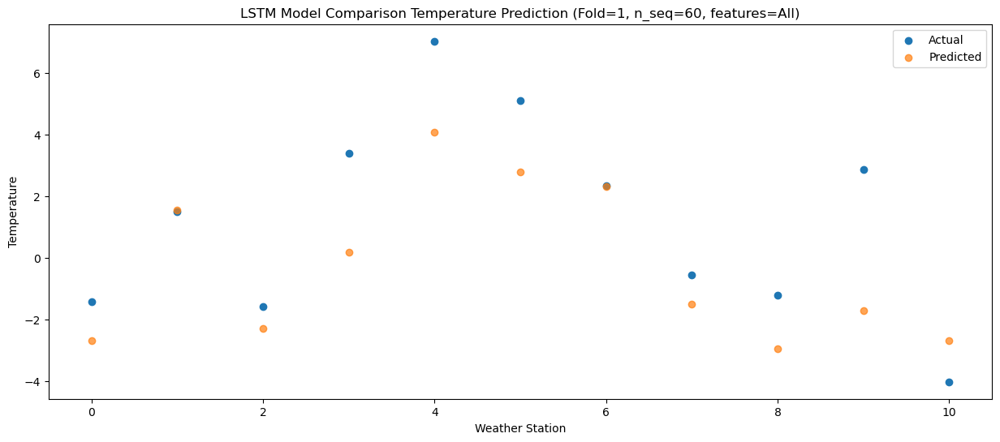

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.56  -2.187721
1                 1    1.59   2.048379
2                 2   -1.30  -1.796672
3                 3    2.85   0.684860
4                 4    6.65   4.578341
5                 5    4.59   3.284623
6                 6    2.41   2.802107
7                 7    0.13  -1.029715
8                 8   -1.74  -2.458726
9                 9    1.63  -1.220954
10               10   -3.29  -2.196703


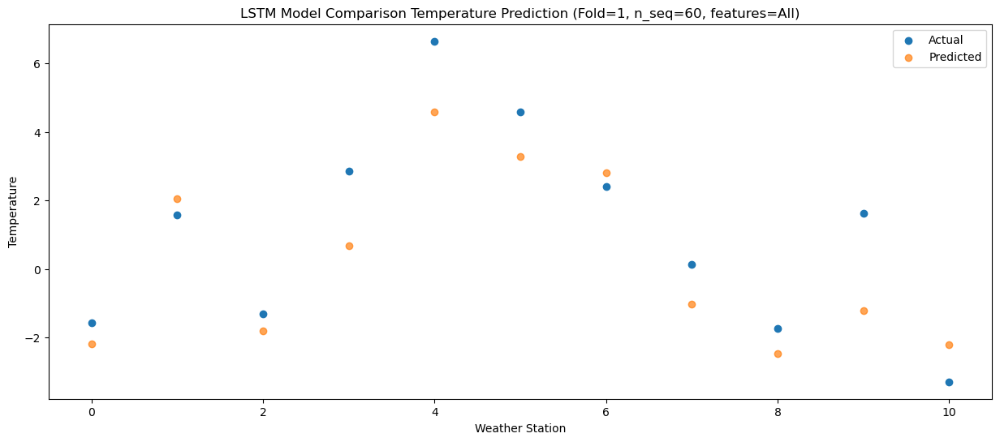

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.50   3.462441
1                 1    7.59   7.703018
2                 2    5.80   3.857261
3                 3   10.49   6.337142
4                 4   14.69  10.231202
5                 5   11.94   8.944329
6                 6    8.08   8.457730
7                 7    7.05   4.631562
8                 8    6.09   3.206032
9                 9    9.59   4.447610
10               10    1.03   3.468582


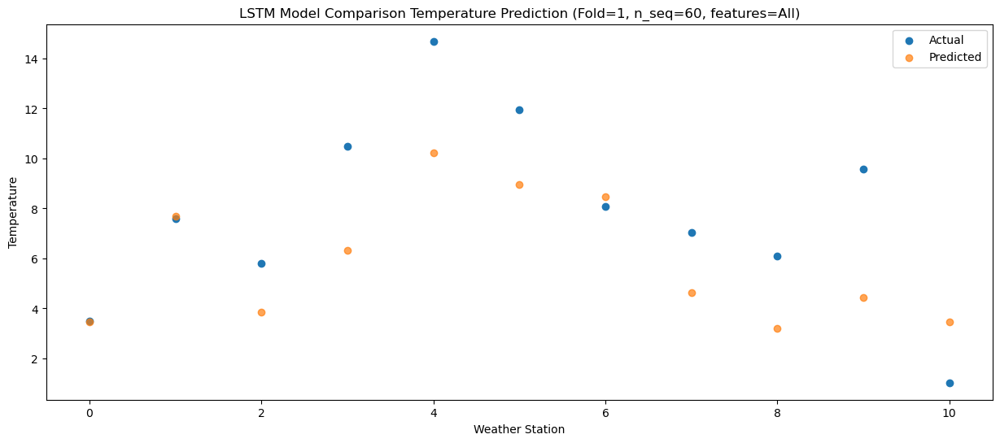

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    4.99   5.988616
1                 1    8.81  10.227661
2                 2    4.83   6.383760
3                 3   10.37   8.864512
4                 4   14.43  12.762294
5                 5   14.73  11.482513
6                 6    9.71  10.989053
7                 7    8.19   7.169677
8                 8    7.47   5.747838
9                 9   11.90   6.995137
10               10    2.66   6.011188


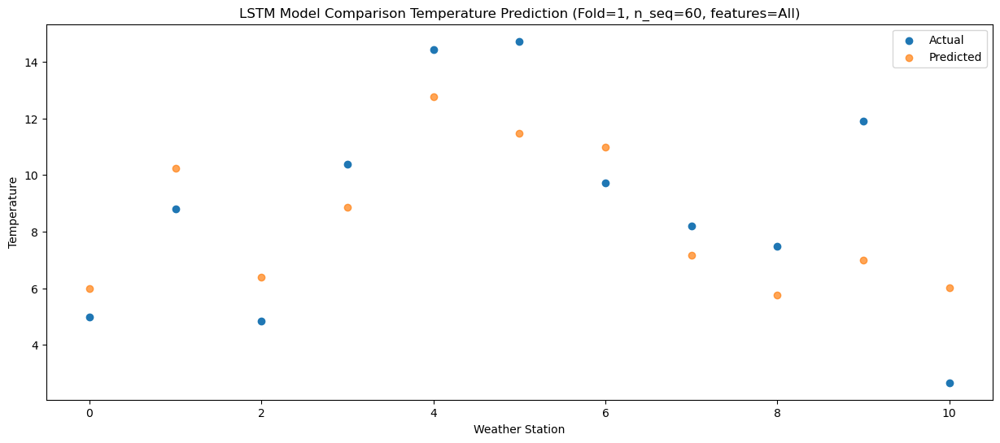

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.07  11.713259
1                 1   12.16  15.952229
2                 2    8.98  12.105253
3                 3   14.12  14.583145
4                 4   18.23  18.480186
5                 5   19.92  17.199064
6                 6   12.49  16.705620
7                 7   12.69  12.888741
8                 8   13.58  11.464467
9                 9   18.43  12.713223
10               10    8.12  11.724733


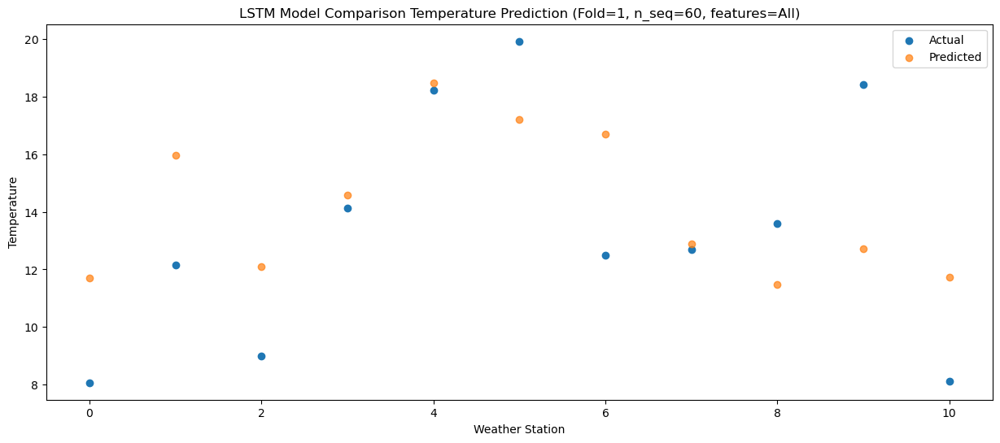

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   11.07  17.392470
1                 1   16.51  21.630092
2                 2   13.21  17.781871
3                 3   16.90  20.260438
4                 4   21.26  24.161015
5                 5   22.64  22.878739
6                 6   17.16  22.387283
7                 7   18.25  18.570932
8                 8   18.69  17.145354
9                 9   24.81  18.392506
10               10   15.44  17.404684


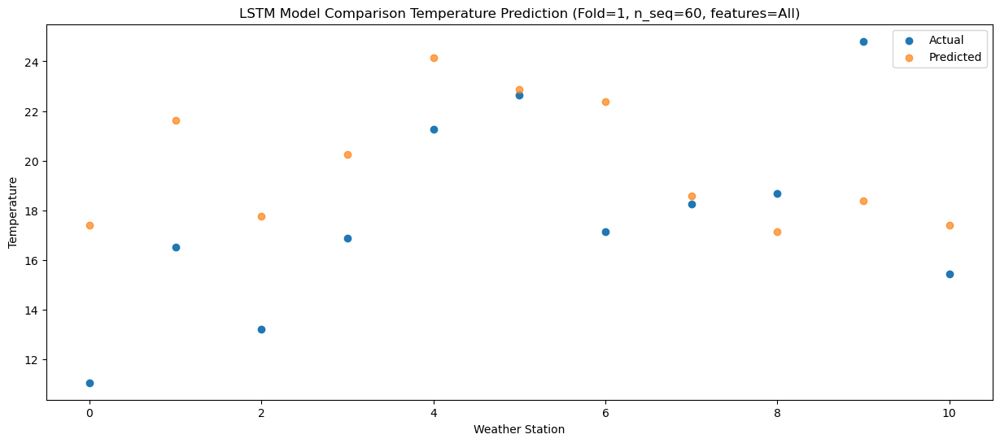

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   14.02  20.147403
1                 1   19.88  24.382404
2                 2   14.68  20.532875
3                 3   18.55  23.012912
4                 4   23.30  26.913475
5                 5   25.34  25.627704
6                 6   20.34  25.137299
7                 7   20.79  21.318377
8                 8   21.23  19.890019
9                 9   26.39  21.126040
10               10   19.31  20.145635


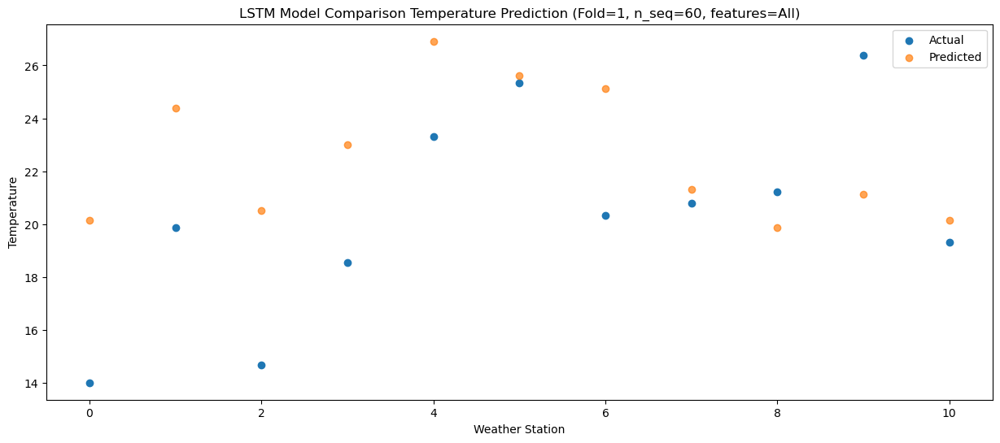

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   13.18  19.084618
1                 1   18.47  23.322315
2                 2   14.67  19.479668
3                 3   18.79  21.963032
4                 4   23.54  25.866207
5                 5   25.19  24.587254
6                 6   18.71  24.085874
7                 7   18.77  20.261567
8                 8   20.30  18.836372
9                 9   25.16  20.076037
10               10   17.12  19.086315


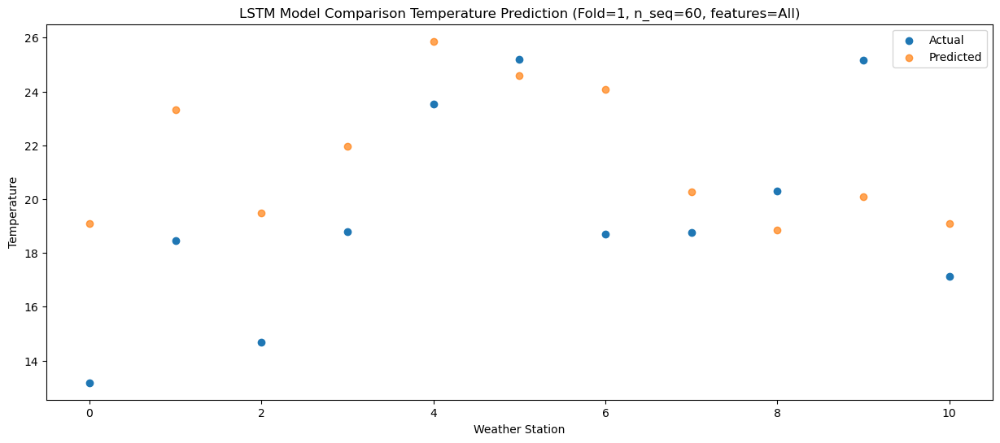

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   10.56  14.503205
1                 1   14.93  18.744744
2                 2   11.87  14.903869
3                 3   15.38  17.384693
4                 4   19.96  21.286525
5                 5   17.66  20.011499
6                 6   15.29  19.510441
7                 7   15.47  15.696654
8                 8   13.65  14.272873
9                 9   18.41  15.504886
10               10   12.59  14.513505


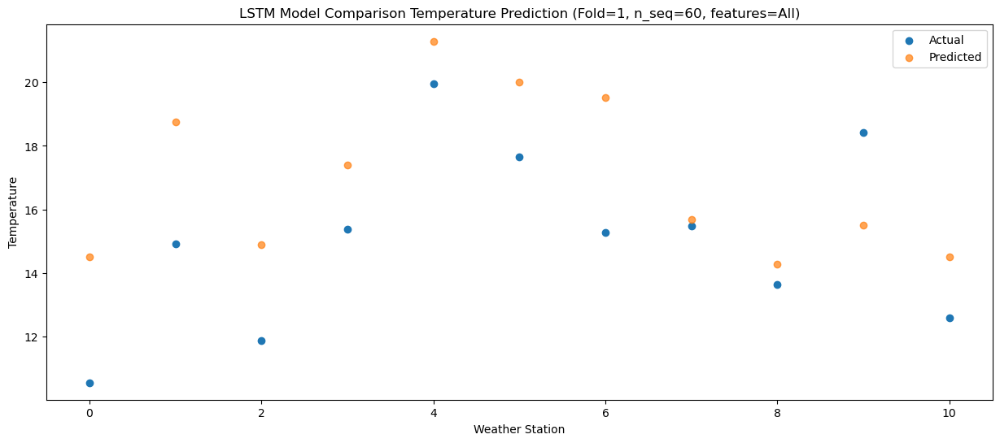

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.63   8.412262
1                 1   11.21  12.656639
2                 2    7.52   8.823121
3                 3   10.84  11.300511
4                 4   15.02  15.202825
5                 5   14.82  13.929442
6                 6   11.80  13.429189
7                 7    8.70   9.613430
8                 8    7.47   8.189190
9                 9   11.81   9.419290
10               10    7.05   8.426926


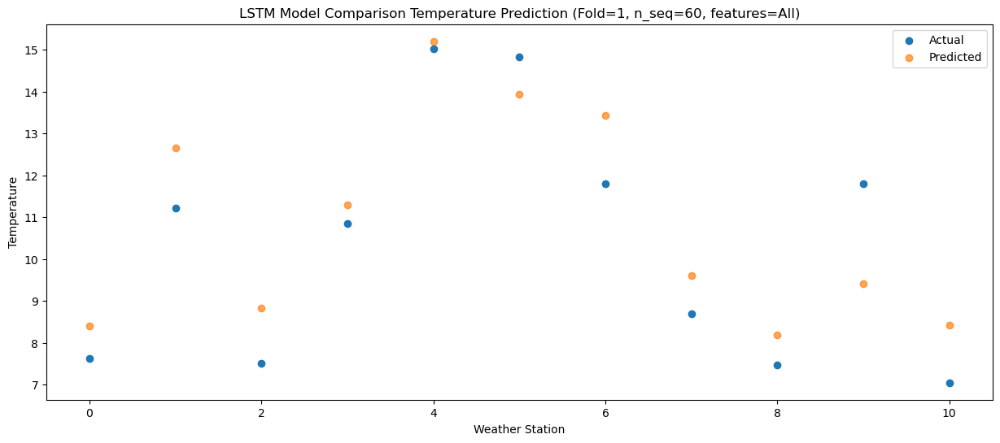

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    3.73   4.543789
1                 1    7.11   8.788751
2                 2    2.72   4.955029
3                 3    7.94   7.432562
4                 4   11.92  11.337266
5                 5   11.10  10.065338
6                 6    7.65   9.567046
7                 7    5.03   5.750159
8                 8    4.59   4.325969
9                 9    8.63   5.559965
10               10    2.85   4.566219


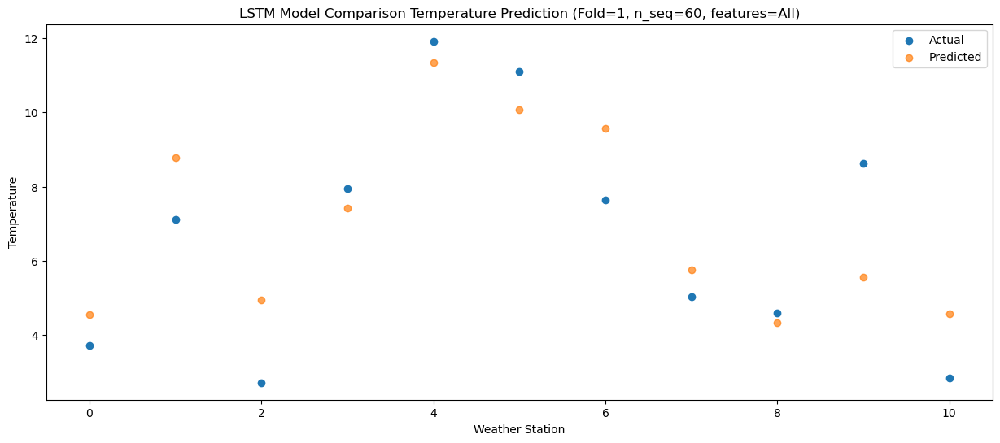

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.11  -2.024442
1                 1    0.22   2.224764
2                 2   -4.34  -1.604175
3                 3    1.76   0.879316
4                 4    5.56   4.784826
5                 5    4.35   3.506255
6                 6    0.44   3.007034
7                 7   -1.57  -0.815749
8                 8   -2.09  -2.244673
9                 9    1.36  -1.006932
10               10   -4.16  -2.004031


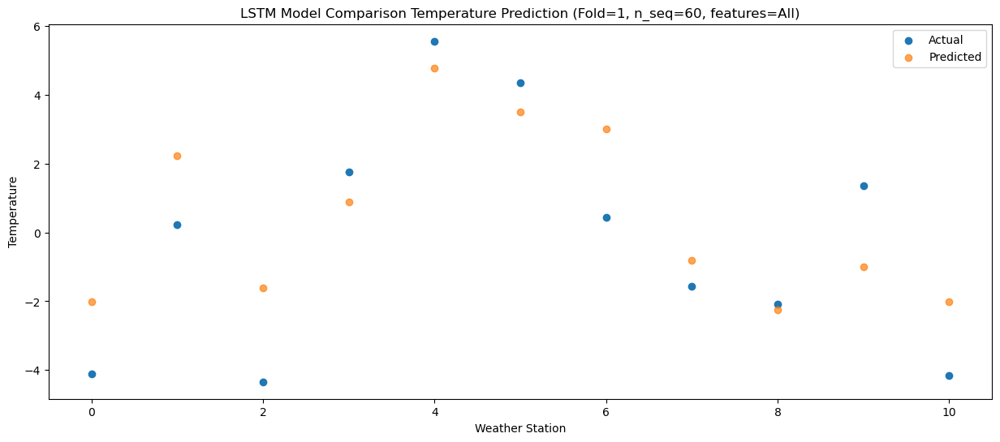

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -3.69  -3.113663
1                 1    0.02   1.128839
2                 2   -3.92  -2.701625
3                 3    1.66  -0.215456
4                 4    5.55   3.691237
5                 5    2.84   2.408976
6                 6    0.24   1.903511
7                 7   -1.88  -1.926707
8                 8   -2.44  -3.354476
9                 9    1.47  -2.117770
10               10   -6.00  -3.123982


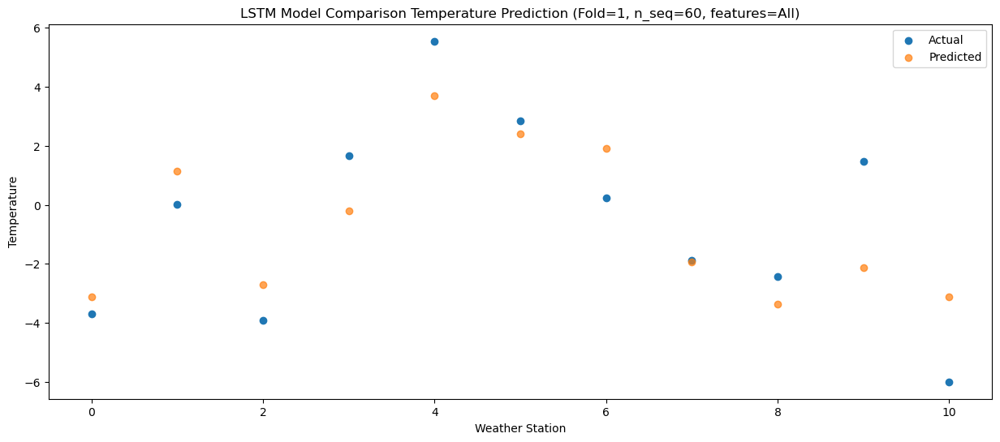

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.47  -4.786768
1                 1    0.68  -0.545758
2                 2   -3.43  -4.377183
3                 3    0.07  -1.894675
4                 4    3.85   2.010695
5                 5    3.22   0.727632
6                 6    1.02   0.218577
7                 7   -4.88  -3.613266
8                 8   -7.22  -5.040886
9                 9   -2.90  -3.805800
10               10   -6.96  -4.815695


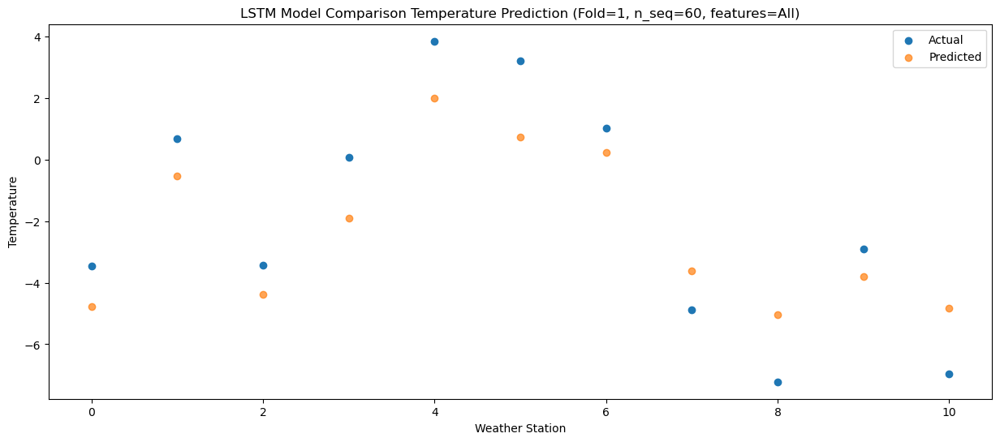

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    1.51   2.875757
1                 1    7.45   7.115751
2                 2    3.63   3.283993
3                 3    7.44   5.760453
4                 4   11.46   9.662382
5                 5   10.56   8.383451
6                 6    7.30   7.873261
7                 7    6.44   4.053947
8                 8    5.34   2.630516
9                 9    7.81   3.863784
10               10    0.26   2.850458


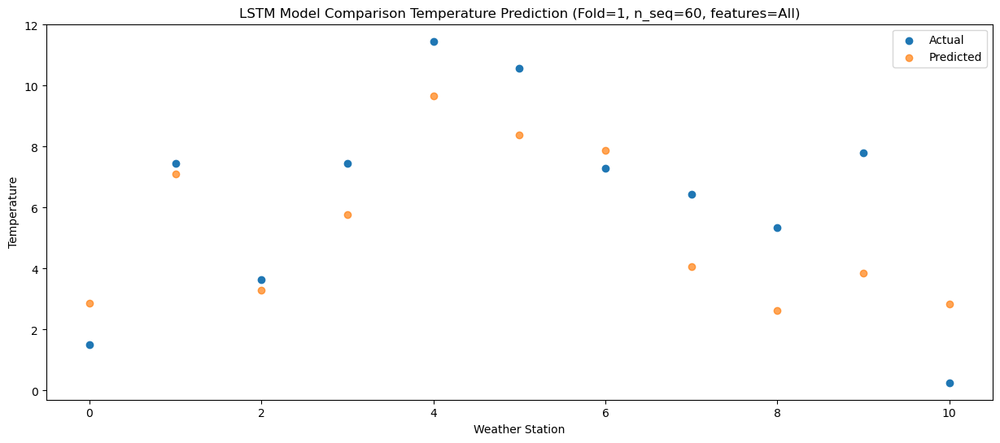

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.32   7.159900
1                 1    9.59  11.401990
2                 2    5.03   7.571682
3                 3    9.78  10.045632
4                 4   13.76  13.944022
5                 5   12.83  12.671704
6                 6    9.87  12.158858
7                 7    8.15   8.328065
8                 8    7.14   6.903377
9                 9   11.57   8.135712
10               10    4.91   7.125492


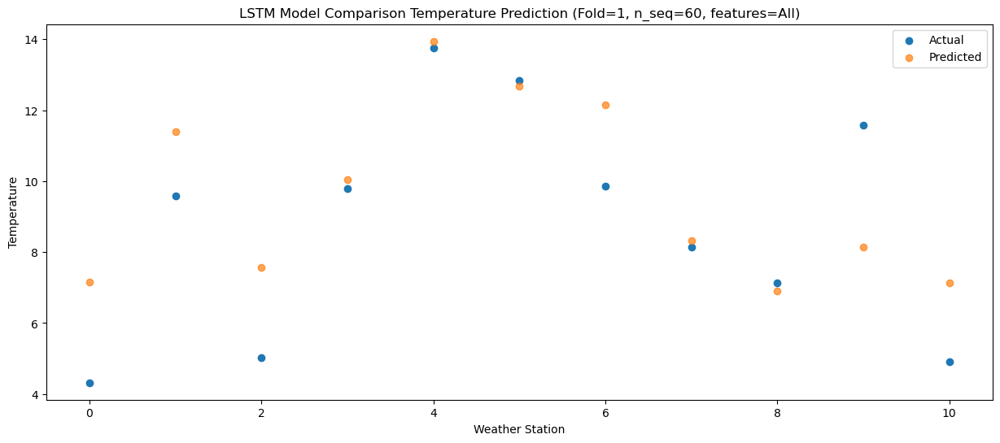

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    7.93  12.225340
1                 1   13.32  16.467172
2                 2    9.15  12.635653
3                 3   13.67  15.101410
4                 4   17.88  18.992185
5                 5   18.42  17.719445
6                 6   13.64  17.207460
7                 7   12.81  13.386457
8                 8   11.95  11.966616
9                 9   16.12  13.194478
10               10    9.45  12.181892


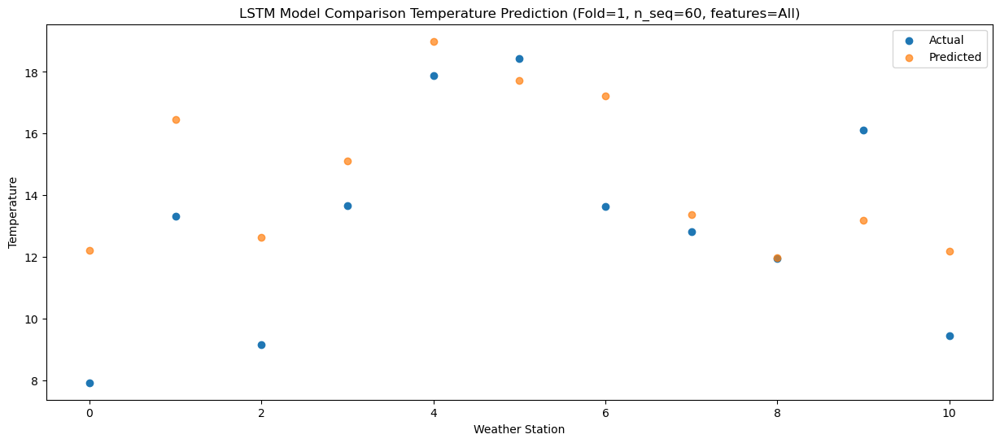

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   11.42  18.827173
1                 1   17.46  23.068458
2                 2   13.03  19.237462
3                 3   17.56  21.708357
4                 4   21.35  25.602097
5                 5   22.69  24.325080
6                 6   17.65  23.807668
7                 7   18.89  19.985147
8                 8   17.98  18.567364
9                 9   23.23  19.795547
10               10   15.54  18.779783


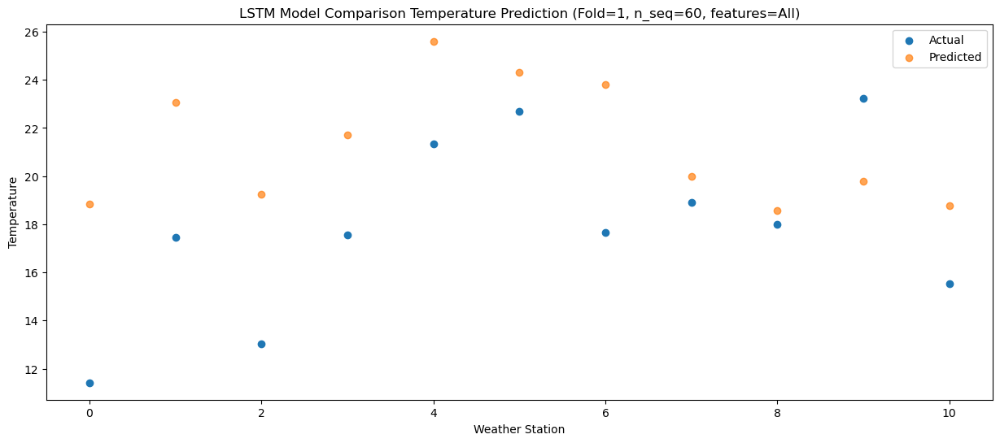

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.62  18.989105
1                 1   18.84  23.232845
2                 2   13.80  19.405684
3                 3   17.44  21.882252
4                 4   21.44  25.778608
5                 5   22.03  24.501395
6                 6   19.01  23.978958
7                 7   19.88  20.162624
8                 8   19.49  18.745442
9                 9   23.90  19.968332
10               10   17.77  18.948177


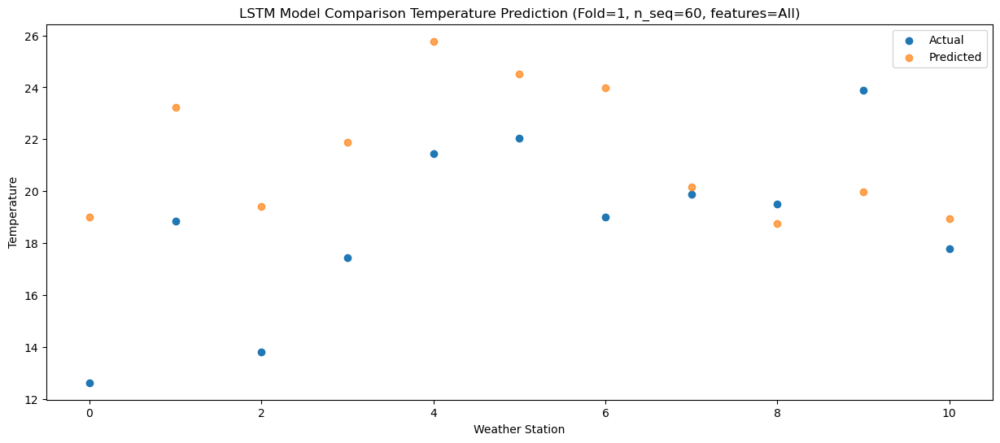

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.73  19.613020
1                 1   19.11  23.856432
2                 2   14.46  20.030048
3                 3   18.41  22.509759
4                 4   22.41  26.406428
5                 5   21.44  25.128014
6                 6   19.27  24.604011
7                 7   21.10  20.789771
8                 8   19.88  19.370597
9                 9   23.75  20.591824
10               10   17.55  19.569332


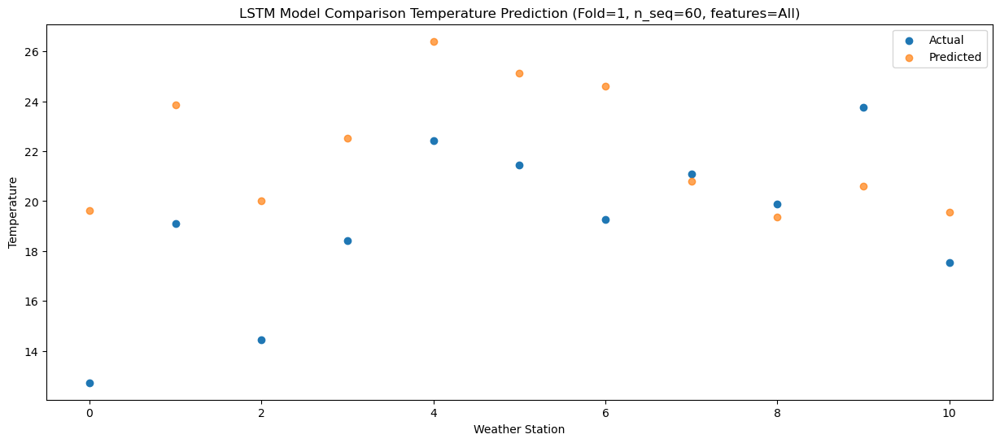

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.08  16.044128
1                 1   15.37  20.289825
2                 2   11.44  16.467753
3                 3   15.40  18.949231
4                 4   18.83  22.851638
5                 5   21.08  21.575662
6                 6   15.94  21.048610
7                 7   17.39  17.229528
8                 8   17.37  15.807261
9                 9   21.80  17.027285
10               10   13.85  16.009539


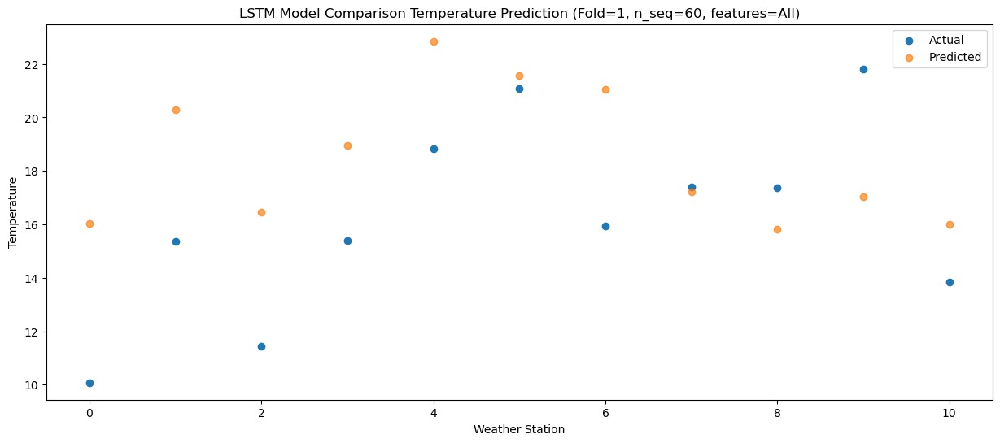

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.38  10.859934
1                 1   11.59  15.102944
2                 2    7.66  11.282100
3                 3   12.71  13.762733
4                 4   15.79  17.669754
5                 5   16.76  16.400053
6                 6   11.99  15.867872
7                 7   12.19  12.043147
8                 8   11.12  10.622952
9                 9   14.36  11.846151
10               10    9.43  10.826844


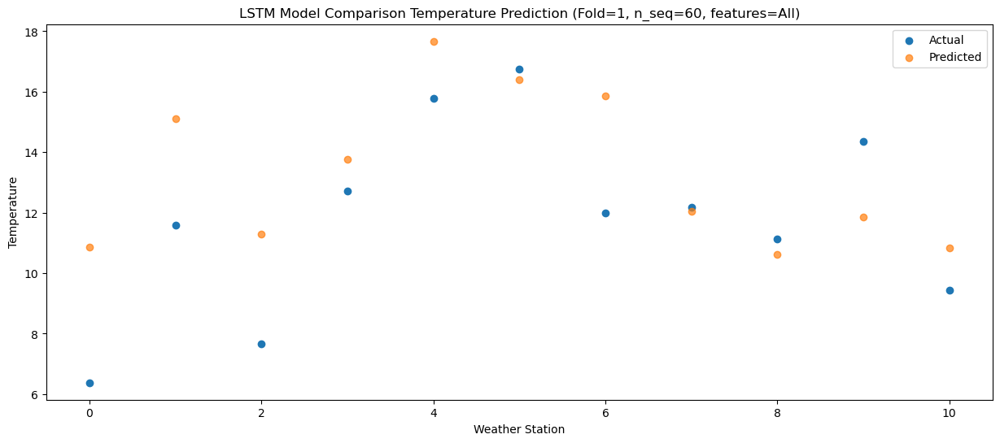

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.83   2.773633
1                 1    3.93   7.013178
2                 2   -0.08   3.194239
3                 3    5.55   5.675091
4                 4    8.24   9.582692
5                 5   10.29   8.322538
6                 6    4.39   7.783561
7                 7    2.89   3.963799
8                 8    3.37   2.548150
9                 9    8.11   3.775471
10               10    0.11   2.747847


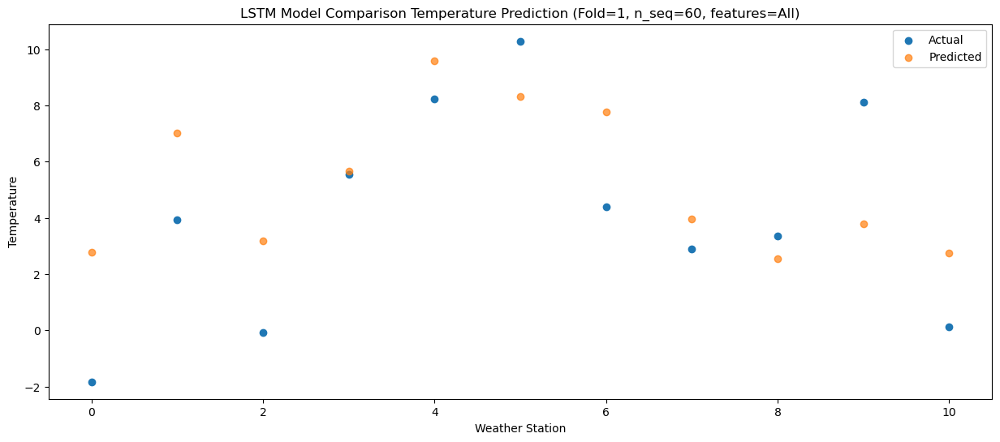

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    0.52   0.899817
1                 1    5.56   5.138100
2                 2    2.52   1.318180
3                 3    8.92   3.790057
4                 4   12.12   7.697957
5                 5   10.55   6.435398
6                 6    5.91   5.900913
7                 7    5.30   2.078816
8                 8    2.56   0.659269
9                 9    6.50   1.886363
10               10   -0.66   0.863826


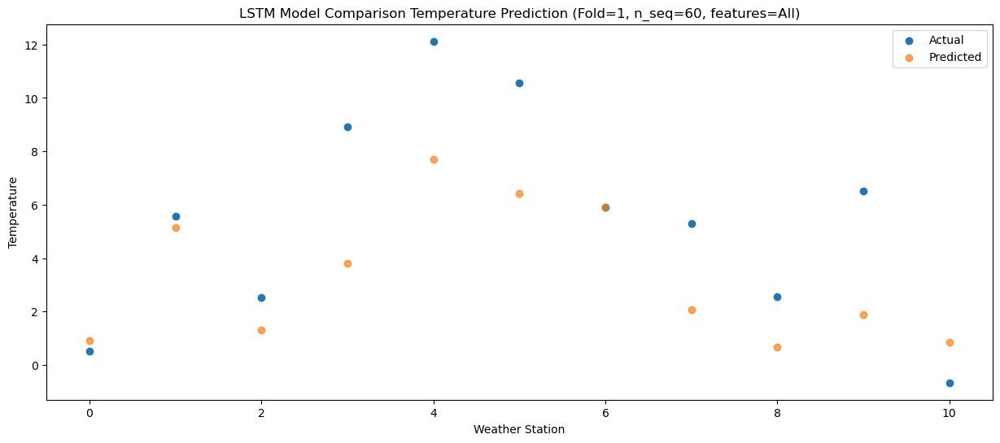

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.64  -5.475341
1                 1   -1.17  -1.235931
2                 2   -4.37  -5.057236
3                 3    0.87  -2.588347
4                 4    3.64   1.313462
5                 5    3.23   0.057902
6                 6   -0.48  -0.479079
7                 7   -3.53  -4.302745
8                 8   -5.06  -5.724439
9                 9   -0.42  -4.498601
10               10   -7.68  -5.518234


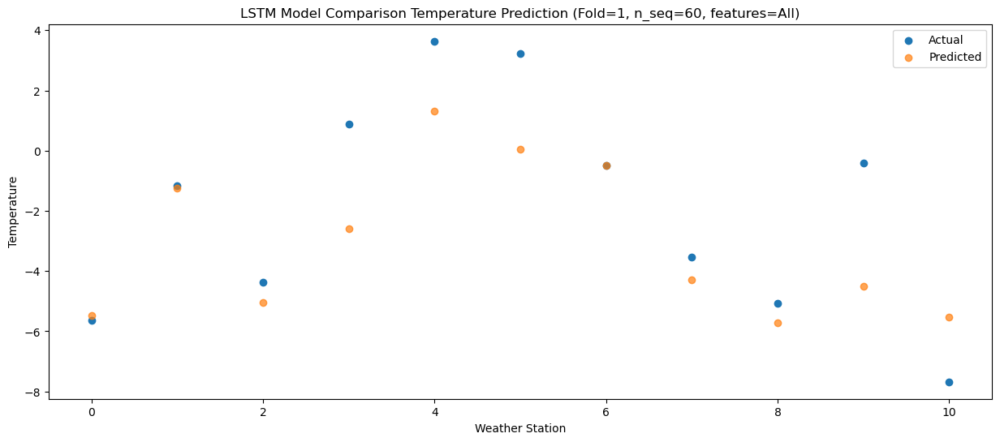

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.80  -3.091992
1                 1    3.06   1.145026
2                 2   -1.02  -2.675879
3                 3    0.40  -0.215835
4                 4    3.33   3.682813
5                 5    3.12   2.434438
6                 6    3.33   1.895679
7                 7   -1.48  -1.931905
8                 8   -4.08  -3.353285
9                 9   -0.36  -2.125835
10               10   -3.78  -3.140633


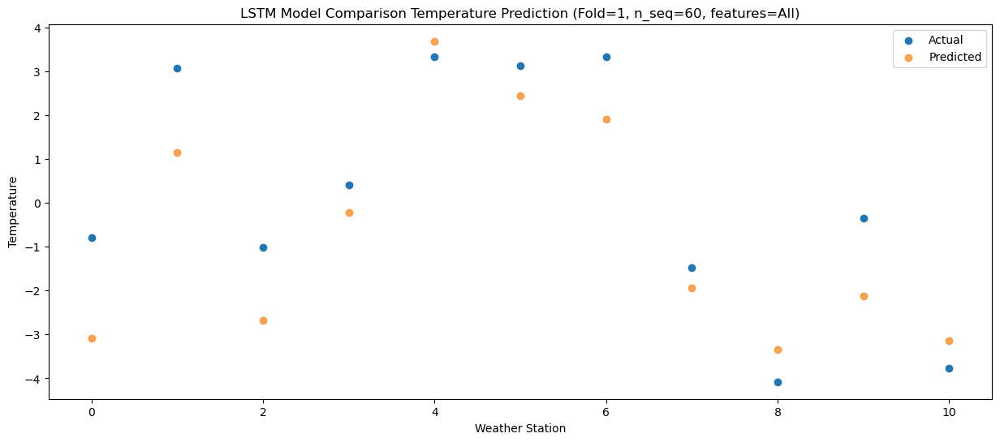

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    2.59   2.373583
1                 1    6.63   6.607733
2                 2    2.98   2.788324
3                 3    6.24   5.246429
4                 4    9.11   9.144230
5                 5   10.07   7.897047
6                 6    7.17   7.355112
7                 7    4.47   3.533054
8                 8    3.17   2.112497
9                 9    6.57   3.342055
10               10    0.78   2.320762


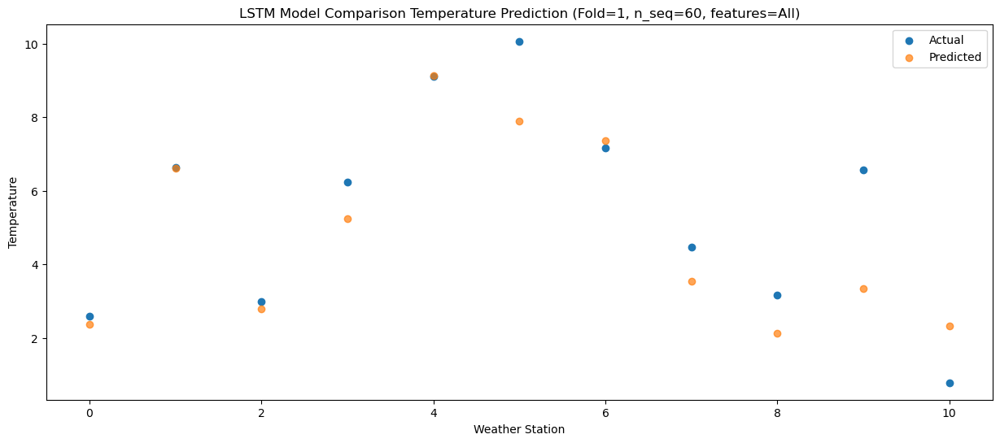

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    4.58   7.291116
1                 1    9.63  11.530138
2                 2    6.57   7.711351
3                 3   12.24  10.176932
4                 4   15.38  14.075351
5                 5   16.98  12.825366
6                 6    9.93  12.281454
7                 7    9.66   8.457881
8                 8   10.28   7.037583
9                 9   13.05   8.260977
10               10    4.13   7.236283


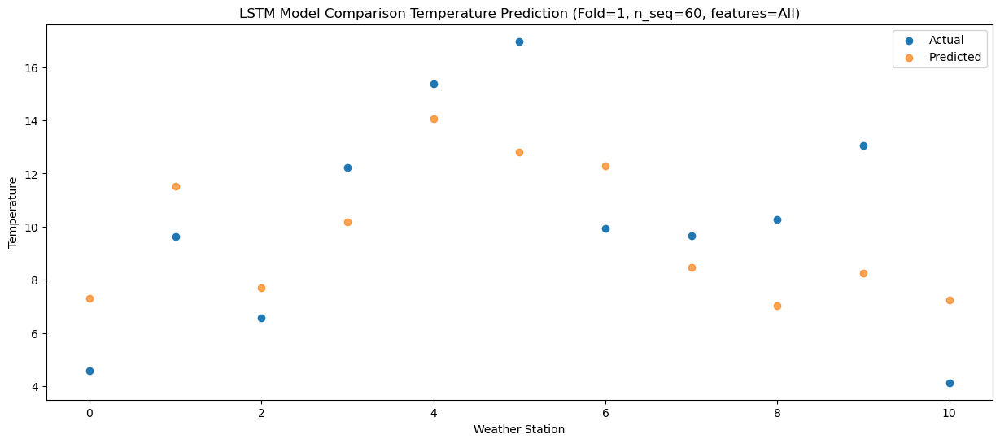

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    9.83  13.861318
1                 1   15.51  18.104306
2                 2   11.93  14.287113
3                 3   16.67  16.742217
4                 4   20.00  20.637295
5                 5   22.38  19.388171
6                 6   15.85  18.850314
7                 7   15.13  15.024057
8                 8   15.64  13.599547
9                 9   18.50  14.826898
10               10   11.11  13.806820


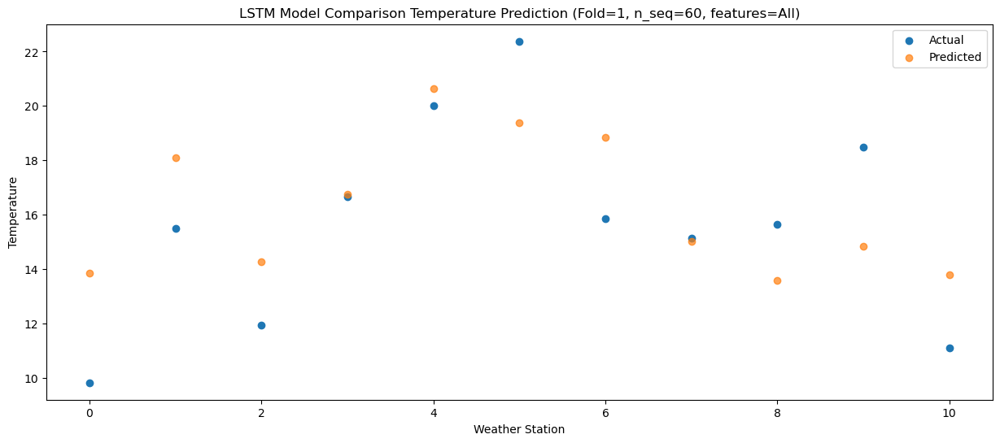

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   12.33  17.879568
1                 1   19.48  22.122793
2                 2   14.90  18.308438
3                 3   19.67  20.759478
4                 4   23.37  24.653883
5                 5   24.44  23.401314
6                 6   19.43  22.862909
7                 7   19.19  19.039761
8                 8   19.93  17.612453
9                 9   23.07  18.836120
10               10   15.50  17.820008


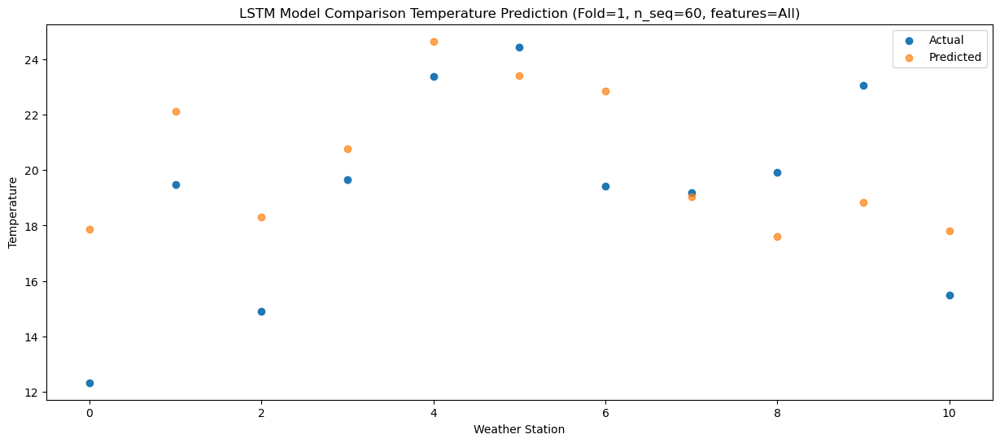

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   13.23  21.247722
1                 1   19.98  25.488080
2                 2   15.61  21.677145
3                 3   20.61  24.130231
4                 4   24.46  28.024474
5                 5   25.36  26.769302
6                 6   20.17  26.227517
7                 7   23.32  22.405357
8                 8   24.08  20.977511
9                 9   26.67  22.198387
10               10   19.44  21.185952


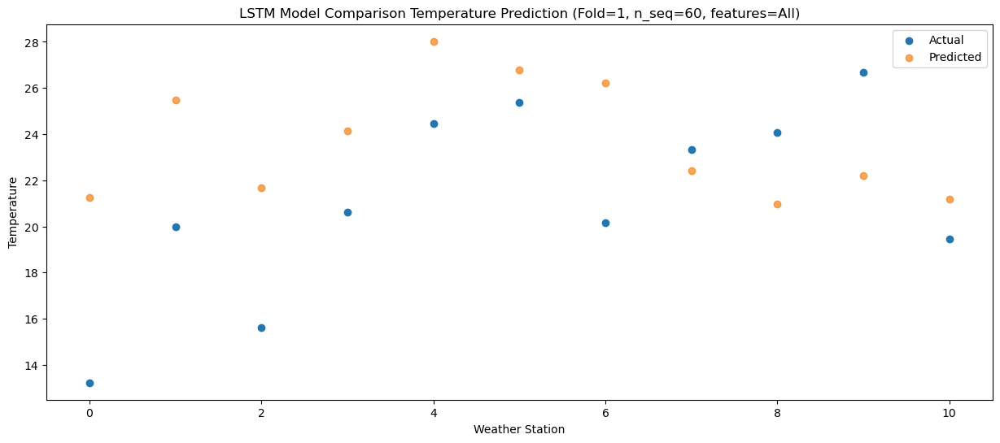

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.43  19.929244
1                 1   18.52  24.169387
2                 2   14.00  20.358132
3                 3   18.97  22.804092
4                 4   22.45  26.696063
5                 5   22.51  25.437254
6                 6   18.67  24.901062
7                 7   20.45  21.074711
8                 8   21.41  19.644913
9                 9   23.84  20.864993
10               10   18.90  19.862525


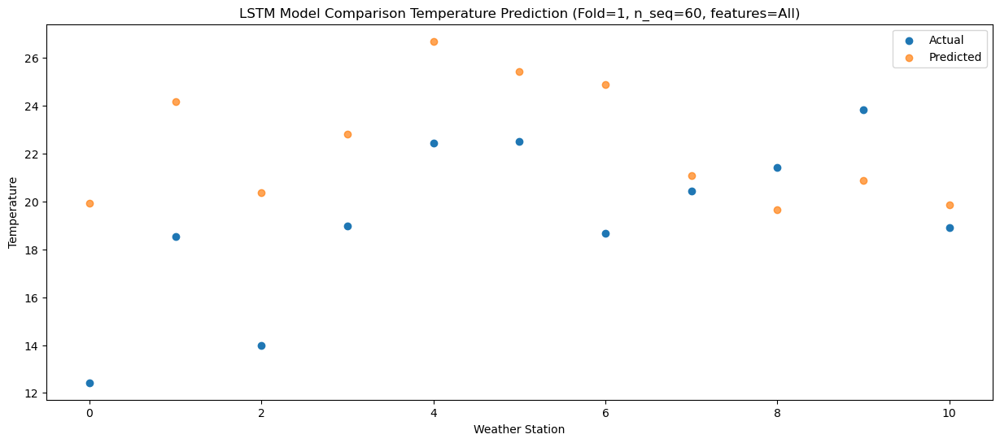

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   10.47  15.644117
1                 1   15.43  19.879837
2                 2   11.61  16.066721
3                 3   16.20  18.510562
4                 4   19.27  22.398563
5                 5   19.46  21.138705
6                 6   15.78  20.599092
7                 7   16.61  16.764098
8                 8   17.58  15.334817
9                 9   21.43  16.550688
10               10   13.99  15.552796


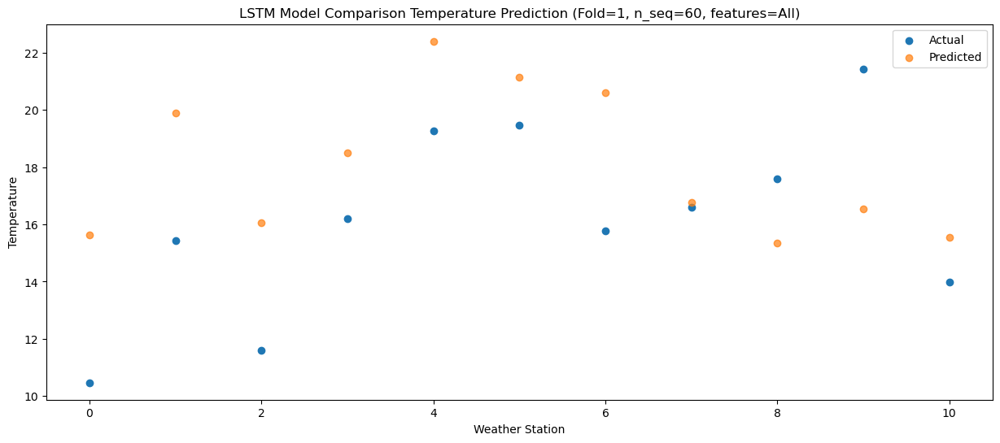

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    3.92   8.978606
1                 1    9.09  13.213726
2                 2    4.92   9.397907
3                 3   10.64  11.837161
4                 4   13.88  15.719795
5                 5   13.38  14.451986
6                 6    9.44  13.913219
7                 7    9.94  10.071089
8                 8    9.35   8.639059
9                 9   12.89   9.843359
10               10    5.89   8.863123


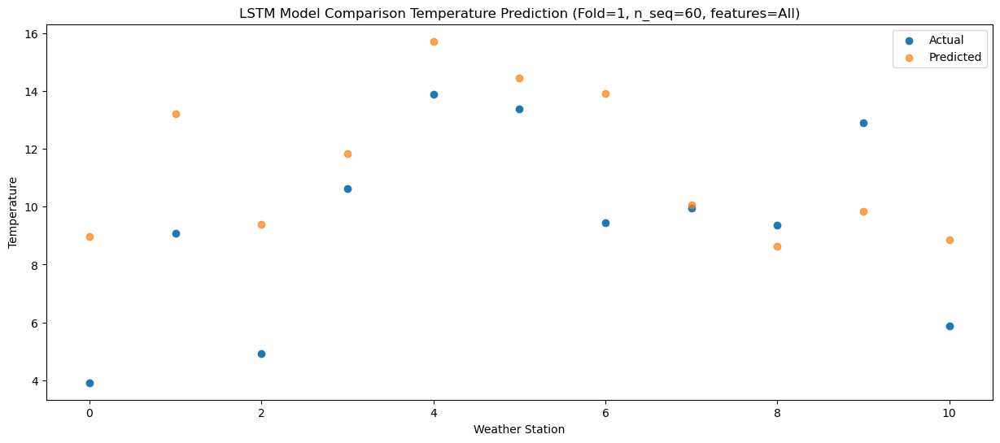

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    2.72   3.548420
1                 1    6.09   7.786834
2                 2    1.60   3.969096
3                 3    5.59   6.405029
4                 4    8.88  10.285645
5                 5    6.42   9.015908
6                 6    6.55   8.482998
7                 7    3.34   4.636445
8                 8    1.50   3.203528
9                 9    3.90   4.402090
10               10    2.38   3.427198


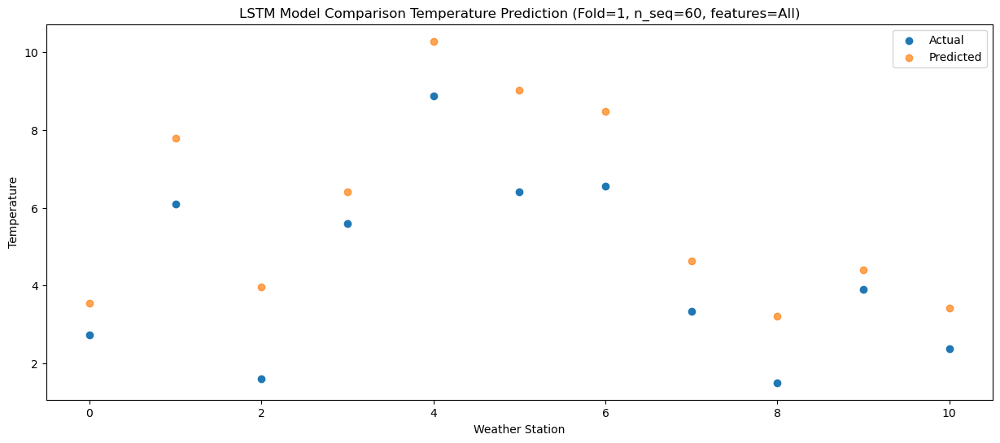

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -3.04  -1.788257
1                 1    0.28   2.444841
2                 2   -1.56  -1.375469
3                 3    3.50   1.059698
4                 4    6.86   4.939704
5                 5    5.30   3.663227
6                 6    0.54   3.131283
7                 7   -0.40  -0.720456
8                 8   -2.13  -2.156459
9                 9    1.55  -0.960727
10               10   -4.77  -1.929888


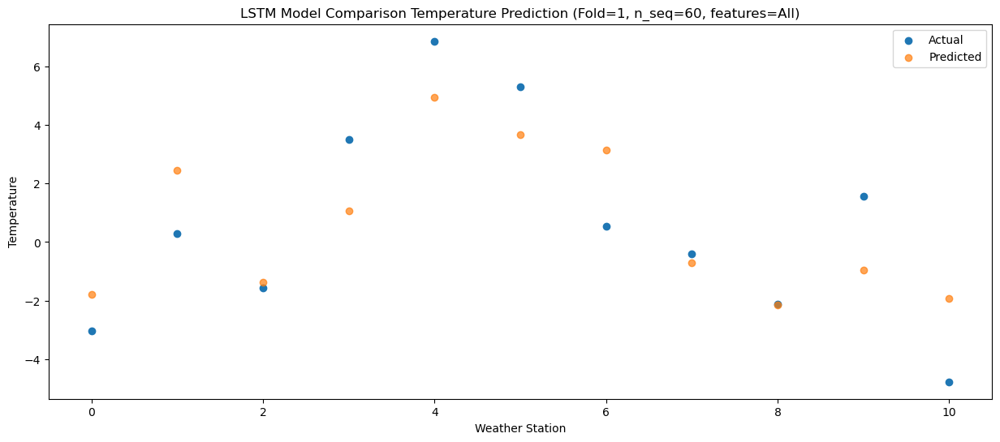

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.93  -0.608832
1                 1    2.47   3.624583
2                 2   -0.56  -0.196943
3                 3    4.21   2.244145
4                 4    7.34   6.122618
5                 5    5.76   4.836867
6                 6    2.67   4.307746
7                 7    0.79   0.462694
8                 8   -1.27  -0.976499
9                 9    1.83   0.213864
10               10   -1.81  -0.752665


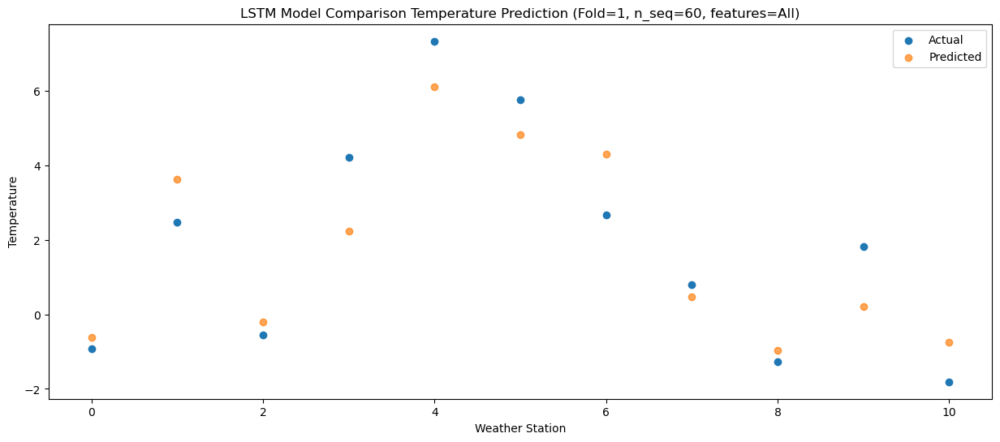

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.98  -0.656685
1                 1    5.84   3.578799
2                 2    2.03  -0.241577
3                 3    5.21   2.193283
4                 4    8.52   6.068930
5                 5    5.90   4.782271
6                 6    6.26   4.257524
7                 7    2.29   0.412270
8                 8   -0.90  -1.030394
9                 9    2.98   0.161947
10               10   -2.13  -0.802656


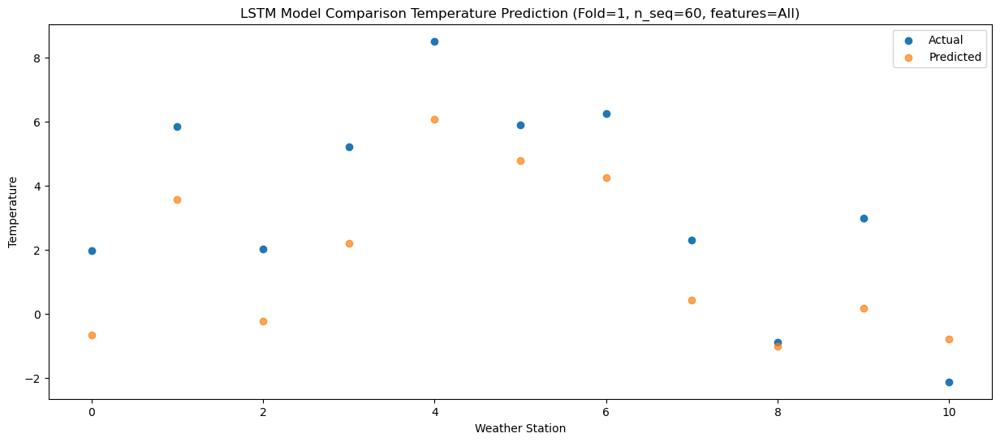

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    2.62   2.251776
1                 1    6.61   6.486107
2                 2    3.46   2.669732
3                 3    9.04   5.111130
4                 4   12.34   8.990283
5                 5   10.96   7.698078
6                 6    6.93   7.170942
7                 7    5.12   3.334955
8                 8    3.53   1.892288
9                 9    6.71   3.080674
10               10   -1.01   2.117636


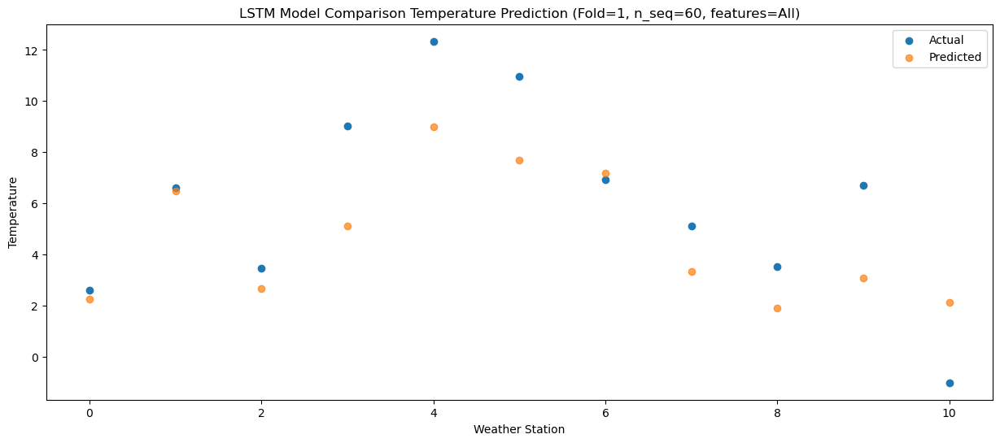

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    6.12   8.214239
1                 1    9.88  12.446911
2                 2    6.15   8.627041
3                 3    9.88  11.061417
4                 4   13.30  14.938488
5                 5   14.12  13.642395
6                 6   10.19  13.117803
7                 7    9.52   9.284511
8                 8    7.86   7.843051
9                 9   12.06   9.028059
10               10    6.21   8.074150


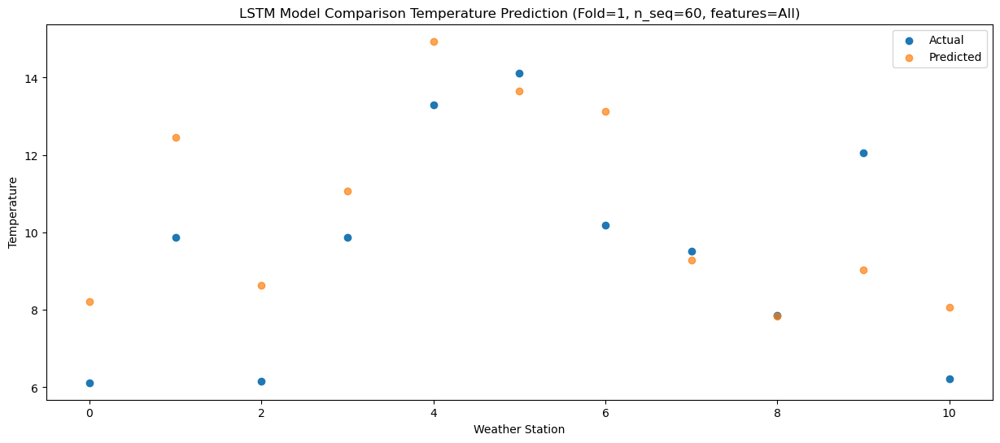

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    7.62  13.176612
1                 1   13.16  17.412824
2                 2    9.39  13.590895
3                 3   14.47  16.019581
4                 4   17.94  19.887165
5                 5   18.73  18.591413
6                 6   13.19  18.068105
7                 7   14.87  14.229410
8                 8   13.55  12.786819
9                 9   17.17  13.969164
10               10    8.77  13.019217


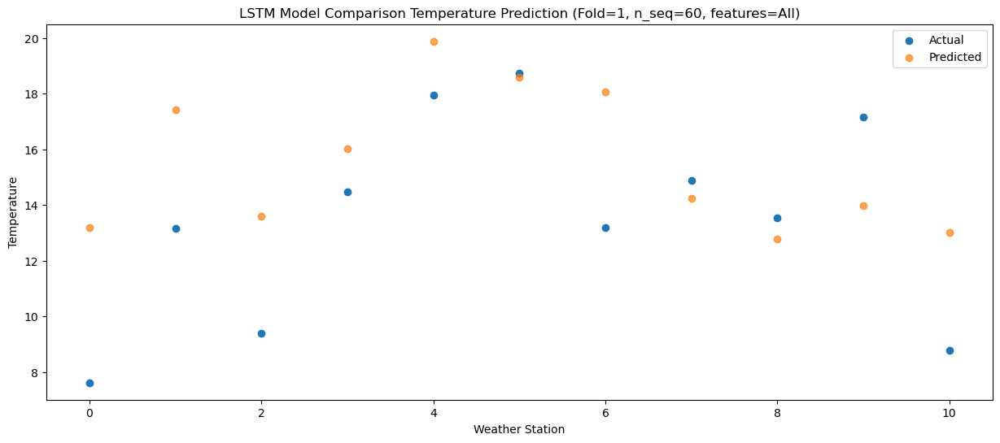

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   11.24  17.156182
1                 1   16.35  21.390277
2                 2   13.14  17.569623
3                 3   18.62  19.994171
4                 4   22.83  23.859141
5                 5   25.42  22.557358
6                 6   16.47  22.036241
7                 7   18.68  18.197742
8                 8   18.48  16.747638
9                 9   20.40  17.926369
10               10   13.14  16.979058


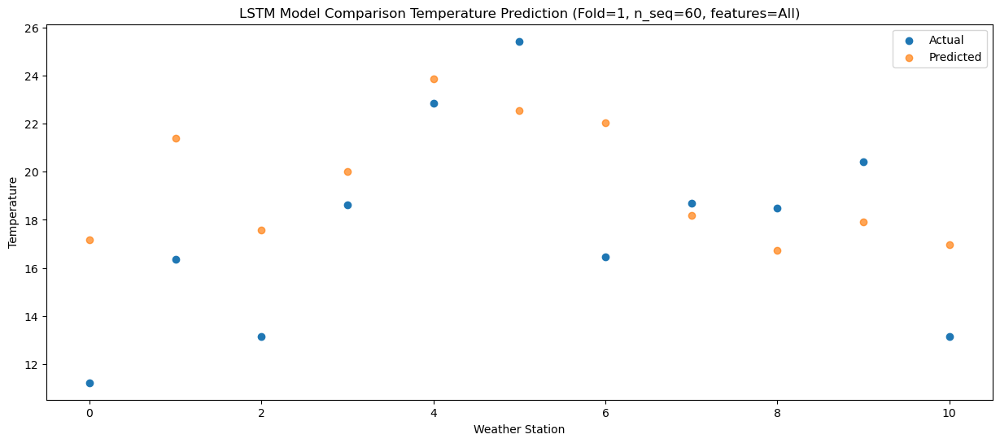

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   14.47  21.111812
1                 1   19.95  25.346327
2                 2   15.51  21.521718
3                 3   20.34  23.939034
4                 4   24.78  27.795510
5                 5   26.52  26.490966
6                 6   19.92  25.975569
7                 7   20.98  22.130170
8                 8   21.36  20.676221
9                 9   25.02  21.859285
10               10   18.28  20.919744


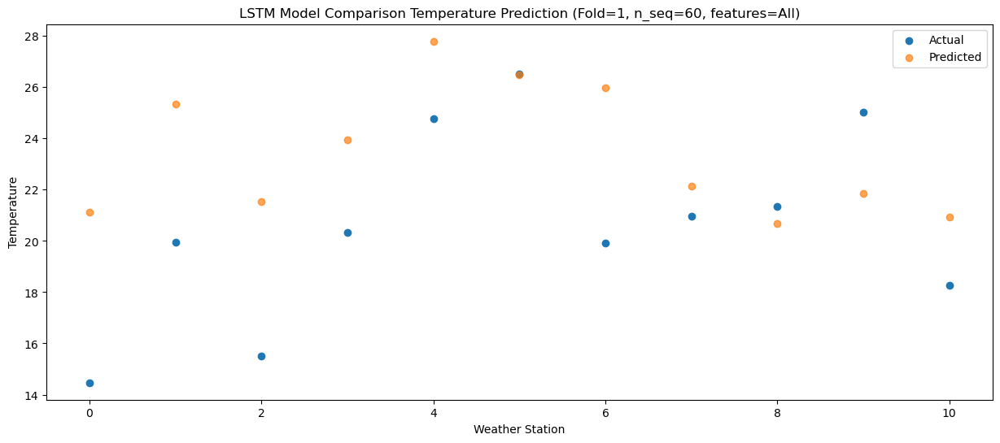

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   14.26  19.923347
1                 1   19.41  24.157123
2                 2   15.95  20.332890
3                 3   22.31  22.746904
4                 4   26.21  26.601098
5                 5   25.71  25.293599
6                 6   19.50  24.781155
7                 7   21.48  20.941598
8                 8   23.17  19.486289
9                 9   25.42  20.671654
10               10   16.54  19.733816


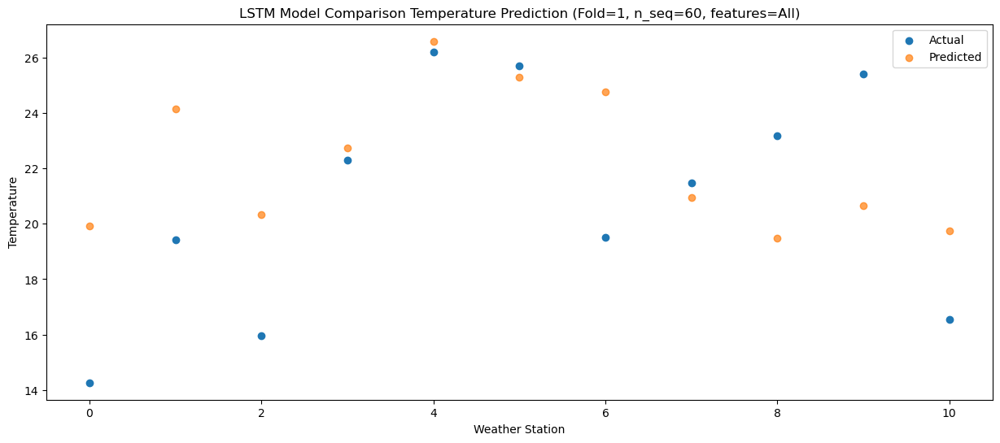

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   10.57  16.781387
1                 1   15.90  21.013555
2                 2   12.99  17.185094
3                 3   19.23  19.601209
4                 4   22.36  23.457330
5                 5   23.43  22.149505
6                 6   16.33  21.635298
7                 7   17.86  17.800333
8                 8   18.53  16.348096
9                 9   21.90  17.537656
10               10   13.35  16.595906


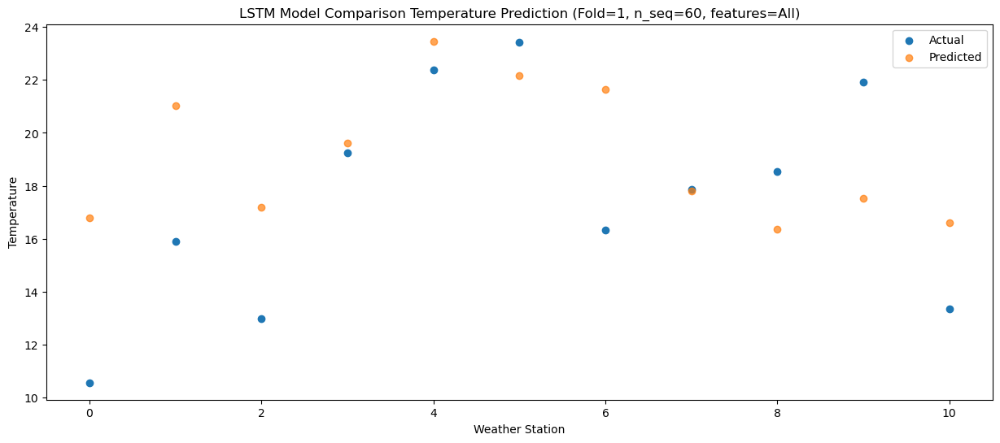

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    5.69  10.627296
1                 1   10.89  14.862973
2                 2    6.95  11.032829
3                 3   11.97  13.444510
4                 4   14.96  17.296217
5                 5   15.83  15.981484
6                 6   11.32  15.474980
7                 7   11.55  11.644475
8                 8    9.95  10.191805
9                 9   13.80  11.371221
10               10    8.00  10.439345


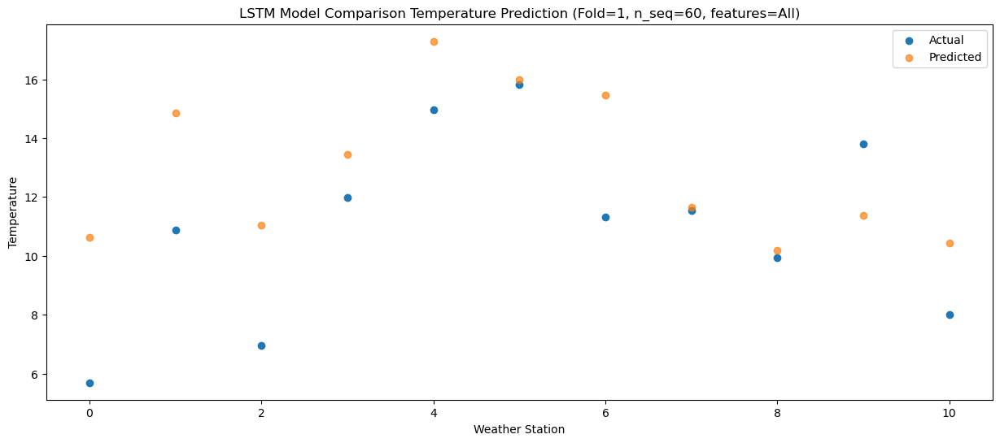

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.54   3.149502
1                 1    5.27   7.386640
2                 2    0.39   3.560560
3                 3    5.69   5.969753
4                 4    8.76   9.820798
5                 5    9.17   8.505739
6                 6    5.63   8.000914
7                 7    4.15   4.174101
8                 8    2.83   2.718529
9                 9    7.05   3.899550
10               10    0.06   2.971814


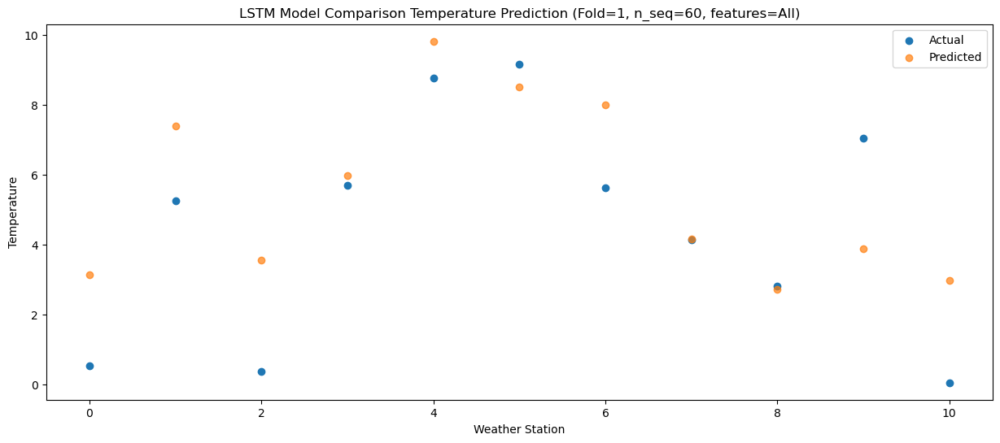

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -1.49   1.275161
1                 1    2.13   5.512921
2                 2   -2.39   1.683507
3                 3    3.29   4.081876
4                 4    6.86   7.927392
5                 5    6.81   6.615812
6                 6    2.89   6.114915
7                 7    1.23   2.290278
8                 8   -0.02   0.830757
9                 9    3.22   2.006470
10               10   -1.63   1.082160


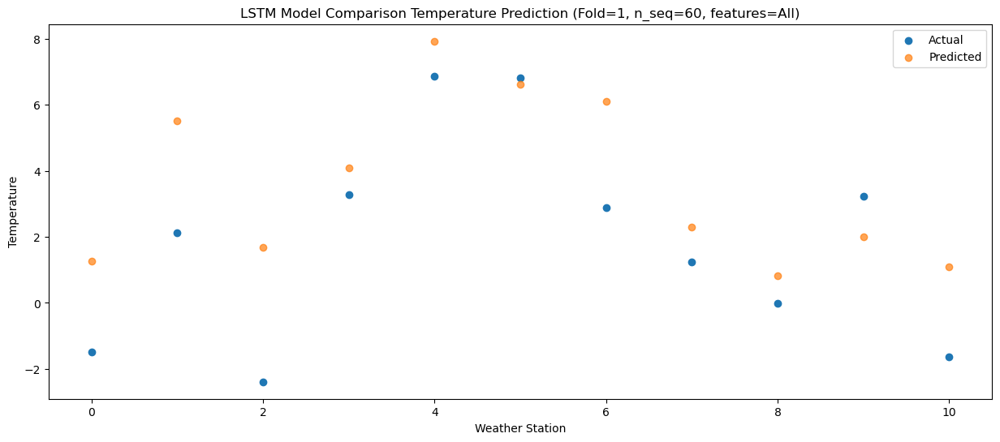

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -2.81  -3.018370
1                 1   -1.15   1.221322
2                 2   -5.47  -2.606552
3                 3   -0.13  -0.205060
4                 4    3.01   3.643094
5                 5    3.20   2.326480
6                 6   -0.11   1.828101
7                 7   -4.70  -1.995333
8                 8   -5.85  -3.457554
9                 9   -1.95  -2.279992
10               10   -5.53  -3.203977


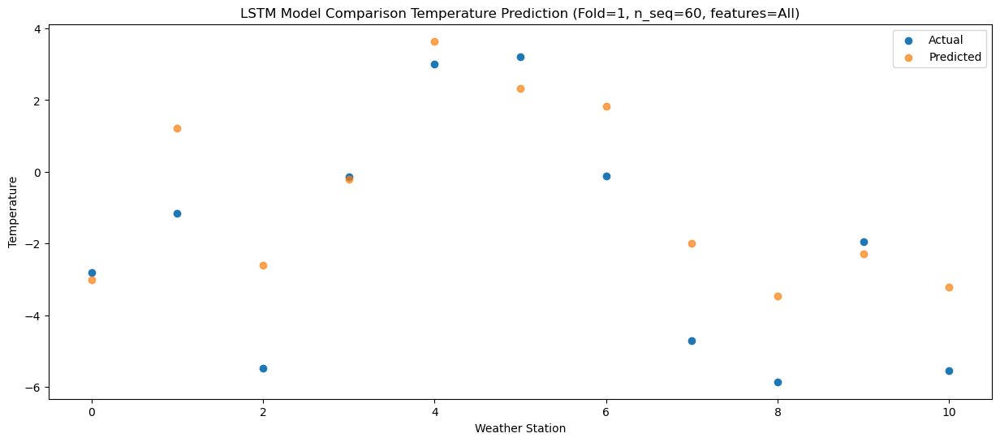

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -1.43   0.715292
1                 1    3.93   4.951646
2                 2   -0.13   1.122018
3                 3    6.18   3.519282
4                 4    9.38   7.370543
5                 5    9.32   6.057540
6                 6    4.10   5.556016
7                 7    4.30   1.730422
8                 8    2.10   0.271710
9                 9    5.76   1.449582
10               10   -3.58   0.523682


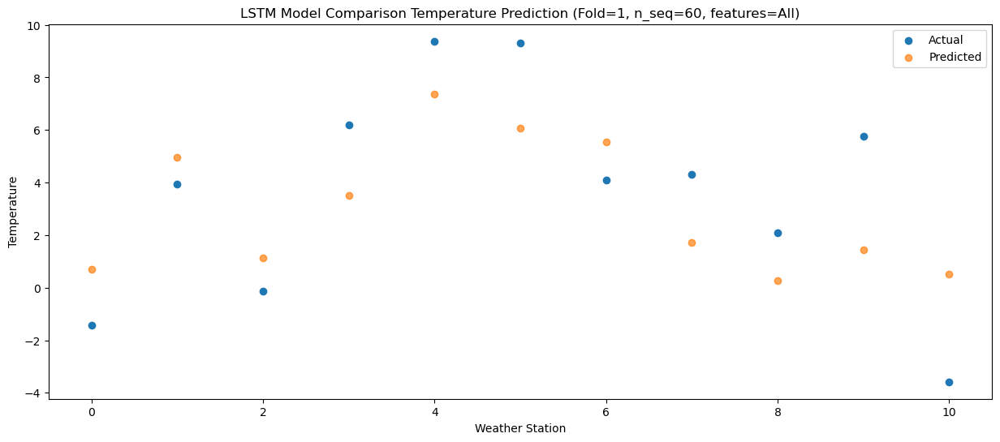

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    3.42   4.115206
1                 1    7.15   8.349534
2                 2    2.97   4.518655
3                 3    8.69   6.919069
4                 4   12.12  10.773237
5                 5   11.67   9.459523
6                 6    7.76   8.959498
7                 7    7.02   5.139446
8                 8    5.34   3.677841
9                 9    8.59   4.850047
10               10    0.82   3.923150


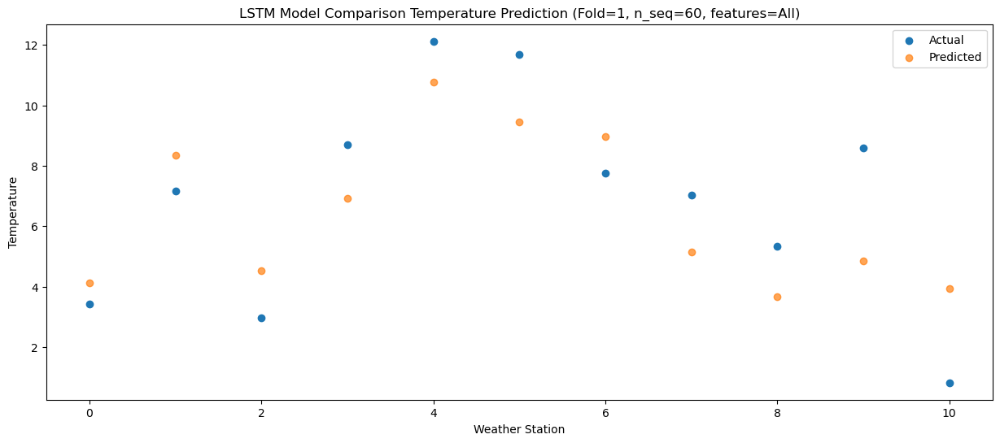

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    5.82   8.462958
1                 1   10.82  12.696222
2                 2    6.31   8.860525
3                 3   12.17  11.258519
4                 4   15.68  15.111245
5                 5   16.47  13.797198
6                 6   11.23  13.294303
7                 7   11.06   9.474934
8                 8   10.02   8.016879
9                 9   13.66   9.184533
10               10    5.21   8.263309


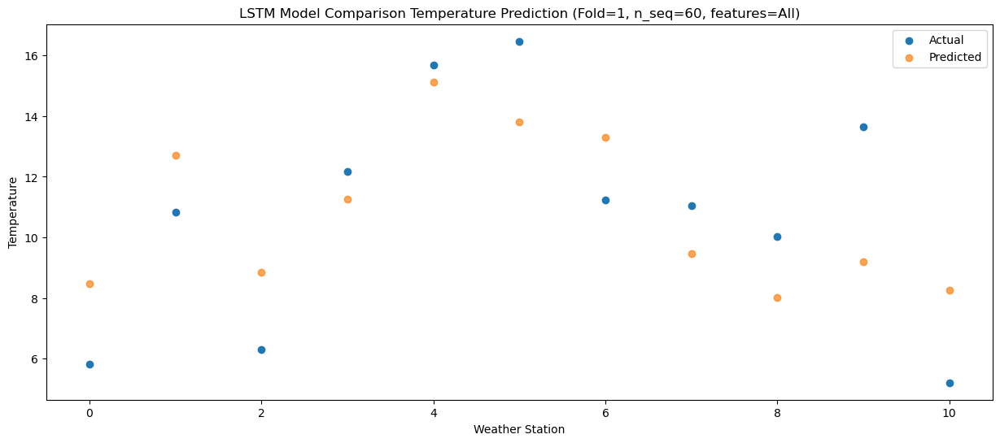

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   10.49  14.187279
1                 1   15.39  18.419497
2                 2   11.92  14.580563
3                 3   15.87  16.980565
4                 4   19.38  20.831583
5                 5   22.09  19.515849
6                 6   15.47  19.014433
7                 7   16.60  15.200461
8                 8   14.78  13.741678
9                 9   17.80  14.905655
10               10   10.80  13.990175


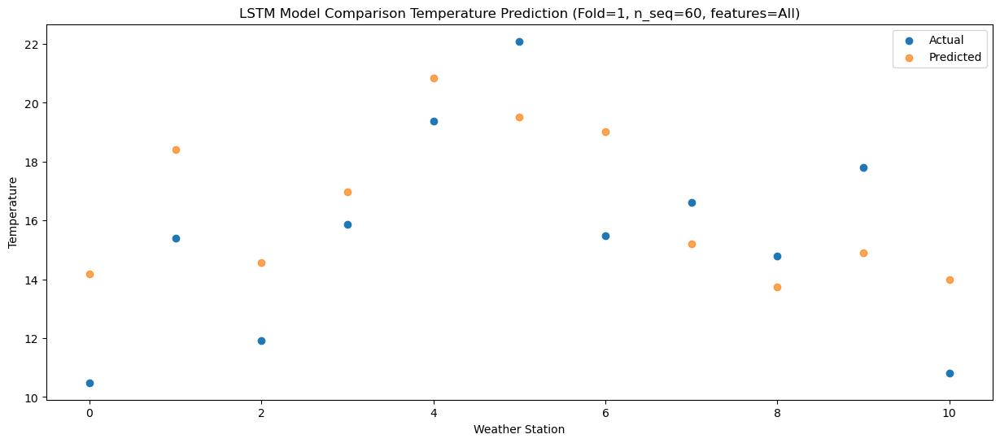

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   13.36  19.177038
1                 1   19.15  23.412338
2                 2   15.03  19.576104
3                 3   18.50  21.977944
4                 4   22.27  25.830708
5                 5   24.95  24.515809
6                 6   19.40  24.011988
7                 7   19.67  20.196518
8                 8   20.48  18.739109
9                 9   24.21  19.901736
10               10   16.91  18.983203


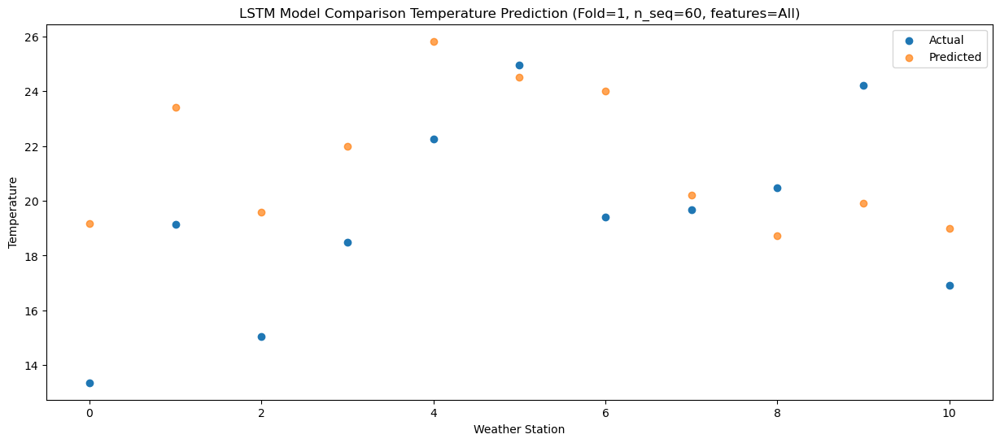

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   14.32  20.973775
1                 1   20.08  25.212411
2                 2   15.05  21.377719
3                 3   17.89  23.781588
4                 4   22.08  27.633028
5                 5   23.95  26.323083
6                 6   20.43  25.819724
7                 7   20.31  22.007254
8                 8   21.33  20.551164
9                 9   24.94  21.709028
10               10   18.84  20.794802


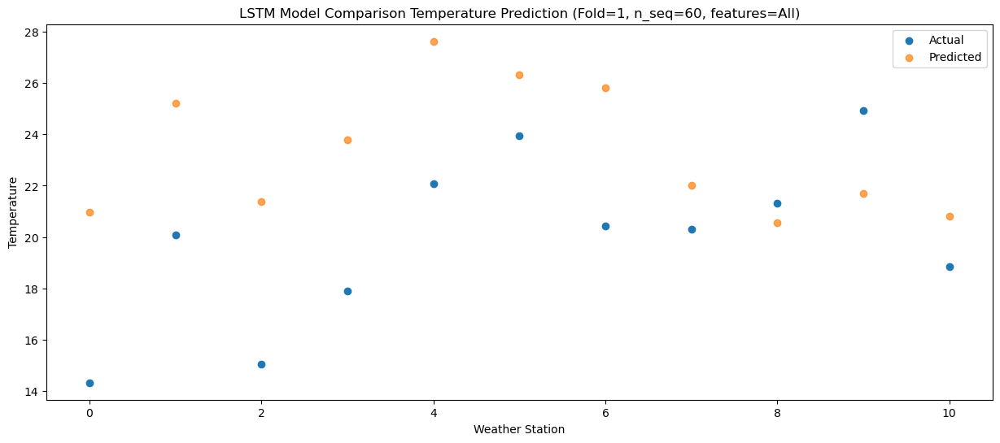

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   12.97  19.559338
1                 1   19.80  23.796184
2                 2   15.36  19.961742
3                 3   19.02  22.372058
4                 4   23.40  26.226261
5                 5   25.55  24.916705
6                 6   20.10  24.407961
7                 7   20.72  20.602284
8                 8   23.44  19.149145
9                 9   25.74  20.305485
10               10   16.69  19.382301


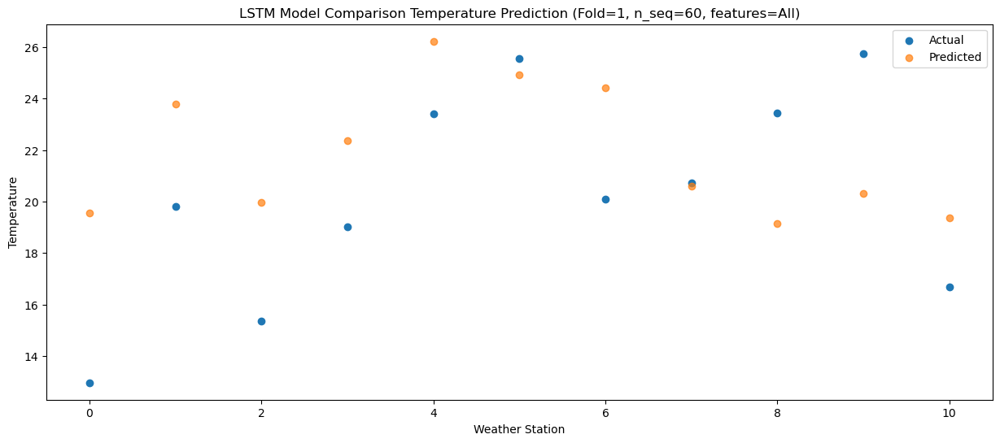

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   10.53  16.525263
1                 1   16.08  20.764223
2                 2   13.05  16.930804
3                 3   16.42  19.337196
4                 4   20.11  23.191237
5                 5   19.84  21.876782
6                 6   16.80  21.371536
7                 7   18.85  17.568995
8                 8   17.47  16.115930
9                 9   21.18  17.267733
10               10   12.96  16.352083


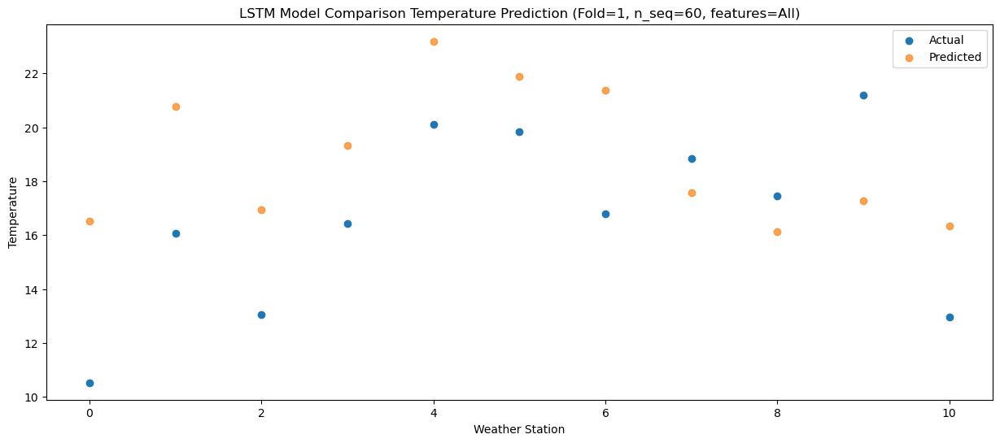

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    5.65  11.128666
1                 1   11.63  15.371292
2                 2    8.05  11.537351
3                 3   13.73  13.940282
4                 4   16.96  17.789556
5                 5   18.69  16.467100
6                 6   12.00  15.970092
7                 7   13.38  12.167842
8                 8   13.61  10.710640
9                 9   16.33  11.855710
10               10    8.09  10.944345


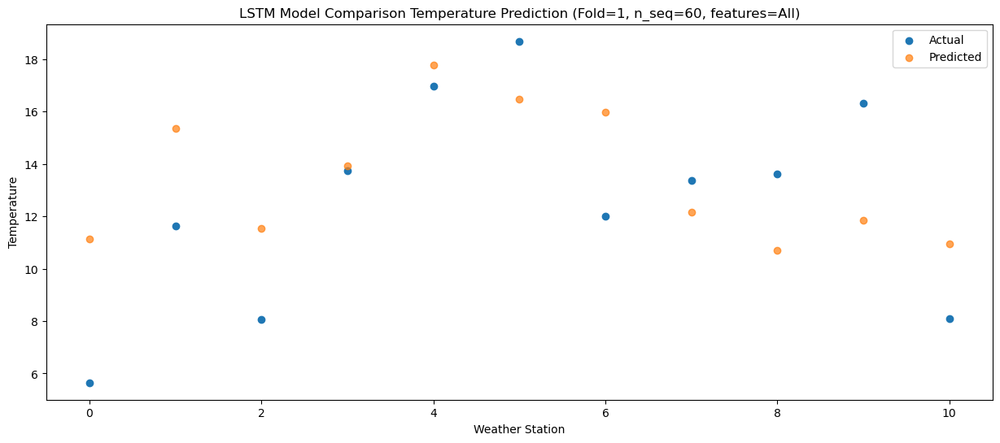

f, t:
[[-1.840e+00  3.520e+00 -1.480e+00  4.050e+00  8.110e+00  7.800e+00
   3.880e+00  9.200e-01  4.400e-01  4.680e+00 -1.560e+00]
 [-1.310e+00  2.610e+00 -1.050e+00  2.630e+00  6.220e+00  5.770e+00
   3.150e+00  3.000e-01 -1.410e+00  3.320e+00 -4.370e+00]
 [-1.420e+00  1.500e+00 -1.580e+00  3.380e+00  7.030e+00  5.110e+00
   2.340e+00 -5.500e-01 -1.230e+00  2.870e+00 -4.030e+00]
 [-1.560e+00  1.590e+00 -1.300e+00  2.850e+00  6.650e+00  4.590e+00
   2.410e+00  1.300e-01 -1.740e+00  1.630e+00 -3.290e+00]
 [ 3.500e+00  7.590e+00  5.800e+00  1.049e+01  1.469e+01  1.194e+01
   8.080e+00  7.050e+00  6.090e+00  9.590e+00  1.030e+00]
 [ 4.990e+00  8.810e+00  4.830e+00  1.037e+01  1.443e+01  1.473e+01
   9.710e+00  8.190e+00  7.470e+00  1.190e+01  2.660e+00]
 [ 8.070e+00  1.216e+01  8.980e+00  1.412e+01  1.823e+01  1.992e+01
   1.249e+01  1.269e+01  1.358e+01  1.843e+01  8.120e+00]
 [ 1.107e+01  1.651e+01  1.321e+01  1.690e+01  2.126e+01  2.264e+01
   1.716e+01  1.825e+01  1.869e+01  2.481e+0

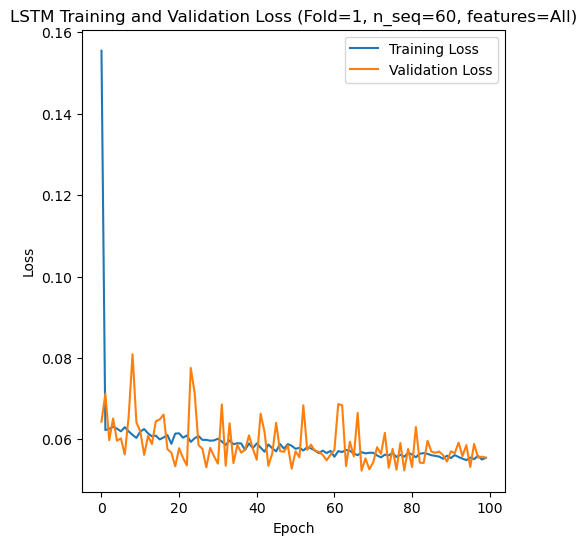

[[ 8.61  4.71 12.22 ... 22.49 18.22 13.52]
 [ 6.28  3.18  8.73 ... 22.36 17.39  7.52]
 [17.82 16.52 20.35 ... 28.79 25.32 22.93]
 ...
 [ 6.77  9.55 12.16 ... 24.55 20.29 10.24]
 [12.04 12.81 10.78 ... 23.32 20.33 13.93]
 [ 8.57  6.56 11.36 ... 21.36 16.14 12.65]]
Epoch 1/100
84/84 [==============================] - 55s 324ms/step - loss: 0.1575 - accuracy: 0.3929 - mae: 0.1293 - rmse: 0.1575 - mape: inf - pearson: 0.6589 - val_loss: 0.0531 - val_accuracy: 0.6000 - val_mae: 0.0427 - val_rmse: 0.0531 - val_mape: 9.4229 - val_pearson: 0.8855
Epoch 2/100
84/84 [==============================] - 20s 234ms/step - loss: 0.0629 - accuracy: 0.5357 - mae: 0.0494 - rmse: 0.0629 - mape: inf - pearson: 0.8271 - val_loss: 0.0629 - val_accuracy: 0.6000 - val_mae: 0.0487 - val_rmse: 0.0629 - val_mape: 10.8320 - val_pearson: 0.8641
Epoch 3/100
84/84 [==============================] - 15s 184ms/step - loss: 0.0632 - accuracy: 0.4881 - mae: 0.0498 - rmse: 0.0632 - mape: inf - pearson: 0.8241 - val_loss: 

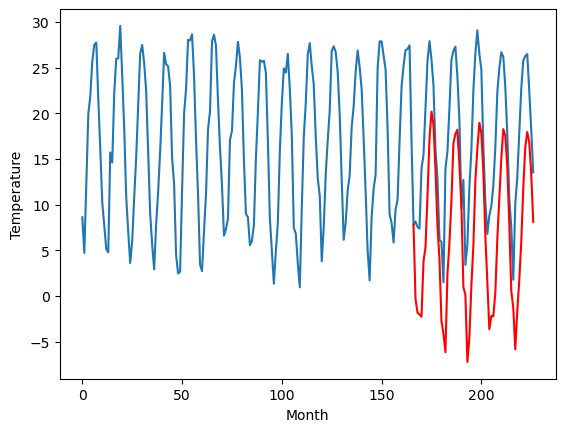

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.41		-0.25		-3.66
1.13		-1.80		-2.93
0.89		-1.99		-2.88
0.16		-2.24		-2.40
8.17		3.79		-4.38
10.40		5.32		-5.08
17.20		10.94		-6.26
24.40		17.21		-7.19
24.43		20.19		-4.24
23.10		18.76		-4.34
16.97		13.87		-3.10
9.98		7.70		-2.28
6.86		4.08		-2.78
0.23		-2.71		-2.94
0.15		-4.09		-4.24
-3.89		-6.11		-2.22
6.30		2.40		-3.90
10.06		5.87		-4.19
15.24		10.45		-4.79
22.49		16.77		-5.72
23.18		17.79		-5.39
23.94		18.25		-5.69
21.70		14.41		-7.29
13.44		9.94		-3.50
6.73		1.03		-5.70
4.34		0.20		-4.14
-0.35		-7.16		-6.81
-0.36		-4.48		-4.12
6.62		1.18		-5.44
13.30		5.58		-7.72
19.10		12.67		-6.43
22.90		16.19		-6.71
26.14		19.01		-7.13
23.83		17.88		-5.95
21.07		13.62		-7.45
12.69		6.63		-6.06
2.70		1.59		-1.11
-0.01		-3.57		-3.56
-0.26		-2.14		-1.88
1.34		-2.17		-3.51
5.41		0.40		-5.01
11.27		6.31		-4.96
16.76		10.76		-6.00
19.37		15.14		-4.23
23.47		18.35		-5.12
23.96		17.61		-6.35
21.09		14.26		-6

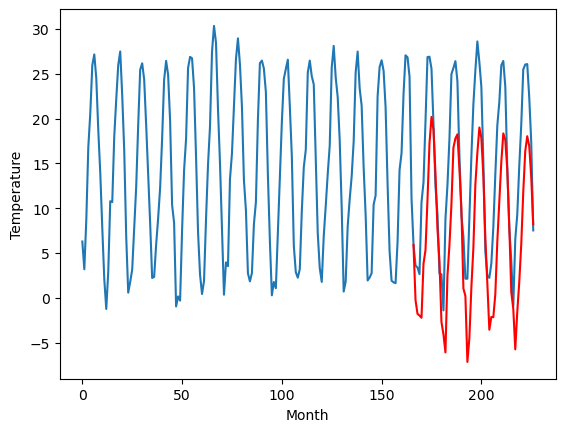

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.10		-2.57		-2.47
-1.22		-4.11		-2.89
-2.37		-4.30		-1.93
-1.33		-4.55		-3.22
2.29		1.49		-0.80
3.68		3.03		-0.65
4.99		8.63		3.64
7.58		14.90		7.32
8.22		17.86		9.64
7.91		16.45		8.54
6.65		11.54		4.89
5.38		5.37		-0.01
1.96		1.74		-0.22
-5.03		-5.06		-0.03
-4.37		-6.43		-2.06
-1.64		-8.45		-6.81
0.17		0.04		-0.13
1.98		3.50		1.52
5.56		8.08		2.52
6.78		14.39		7.61
7.57		15.41		7.84
7.62		15.87		8.25
6.34		12.03		5.69
5.20		7.56		2.36
-1.65		-1.34		0.31
-0.75		-2.18		-1.43
-5.01		-9.55		-4.54
-2.68		-6.86		-4.18
0.79		-1.20		-1.99
2.60		3.19		0.59
5.36		10.28		4.92
7.17		13.80		6.63
7.35		16.60		9.25
6.78		15.47		8.69
5.37		11.23		5.86
2.74		4.24		1.50
0.98		-0.79		-1.77
-3.12		-5.95		-2.83
-3.32		-4.52		-1.20
-0.26		-4.54		-4.28
0.76		-1.97		-2.73
3.30		3.93		0.63
4.28		8.37		4.09
6.69		12.74		6.05
8.60		15.95		7.35
8.78		15.20		6.42
6.83		11.84		5.01
3.25		5.48		2.23
-0.73		-1.80		-1.07


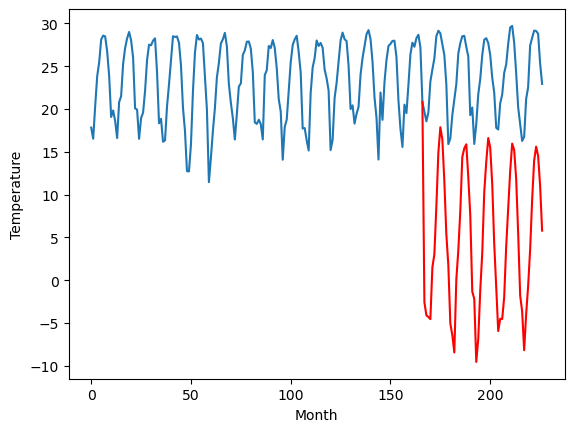

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
9.24		8.97		-0.27
6.18		7.43		1.25
6.45		7.24		0.79
6.60		7.00		0.40
10.15		13.04		2.89
11.38		14.58		3.20
17.27		20.19		2.92
23.33		26.46		3.13
27.61		29.43		1.82
25.76		28.00		2.24
21.18		23.10		1.92
15.96		16.93		0.97
12.00		13.31		1.31
5.17		6.52		1.35
2.09		5.13		3.04
2.11		3.12		1.01
6.22		11.61		5.39
10.72		15.08		4.36
15.98		19.67		3.69
21.55		25.99		4.44
23.55		27.00		3.45
24.61		27.47		2.86
21.44		23.63		2.19
17.61		19.16		1.55
9.53		10.27		0.74
7.61		9.43		1.82
1.46		2.06		0.60
3.78		4.76		0.98
7.64		10.42		2.78
12.08		14.81		2.73
17.42		21.91		4.49
21.66		25.42		3.76
26.28		28.23		1.95
26.20		27.11		0.91
21.16		22.86		1.70
15.72		15.87		0.15
11.92		10.84		-1.08
5.75		5.69		-0.06
7.04		7.13		0.09
5.16		7.11		1.95
7.60		9.67		2.07
13.32		15.58		2.26
16.95		20.02		3.07
20.74		24.39		3.65
26.31		27.60		1.29
24.30		26.85		2.55
21.88		23.49		1.61
16.86		17.14		0.28
8.88		9.86		0.98
8.14

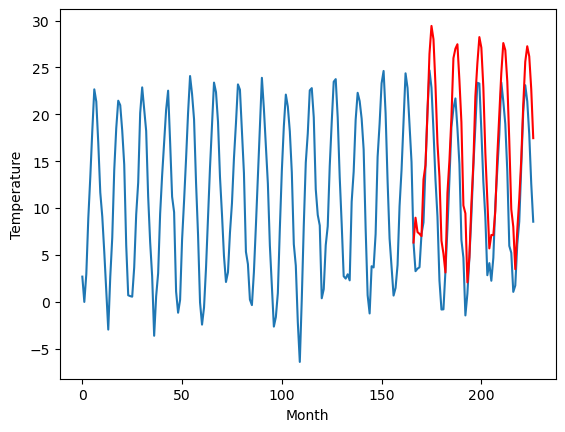

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.25		-6.17		0.08
-5.90		-7.70		-1.80
-5.56		-7.90		-2.34
-4.92		-8.14		-3.22
1.77		-2.10		-3.87
1.24		-0.57		-1.81
4.21		5.05		0.84
7.25		11.32		4.07
7.99		14.28		6.29
8.36		12.86		4.50
6.01		7.95		1.94
2.32		1.78		-0.54
-1.80		-1.84		-0.04
-8.10		-8.64		-0.54
-7.75		-10.02		-2.27
-8.49		-12.03		-3.54
-1.16		-3.54		-2.38
-0.29		-0.09		0.20
4.18		4.49		0.31
7.66		10.81		3.15
8.25		11.82		3.57
8.42		12.29		3.87
5.88		8.44		2.56
3.14		3.97		0.83
-5.13		-4.92		0.21
-1.72		-5.78		-4.06
-9.45		-13.14		-3.69
-6.31		-10.45		-4.14
-2.55		-4.79		-2.24
1.25		-0.40		-1.65
6.41		6.68		0.27
9.00		10.20		1.20
8.83		13.01		4.18
8.01		11.88		3.87
6.04		7.64		1.60
-0.15		0.66		0.81
-3.22		-4.37		-1.15
-5.73		-9.51		-3.78
-4.56		-8.08		-3.52
-2.43		-8.11		-5.68
-0.60		-5.55		-4.95
1.32		0.36		-0.96
5.35		4.80		-0.55
9.00		9.17		0.17
10.44		12.37		1.93
11.74		11.61		-0.13
7.31		8.25		0.94
1.15		1.89		0.74
-3.9

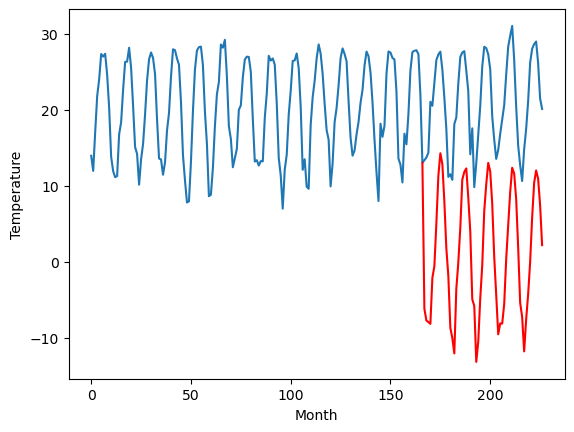

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.27		5.09		-2.18
5.84		3.56		-2.28
6.21		3.37		-2.84
5.45		3.12		-2.33
13.54		9.16		-4.38
13.51		10.70		-2.81
17.35		16.31		-1.04
20.96		22.58		1.62
22.66		25.53		2.87
22.96		24.12		1.16
18.56		19.21		0.65
14.09		13.05		-1.04
11.41		9.44		-1.97
5.30		2.65		-2.65
4.71		1.27		-3.44
2.36		-0.74		-3.10
10.74		7.75		-2.99
12.86		11.21		-1.65
16.90		15.79		-1.11
21.45		22.11		0.66
21.53		23.12		1.59
22.64		23.59		0.95
19.90		19.74		-0.16
16.60		15.27		-1.33
8.96		6.37		-2.59
12.20		5.52		-6.68
3.77		-1.85		-5.62
3.39		0.85		-2.54
9.51		6.50		-3.01
15.66		10.90		-4.76
20.26		17.98		-2.28
23.98		21.50		-2.48
25.34		24.30		-1.04
22.62		23.17		0.55
19.96		18.93		-1.03
14.39		11.94		-2.45
8.51		6.92		-1.59
6.28		1.76		-4.52
7.04		3.19		-3.85
8.23		3.17		-5.06
12.03		5.74		-6.29
12.95		11.64		-1.31
18.03		16.08		-1.95
22.95		20.45		-2.50
25.11		23.67		-1.44
26.81		22.92		-3.89
22.33		19.56		-2.77
14.44	

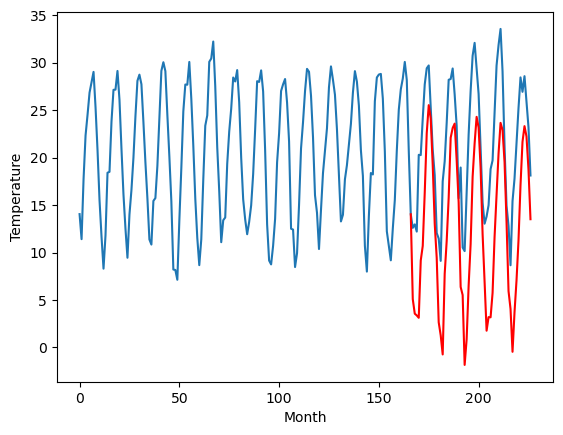

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.65		5.19		-1.46
4.84		3.66		-1.18
5.19		3.47		-1.72
4.63		3.22		-1.41
12.28		9.26		-3.02
12.59		10.79		-1.80
17.49		16.42		-1.07
22.23		22.68		0.45
23.41		25.63		2.22
23.64		24.22		0.58
17.70		19.31		1.61
12.22		13.15		0.93
9.73		9.54		-0.19
3.27		2.75		-0.52
2.57		1.37		-1.20
-0.54		-0.65		-0.11
9.83		7.85		-1.98
11.53		11.32		-0.21
15.61		15.89		0.28
21.17		22.21		1.04
22.06		23.22		1.16
22.62		23.69		1.07
20.35		19.84		-0.51
15.84		15.36		-0.48
7.87		6.46		-1.41
10.16		5.62		-4.54
1.68		-1.75		-3.43
1.51		0.95		-0.56
8.09		6.60		-1.49
14.36		11.00		-3.36
19.38		18.08		-1.30
24.09		21.59		-2.50
26.88		24.39		-2.49
24.07		23.27		-0.80
20.24		19.02		-1.22
13.86		12.03		-1.83
7.19		7.00		-0.19
4.57		1.84		-2.73
5.45		3.27		-2.18
5.64		3.24		-2.40
10.29		5.82		-4.47
12.11		11.71		-0.40
17.85		16.16		-1.69
22.00		20.52		-1.48
24.56		23.74		-0.82
26.90		23.00		-3.90
22.12		19.64		-2.48
13.40		1

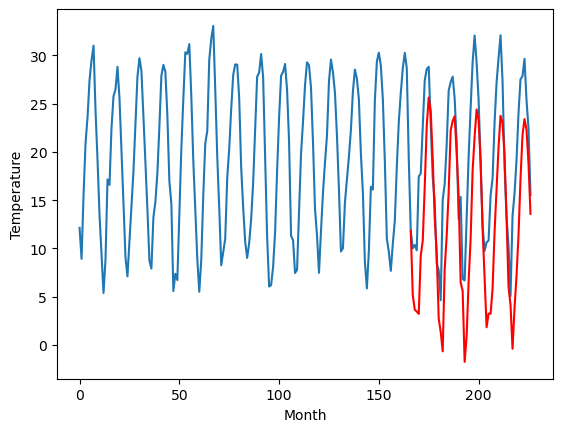

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.03		3.29		-2.74
1.50		1.75		0.25
2.75		1.57		-1.18
3.56		1.31		-2.25
8.06		7.36		-0.70
13.04		8.89		-4.15
19.33		14.50		-4.83
22.85		20.77		-2.08
24.95		23.73		-1.22
25.39		22.32		-3.07
19.14		17.41		-1.73
13.54		11.24		-2.30
7.98		7.61		-0.37
0.33		0.80		0.47
0.87		-0.58		-1.45
3.79		-2.59		-6.38
6.89		5.90		-0.99
13.55		9.36		-4.19
18.56		13.94		-4.62
23.55		20.26		-3.29
22.35		21.27		-1.08
21.83		21.73		-0.10
19.65		17.89		-1.76
13.09		13.41		0.32
7.69		4.52		-3.17
4.34		3.67		-0.67
1.34		-3.70		-5.04
2.31		-1.02		-3.33
7.37		4.63		-2.74
14.56		9.03		-5.53
19.26		16.11		-3.15
23.12		19.64		-3.48
24.26		22.43		-1.83
21.24		21.31		0.07
19.51		17.07		-2.44
11.30		10.08		-1.22
4.41		5.04		0.63
2.24		-0.12		-2.36
1.53		1.31		-0.22
2.74		1.27		-1.47
7.44		3.85		-3.59
13.08		9.75		-3.33
17.73		14.20		-3.53
22.39		18.56		-3.83
27.14		21.77		-5.37
24.14		21.02		-3.12
21.48		17.65		-3.83
14.74		11

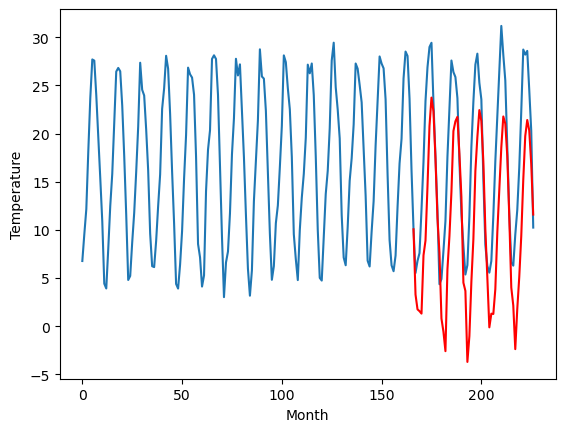

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.17		-2.07		-4.24
-1.37		-3.61		-2.24
-0.83		-3.79		-2.96
1.28		-4.04		-5.32
1.35		1.98		0.63
4.56		3.52		-1.04
8.61		9.13		0.52
9.90		15.40		5.50
12.31		18.35		6.04
14.71		16.94		2.23
13.11		12.03		-1.08
9.87		5.86		-4.01
3.15		2.24		-0.91
1.10		-4.57		-5.67
1.04		-5.94		-6.98
0.12		-7.94		-8.06
-0.28		0.54		0.82
3.58		4.01		0.43
5.80		8.58		2.78
10.04		14.90		4.86
13.02		15.92		2.90
12.62		16.38		3.76
10.84		12.53		1.69
5.86		8.05		2.19
4.60		-0.84		-5.44
-1.91		-1.70		0.21
0.50		-9.06		-9.56
1.37		-6.37		-7.74
3.16		-0.72		-3.88
5.28		3.68		-1.60
6.24		10.77		4.53
11.16		14.30		3.14
11.97		17.10		5.13
14.01		15.98		1.97
13.60		11.73		-1.87
7.33		4.74		-2.59
1.10		-0.29		-1.39
-1.60		-5.44		-3.84
-1.94		-4.02		-2.08
-2.26		-4.04		-1.78
-1.25		-1.46		-0.21
2.59		4.44		1.85
3.80		8.87		5.07
5.76		13.24		7.48
12.68		16.45		3.77
12.31		15.71		3.40
8.81		12.34		3.53
7.22		5.98		-1.24
2.83		-1.3

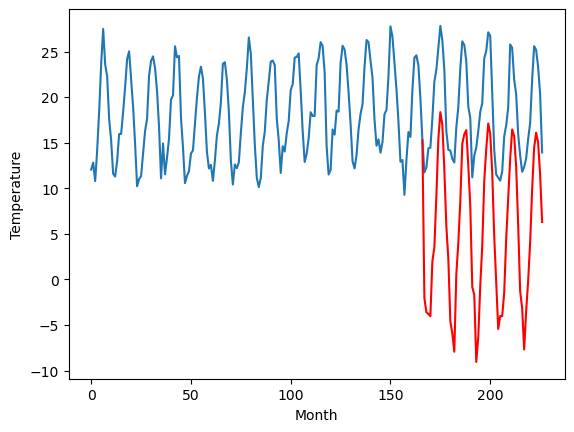

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.04		3.19		1.15
1.63		1.66		0.03
1.34		1.47		0.13
2.38		1.22		-1.16
7.61		7.26		-0.35
8.91		8.79		-0.12
11.51		14.40		2.89
16.80		20.67		3.87
19.79		23.62		3.83
18.79		22.21		3.42
14.76		17.30		2.54
10.84		11.14		0.30
6.23		7.52		1.29
-0.77		0.71		1.48
-1.18		-0.66		0.52
-0.68		-2.67		-1.99
6.20		5.80		-0.40
8.99		9.27		0.28
13.01		13.84		0.83
17.30		20.16		2.86
18.87		21.17		2.30
18.96		21.64		2.68
14.85		17.79		2.94
11.57		13.31		1.74
2.66		4.43		1.77
4.58		3.57		-1.01
-1.90		-3.80		-1.90
2.12		-1.11		-3.23
6.23		4.55		-1.68
9.52		8.95		-0.57
14.37		16.04		1.67
18.13		19.55		1.42
19.57		22.36		2.79
18.19		21.23		3.04
14.88		16.99		2.11
7.57		10.01		2.44
5.45		4.98		-0.47
-1.08		-0.16		0.92
2.12		1.27		-0.85
5.14		1.24		-3.90
5.59		3.81		-1.78
9.11		9.71		0.60
11.89		14.14		2.25
15.55		18.50		2.95
19.14		21.70		2.56
18.59		20.95		2.36
14.63		17.59		2.96
9.34		11.22		1.88
3.44		3.95		0.51
0

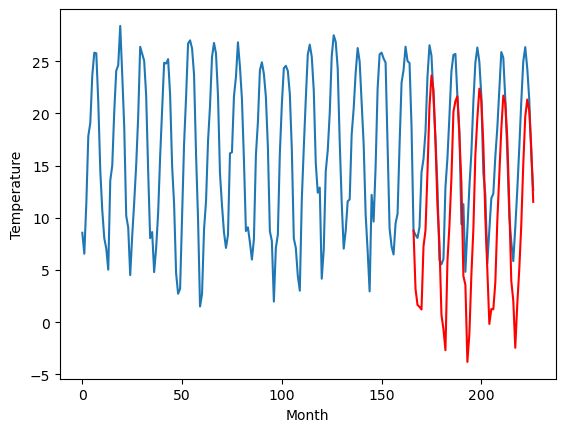

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.92		-0.28		1.64
-1.32		-1.81		-0.49
-1.76		-2.00		-0.24
-1.96		-2.24		-0.28
4.08		3.80		-0.28
4.51		5.33		0.82
8.55		10.94		2.39
13.92		17.21		3.29
17.21		20.17		2.96
15.95		18.76		2.81
12.00		13.85		1.85
7.34		7.68		0.34
2.29		4.07		1.78
-4.77		-2.74		2.03
-4.44		-4.12		0.32
-3.09		-6.12		-3.03
3.12		2.36		-0.76
5.09		5.83		0.74
10.00		10.41		0.41
15.41		16.73		1.32
16.72		17.75		1.03
16.80		18.22		1.42
12.31		14.37		2.06
8.55		9.90		1.35
-1.67		1.02		2.69
0.43		0.16		-0.27
-6.44		-7.20		-0.76
-1.85		-4.51		-2.66
2.70		1.15		-1.55
5.86		5.54		-0.32
12.10		12.64		0.54
15.75		16.16		0.41
17.10		18.96		1.86
15.85		17.84		1.99
11.70		13.60		1.90
4.42		6.62		2.20
1.97		1.59		-0.38
-3.49		-3.55		-0.06
-1.57		-2.11		-0.54
1.22		-2.14		-3.36
1.75		0.43		-1.32
6.64		6.33		-0.31
9.99		10.77		0.78
12.90		15.13		2.23
16.45		18.33		1.88
15.74		17.59		1.85
12.96		14.23		1.27
6.91		7.87		0.96
0.70		0.5

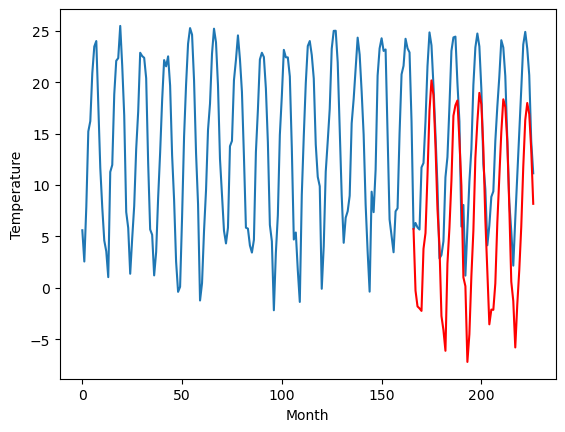

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -0.65  -0.294205
1                 1    3.41  -0.254686
2                 2   -0.10  -2.573707
3                 3    9.24   8.965560
4                 4   -6.25  -6.170393
5                 5    7.27   5.091354
6                 6    6.65   5.194064
7                 7    6.03   3.287591
8                 8    2.17  -2.070709
9                 9    2.04   3.193079
10               10   -1.92  -0.277386


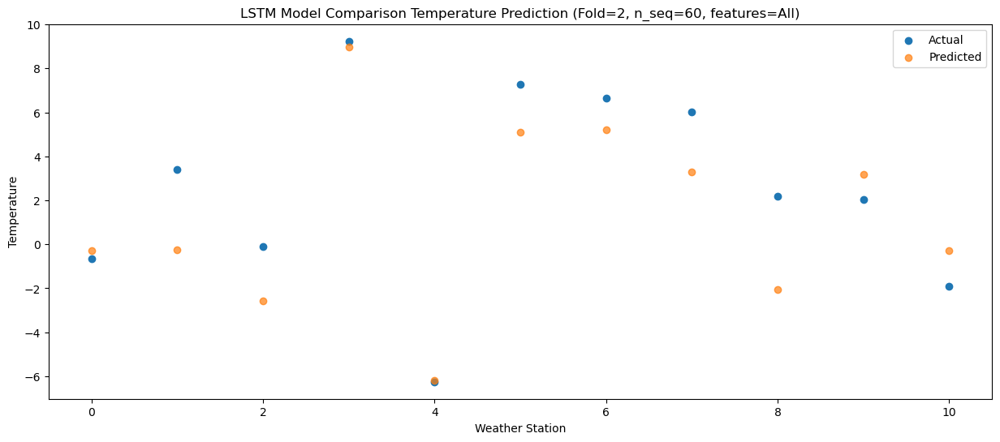

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.31  -1.835861
1                 1    1.13  -1.799910
2                 2   -1.22  -4.107628
3                 3    6.18   7.432770
4                 4   -5.90  -7.703502
5                 5    5.84   3.558053
6                 6    4.84   3.658404
7                 7    1.50   1.753619
8                 8   -1.37  -3.605062
9                 9    1.63   1.662145
10               10   -1.32  -1.805888


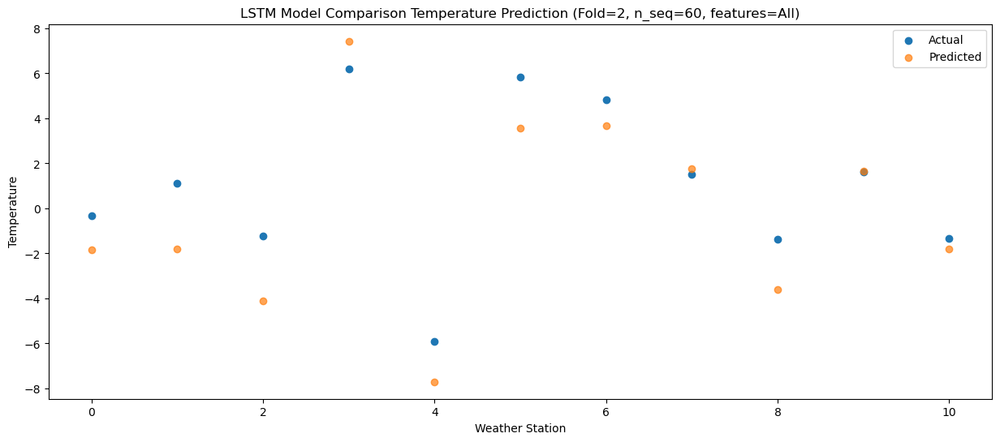

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.90  -2.020970
1                 1    0.89  -1.985148
2                 2   -2.37  -4.300463
3                 3    6.45   7.241651
4                 4   -5.56  -7.898318
5                 5    6.21   3.370511
6                 6    5.19   3.473365
7                 7    2.75   1.565133
8                 8   -0.83  -3.792012
9                 9    1.34   1.471019
10               10   -1.76  -1.996134


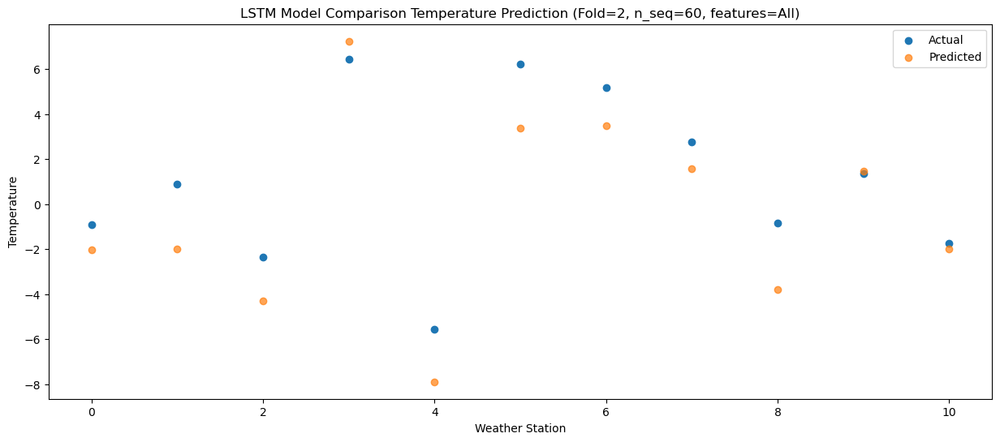

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.09  -2.266843
1                 1    0.16  -2.235627
2                 2   -1.33  -4.553831
3                 3    6.60   6.999010
4                 4   -4.92  -8.143206
5                 5    5.45   3.120310
6                 6    4.63   3.218677
7                 7    3.56   1.312020
8                 8    1.28  -4.044793
9                 9    2.38   1.224016
10               10   -1.96  -2.242175


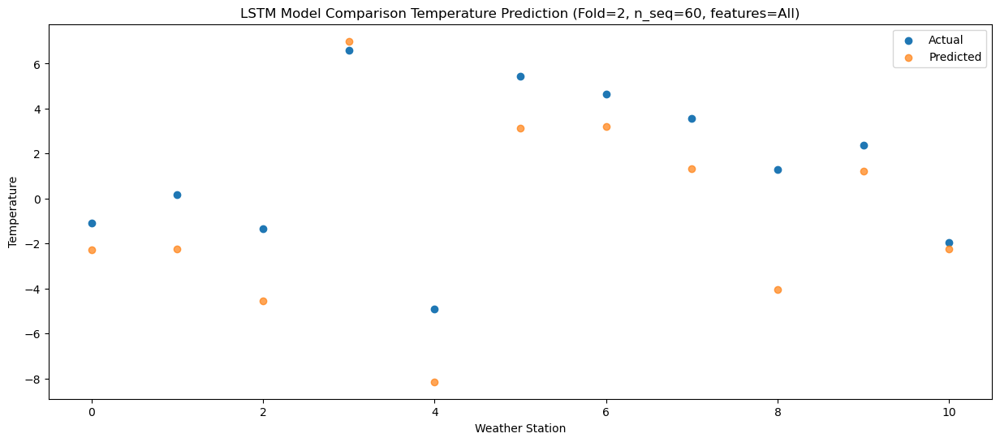

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    5.50   3.772538
1                 1    8.17   3.794010
2                 2    2.29   1.490854
3                 3   10.15  13.043153
4                 4    1.77  -2.096763
5                 5   13.54   9.161444
6                 6   12.28   9.260009
7                 7    8.06   7.355071
8                 8    1.35   1.982849
9                 9    7.61   7.261508
10               10    4.08   3.796082


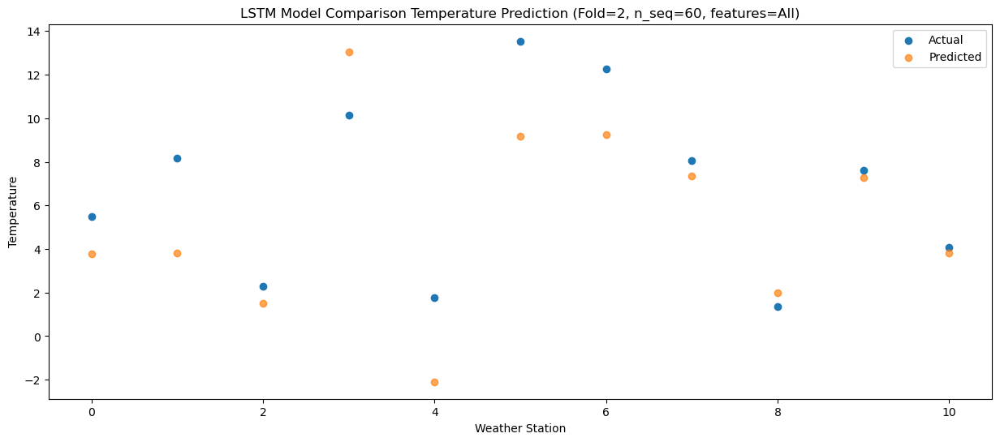

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    6.98   5.306884
1                 1   10.40   5.322953
2                 2    3.68   3.026154
3                 3   11.38  14.575451
4                 4    1.24  -0.566256
5                 5   13.51  10.695347
6                 6   12.59  10.794263
7                 7   13.04   8.888565
8                 8    4.56   3.521643
9                 9    8.91   8.794736
10               10    4.51   5.328651


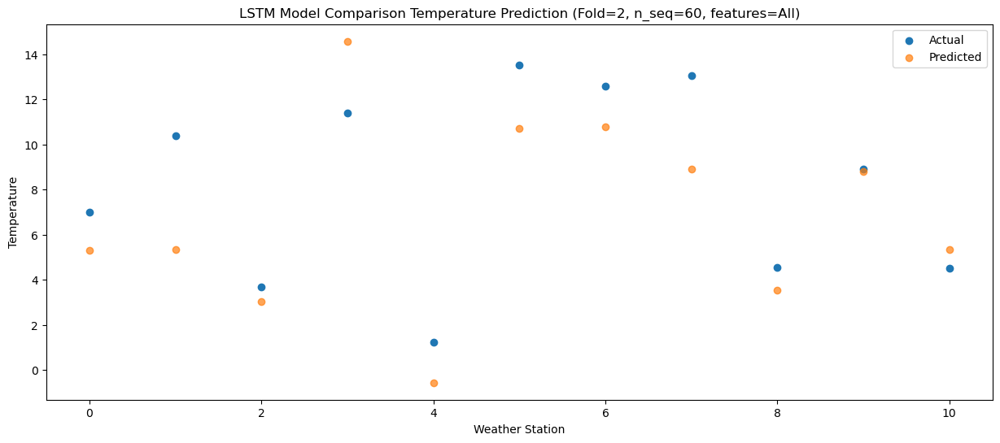

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   12.27  10.933803
1                 1   17.20  10.944993
2                 2    4.99   8.633378
3                 3   17.27  20.185412
4                 4    4.21   5.045875
5                 5   17.35  16.313008
6                 6   17.49  16.415428
7                 7   19.33  14.497141
8                 8    8.61   9.131715
9                 9   11.51  14.401365
10               10    8.55  10.943824


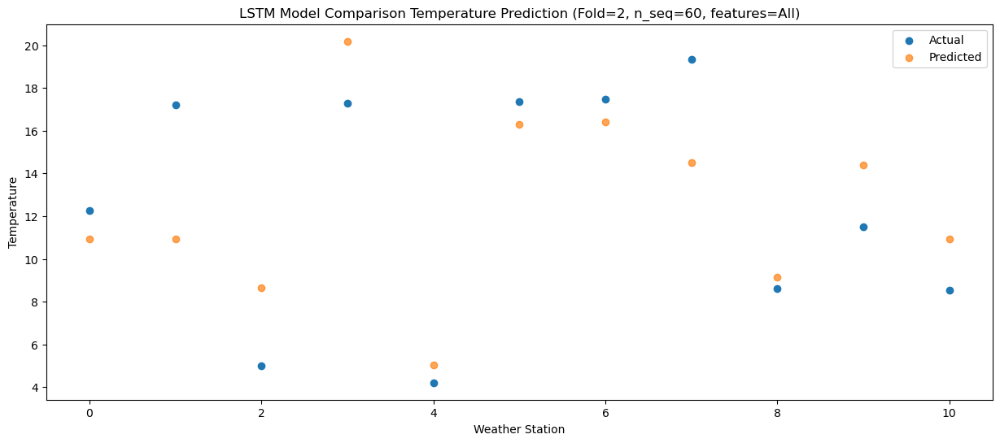

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   17.27  17.202650
1                 1   24.40  17.214937
2                 2    7.58  14.899435
3                 3   23.33  26.455821
4                 4    7.25  11.316742
5                 5   20.96  22.579547
6                 6   22.23  22.680371
7                 7   22.85  20.768217
8                 8    9.90  15.396082
9                 9   16.80  20.666794
10               10   13.92  17.214276


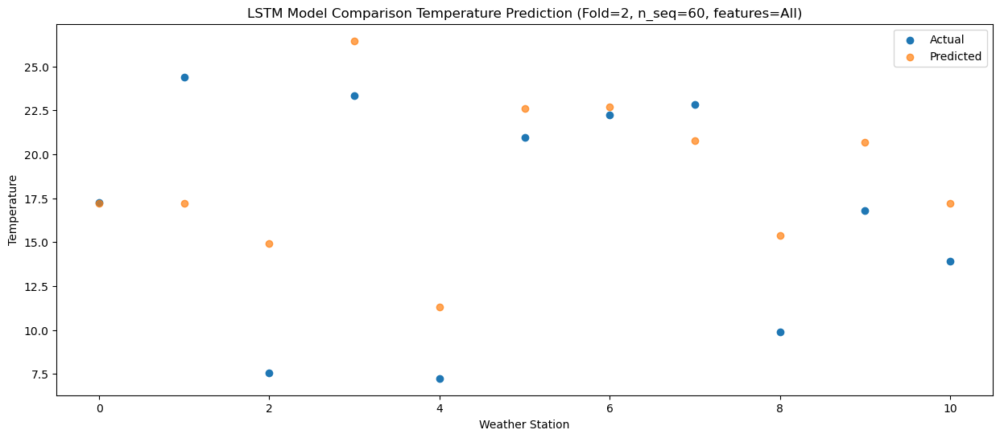

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   19.43  20.175150
1                 1   24.43  20.185705
2                 2    8.22  17.860099
3                 3   27.61  29.426397
4                 4    7.99  14.276211
5                 5   22.66  25.534260
6                 6   23.41  25.633580
7                 7   24.95  23.731366
8                 8   12.31  18.354037
9                 9   19.79  23.624066
10               10   17.21  20.172262


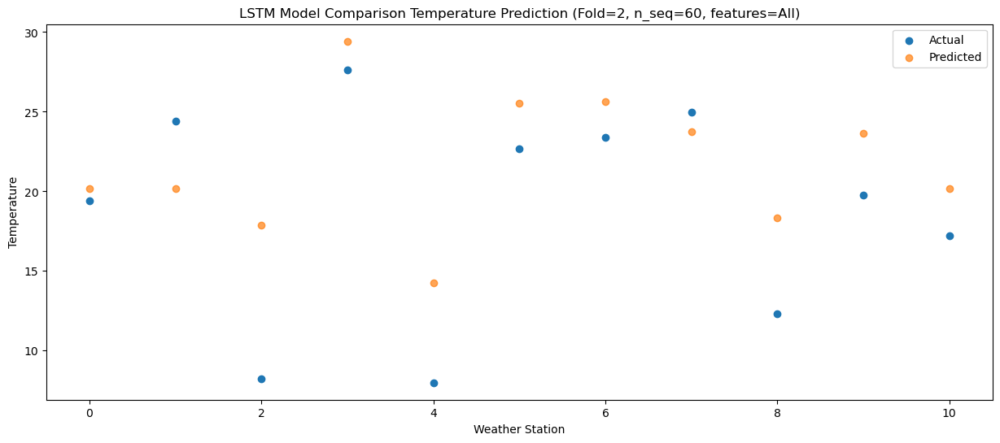

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   17.45  18.748494
1                 1   23.10  18.764853
2                 2    7.91  16.446464
3                 3   25.76  28.004040
4                 4    8.36  12.858438
5                 5   22.96  24.121150
6                 6   23.64  24.219179
7                 7   25.39  22.318983
8                 8   14.71  16.938235
9                 9   18.79  22.210681
10               10   15.95  18.757260


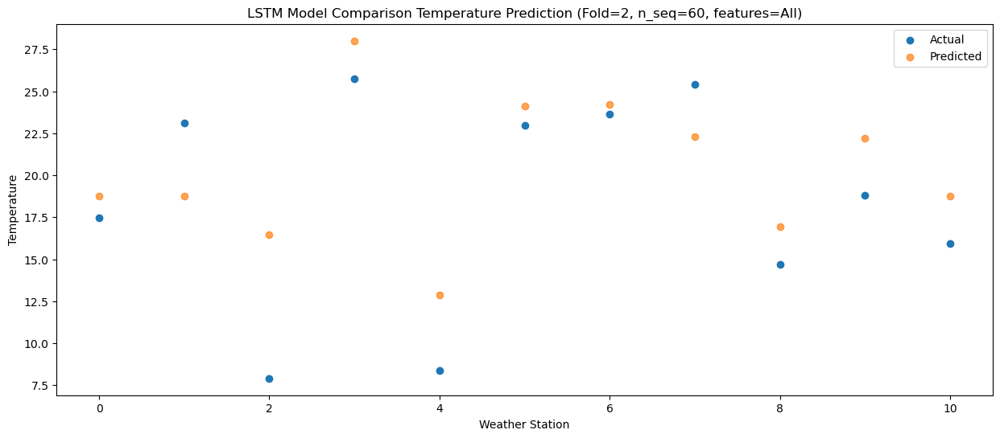

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   14.61  13.851447
1                 1   16.97  13.867001
2                 2    6.65  11.540748
3                 3   21.18  23.101160
4                 4    6.01   7.954165
5                 5   18.56  19.213885
6                 6   17.70  19.314319
7                 7   19.14  17.412617
8                 8   13.11  12.025718
9                 9   14.76  17.303122
10               10   12.00  13.851134


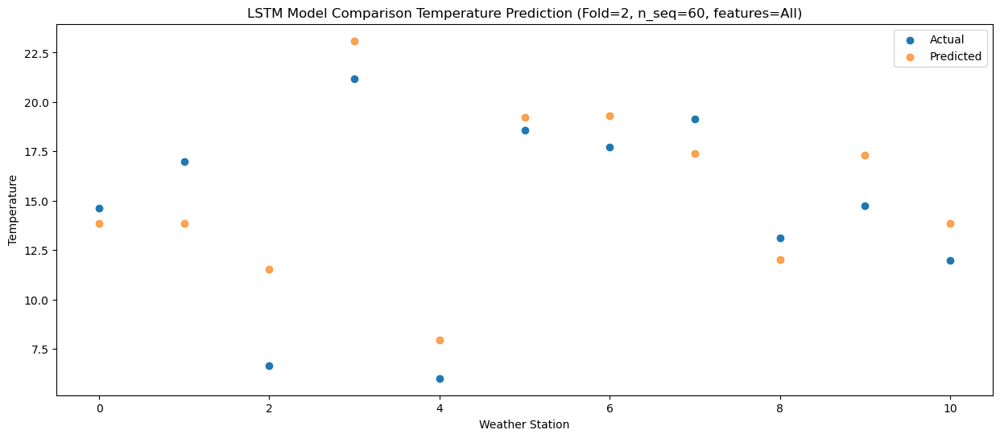

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.60   7.674076
1                 1    9.98   7.695674
2                 2    5.38   5.365440
3                 3   15.96  16.927168
4                 4    2.32   1.780520
5                 5   14.09  13.051633
6                 6   12.22  13.152805
7                 7   13.54  11.243033
8                 8    9.87   5.857176
9                 9   10.84  11.135252
10               10    7.34   7.679856


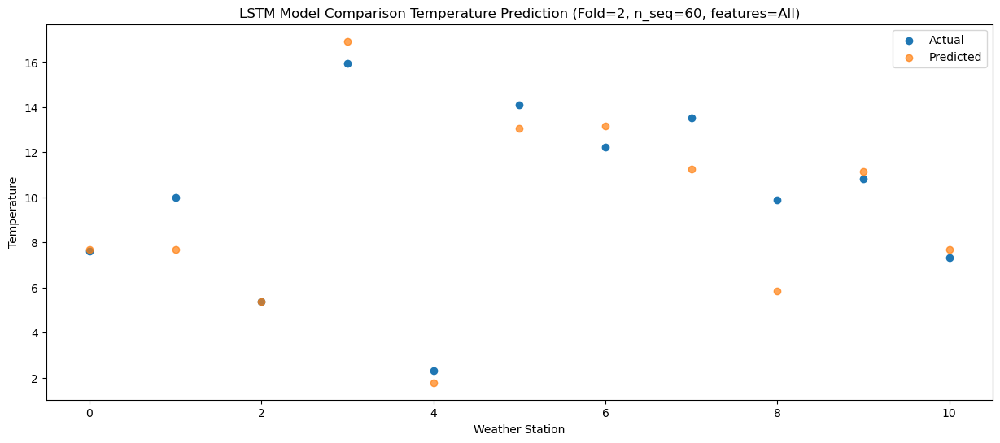

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.47   4.057041
1                 1    6.86   4.076117
2                 2    1.96   1.742946
3                 3   12.00  13.311397
4                 4   -1.80  -1.841023
5                 5   11.41   9.435510
6                 6    9.73   9.537650
7                 7    7.98   7.610224
8                 8    3.15   2.237802
9                 9    6.23   7.517411
10               10    2.29   4.065672


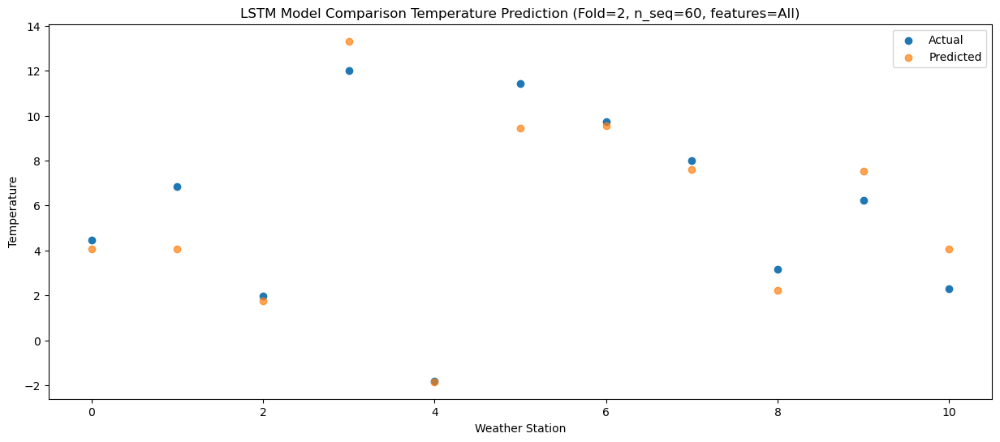

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.29  -2.741339
1                 1    0.23  -2.706577
2                 2   -5.03  -5.055110
3                 3    5.17   6.516011
4                 4   -8.10  -8.636721
5                 5    5.30   2.646368
6                 6    3.27   2.745855
7                 7    0.33   0.801521
8                 8    1.10  -4.567582
9                 9   -0.77   0.714640
10               10   -4.77  -2.739081


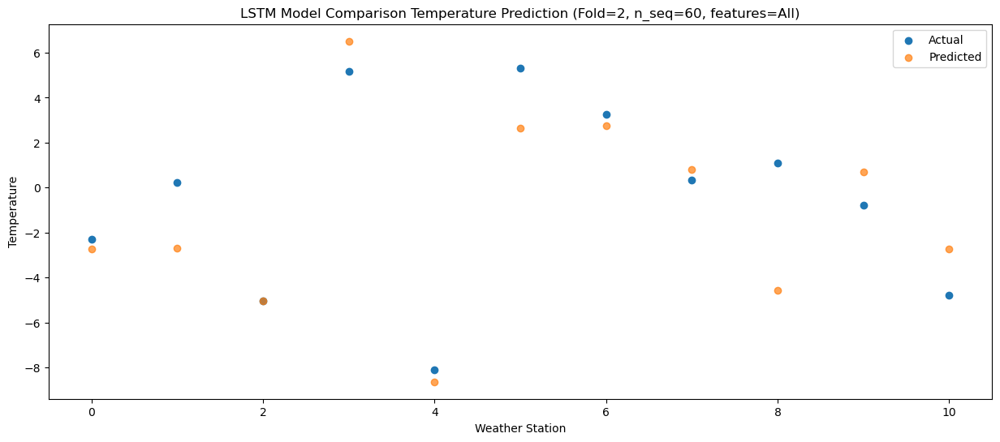

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.55  -4.124453
1                 1    0.15  -4.085890
2                 2   -4.37  -6.429275
3                 3    2.09   5.132060
4                 4   -7.75 -10.016287
5                 5    4.71   1.269812
6                 6    2.57   1.369213
7                 7    0.87  -0.575242
8                 8    1.04  -5.936627
9                 9   -1.18  -0.662255
10               10   -4.44  -4.116512


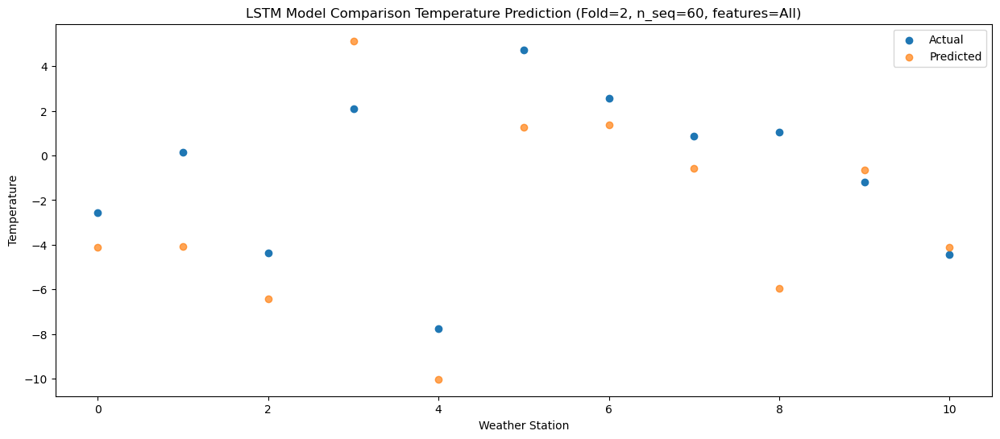

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -6.95  -6.152168
1                 1   -3.89  -6.105716
2                 2   -1.64  -8.445958
3                 3    2.11   3.119647
4                 4   -8.49 -12.030085
5                 5    2.36  -0.741898
6                 6   -0.54  -0.650078
7                 7    3.79  -2.586628
8                 8    0.12  -7.941024
9                 9   -0.68  -2.674398
10               10   -3.09  -6.120995


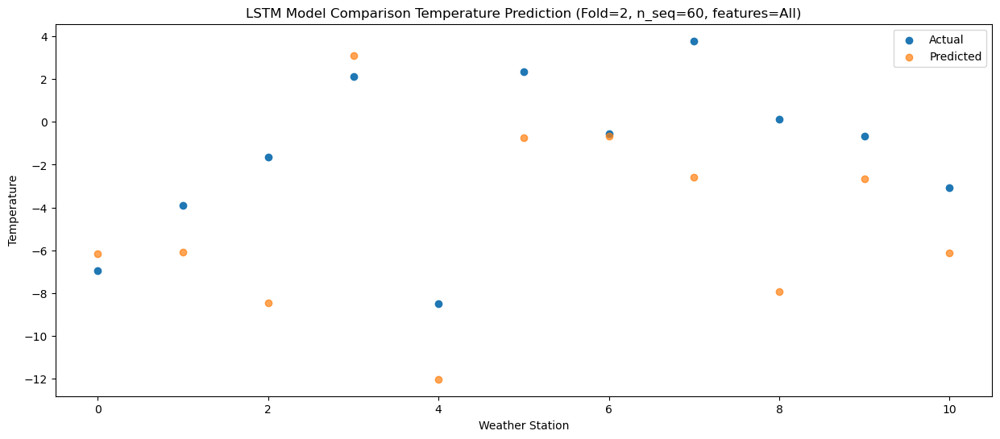

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    5.47   2.356729
1                 1    6.30   2.404760
2                 2    0.17   0.041005
3                 3    6.22  11.610675
4                 4   -1.16  -3.543796
5                 5   10.74   7.751484
6                 6    9.83   7.851172
7                 7    6.89   5.901580
8                 8   -0.28   0.542634
9                 9    6.20   5.804274
10               10    3.12   2.360455


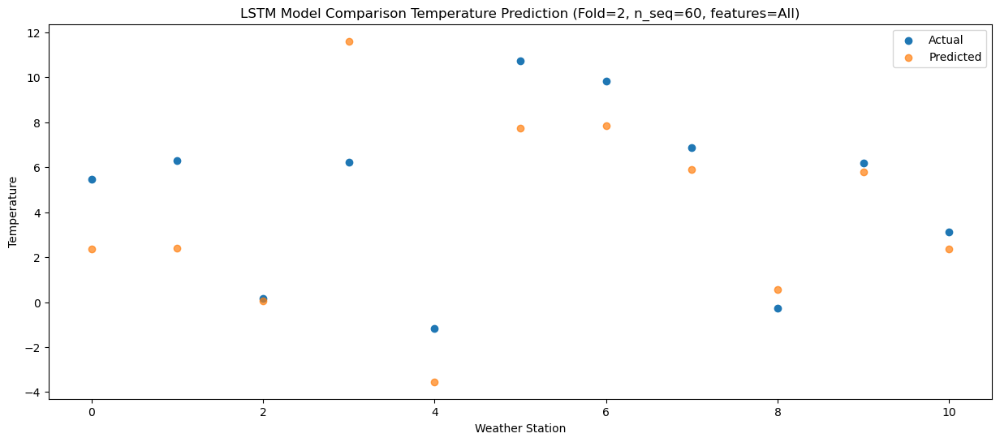

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    7.34   5.831248
1                 1   10.06   5.867459
2                 2    1.98   3.500105
3                 3   10.72  15.081737
4                 4   -0.29  -0.087486
5                 5   12.86  11.210325
6                 6   11.53  11.316100
7                 7   13.55   9.361206
8                 8    3.58   4.006200
9                 9    8.99   9.271231
10               10    5.09   5.834472


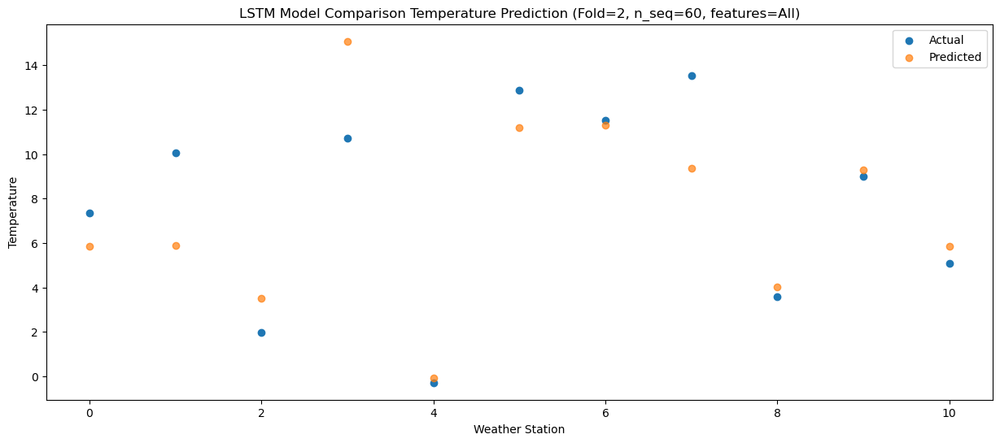

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   12.12  10.402226
1                 1   15.24  10.447538
2                 2    5.56   8.076332
3                 3   15.98  19.669651
4                 4    4.18   4.488982
5                 5   16.90  15.786188
6                 6   15.61  15.890487
7                 7   18.56  13.941514
8                 8    5.80   8.582531
9                 9   13.01  13.843476
10               10   10.00  10.414471


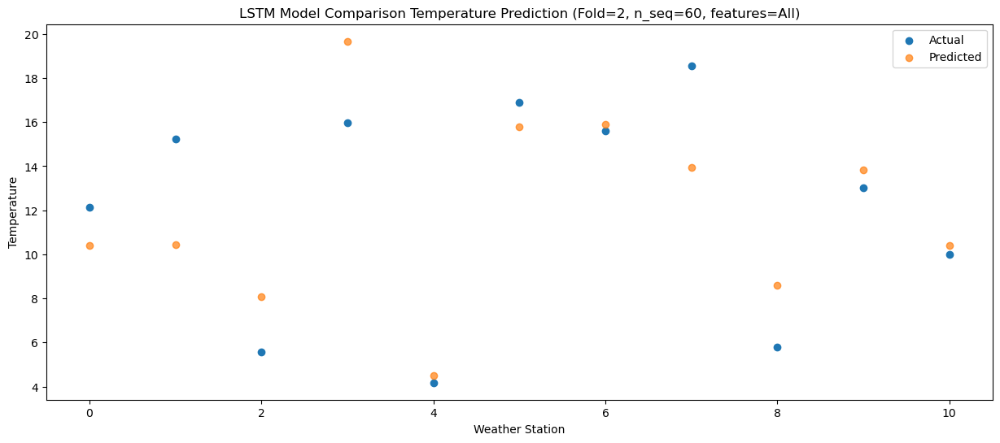

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   17.37  16.707272
1                 1   22.49  16.766215
2                 2    6.78  14.389531
3                 3   21.55  25.987029
4                 4    7.66  10.806692
5                 5   21.45  22.105675
6                 6   21.17  22.208012
7                 7   23.55  20.262833
8                 8   10.04  14.902654
9                 9   17.30  20.160143
10               10   15.41  16.734682


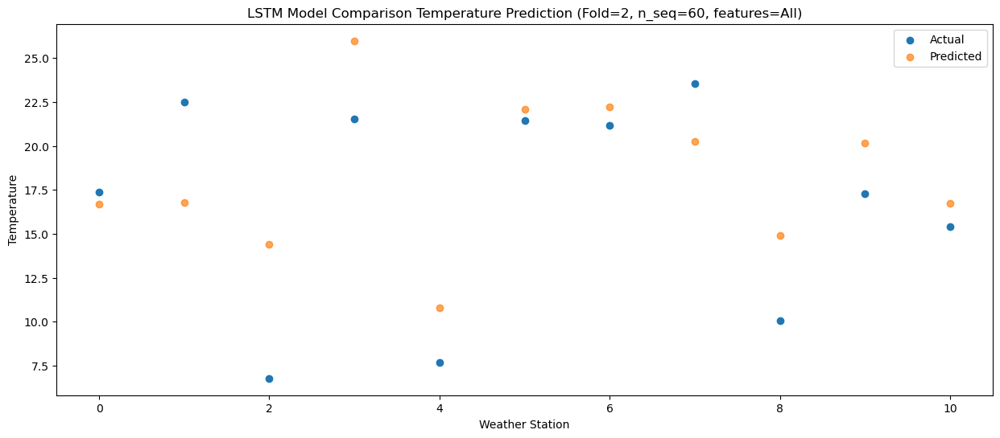

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   18.38  17.730084
1                 1   23.18  17.791988
2                 2    7.57  15.405825
3                 3   23.55  27.003417
4                 4    8.25  11.821730
5                 5   21.53  23.124206
6                 6   22.06  23.224157
7                 7   22.35  21.272286
8                 8   13.02  15.919835
9                 9   18.87  21.171367
10               10   16.72  17.751131


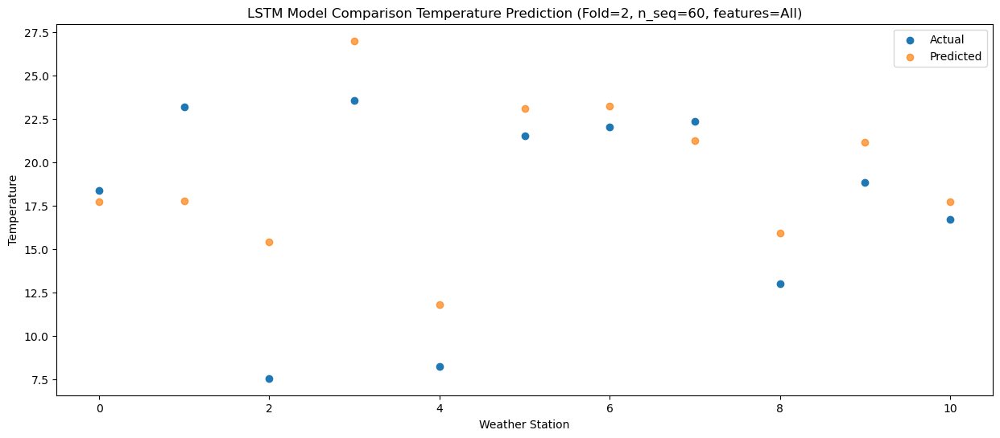

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   18.83  18.185765
1                 1   23.94  18.247833
2                 2    7.62  15.870161
3                 3   24.61  27.472087
4                 4    8.42  12.285130
5                 5   22.64  23.588172
6                 6   22.62  23.687001
7                 7   21.83  21.733021
8                 8   12.62  16.377904
9                 9   18.96  21.638126
10               10   16.80  18.219868


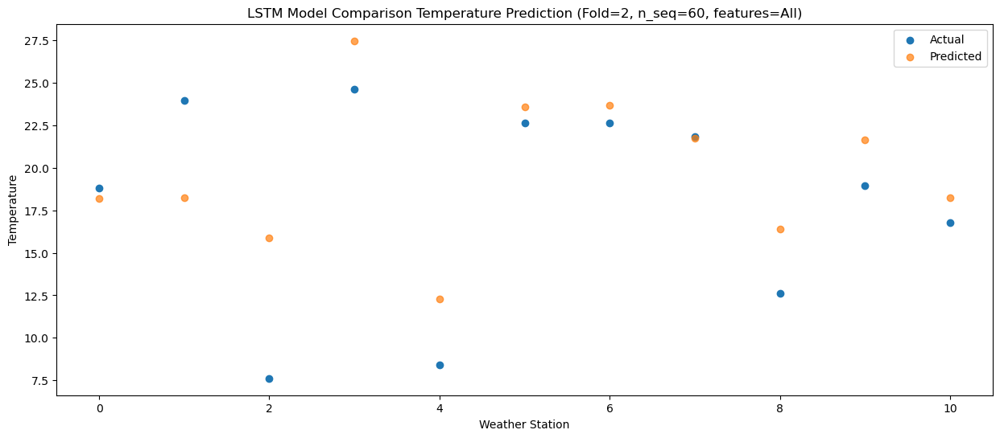

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   15.53  14.345440
1                 1   21.70  14.410699
2                 2    6.34  12.031954
3                 3   21.44  23.625963
4                 4    5.88   8.440915
5                 5   19.90  19.744182
6                 6   20.35  19.840773
7                 7   19.65  17.888777
8                 8   10.84  12.531125
9                 9   14.85  17.786016
10               10   12.31  14.374421


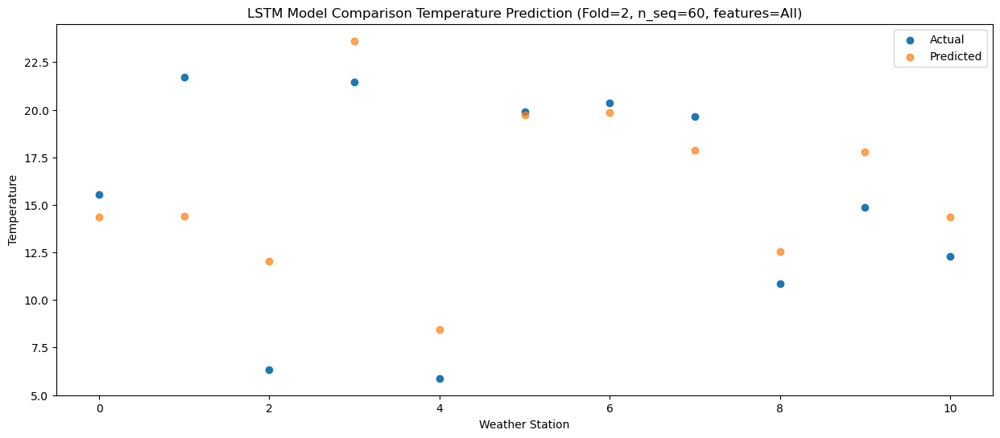

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   10.78   9.875642
1                 1   13.44   9.935246
2                 2    5.20   7.556028
3                 3   17.61  19.155368
4                 4    3.14   3.968458
5                 5   16.60  15.271350
6                 6   15.84  15.363925
7                 7   13.09  13.410188
8                 8    5.86   8.049797
9                 9   11.57  13.311562
10               10    8.55   9.904660


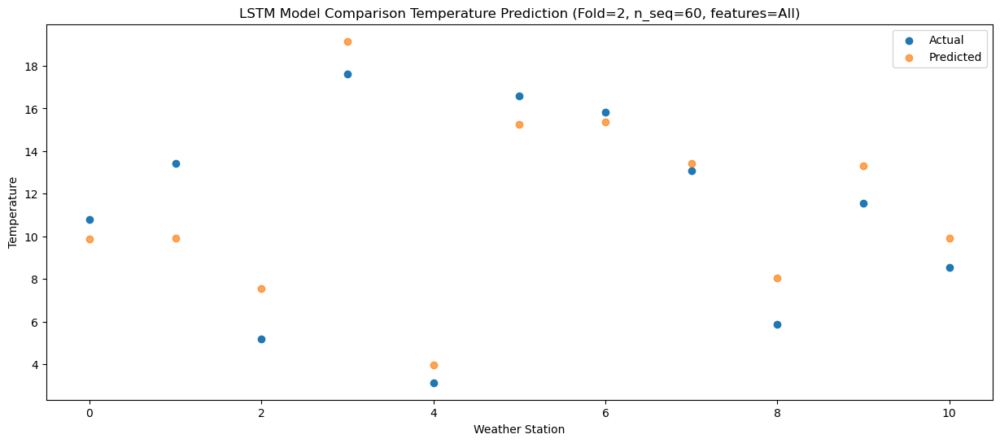

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.16   0.976036
1                 1    6.73   1.030792
2                 2   -1.65  -1.335683
3                 3    9.53  10.269060
4                 4   -5.13  -4.922390
5                 5    8.96   6.370568
6                 6    7.87   6.461842
7                 7    7.69   4.518364
8                 8    4.60  -0.843822
9                 9    2.66   4.426252
10               10   -1.67   1.017948


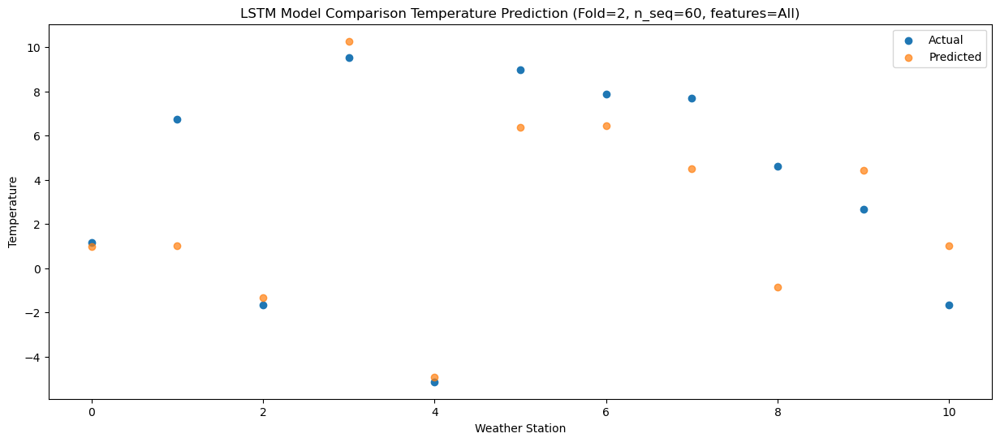

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.25   0.142061
1                 1    4.34   0.197546
2                 2   -0.75  -2.183335
3                 3    7.61   9.426338
4                 4   -1.72  -5.775592
5                 5   12.20   5.521619
6                 6   10.16   5.617337
7                 7    4.34   3.666613
8                 8   -1.91  -1.695207
9                 9    4.58   3.568645
10               10    0.43   0.161769


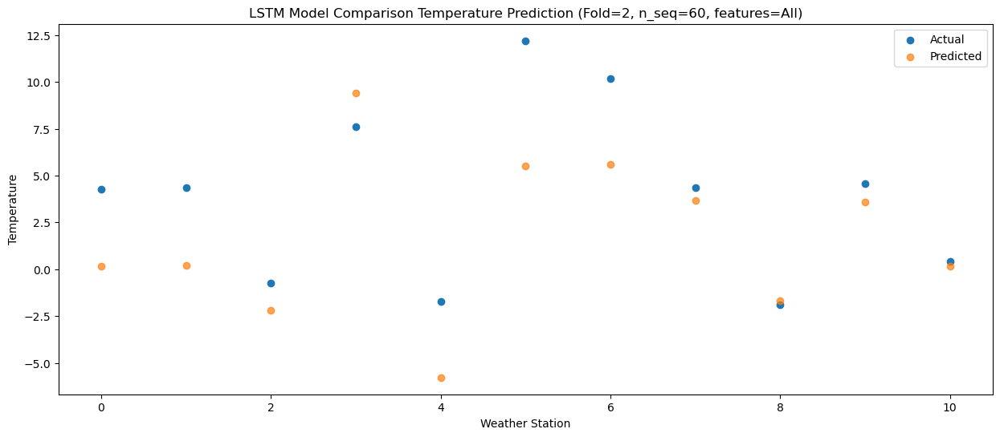

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.05  -7.216089
1                 1   -0.35  -7.164460
2                 2   -5.01  -9.551508
3                 3    1.46   2.064474
4                 4   -9.45 -13.143837
5                 5    3.77  -1.846212
6                 6    1.68  -1.747204
7                 7    1.34  -3.703125
8                 8    0.50  -9.058335
9                 9   -1.90  -3.796879
10               10   -6.44  -7.203121


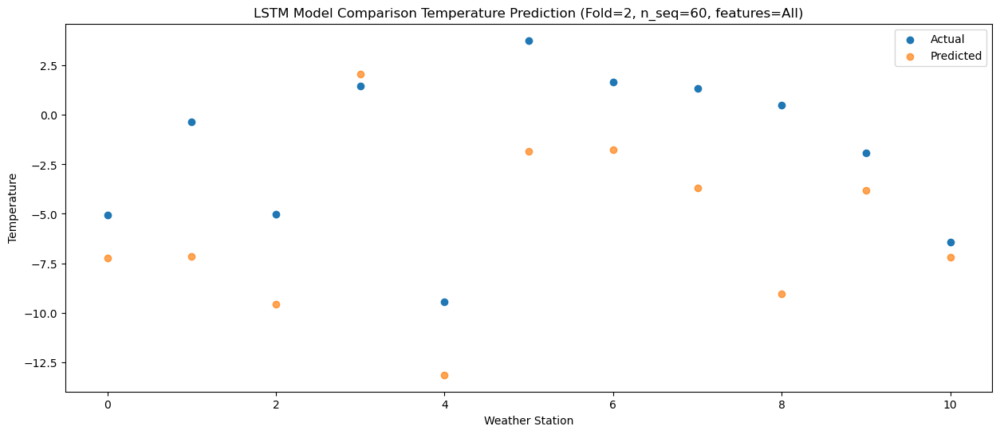

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -2.81  -4.525356
1                 1   -0.36  -4.478896
2                 2   -2.68  -6.856668
3                 3    3.78   4.758783
4                 4   -6.31 -10.452935
5                 5    3.39   0.846446
6                 6    1.51   0.946910
7                 7    2.31  -1.020096
8                 8    1.37  -6.372552
9                 9    2.12  -1.105407
10               10   -1.85  -4.507971


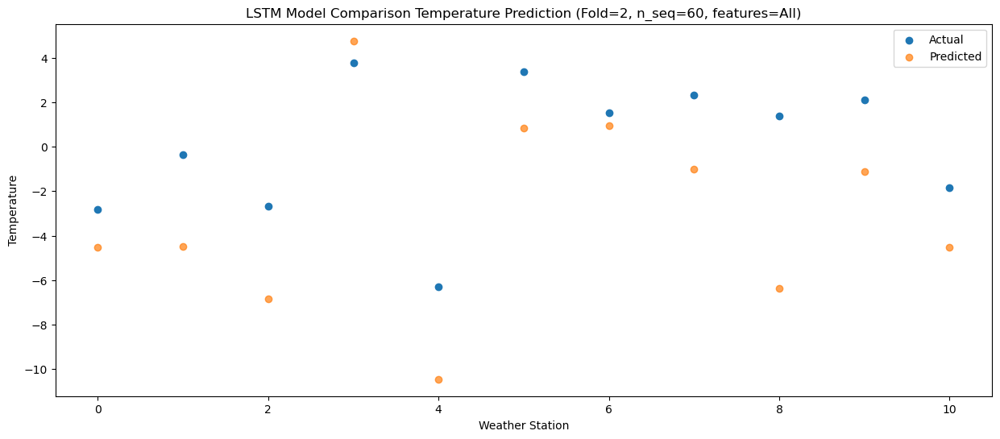

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.48   1.132054
1                 1    6.62   1.182015
2                 2    0.79  -1.201098
3                 3    7.64  10.415708
4                 4   -2.55  -4.792719
5                 5    9.51   6.501368
6                 6    8.09   6.601161
7                 7    7.37   4.632092
8                 8    3.16  -0.718728
9                 9    6.23   4.545693
10               10    2.70   1.147218


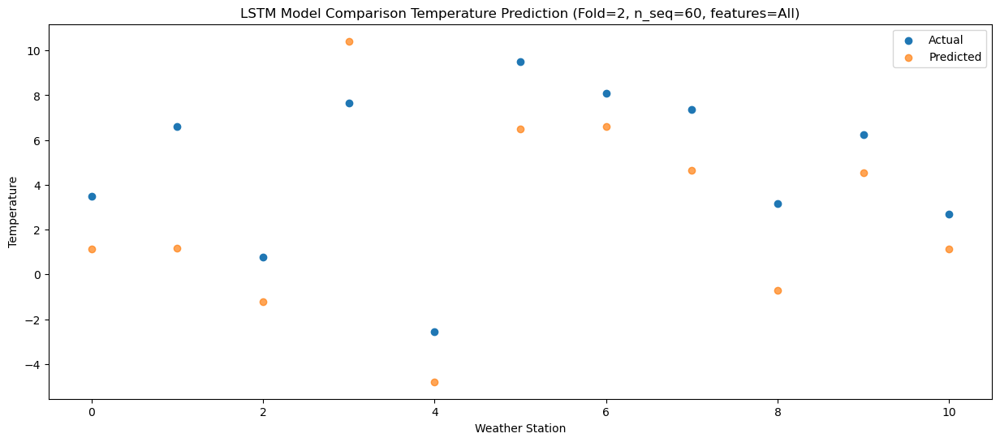

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    7.51   5.526328
1                 1   13.30   5.576122
2                 2    2.60   3.191727
3                 3   12.08  14.805227
4                 4    1.25  -0.399612
5                 5   15.66  10.898850
6                 6   14.36  10.997686
7                 7   14.56   9.030949
8                 8    5.28   3.677581
9                 9    9.52   8.945864
10               10    5.86   5.543598


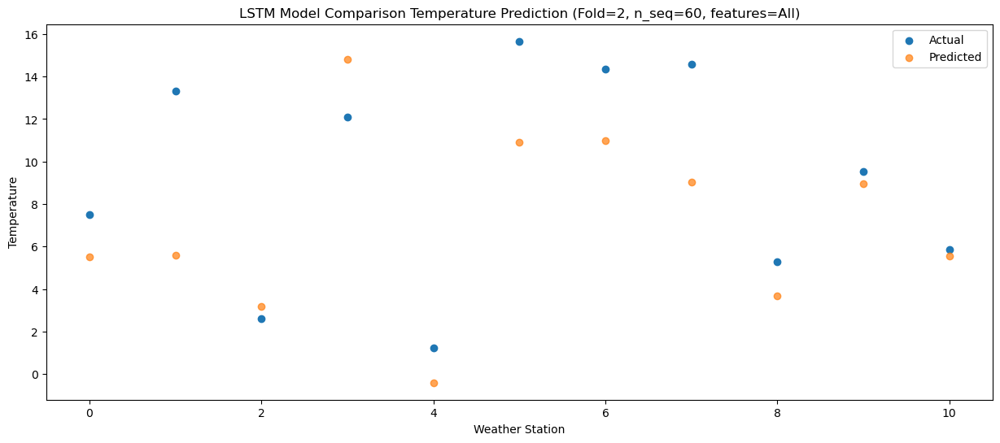

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   14.06  12.615109
1                 1   19.10  12.670659
2                 2    5.36  10.280880
3                 3   17.42  21.905707
4                 4    6.41   6.683993
5                 5   20.26  17.982622
6                 6   19.38  18.076597
7                 7   19.26  16.108801
8                 8    6.24  10.770029
9                 9   14.37  16.036403
10               10   12.10  12.636733


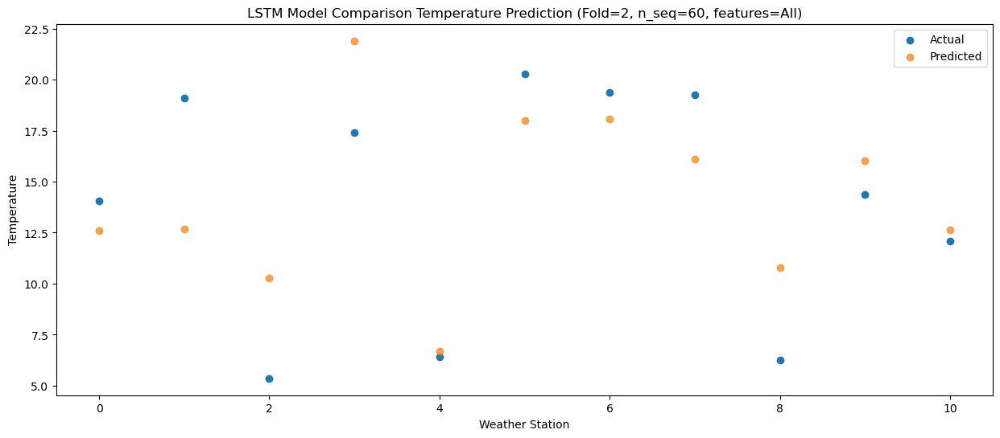

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   18.11  16.128011
1                 1   22.90  16.190173
2                 2    7.17  13.797666
3                 3   21.66  25.423501
4                 4    9.00  10.201600
5                 5   23.98  21.499427
6                 6   24.09  21.591386
7                 7   23.12  19.635913
8                 8   11.16  14.297953
9                 9   18.13  19.554479
10               10   15.75  16.160061


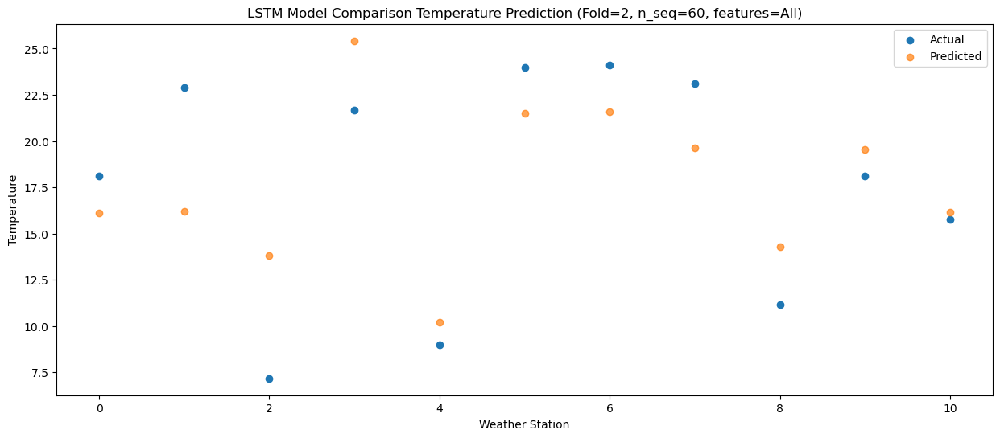

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   20.61  18.942302
1                 1   26.14  19.009338
2                 2    7.35  16.601586
3                 3   26.28  28.233703
4                 4    8.83  13.007391
5                 5   25.34  24.301768
6                 6   26.88  24.392598
7                 7   24.26  22.434570
8                 8   11.97  17.104082
9                 9   19.57  22.356514
10               10   17.10  18.958376


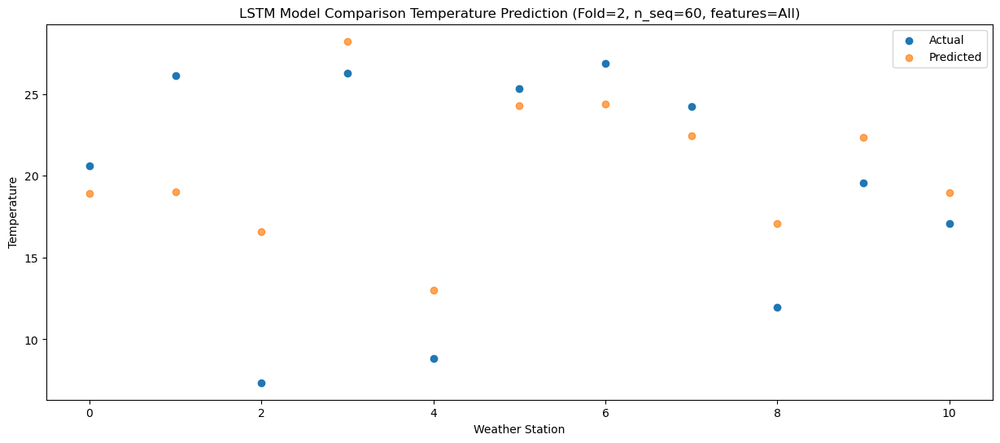

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   18.06  17.820498
1                 1   23.83  17.878244
2                 2    6.78  15.471828
3                 3   26.20  27.105933
4                 4    8.01  11.882938
5                 5   22.62  23.174633
6                 6   24.07  23.266302
7                 7   21.24  21.308885
8                 8   14.01  15.975322
9                 9   18.19  21.232218
10               10   15.85  17.838530


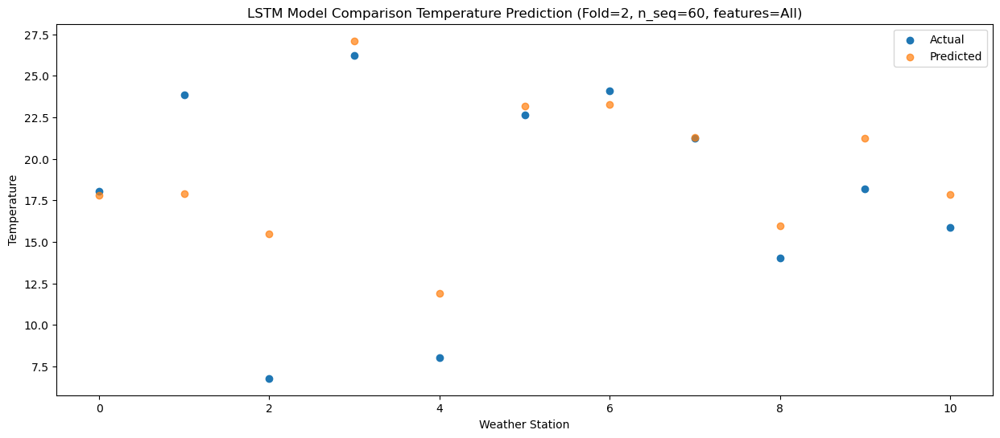

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   16.31  13.565884
1                 1   21.07  13.622541
2                 2    5.37  11.226320
3                 3   21.16  22.856094
4                 4    6.04   7.635369
5                 5   19.96  18.927197
6                 6   20.24  19.016664
7                 7   19.51  17.065831
8                 8   13.60  11.731874
9                 9   14.88  16.992537
10               10   11.70  13.599703


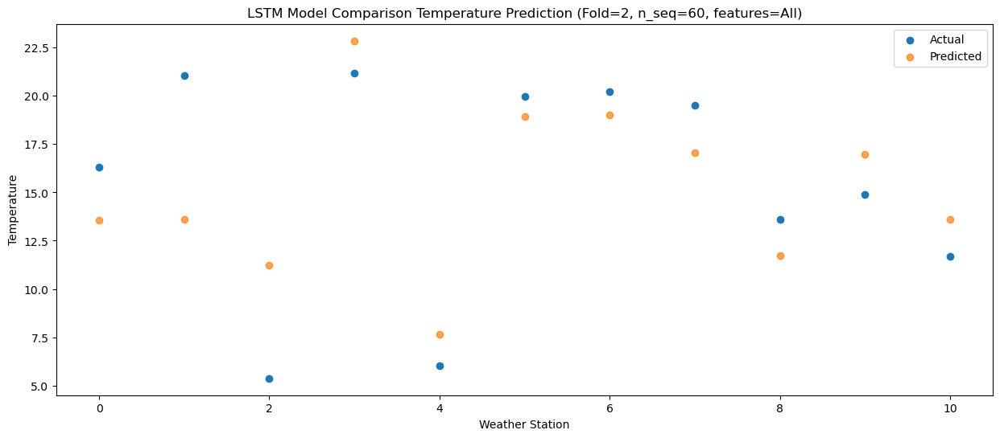

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    7.97   6.570371
1                 1   12.69   6.632150
2                 2    2.74   4.240029
3                 3   15.72  15.873275
4                 4   -0.15   0.657981
5                 5   14.39  11.942050
6                 6   13.86  12.026368
7                 7   11.30  10.080284
8                 8    7.33   4.743297
9                 9    7.57  10.009368
10               10    4.42   6.618033


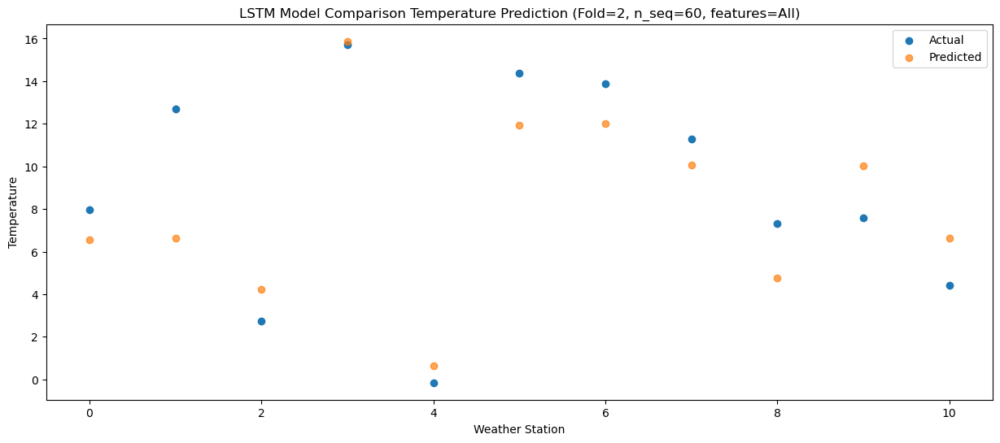

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.84   1.532539
1                 1    2.70   1.592446
2                 2    0.98  -0.793716
3                 3   11.92  10.841700
4                 4   -3.22  -4.365966
5                 5    8.51   6.915209
6                 6    7.19   6.997195
7                 7    4.41   5.038722
8                 8    1.10  -0.293463
9                 9    5.45   4.982865
10               10    1.97   1.591482


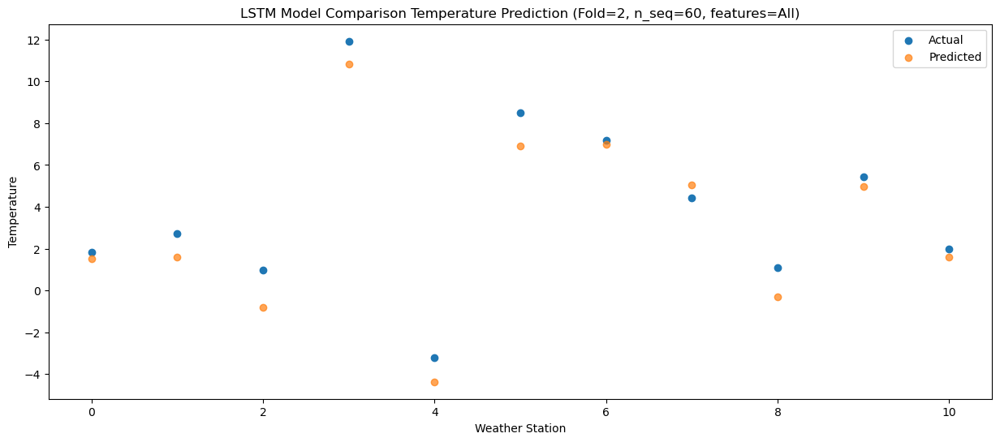

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.67  -3.629028
1                 1   -0.01  -3.572155
2                 2   -3.12  -5.946974
3                 3    5.75   5.692078
4                 4   -5.73  -9.514349
5                 5    6.28   1.761167
6                 6    4.57   1.838477
7                 7    2.24  -0.115443
8                 8   -1.60  -5.439956
9                 9   -1.08  -0.161418
10               10   -3.49  -3.548295


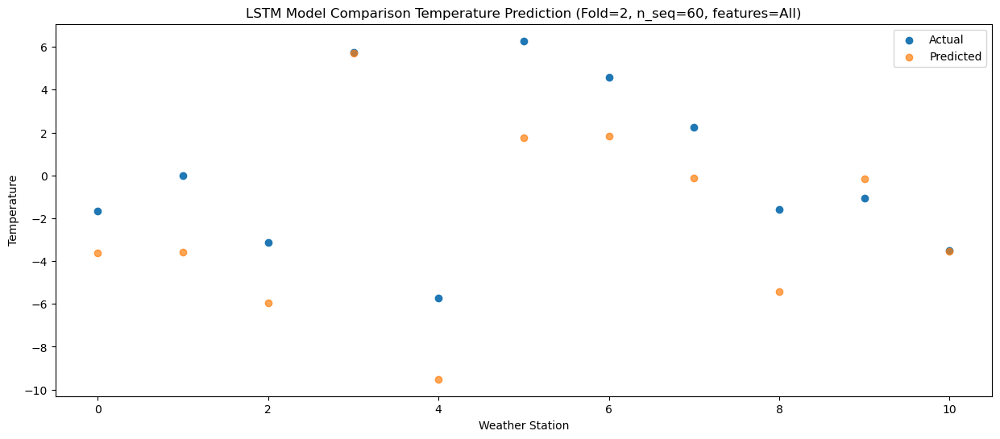

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.35  -2.192418
1                 1   -0.26  -2.138532
2                 2   -3.32  -4.515202
3                 3    7.04   7.125705
4                 4   -4.56  -8.084450
5                 5    7.04   3.192684
6                 6    5.45   3.266693
7                 7    1.53   1.305917
8                 8   -1.94  -4.016320
9                 9    2.12   1.267022
10               10   -1.57  -2.114165


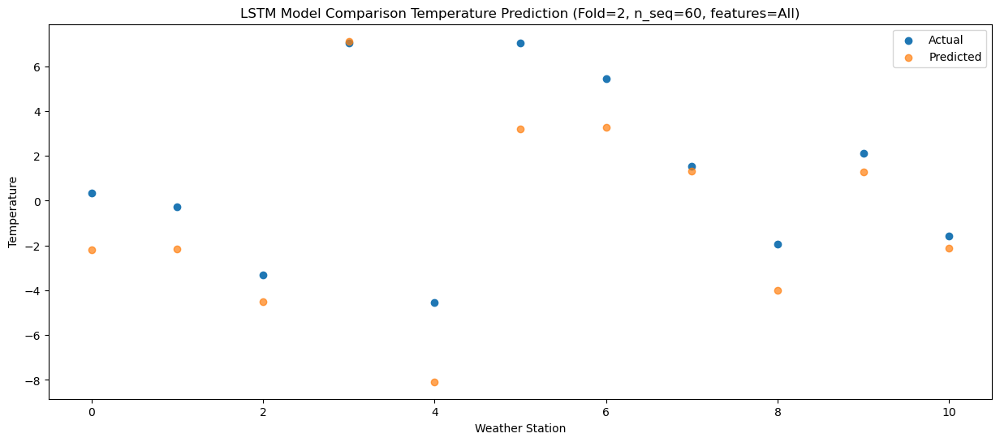

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.37  -2.230200
1                 1    1.34  -2.170706
2                 2   -0.26  -4.535764
3                 3    5.16   7.106733
4                 4   -2.43  -8.107727
5                 5    8.23   3.170764
6                 6    5.64   3.239989
7                 7    2.74   1.273943
8                 8   -2.26  -4.043171
9                 9    5.14   1.241792
10               10    1.22  -2.138781


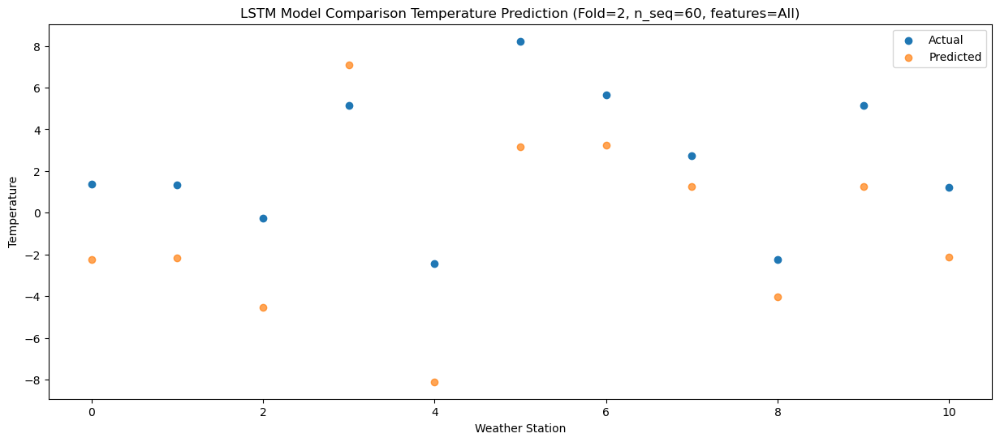

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.64   0.340390
1                 1    5.41   0.404374
2                 2    0.76  -1.967876
3                 3    7.60   9.674338
4                 4   -0.60  -5.545296
5                 5   12.03   5.742243
6                 6   10.29   5.816611
7                 7    7.44   3.846283
8                 8   -1.25  -1.464799
9                 9    5.59   3.808969
10               10    1.75   0.430149


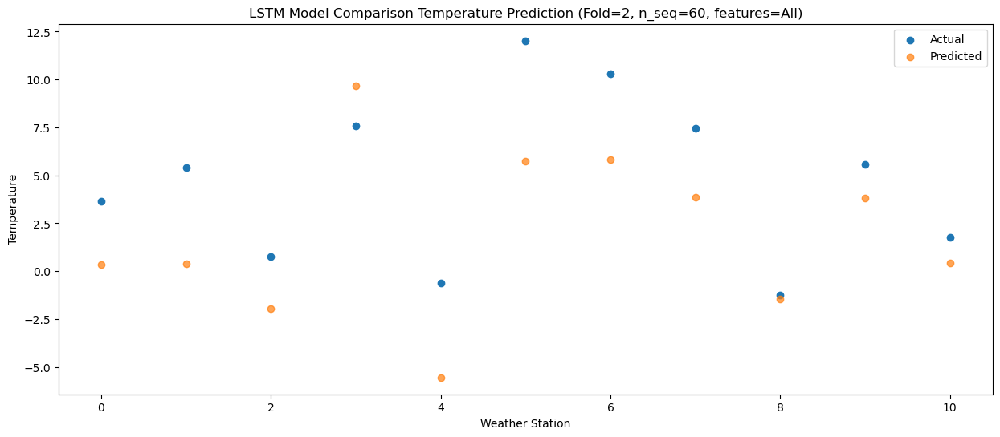

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.79   6.243731
1                 1   11.27   6.310517
2                 2    3.30   3.933442
3                 3   13.32  15.580048
4                 4    1.32   0.357083
5                 5   12.95  11.637123
6                 6   12.11  11.712268
7                 7   13.08   9.753398
8                 8    2.59   4.435406
9                 9    9.11   9.710170
10               10    6.64   6.331577


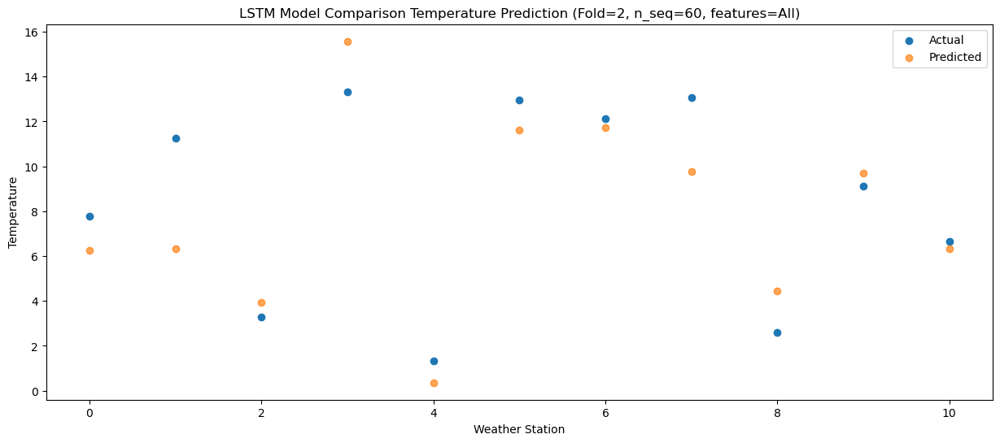

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   13.84  10.685443
1                 1   16.76  10.758239
2                 2    4.28   8.369934
3                 3   16.95  20.016840
4                 4    5.35   4.797647
5                 5   18.03  16.083247
6                 6   17.85  16.157054
7                 7   17.73  14.195137
8                 8    3.80   8.874812
9                 9   11.89  14.142948
10               10    9.99  10.770083


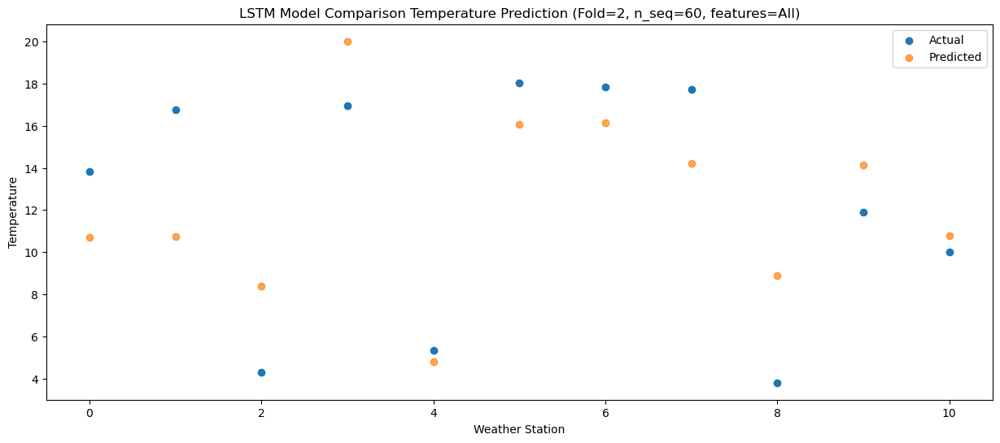

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   16.47  15.056302
1                 1   19.37  15.142121
2                 2    6.69  12.739102
3                 3   20.74  24.392705
4                 4    9.00   9.170731
5                 5   22.95  20.452919
6                 6   22.00  20.524148
7                 7   22.39  18.562272
8                 8    5.76  13.237057
9                 9   15.55  18.501294
10               10   12.90  15.130423


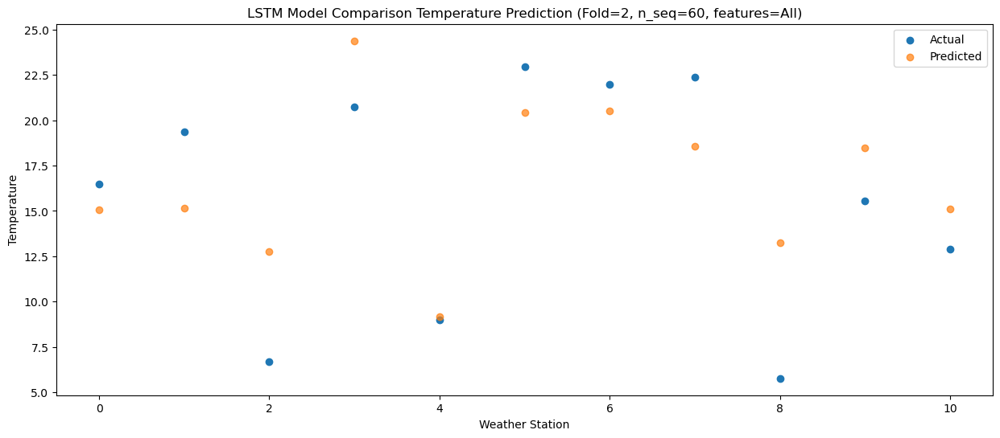

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   18.22  18.259926
1                 1   23.47  18.352875
2                 2    8.60  15.952239
3                 3   26.31  27.601479
4                 4   10.44  12.372968
5                 5   25.11  23.666658
6                 6   24.56  23.741158
7                 7   27.14  21.771188
8                 8   12.68  16.454079
9                 9   19.14  21.702677
10               10   16.45  18.332889


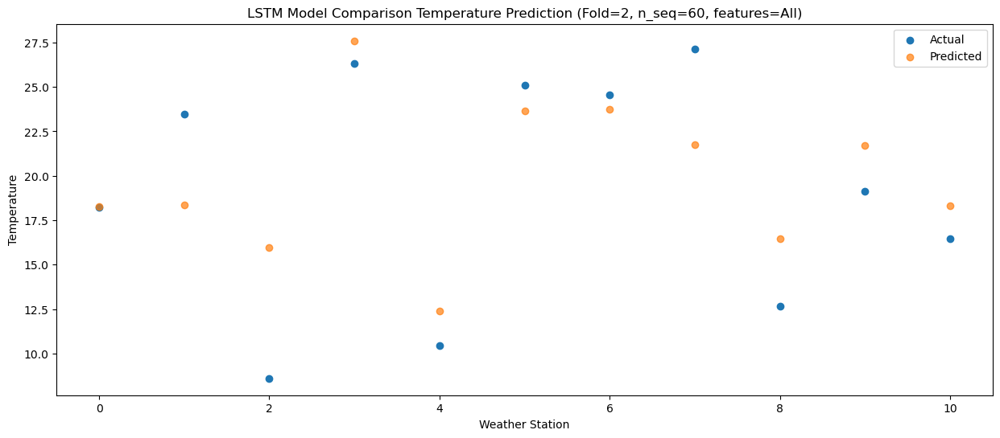

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   17.73  17.522849
1                 1   23.96  17.611413
2                 2    8.78  15.197354
3                 3   24.30  26.846026
4                 4   11.74  11.614727
5                 5   26.81  22.916097
6                 6   26.90  22.998406
7                 7   24.14  21.024342
8                 8   12.31  15.707665
9                 9   18.59  20.950246
10               10   15.74  17.588413


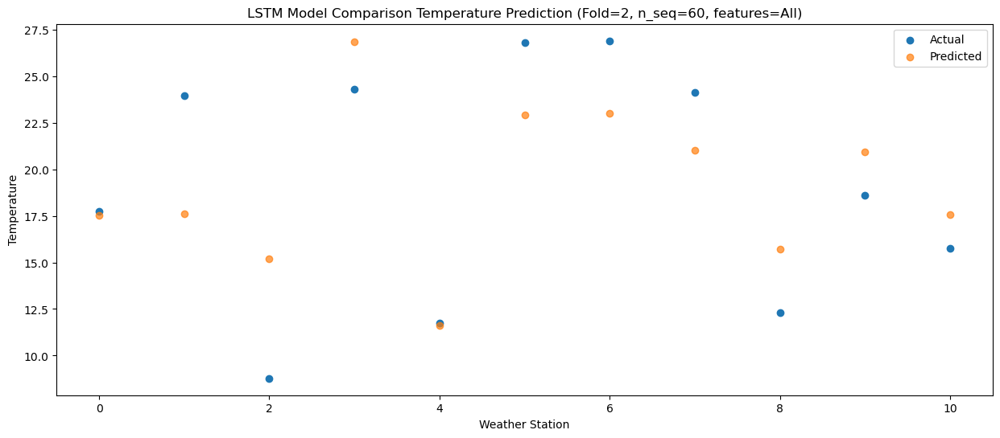

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   14.44  14.177467
1                 1   21.09  14.260817
2                 2    6.83  11.840711
3                 3   21.88  23.493948
4                 4    7.31   8.254721
5                 5   22.33  19.560907
6                 6   22.12  19.644790
7                 7   21.48  17.649063
8                 8    8.81  12.337228
9                 9   14.63  17.585155
10               10   12.96  14.228980


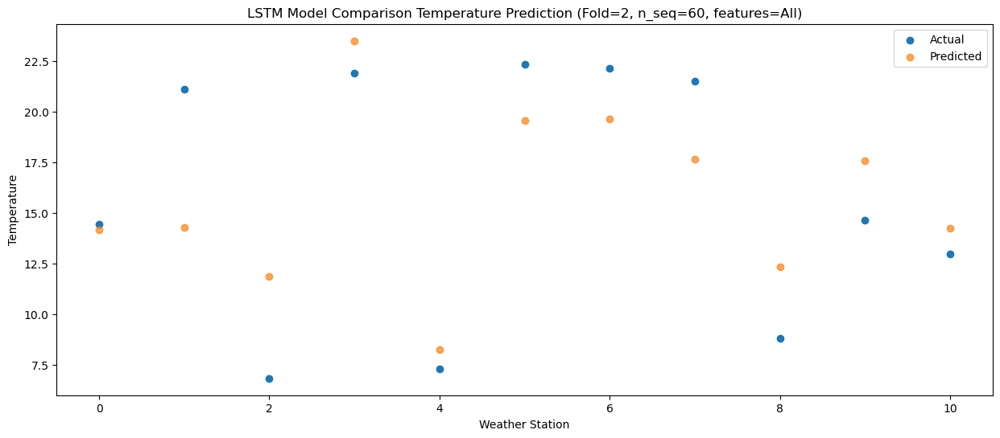

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    9.28   7.820422
1                 1   12.05   7.901755
2                 2    3.25   5.480193
3                 3   16.86  17.135333
4                 4    1.15   1.888842
5                 5   14.44  13.200837
6                 6   13.40  13.285422
7                 7   14.74  11.288782
8                 8    7.22   5.978840
9                 9    9.34  11.223339
10               10    6.91   7.869167


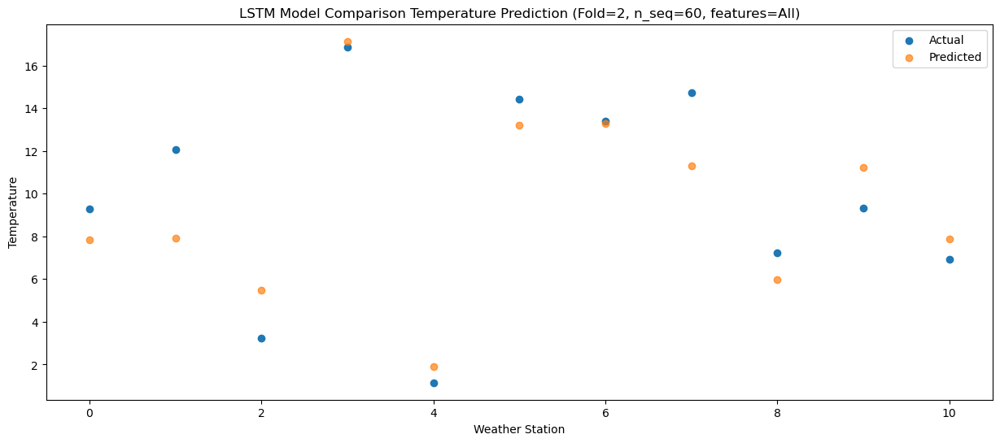

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    2.17   0.550803
1                 1    5.33   0.633753
2                 2   -0.73  -1.795453
3                 3    8.88   9.862519
4                 4   -3.96  -5.379886
5                 5    8.16   5.931109
6                 6    8.06   6.015012
7                 7    7.63   4.013472
8                 8    2.83  -1.295457
9                 9    3.44   3.947607
10               10    0.70   0.589945


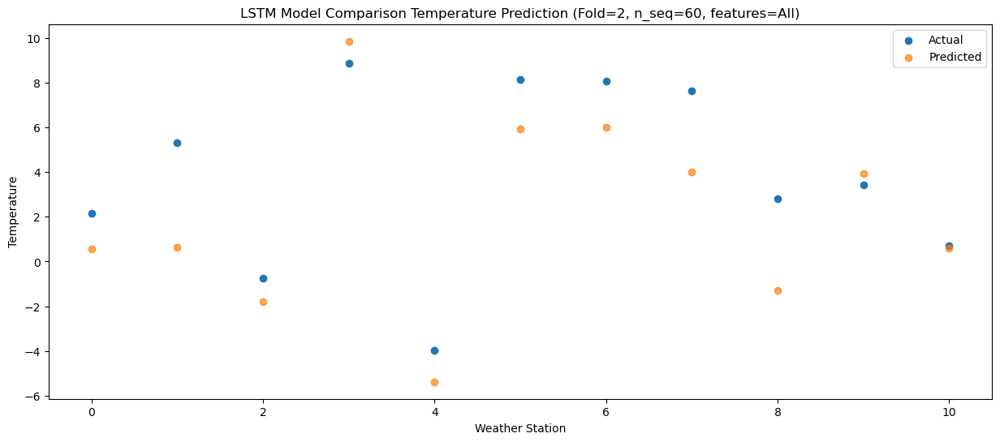

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.89  -1.305322
1                 1    1.66  -1.228538
2                 2   -2.66  -3.659656
3                 3    8.14   7.996575
4                 4   -6.56  -7.246880
5                 5    6.05   4.057080
6                 6    5.08   4.145313
7                 7    2.59   2.146036
8                 8    0.50  -3.160797
9                 9    0.97   2.080295
10               10   -2.15  -1.277871


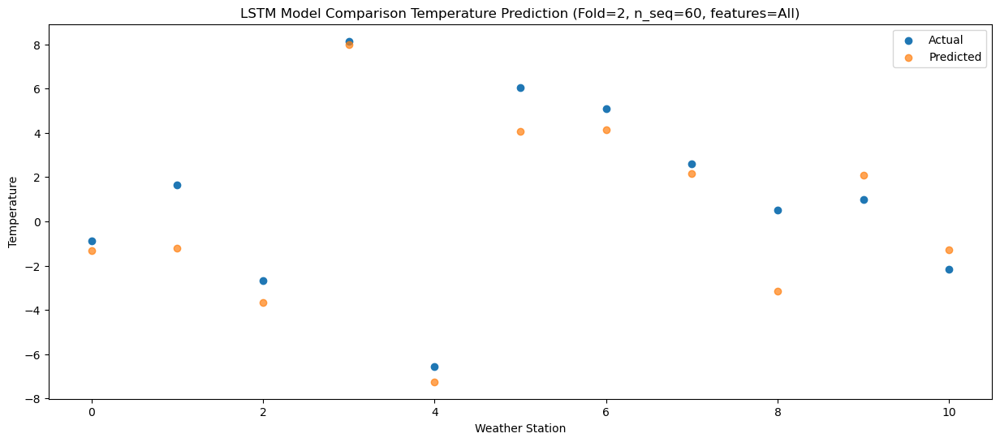

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -6.68  -5.838365
1                 1   -3.43  -5.762914
2                 2   -4.66  -8.184129
3                 3    3.97   3.475559
4                 4   -8.64 -11.761834
5                 5    1.90  -0.463367
6                 6   -0.10  -0.379775
7                 7    2.26  -2.376770
8                 8   -1.30  -7.690583
9                 9   -0.88  -2.442431
10               10   -5.47  -5.796176


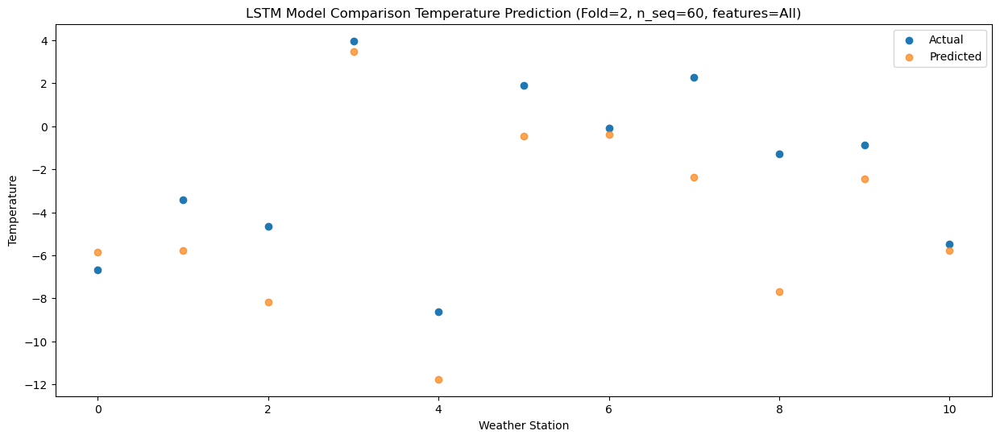

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.64  -1.656396
1                 1    4.05  -1.575027
2                 2   -4.18  -4.004506
3                 3    4.65   7.644150
4                 4   -4.48  -7.586085
5                 5    8.66   3.718192
6                 6    8.16   3.807153
7                 7    5.47   1.800602
8                 8   -0.77  -3.517471
9                 9    2.34   1.731115
10               10   -0.93  -1.622870


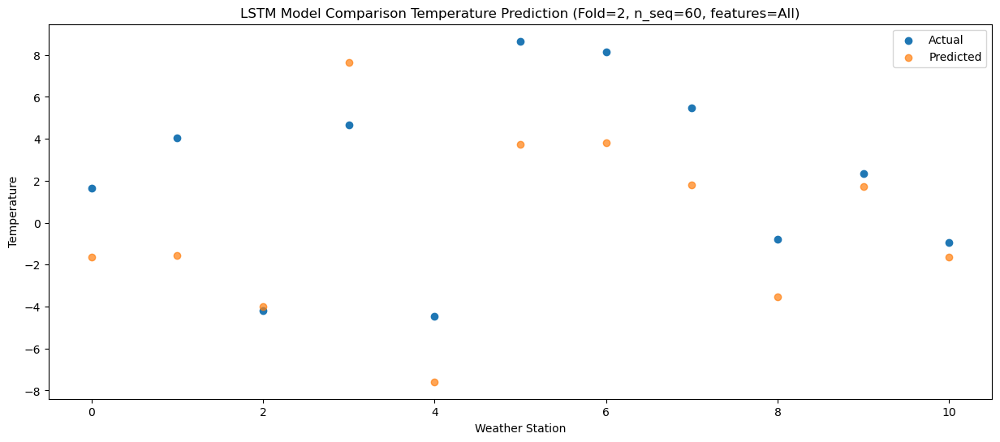

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    4.53   1.683050
1                 1    6.82   1.763772
2                 2    0.24  -0.671217
3                 3    9.05  10.976999
4                 4   -1.81  -4.248243
5                 5   11.03   7.057544
6                 6   10.51   7.146015
7                 7    8.04   5.129021
8                 8    0.17  -0.189237
9                 9    5.90   5.060962
10               10    3.24   1.712252


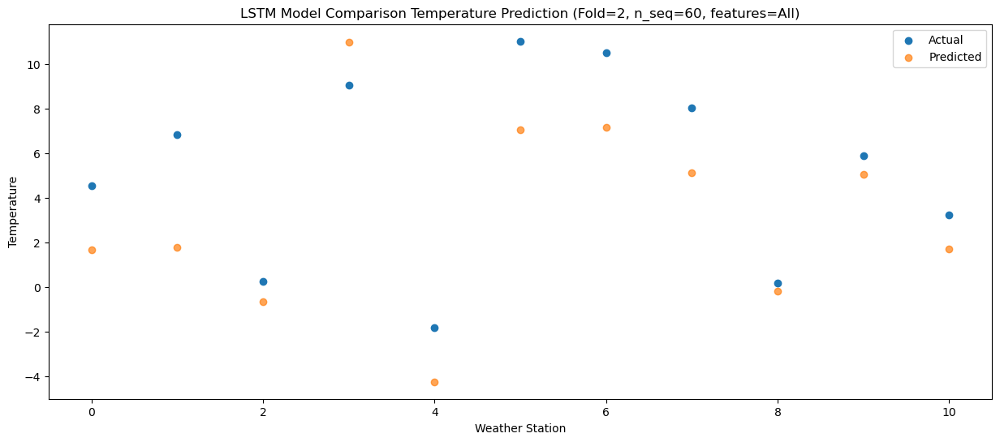

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    9.29   5.908780
1                 1   12.23   5.994894
2                 2    1.63   3.561828
3                 3   11.48  15.214192
4                 4    1.85  -0.015334
5                 5   14.77  11.294335
6                 6   13.96  11.379968
7                 7   12.45   9.363512
8                 8    2.28   4.048761
9                 9    9.96   9.294886
10               10    7.22   5.946029


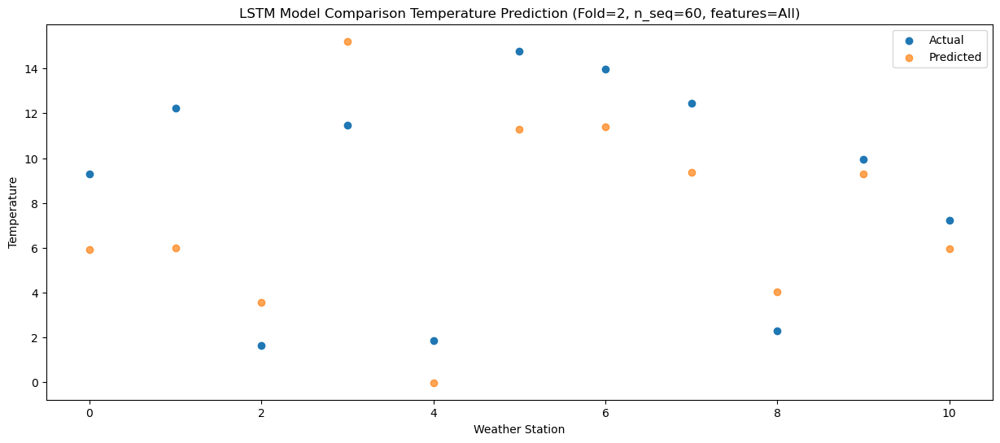

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   14.22  11.713060
1                 1   16.84  11.801890
2                 2    6.48   9.368132
3                 3   17.27  21.021451
4                 4    6.90   5.785848
5                 5   18.47  17.094626
6                 6   18.85  17.179288
7                 7   18.27  15.168103
8                 8    4.08   9.850306
9                 9   14.34  15.096084
10               10   11.68  11.746220


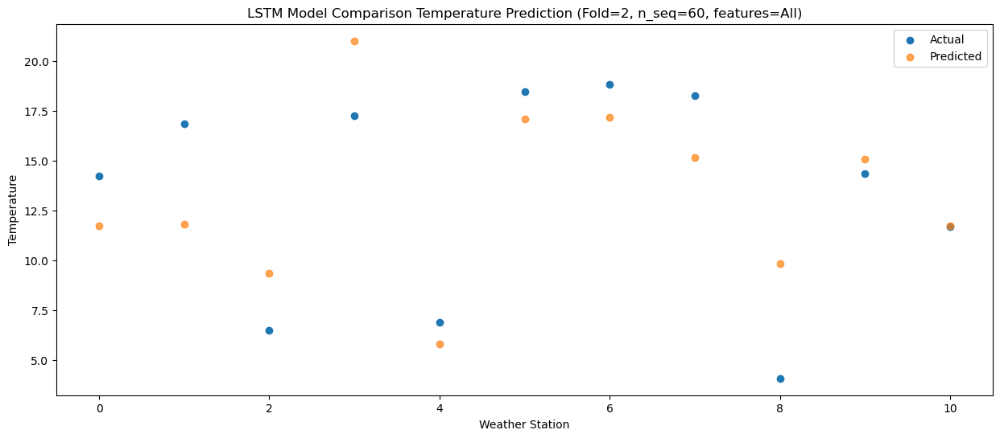

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.30  16.277585
1                 1   23.01  16.379442
2                 2    7.39  13.949706
3                 3   23.24  25.597412
4                 4    8.73  10.366000
5                 5   21.70  21.668734
6                 6   22.35  21.748561
7                 7   24.69  19.743151
8                 8    8.76  14.432006
9                 9   18.22  19.664464
10               10   16.03  16.316796


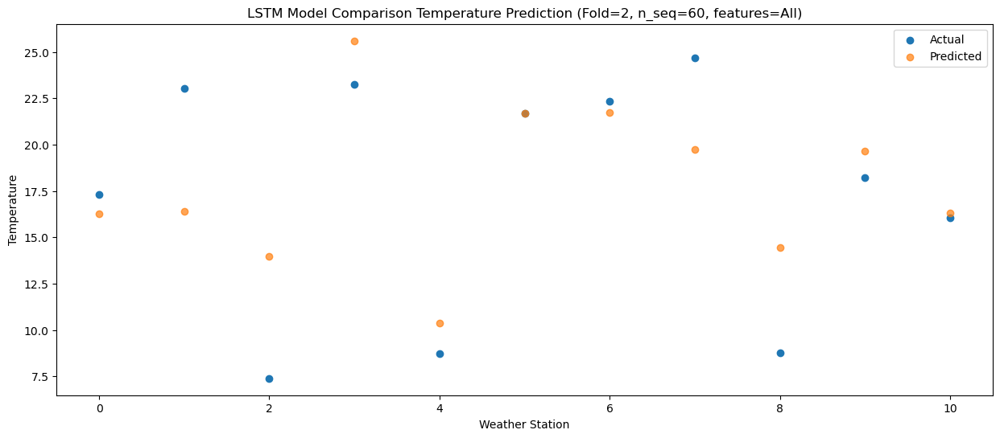

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   17.79  17.936862
1                 1   23.56  18.034136
2                 2    8.23  15.601211
3                 3   26.02  27.256426
4                 4    9.34  12.018254
5                 5   20.18  23.320847
6                 6   22.66  23.400764
7                 7   24.16  21.404395
8                 8   12.49  16.089911
9                 9   19.61  21.323778
10               10   17.26  17.974752


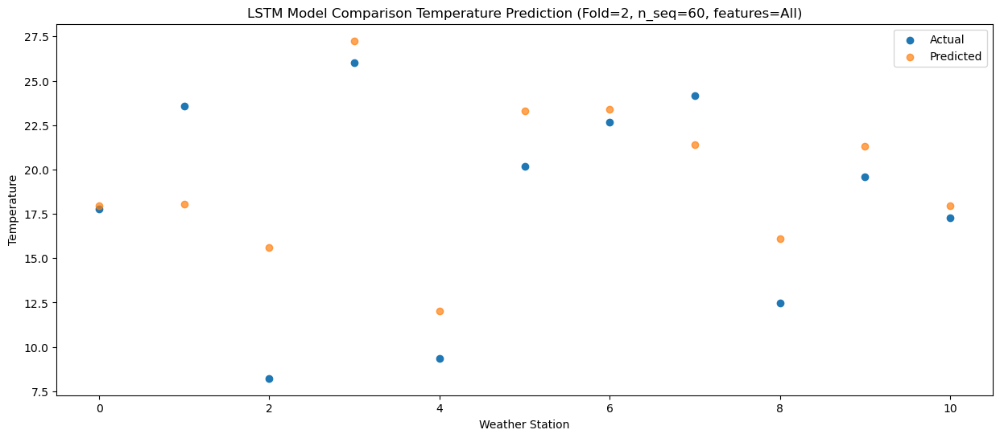

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   18.02  16.845537
1                 1   23.61  16.942449
2                 2    8.19  14.513888
3                 3   24.31  26.174408
4                 4    9.69  10.931830
5                 5   21.83  22.239035
6                 6   24.46  22.317642
7                 7   24.55  20.326528
8                 8   12.07  15.022207
9                 9   17.59  20.250118
10               10   15.64  16.897508


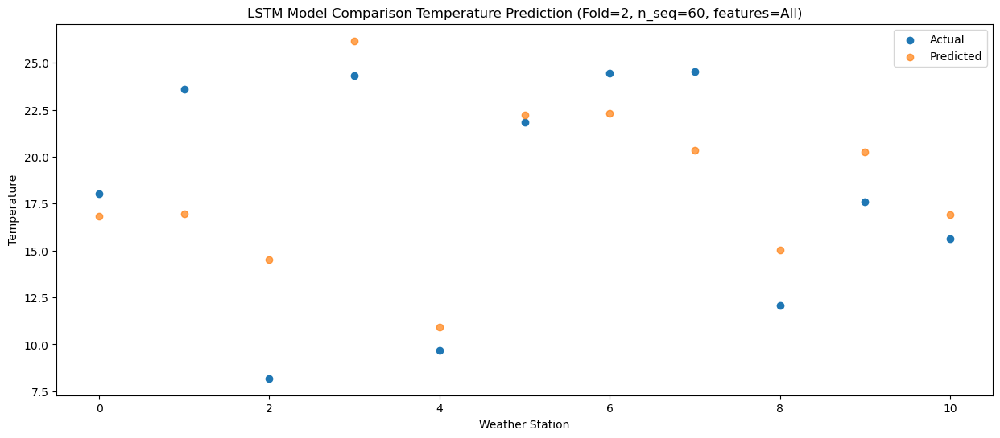

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.04  13.363829
1                 1   19.88  13.460622
2                 2    7.87  11.029033
3                 3   20.79  22.686284
4                 4    6.89   7.442681
5                 5   19.10  18.753805
6                 6   20.23  18.837475
7                 7   20.52  16.840795
8                 8   10.22  11.534631
9                 9   14.63  16.757583
10               10   13.05  13.406975


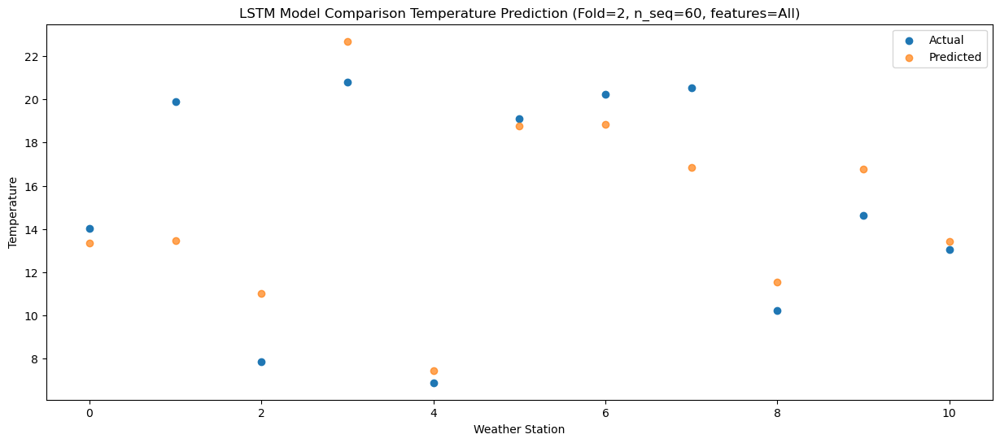

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    9.77   8.113471
1                 1   14.91   8.212237
2                 2    4.40   5.784559
3                 3   15.53  17.453388
4                 4    2.20   2.200832
5                 5   16.45  13.512526
6                 6   17.26  13.590210
7                 7   16.26  11.591490
8                 8    7.23   6.294068
9                 9    9.41  11.523628
10               10    6.63   8.171379


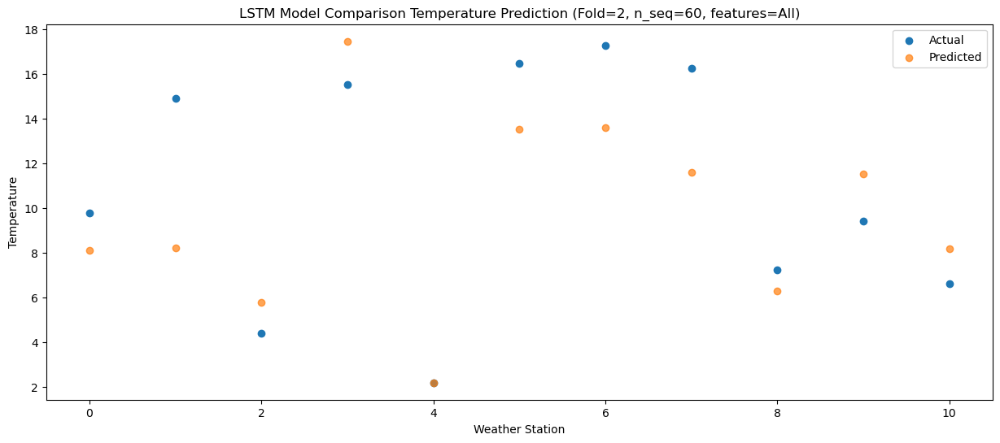

f, t:
[[-6.500e-01  3.410e+00 -1.000e-01  9.240e+00 -6.250e+00  7.270e+00
   6.650e+00  6.030e+00  2.170e+00  2.040e+00 -1.920e+00]
 [-3.100e-01  1.130e+00 -1.220e+00  6.180e+00 -5.900e+00  5.840e+00
   4.840e+00  1.500e+00 -1.370e+00  1.630e+00 -1.320e+00]
 [-9.000e-01  8.900e-01 -2.370e+00  6.450e+00 -5.560e+00  6.210e+00
   5.190e+00  2.750e+00 -8.300e-01  1.340e+00 -1.760e+00]
 [-1.090e+00  1.600e-01 -1.330e+00  6.600e+00 -4.920e+00  5.450e+00
   4.630e+00  3.560e+00  1.280e+00  2.380e+00 -1.960e+00]
 [ 5.500e+00  8.170e+00  2.290e+00  1.015e+01  1.770e+00  1.354e+01
   1.228e+01  8.060e+00  1.350e+00  7.610e+00  4.080e+00]
 [ 6.980e+00  1.040e+01  3.680e+00  1.138e+01  1.240e+00  1.351e+01
   1.259e+01  1.304e+01  4.560e+00  8.910e+00  4.510e+00]
 [ 1.227e+01  1.720e+01  4.990e+00  1.727e+01  4.210e+00  1.735e+01
   1.749e+01  1.933e+01  8.610e+00  1.151e+01  8.550e+00]
 [ 1.727e+01  2.440e+01  7.580e+00  2.333e+01  7.250e+00  2.096e+01
   2.223e+01  2.285e+01  9.900e+00  1.680e+0

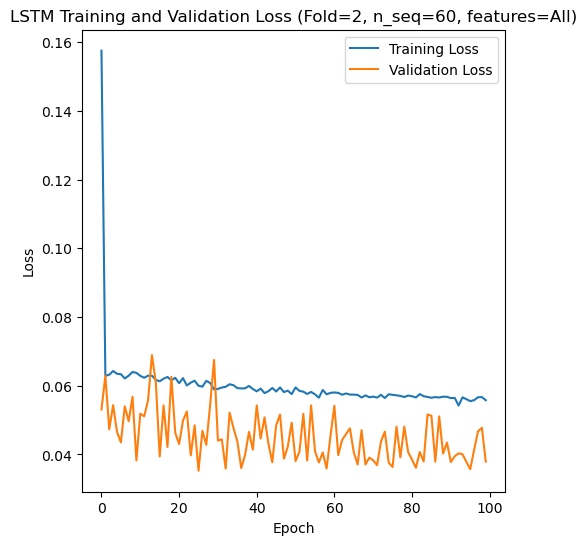

[[ 8.9   6.89 11.3  ... 22.19 16.88 13.54]
 [ 7.02  3.15 10.24 ... 22.31 18.92 11.32]
 [ 7.65  9.7   9.44 ... 25.68 20.65 11.46]
 ...
 [ 9.57 11.93 12.22 ... 30.9  25.01 12.37]
 [ 9.04  9.3   8.59 ... 17.72 17.26 10.73]
 [ 3.2   0.4   3.78 ... 18.92 14.39 10.04]]
Epoch 1/100
84/84 [==============================] - 50s 281ms/step - loss: 0.1742 - accuracy: 0.3929 - mae: 0.1414 - rmse: 0.1742 - mape: 30.7506 - pearson: 0.6506 - val_loss: 0.0788 - val_accuracy: 0.1000 - val_mae: 0.0613 - val_rmse: 0.0788 - val_mape: 13.8317 - val_pearson: 0.7474
Epoch 2/100
84/84 [==============================] - 18s 210ms/step - loss: 0.0628 - accuracy: 0.5119 - mae: 0.0498 - rmse: 0.0628 - mape: 11.8424 - pearson: 0.8402 - val_loss: 0.0707 - val_accuracy: 0.5000 - val_mae: 0.0553 - val_rmse: 0.0707 - val_mape: 12.2974 - val_pearson: 0.7849
Epoch 3/100
84/84 [==============================] - 16s 190ms/step - loss: 0.0625 - accuracy: 0.4881 - mae: 0.0495 - rmse: 0.0625 - mape: 11.6012 - pearson: 0.8442

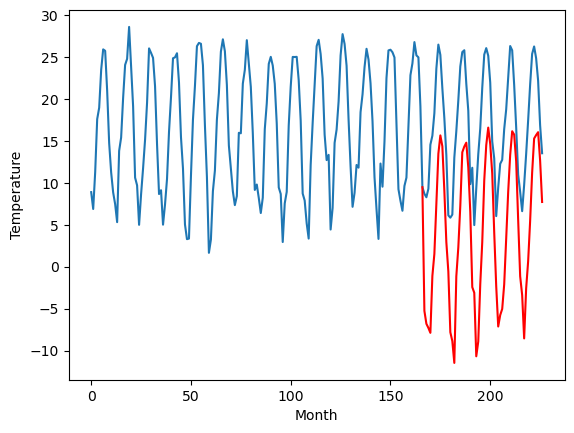

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.22		0.44		-1.78
0.87		-1.10		-1.97
0.03		-1.59		-1.62
0.18		-2.18		-2.36
7.67		4.61		-3.06
8.59		7.23		-1.36
12.99		13.21		0.22
20.09		19.19		-0.90
21.95		21.38		-0.57
20.09		20.10		0.01
16.42		14.80		-1.62
9.31		8.66		-0.65
6.49		5.15		-1.34
-0.06		-2.10		-2.04
-1.21		-3.15		-1.94
-4.93		-5.76		-0.83
7.04		4.58		-2.46
8.90		8.03		-0.87
13.12		13.01		-0.11
19.83		19.39		-0.44
21.14		20.07		-1.07
21.71		20.54		-1.17
18.98		17.59		-1.39
12.38		12.29		-0.09
4.67		3.31		-1.36
5.98		2.62		-3.36
-2.85		-4.96		-2.11
-1.63		-3.19		-1.56
5.15		3.65		-1.50
10.00		8.69		-1.31
15.43		16.05		0.62
20.58		20.27		-0.31
24.62		22.36		-2.26
21.54		20.39		-1.15
17.68		16.90		-0.78
11.13		9.84		-1.29
3.90		3.44		-0.46
-0.15		-1.36		-1.21
0.55		0.01		-0.54
2.51		0.73		-1.78
5.11		3.67		-1.44
10.16		9.13		-1.03
15.47		14.70		-0.77
19.80		19.11		-0.69
22.06		21.93		-0.13
22.24		21.53		-0.71
18.19		18.34		0.15
11.

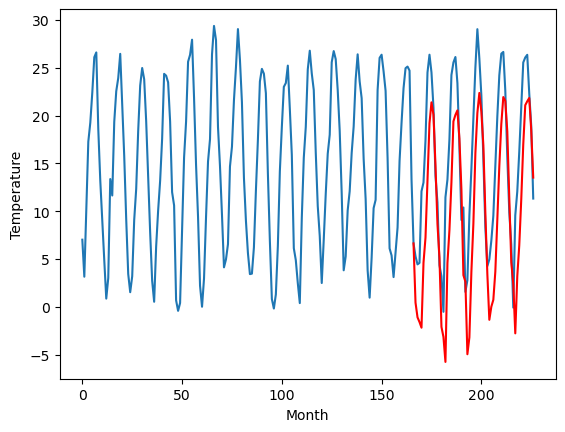

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.71		-1.43		-4.14
0.18		-2.97		-3.15
-1.04		-3.46		-2.42
1.38		-4.04		-5.42
3.17		2.74		-0.43
7.83		5.37		-2.46
13.02		11.36		-1.66
16.37		17.34		0.97
19.15		19.53		0.38
19.68		18.24		-1.44
15.35		12.94		-2.41
9.86		6.81		-3.05
1.21		3.29		2.08
-1.99		-3.95		-1.96
-0.73		-5.00		-4.27
1.57		-7.60		-9.17
2.72		2.73		0.01
8.45		6.18		-2.27
13.25		11.16		-2.09
18.10		17.53		-0.57
21.23		18.21		-3.02
19.03		18.68		-0.35
15.72		15.72		0.00
7.06		10.43		3.37
2.72		1.44		-1.28
-1.20		0.76		1.96
-1.53		-6.83		-5.30
0.17		-5.07		-5.24
4.88		1.78		-3.10
7.95		6.81		-1.14
12.19		14.17		1.98
17.58		18.38		0.80
20.15		20.49		0.34
20.33		18.52		-1.81
17.51		15.02		-2.49
10.33		7.96		-2.37
-0.40		1.55		1.95
-1.36		-3.23		-1.87
0.03		-1.86		-1.89
-0.82		-1.13		-0.31
2.05		1.81		-0.24
7.68		7.28		-0.40
12.12		12.84		0.72
14.92		17.25		2.33
20.58		20.08		-0.50
18.89		19.68		0.79
15.12		16.48		1.36
9.81		9.49		

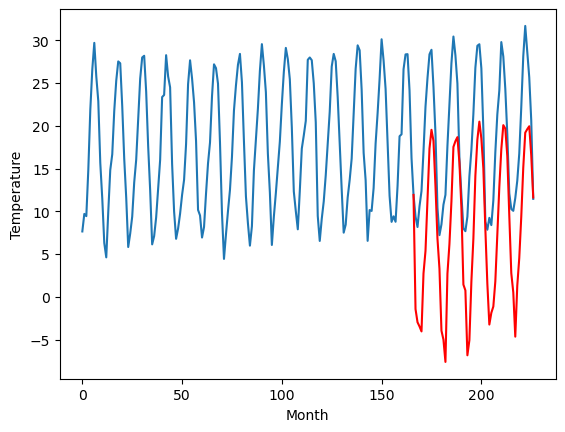

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.86		-0.81		2.05
-2.85		-2.34		0.51
-3.40		-2.84		0.56
-3.75		-3.43		0.32
3.16		3.35		0.19
3.80		5.99		2.19
8.37		11.97		3.60
14.19		17.95		3.76
17.99		20.15		2.16
15.57		18.86		3.29
11.51		13.57		2.06
6.09		7.43		1.34
2.17		3.91		1.74
-5.03		-3.34		1.69
-6.49		-4.39		2.10
-7.81		-6.99		0.82
2.40		3.34		0.94
4.75		6.80		2.05
8.82		11.78		2.96
14.74		18.15		3.41
15.73		18.83		3.10
16.25		19.30		3.05
12.12		16.34		4.22
8.54		11.05		2.51
-1.12		2.06		3.18
0.37		1.38		1.01
-8.58		-6.20		2.38
-4.06		-4.44		-0.38
1.69		2.40		0.71
4.70		7.44		2.74
11.48		14.80		3.32
14.96		19.01		4.05
16.51		21.11		4.60
15.44		19.14		3.70
11.46		15.64		4.18
4.19		8.58		4.39
1.07		2.19		1.12
-4.20		-2.61		1.59
-2.45		-1.24		1.21
-0.11		-0.51		-0.40
0.13		2.42		2.29
6.37		7.89		1.52
9.06		13.45		4.39
12.80		17.87		5.07
16.42		20.70		4.28
15.31		20.30		4.99
12.58		17.11		4.53
7.14		10.12		2.98
0.75		3.41		2.66
-1.08	

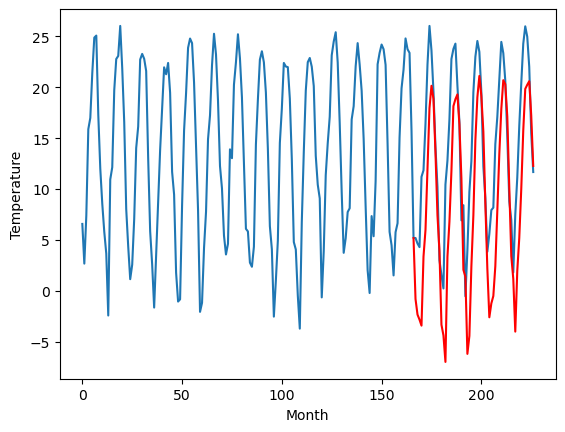

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.31		-1.89		-5.20
0.05		-3.42		-3.47
-2.82		-3.91		-1.09
-1.67		-4.50		-2.83
5.74		2.29		-3.45
8.77		4.92		-3.85
14.84		10.90		-3.94
21.89		16.88		-5.01
23.35		19.08		-4.27
20.79		17.80		-2.99
16.72		12.51		-4.21
8.99		6.37		-2.62
6.17		2.85		-3.32
-1.00		-4.40		-3.40
-2.47		-5.45		-2.98
-6.34		-8.06		-1.72
6.74		2.28		-4.46
10.03		5.73		-4.30
14.60		10.72		-3.88
22.08		17.10		-4.98
22.08		17.77		-4.31
22.20		18.25		-3.95
18.84		15.29		-3.55
13.42		9.99		-3.43
3.68		1.01		-2.67
3.32		0.33		-2.99
-6.15		-7.26		-1.11
-3.63		-5.50		-1.87
4.83		1.34		-3.49
8.96		6.38		-2.58
16.53		13.75		-2.78
21.98		17.96		-4.02
23.10		20.06		-3.04
21.28		18.09		-3.19
16.96		14.60		-2.36
9.69		7.54		-2.15
3.80		1.14		-2.66
-2.17		-3.65		-1.48
-0.45		-2.28		-1.83
6.07		-1.56		-7.63
3.11		1.38		-1.73
10.32		6.85		-3.47
16.32		12.41		-3.91
20.42		16.83		-3.59
22.12		19.66		-2.46
20.83		19.27		-1.56
17.47		16.08		-

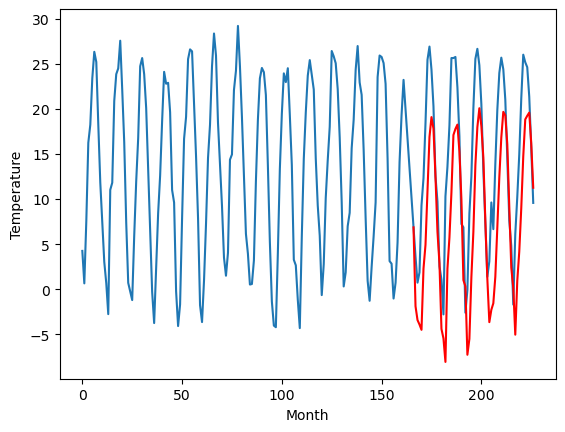

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-5.82		-4.21		1.61
-5.61		-5.74		-0.13
-7.03		-6.24		0.79
-7.44		-6.83		0.61
-0.58		-0.04		0.54
1.69		2.60		0.91
7.10		8.58		1.48
14.09		14.56		0.47
15.98		16.76		0.78
13.47		15.48		2.01
9.84		10.19		0.35
3.84		4.05		0.21
-0.10		0.53		0.63
-7.71		-6.73		0.98
-9.16		-7.77		1.39
-11.88		-10.39		1.49
-0.55		-0.06		0.49
2.90		3.40		0.50
7.18		8.40		1.22
13.89		14.76		0.87
14.27		15.44		1.17
14.59		15.92		1.33
11.33		12.95		1.62
6.75		7.65		0.90
-4.10		-1.33		2.77
-3.05		-2.01		1.04
-11.87		-9.60		2.27
-8.68		-7.84		0.84
-1.72		-1.00		0.72
2.13		4.04		1.91
9.93		11.41		1.48
13.87		15.63		1.76
15.86		17.73		1.87
14.21		15.75		1.54
10.26		12.26		2.00
4.22		5.21		0.99
-2.33		-1.19		1.14
-7.87		-5.99		1.88
-5.73		-4.63		1.10
-4.01		-3.91		0.10
-3.11		-0.97		2.14
3.12		4.49		1.37
8.53		10.06		1.53
11.99		14.48		2.49
15.25		17.32		2.07
13.70		16.93		3.23
10.24		13.73		3.49
4.59		6.75		2.16
-1.89		0.04		

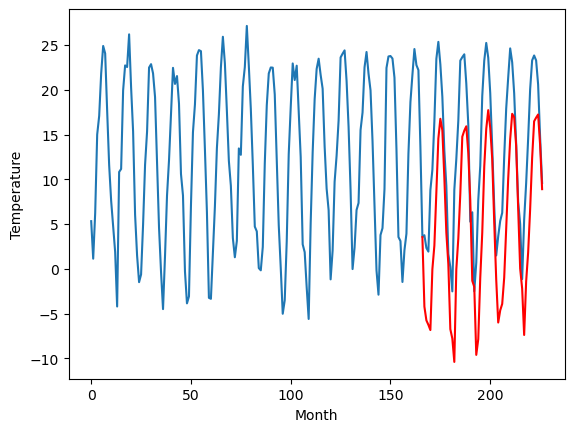

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.46		-3.13		3.33
-12.13		-4.66		7.47
-12.22		-5.16		7.06
-12.03		-5.74		6.29
-7.10		1.03		8.13
-4.12		3.67		7.79
2.99		9.65		6.66
7.20		15.64		8.44
9.19		17.84		8.65
9.94		16.55		6.61
4.44		11.26		6.82
0.70		5.12		4.42
-6.49		1.60		8.09
-12.19		-5.65		6.54
-11.92		-6.71		5.21
-11.82		-9.32		2.50
-8.85		1.01		9.86
-4.07		4.46		8.53
0.98		9.45		8.47
8.37		15.82		7.45
10.21		16.49		6.28
8.29		16.97		8.68
6.42		14.01		7.59
-1.55		8.71		10.26
-4.29		-0.27		4.02
-9.05		-0.96		8.09
-11.34		-8.55		2.79
-13.06		-6.79		6.27
-8.52		0.06		8.58
-4.20		5.09		9.29
1.71		12.45		10.74
7.48		16.67		9.19
9.40		18.78		9.38
8.64		16.80		8.16
6.48		13.31		6.83
-1.78		6.26		8.04
-9.46		-0.15		9.31
-11.63		-4.94		6.69
-12.36		-3.58		8.78
-12.33		-2.86		9.47
-10.54		0.08		10.62
-5.20		5.56		10.76
2.01		11.12		9.11
6.59		15.54		8.95
12.73		18.37		5.64
10.14		17.97		7.83
5.99		14.77		8.78
-0.14		7.78		7.92
-6.00		1.0

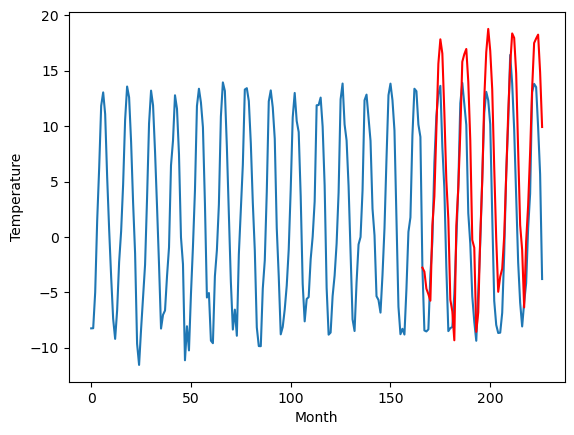

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-13.16		-16.69		-3.53
-17.89		-18.22		-0.33
-16.73		-18.72		-1.99
-15.22		-19.31		-4.09
-12.11		-12.53		-0.42
-6.20		-9.90		-3.70
1.07		-3.91		-4.98
4.53		2.08		-2.45
8.76		4.28		-4.48
8.87		2.99		-5.88
4.06		-2.31		-6.37
-2.88		-8.45		-5.57
-11.69		-11.96		-0.27
-17.38		-19.22		-1.84
-16.83		-20.27		-3.44
-13.98		-22.88		-8.90
-12.38		-12.56		-0.18
-4.41		-9.11		-4.70
0.02		-4.12		-4.14
7.66		2.24		-5.42
8.74		2.92		-5.82
7.51		3.39		-4.12
3.54		0.44		-3.10
-6.81		-4.86		1.95
-9.33		-13.84		-4.51
-16.60		-14.54		2.06
-16.67		-22.13		-5.46
-14.63		-20.38		-5.75
-9.92		-13.52		-3.60
-5.29		-8.50		-3.21
-0.62		-1.14		-0.52
5.86		3.08		-2.78
8.09		5.19		-2.90
6.50		3.22		-3.28
4.14		-0.28		-4.42
-3.75		-7.33		-3.58
-15.17		-13.74		1.43
-17.50		-18.53		-1.03
-18.01		-17.17		0.84
-17.10		-16.44		0.66
-14.27		-13.49		0.78
-6.32		-8.02		-1.70
-0.52		-2.46		-1.94
1.98		1.96		-0.02
10.34		4.78		-5.56


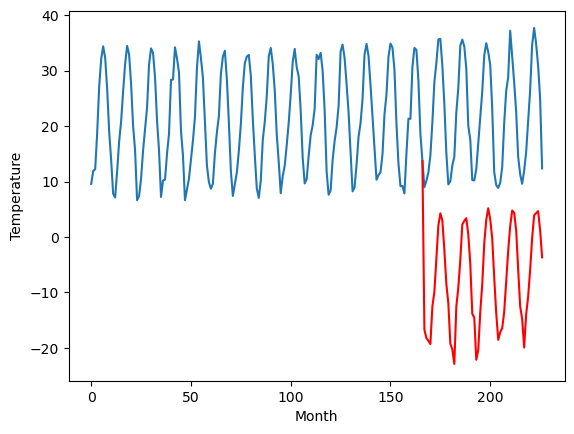

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.28		1.13		-4.15
4.03		-0.40		-4.43
3.40		-0.90		-4.30
5.42		-1.48		-6.90
4.86		5.29		0.43
8.48		7.91		-0.57
10.88		13.90		3.02
13.42		19.89		6.47
12.61		22.08		9.47
14.49		20.79		6.30
13.91		15.49		1.58
11.69		9.35		-2.34
4.53		5.83		1.30
2.48		-1.42		-3.90
3.70		-2.48		-6.18
4.63		-5.08		-9.71
4.41		5.24		0.83
6.60		8.69		2.09
10.89		13.67		2.78
12.59		20.04		7.45
11.77		20.71		8.94
12.32		21.19		8.87
11.77		18.23		6.46
9.01		12.94		3.93
6.19		3.95		-2.24
2.49		3.26		0.77
3.11		-4.33		-7.44
4.07		-2.58		-6.65
6.30		4.27		-2.03
7.74		9.28		1.54
10.73		16.64		5.91
13.88		20.85		6.97
12.23		22.97		10.74
13.65		20.98		7.33
13.88		17.47		3.59
9.15		10.41		1.26
3.42		4.00		0.58
2.22		-0.78		-3.00
3.89		0.59		-3.30
2.09		1.32		-0.77
3.55		4.26		0.71
7.63		9.72		2.09
8.66		15.29		6.63
10.56		19.71		9.15
13.57		22.53		8.96
14.60		22.13		7.53
11.99		18.94		6.95
10.53		11.95		1.42
6.49		5.23		-1.26
4

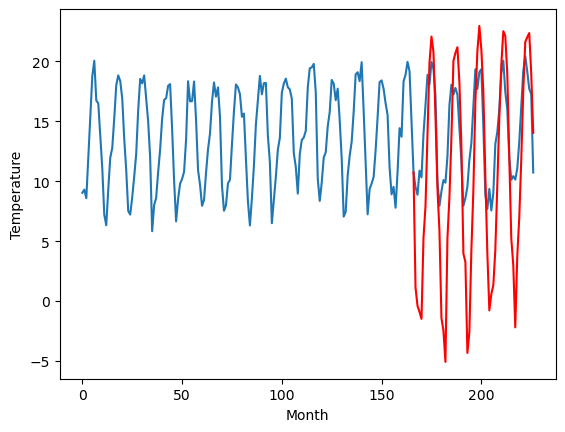

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.63		0.59		-0.04
-2.13		-0.94		1.19
-2.10		-1.44		0.66
-1.66		-2.03		-0.37
1.92		4.74		2.82
3.36		7.38		4.02
8.92		13.36		4.44
15.90		19.35		3.45
19.85		21.55		1.70
18.67		20.26		1.59
14.33		14.96		0.63
9.01		8.82		-0.19
4.94		5.31		0.37
-1.40		-1.95		-0.55
-4.42		-3.01		1.41
-4.54		-5.62		-1.08
0.46		4.71		4.25
5.08		8.16		3.08
9.91		13.14		3.23
15.78		19.51		3.73
17.92		20.18		2.26
18.54		20.65		2.11
15.22		17.69		2.47
10.78		12.39		1.61
1.86		3.41		1.55
0.26		2.71		2.45
-6.29		-4.88		1.41
-3.53		-3.13		0.40
0.43		3.71		3.28
4.72		8.74		4.02
10.51		16.09		5.58
14.83		20.30		5.47
19.38		22.41		3.03
19.30		20.42		1.12
14.39		16.92		2.53
8.13		9.86		1.73
4.17		3.45		-0.72
-2.19		-1.34		0.85
-0.21		0.03		0.24
-1.94		0.76		2.70
0.03		3.70		3.67
6.08		9.17		3.09
9.72		14.73		5.01
13.71		19.15		5.44
19.39		21.98		2.59
17.14		21.57		4.43
14.57		18.39		3.82
9.14		11.39		2.25
1.29		4.68		3.39
0.56	

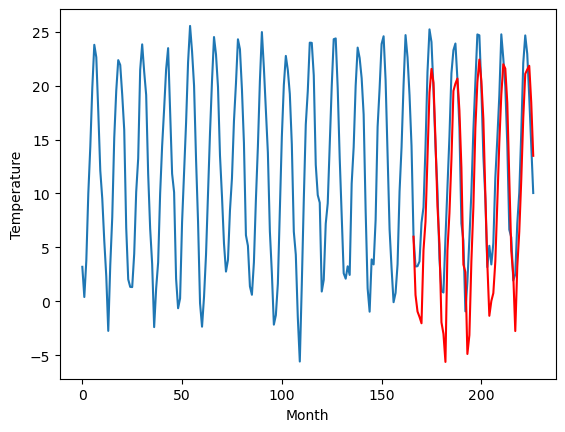

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.46		-5.26		1.20
-9.42		-6.79		2.63
-9.01		-7.29		1.72
-8.09		-7.88		0.21
-3.68		-1.10		2.58
-1.74		1.53		3.27
4.03		7.52		3.49
10.75		13.51		2.76
14.52		15.70		1.18
12.65		14.41		1.76
7.68		9.11		1.43
2.19		2.98		0.79
-2.09		-0.53		1.56
-8.91		-7.79		1.12
-10.47		-8.85		1.62
-11.27		-11.46		-0.19
-4.08		-1.13		2.95
0.79		2.32		1.53
5.05		7.31		2.26
11.22		13.68		2.46
12.86		14.35		1.49
12.59		14.82		2.23
8.33		11.86		3.53
4.21		6.57		2.36
-6.01		-2.42		3.59
-6.42		-3.11		3.31
-13.40		-10.70		2.70
-9.59		-8.95		0.64
-4.41		-2.11		2.30
-0.59		2.92		3.51
6.19		10.27		4.08
10.18		14.48		4.30
13.96		16.59		2.63
13.09		14.61		1.52
7.86		11.10		3.24
0.25		4.04		3.79
-2.87		-2.36		0.51
-9.90		-7.16		2.74
-7.25		-5.79		1.46
-7.04		-5.06		1.98
-5.48		-2.13		3.35
2.09		3.34		1.25
4.56		8.91		4.35
8.49		13.33		4.84
13.33		16.15		2.82
11.36		15.74		4.38
8.07		12.56		4.49
2.78		5.56		2.78
-5.49		-1.15	

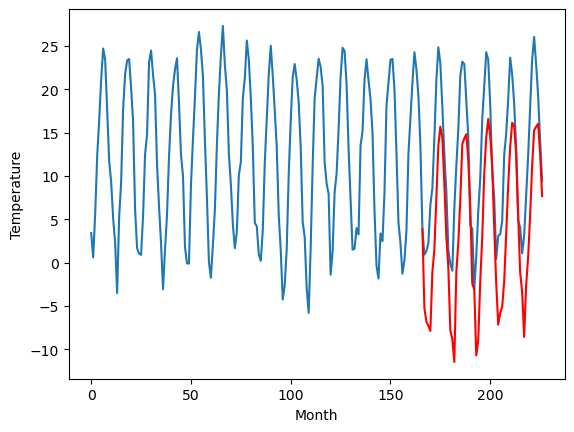

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -6.46  -5.265178
1                 1    2.22   0.439600
2                 2    2.71  -1.426305
3                 3   -2.86  -0.812080
4                 4    3.31  -1.887146
5                 5   -5.82  -4.210475
6                 6   -6.46  -3.125469
7                 7  -13.16 -16.686336
8                 8    5.28   1.128339
9                 9    0.63   0.588239
10               10   -6.46  -5.255300


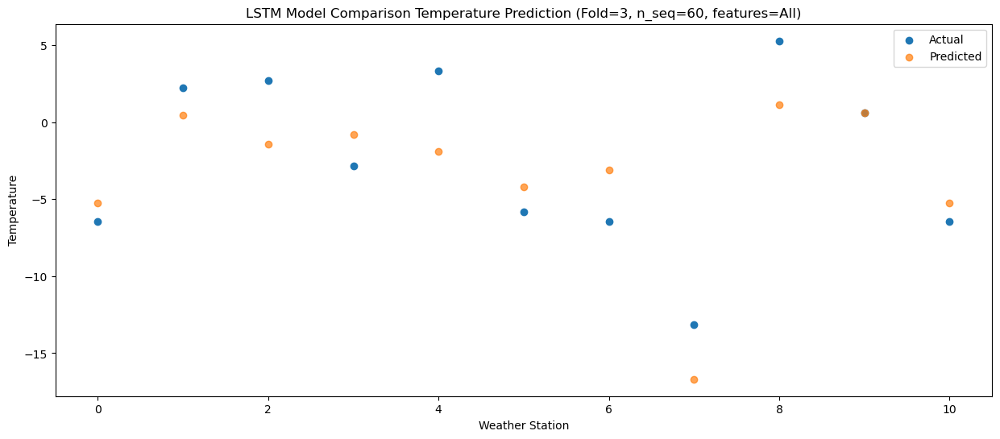

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -7.24  -6.803808
1                 1    0.87  -1.096038
2                 2    0.18  -2.965453
3                 3   -2.85  -2.342006
4                 4    0.05  -3.416520
5                 5   -5.61  -5.744435
6                 6  -12.13  -4.659558
7                 7  -17.89 -18.221709
8                 8    4.03  -0.402742
9                 9   -2.13  -0.944400
10               10   -9.42  -6.790050


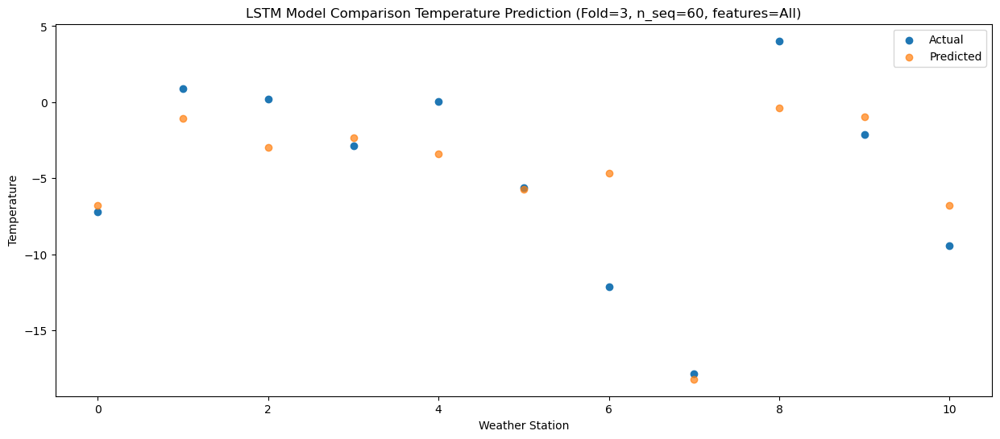

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -7.66  -7.295857
1                 1    0.03  -1.593350
2                 2   -1.04  -3.455771
3                 3   -3.40  -2.835816
4                 4   -2.82  -3.914048
5                 5   -7.03  -6.244344
6                 6  -12.22  -5.157448
7                 7  -16.73 -18.720773
8                 8    3.40  -0.899215
9                 9   -2.10  -1.443383
10               10   -9.01  -7.288399


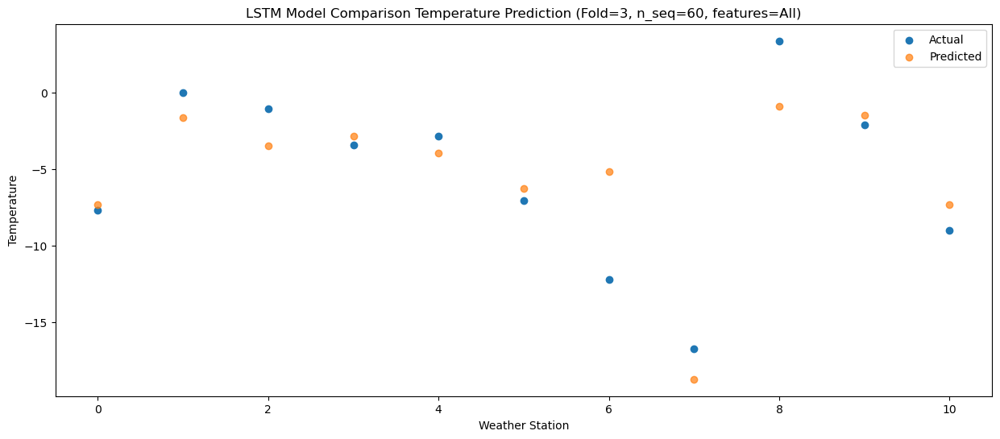

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -6.65  -7.885034
1                 1    0.18  -2.181915
2                 2    1.38  -4.039549
3                 3   -3.75  -3.425961
4                 4   -1.67  -4.500336
5                 5   -7.44  -6.830269
6                 6  -12.03  -5.744159
7                 7  -15.22 -19.306978
8                 8    5.42  -1.484529
9                 9   -1.66  -2.031992
10               10   -8.09  -7.877720


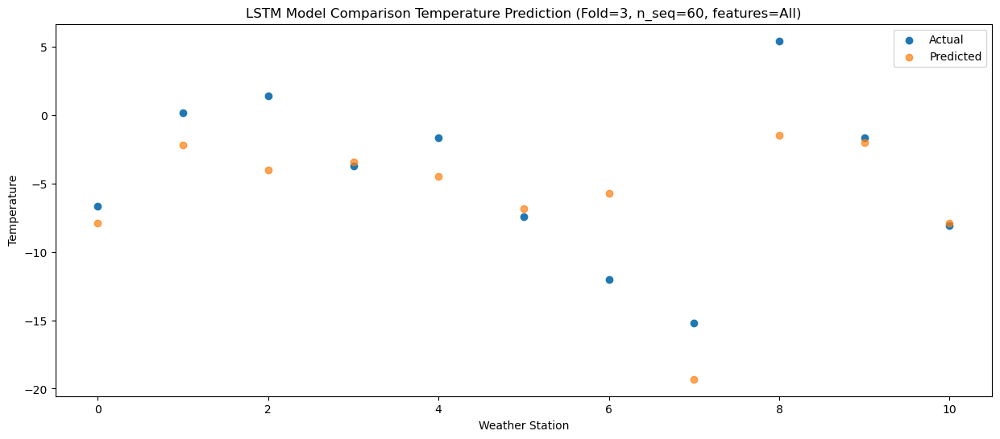

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0   -1.39  -1.100473
1                 1    7.67   4.605014
2                 2    3.17   2.739720
3                 3    3.16   3.354486
4                 4    5.74   2.286613
5                 5   -0.58  -0.041871
6                 6   -7.10   1.034897
7                 7  -12.11 -12.530896
8                 8    4.86   5.288462
9                 9    1.92   4.743217
10               10   -3.68  -1.099031


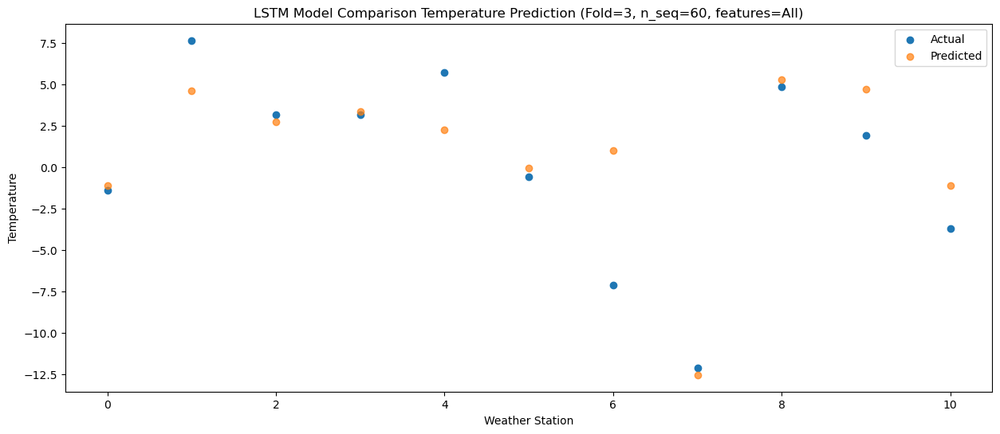

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   -0.32   1.527357
1                 1    8.59   7.233567
2                 2    7.83   5.368751
3                 3    3.80   5.987130
4                 4    8.77   4.922165
5                 5    1.69   2.595915
6                 6   -4.12   3.667662
7                 7   -6.20  -9.902473
8                 8    8.48   7.913737
9                 9    3.36   7.375227
10               10   -1.74   1.534407


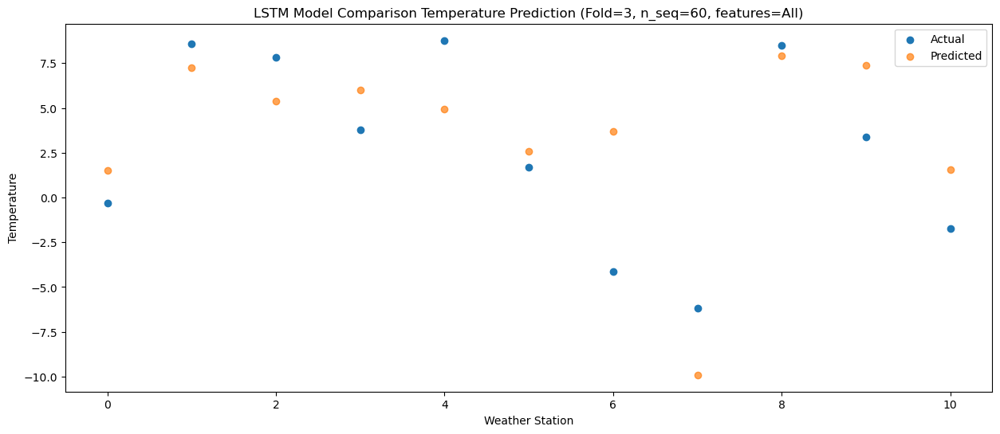

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    2.37   7.509568
1                 1   12.99  13.212464
2                 2   13.02  11.355271
3                 3    8.37  11.968659
4                 4   14.84  10.898751
5                 5    7.10   8.575214
6                 6    2.99   9.654842
7                 7    1.07  -3.911878
8                 8   10.88  13.901472
9                 9    8.92  13.361806
10               10    4.03   7.518348


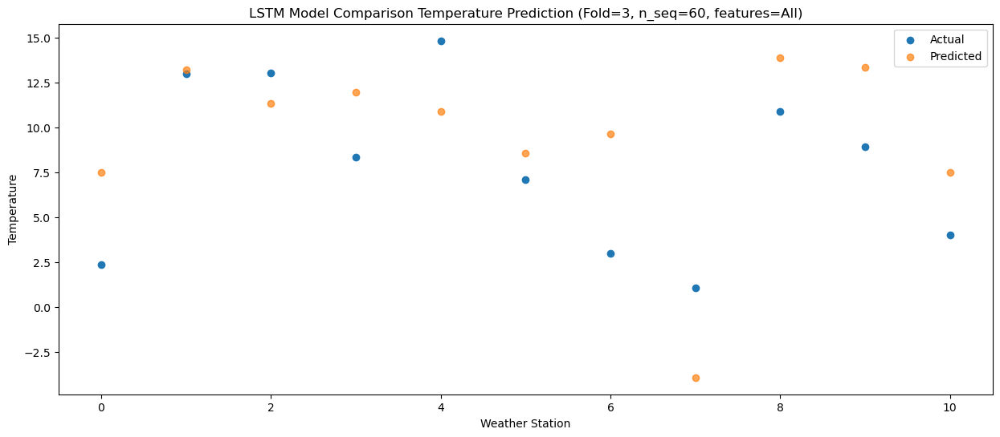

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    7.69  13.477556
1                 1   20.09  19.188591
2                 2   16.37  17.336273
3                 3   14.19  17.950780
4                 4   21.89  16.881058
5                 5   14.09  14.559004
6                 6    7.20  15.637098
7                 7    4.53   2.078167
8                 8   13.42  19.889565
9                 9   15.90  19.350982
10               10   10.75  13.505124


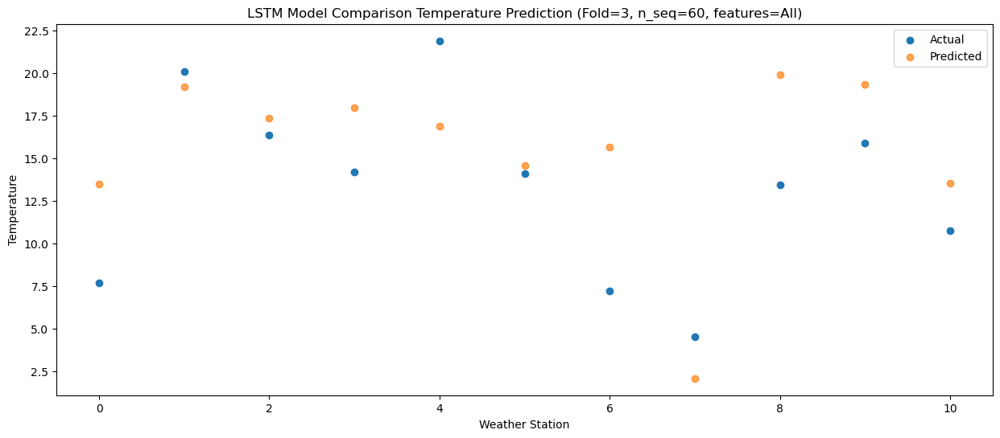

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   10.55  15.668840
1                 1   21.95  21.380435
2                 2   19.15  19.533672
3                 3   17.99  20.147622
4                 4   23.35  19.081528
5                 5   15.98  16.760065
6                 6    9.19  17.838347
7                 7    8.76   4.277765
8                 8   12.61  22.079501
9                 9   19.85  21.545484
10               10   14.52  15.699010


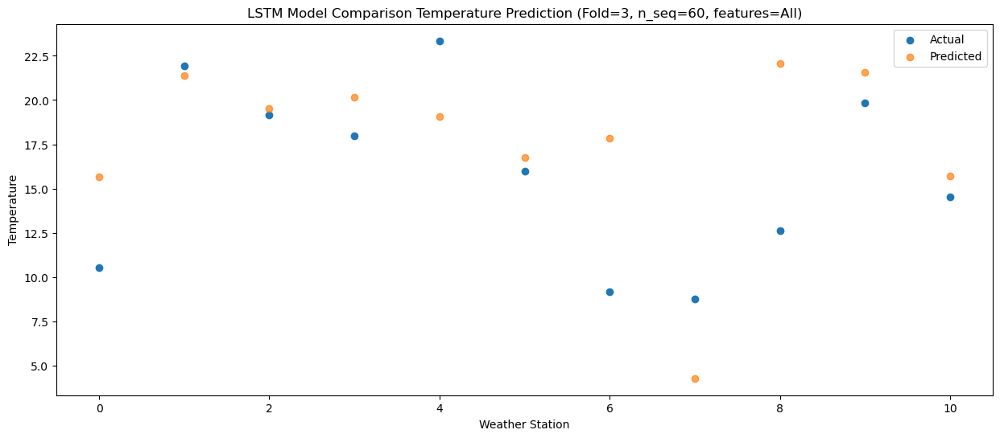

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    9.32  14.371665
1                 1   20.09  20.095641
2                 2   19.68  18.240710
3                 3   15.57  18.859930
4                 4   20.79  17.801396
5                 5   13.47  15.479118
6                 6    9.94  16.553984
7                 7    8.87   2.989665
8                 8   14.49  20.786429
9                 9   18.67  20.256763
10               10   12.65  14.409638


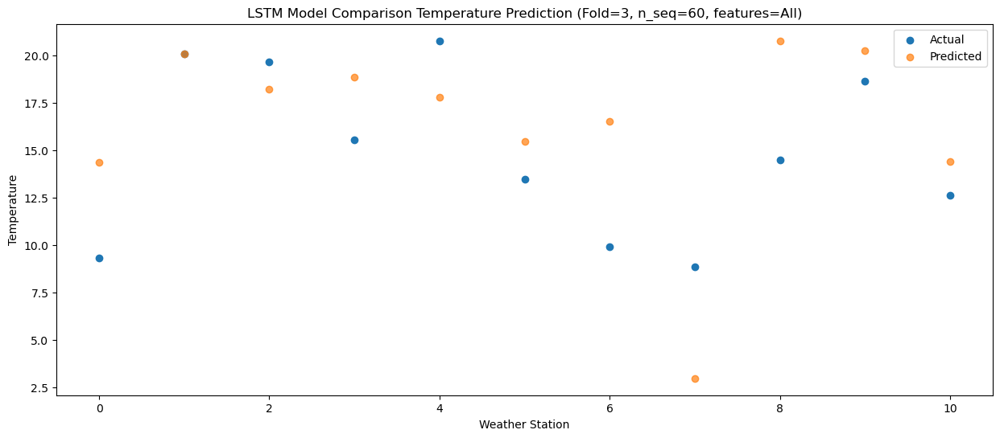

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    5.35   9.082986
1                 1   16.42  14.802247
2                 2   15.35  12.944693
3                 3   11.51  13.566973
4                 4   16.72  12.508242
5                 5    9.84  10.187246
6                 6    4.44  11.257050
7                 7    4.06  -2.309508
8                 8   13.91  15.485135
9                 9   14.33  14.955908
10               10    7.68   9.114239


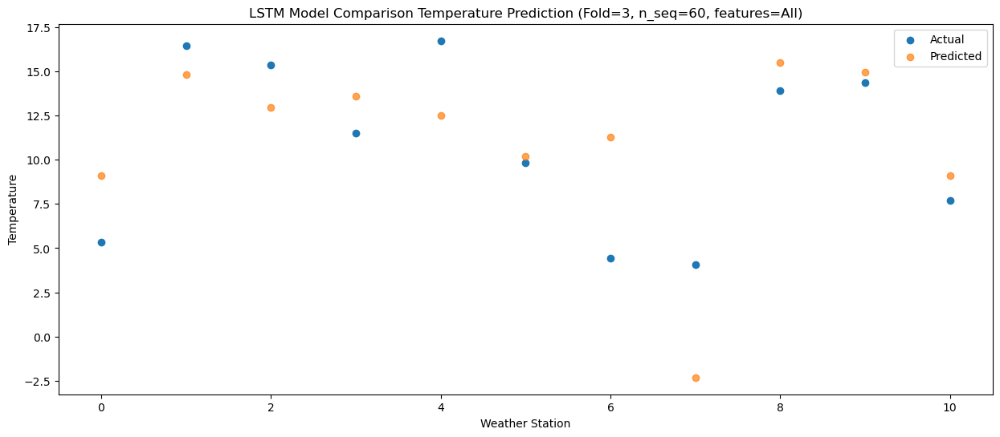

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    1.78   2.937750
1                 1    9.31   8.660370
2                 2    9.86   6.810940
3                 3    6.09   7.427659
4                 4    8.99   6.371688
5                 5    3.84   4.047953
6                 6    0.70   5.115531
7                 7   -2.88  -8.446578
8                 8   11.69   9.350060
9                 9    9.01   8.820785
10               10    2.19   2.977669


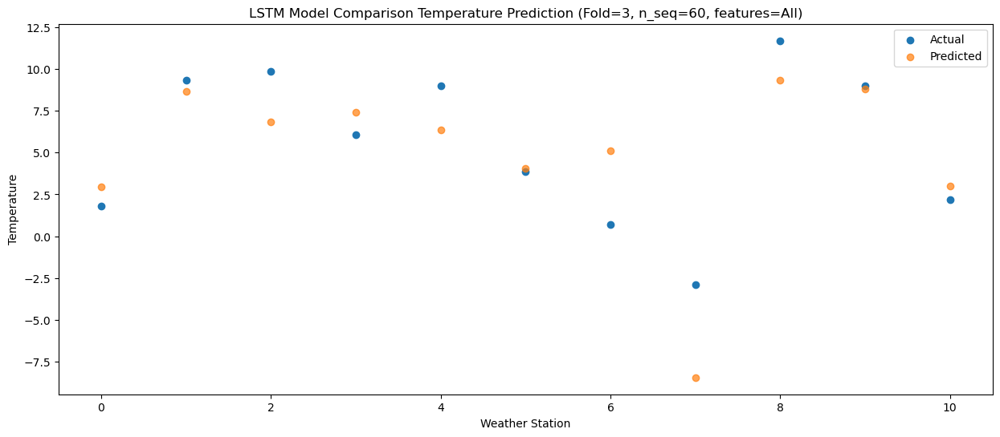

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0   -2.64  -0.569152
1                 1    6.49   5.145235
2                 2    1.21   3.294469
3                 3    2.17   3.912269
4                 4    6.17   2.854440
5                 5   -0.10   0.527989
6                 6   -6.49   1.597721
7                 7  -11.69 -11.963863
8                 8    4.53   5.833694
9                 9    4.94   5.305265
10               10   -2.09  -0.534995


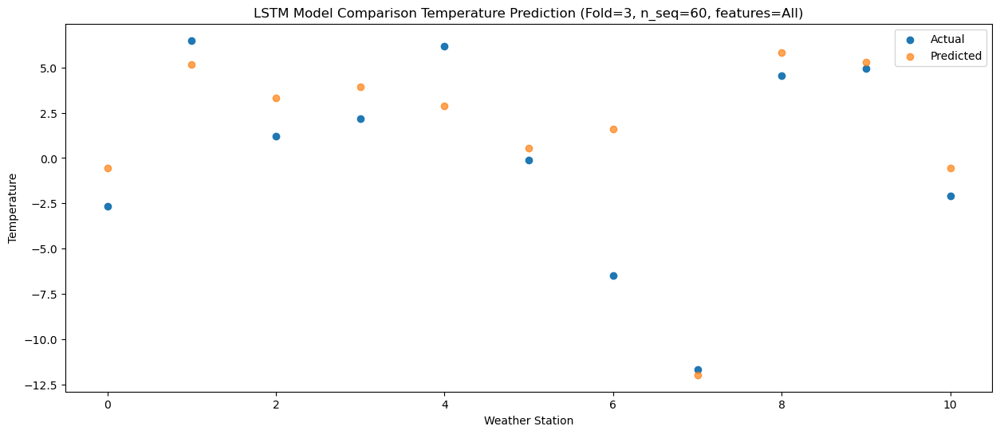

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -9.82  -7.810020
1                 1   -0.06  -2.095374
2                 2   -1.99  -3.948323
3                 3   -5.03  -3.335669
4                 4   -1.00  -4.397325
5                 5   -7.71  -6.726359
6                 6  -12.19  -5.654267
7                 7  -17.38 -19.218918
8                 8    2.48  -1.419078
9                 9   -1.40  -1.948586
10               10   -8.91  -7.789330


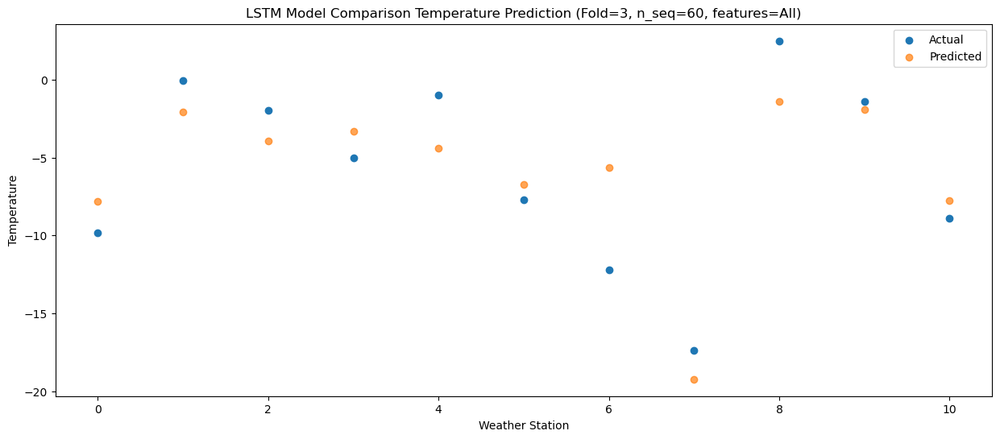

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0  -10.10  -8.870505
1                 1   -1.21  -3.149610
2                 2   -0.73  -4.999949
3                 3   -6.49  -4.388156
4                 4   -2.47  -5.446255
5                 5   -9.16  -7.774371
6                 6  -11.92  -6.709772
7                 7  -16.83 -20.272762
8                 8    3.70  -2.476333
9                 9   -4.42  -3.009734
10               10  -10.47  -8.850197


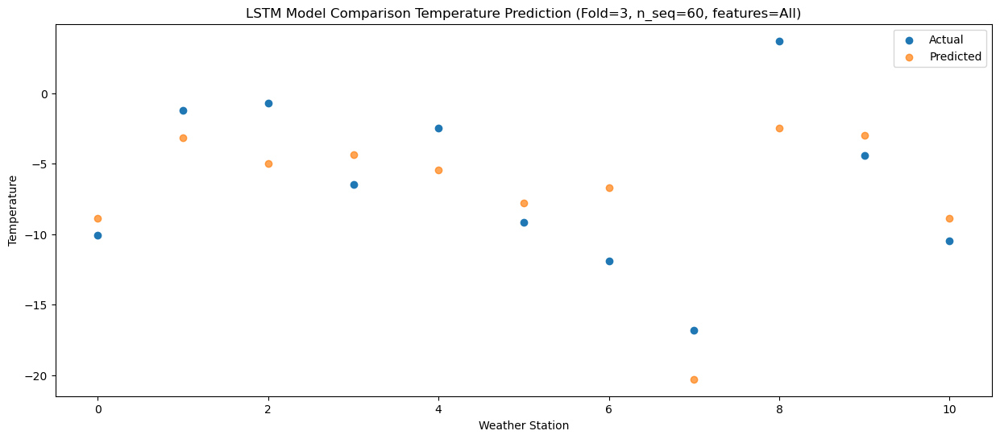

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -9.73 -11.473832
1                 1   -4.93  -5.759212
2                 2    1.57  -7.604720
3                 3   -7.81  -6.991549
4                 4   -6.34  -8.057281
5                 5  -11.88 -10.387329
6                 6  -11.82  -9.316877
7                 7  -13.98 -22.884513
8                 8    4.63  -5.080276
9                 9   -4.54  -5.616100
10               10  -11.27 -11.455415


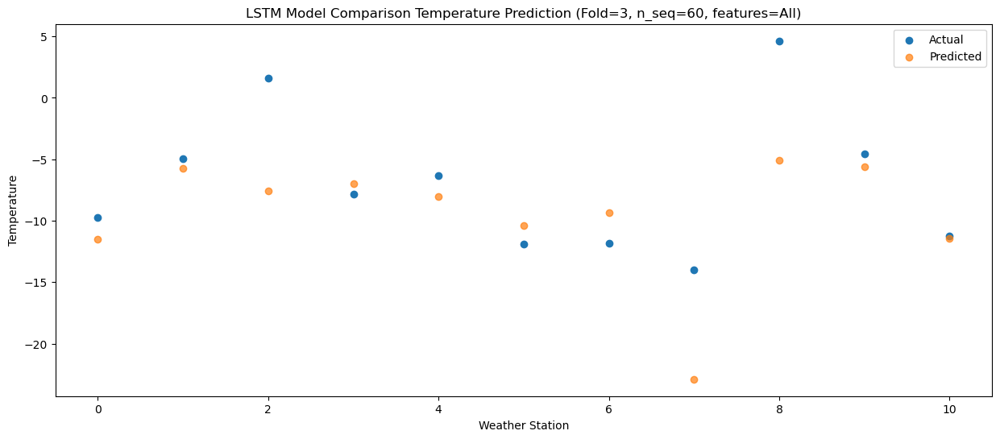

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -2.93  -1.143785
1                 1    7.04   4.577576
2                 2    2.72   2.725079
3                 3    2.40   3.341684
4                 4    6.74   2.280100
5                 5   -0.55  -0.055727
6                 6   -8.85   1.011173
7                 7  -12.38 -12.560637
8                 8    4.41   5.242168
9                 9    0.46   4.707413
10               10   -4.08  -1.129699


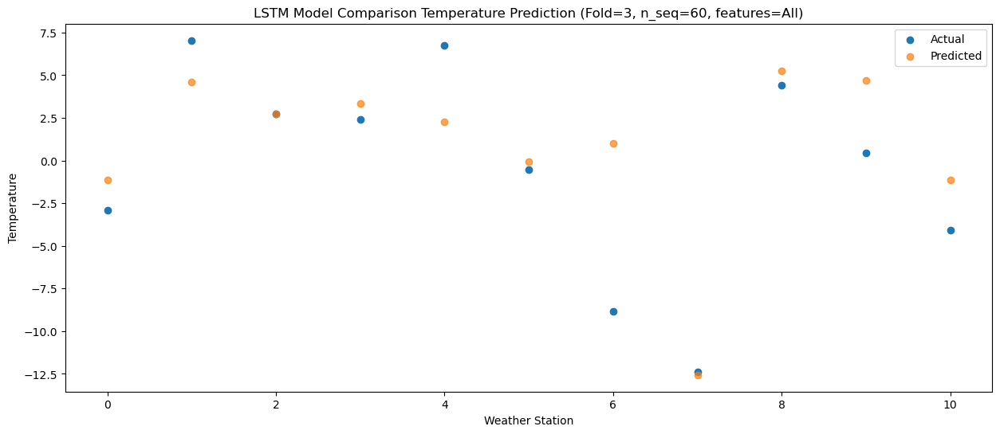

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    0.23   2.303847
1                 1    8.90   8.025521
2                 2    8.45   6.176563
3                 3    4.75   6.797199
4                 4   10.03   5.734465
5                 5    2.90   3.404274
6                 6   -4.07   4.463079
7                 7   -4.41  -9.114911
8                 8    6.60   8.688953
9                 9    5.08   8.158174
10               10    0.79   2.322383


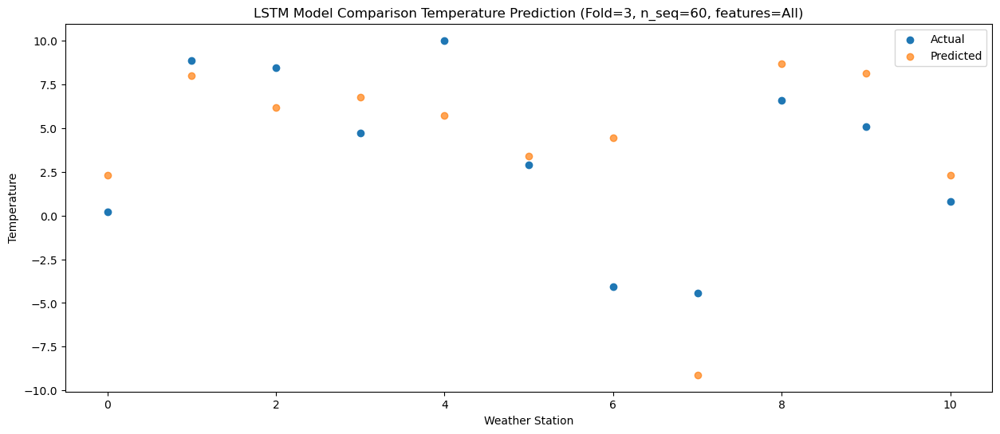

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    3.89   7.284286
1                 1   13.12  13.010706
2                 2   13.25  11.157761
3                 3    8.82  11.776066
4                 4   14.60  10.722834
5                 5    7.18   8.395178
6                 6    0.98   9.448923
7                 7    0.02  -4.123311
8                 8   10.89  13.671351
9                 9    9.91  13.139908
10               10    5.05   7.306516


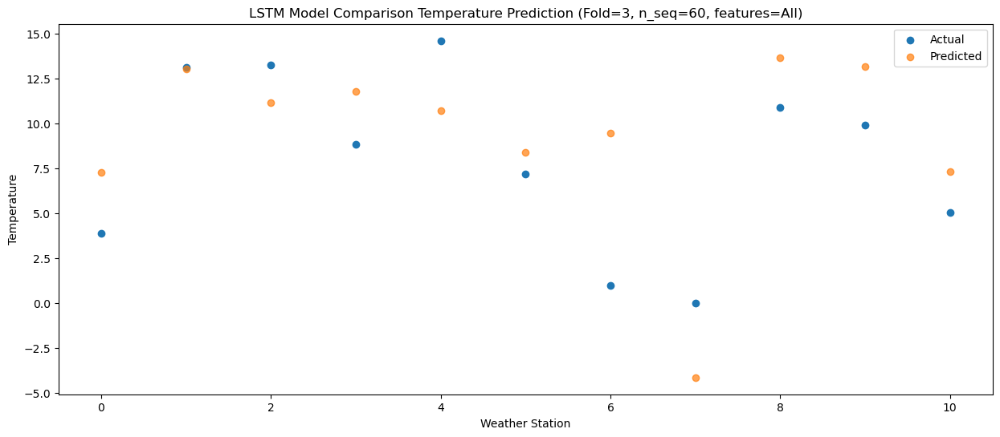

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    7.95  13.658888
1                 1   19.83  19.388991
2                 2   18.10  17.532257
3                 3   14.74  18.150401
4                 4   22.08  17.096202
5                 5   13.89  14.761332
6                 6    8.37  15.815832
7                 7    7.66   2.243006
8                 8   12.59  20.039741
9                 9   15.78  19.507670
10               10   11.22  13.676375


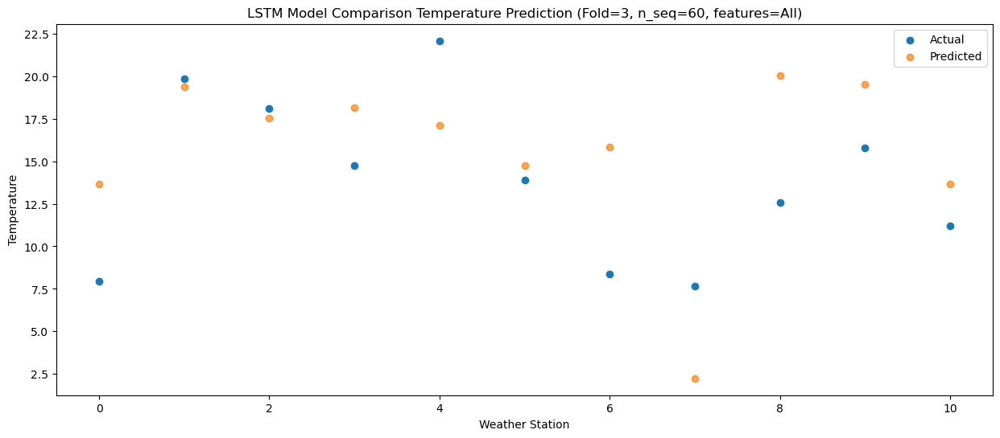

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    9.66  14.335661
1                 1   21.14  20.069633
2                 2   21.23  18.206135
3                 3   15.73  18.827537
4                 4   22.08  17.773930
5                 5   14.27  15.443969
6                 6   10.21  16.494955
7                 7    8.74   2.922229
8                 8   11.77  20.714849
9                 9   17.92  20.181872
10               10   12.86  14.348485


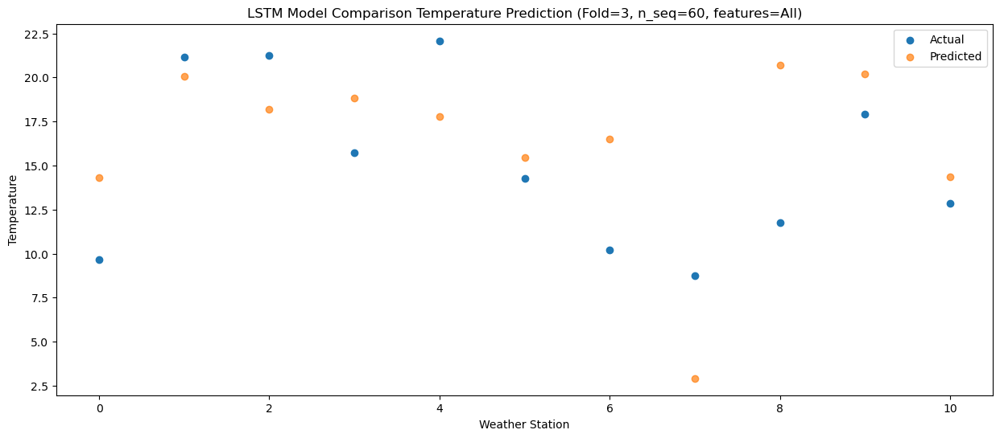

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    9.88  14.801672
1                 1   21.71  20.542047
2                 2   19.03  18.676831
3                 3   16.25  19.300986
4                 4   22.20  18.251642
5                 5   14.59  15.921770
6                 6    8.29  16.968528
7                 7    7.51   3.394890
8                 8   12.32  21.191206
9                 9   18.54  20.654865
10               10   12.59  14.824099


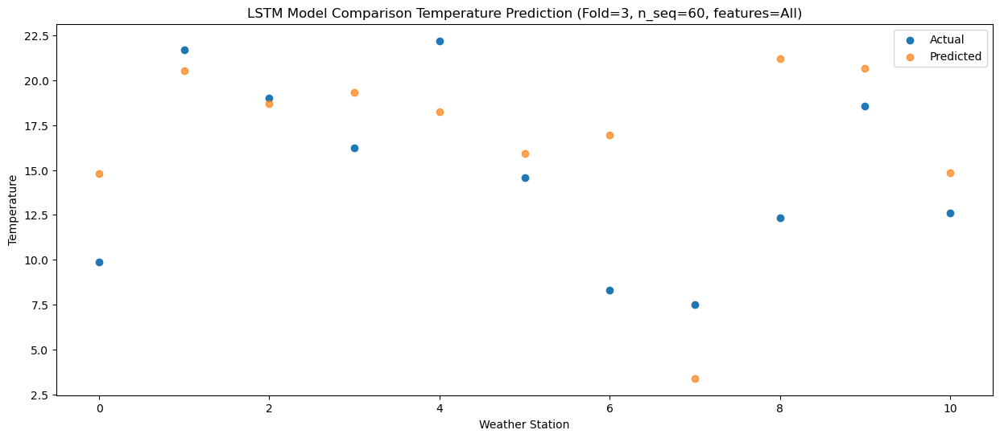

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    5.89  11.846821
1                 1   18.98  17.589340
2                 2   15.72  15.721748
3                 3   12.12  16.341336
4                 4   18.84  15.287245
5                 5   11.33  12.953235
6                 6    6.42  14.006882
7                 7    3.54   0.441383
8                 8   11.77  18.232872
9                 9   15.22  17.689233
10               10    8.33  11.860344


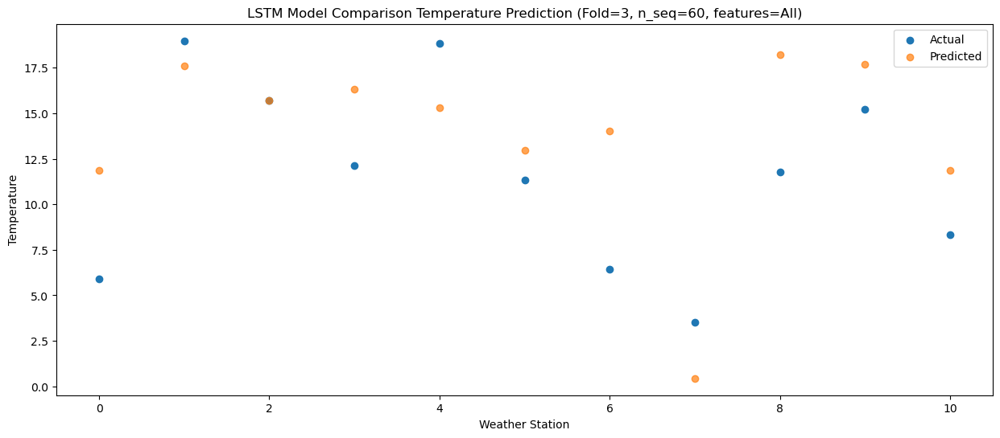

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    2.66   6.556079
1                 1   12.38  12.290476
2                 2    7.06  10.425833
3                 3    8.54  11.045267
4                 4   13.42   9.988812
5                 5    6.75   7.652319
6                 6   -1.55   8.708930
7                 7   -6.81  -4.855412
8                 8    9.01  12.940154
9                 9   10.78  12.394792
10               10    4.21   6.565259


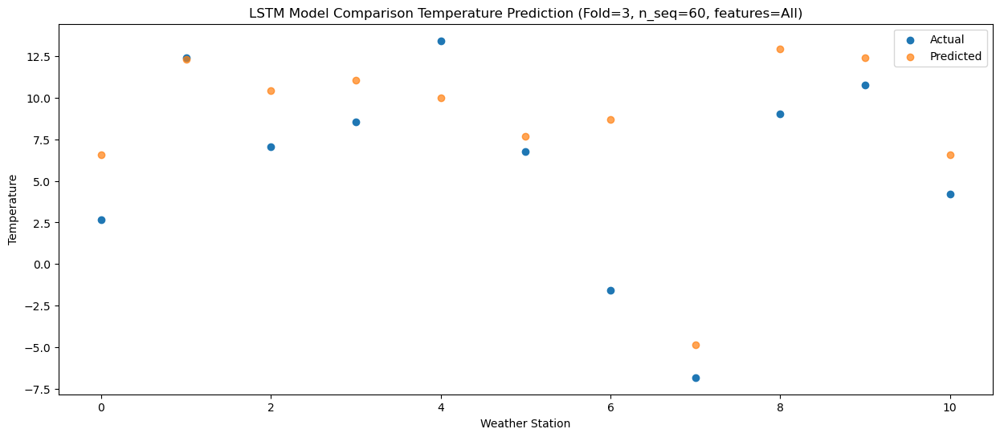

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -6.10  -2.432633
1                 1    4.67   3.306973
2                 2    2.72   1.437969
3                 3   -1.12   2.060480
4                 4    3.68   1.009416
5                 5   -4.10  -1.326051
6                 6   -4.29  -0.272171
7                 7   -9.33 -13.839922
8                 8    6.19   3.952799
9                 9    1.86   3.406732
10               10   -6.01  -2.423054


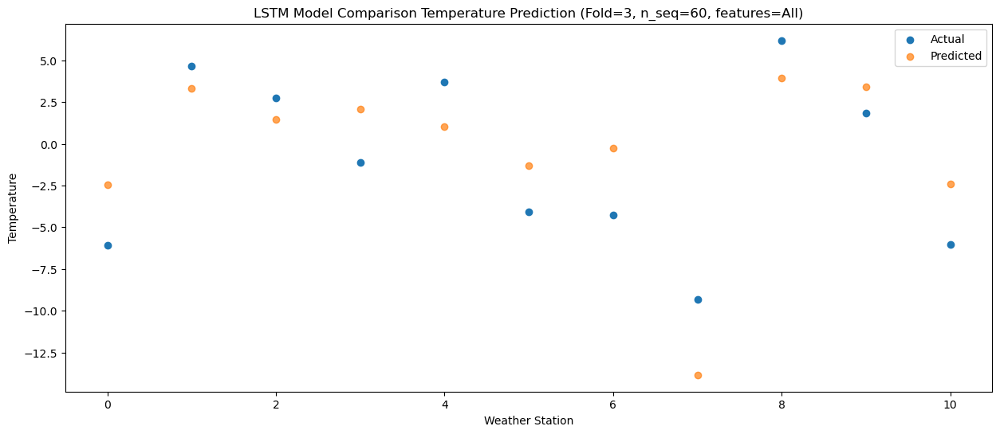

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -4.14  -3.106517
1                 1    5.98   2.624729
2                 2   -1.20   0.755509
3                 3    0.37   1.383797
4                 4    3.32   0.327127
5                 5   -3.05  -2.008924
6                 6   -9.05  -0.964971
7                 7  -16.60 -14.539514
8                 8    2.49   3.262718
9                 9    0.26   2.711140
10               10   -6.42  -3.113574


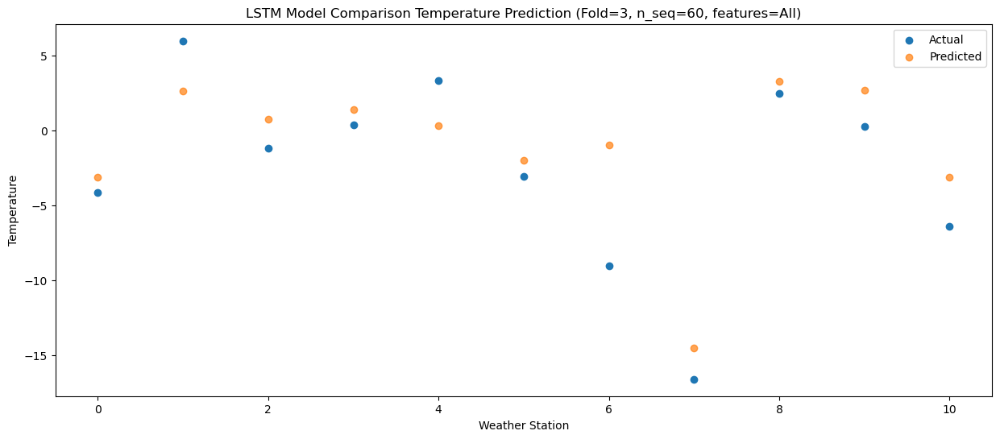

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -10.98 -10.683750
1                 1   -2.85  -4.956290
2                 2   -1.53  -6.829978
3                 3   -8.58  -6.201063
4                 4   -6.15  -7.263642
5                 5  -11.87  -9.600763
6                 6  -11.34  -8.552686
7                 7  -16.67 -22.130509
8                 8    3.11  -4.330968
9                 9   -6.29  -4.880095
10               10  -13.40 -10.702703


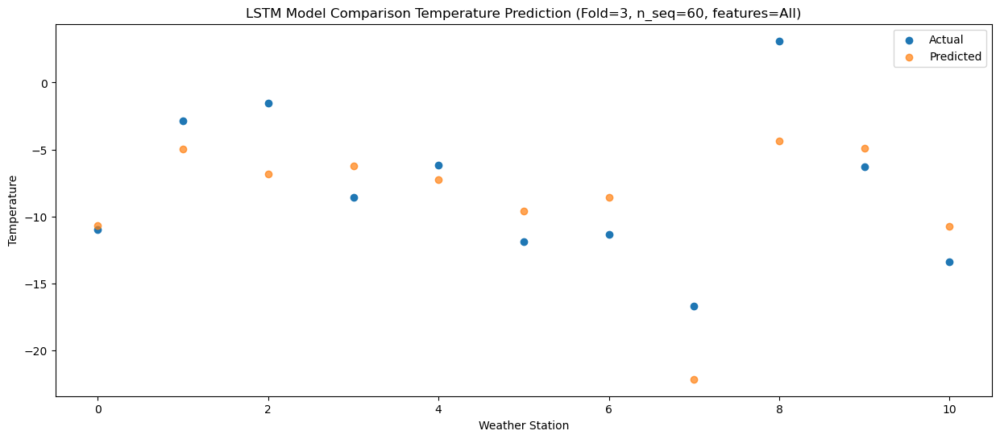

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -6.60  -8.915746
1                 1   -1.63  -3.192188
2                 2    0.17  -5.065860
3                 3   -4.06  -4.438542
4                 4   -3.63  -5.503415
5                 5   -8.68  -7.841618
6                 6  -13.06  -6.791336
7                 7  -14.63 -20.375245
8                 8    4.07  -2.578334
9                 9   -3.53  -3.131258
10               10   -9.59  -8.951477


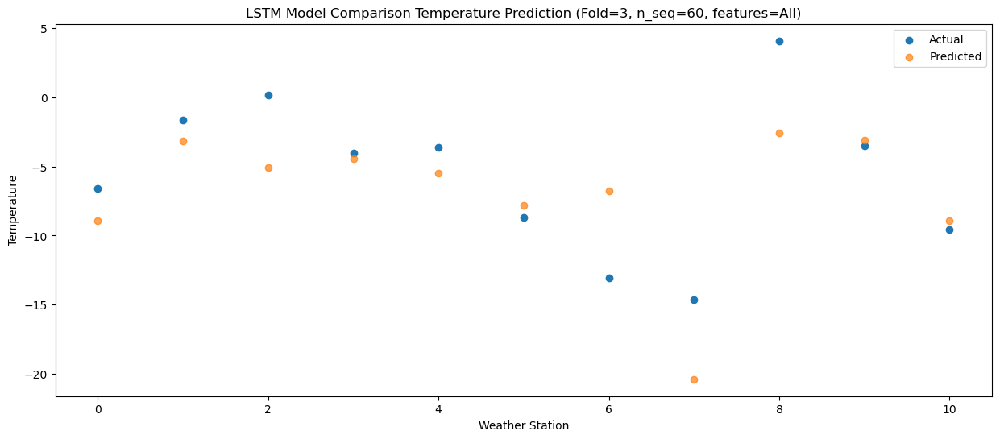

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -2.54  -2.084146
1                 1    5.15   3.648855
2                 2    4.88   1.781236
3                 3    1.69   2.403301
4                 4    4.83   1.341866
5                 5   -1.72  -0.996127
6                 6   -8.52   0.055868
7                 7   -9.92 -13.523468
8                 8    6.30   4.267370
9                 9    0.43   3.709139
10               10   -4.41  -2.108442


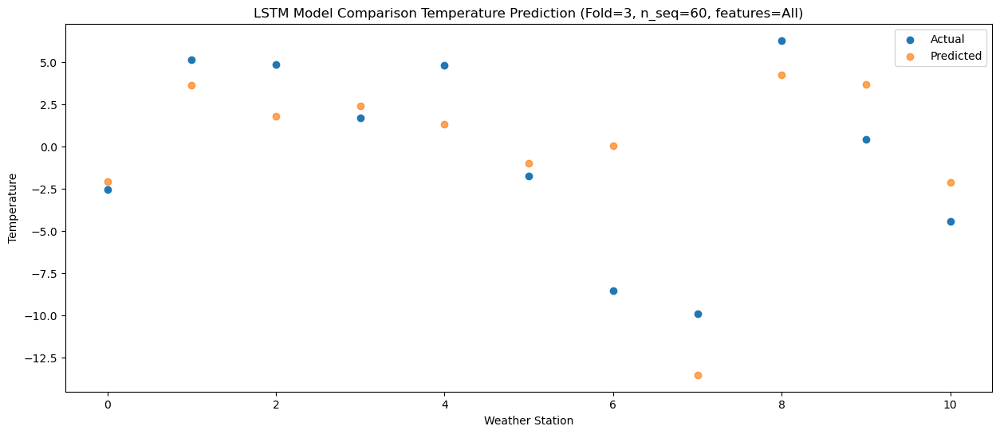

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    0.56   2.942416
1                 1   10.00   8.685060
2                 2    7.95   6.805821
3                 3    4.70   7.435588
4                 4    8.96   6.380562
5                 5    2.13   4.038742
6                 6   -4.20   5.086430
7                 7   -5.29  -8.499544
8                 8    7.74   9.284270
9                 9    4.72   8.735067
10               10   -0.59   2.916607


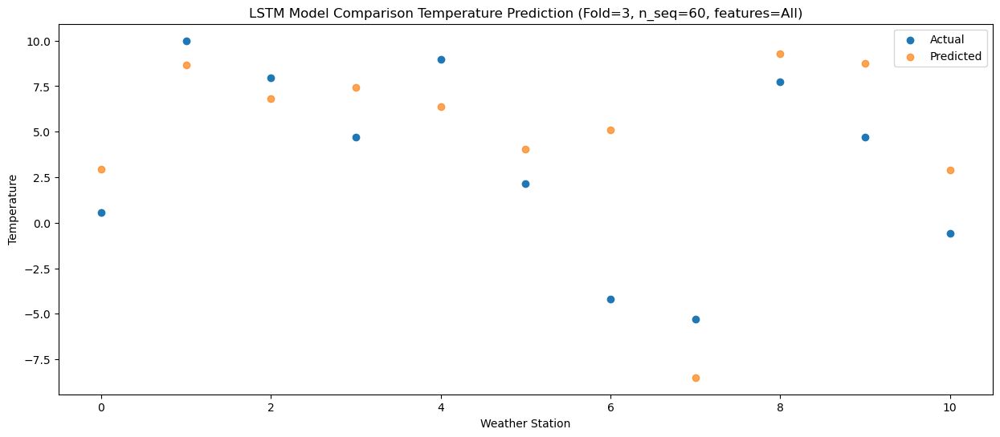

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    5.40  10.296443
1                 1   15.43  16.046902
2                 2   12.19  14.166179
3                 3   11.48  14.802956
4                 4   16.53  13.750439
5                 5    9.93  11.413016
6                 6    1.71  12.453596
7                 7   -0.62  -1.140544
8                 8   10.73  16.642385
9                 9   10.51  16.089393
10               10    6.19  10.269100


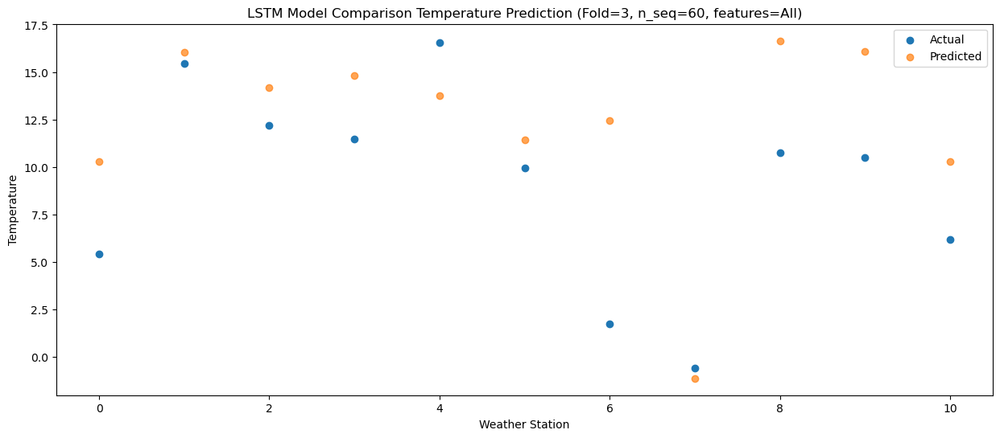

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    9.36  14.500875
1                 1   20.58  20.265057
2                 2   17.58  18.382953
3                 3   14.96  19.013034
4                 4   21.98  17.964974
5                 5   13.87  15.626056
6                 6    7.48  16.673377
7                 7    5.86   3.079569
8                 8   13.88  20.851557
9                 9   14.83  20.295855
10               10   10.18  14.480363


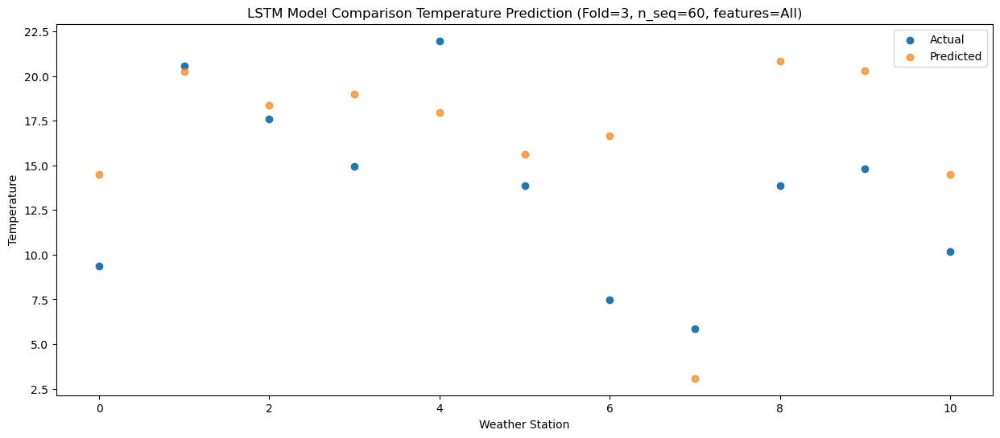

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   10.13  16.598207
1                 1   24.62  22.362864
2                 2   20.15  20.489291
3                 3   16.51  21.113177
4                 4   23.10  20.064815
5                 5   15.86  17.727226
6                 6    9.40  18.777351
7                 7    8.09   5.194364
8                 8   12.23  22.968150
9                 9   19.38  22.411002
10               10   13.96  16.591378


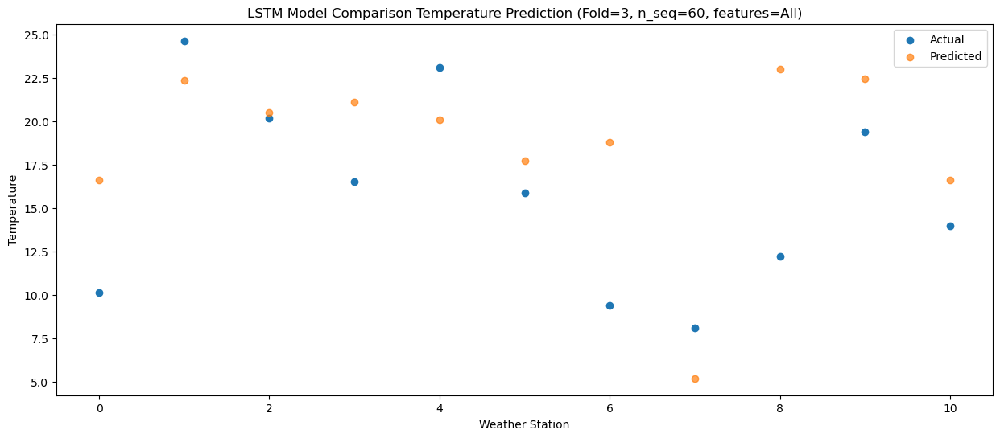

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    9.22  14.629217
1                 1   21.54  20.391264
2                 2   20.33  18.517996
3                 3   15.44  19.138077
4                 4   21.28  18.087438
5                 5   14.21  15.748445
6                 6    8.64  16.801288
7                 7    6.50   3.218219
8                 8   13.65  20.981739
9                 9   19.30  20.424381
10               10   13.09  14.608544


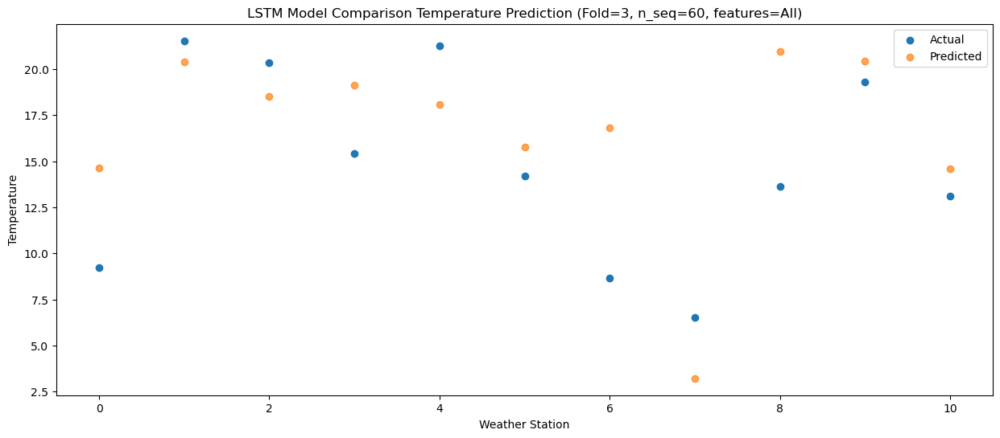

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    6.01  11.131032
1                 1   17.68  16.896812
2                 2   17.51  15.019944
3                 3   11.46  15.643561
4                 4   16.96  14.596885
5                 5   10.26  12.261825
6                 6    6.48  13.307819
7                 7    4.14  -0.282352
8                 8   13.88  17.473467
9                 9   14.39  16.916233
10               10    7.86  11.101006


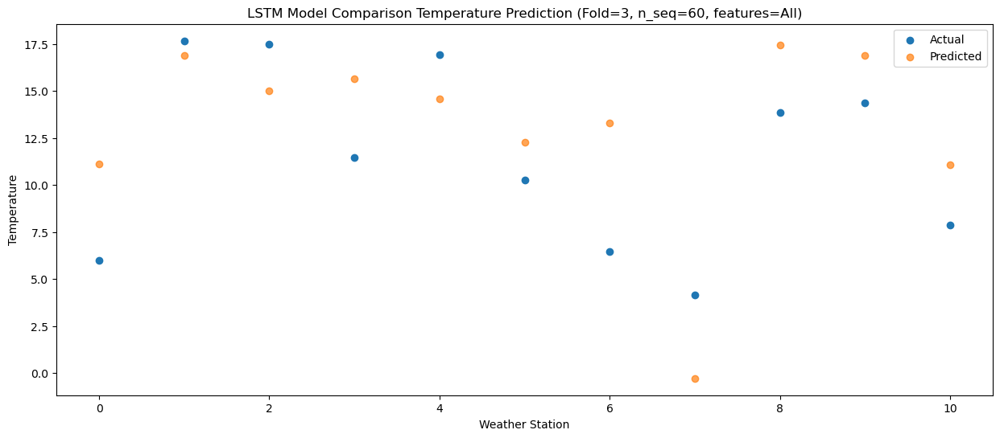

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   -1.00   4.063257
1                 1   11.13   9.835818
2                 2   10.33   7.957443
3                 3    4.19   8.580863
4                 4    9.69   7.541544
5                 5    4.22   5.206353
6                 6   -1.78   6.257238
7                 7   -3.75  -7.332438
8                 8    9.15  10.414461
9                 9    8.13   9.857065
10               10    0.25   4.039217


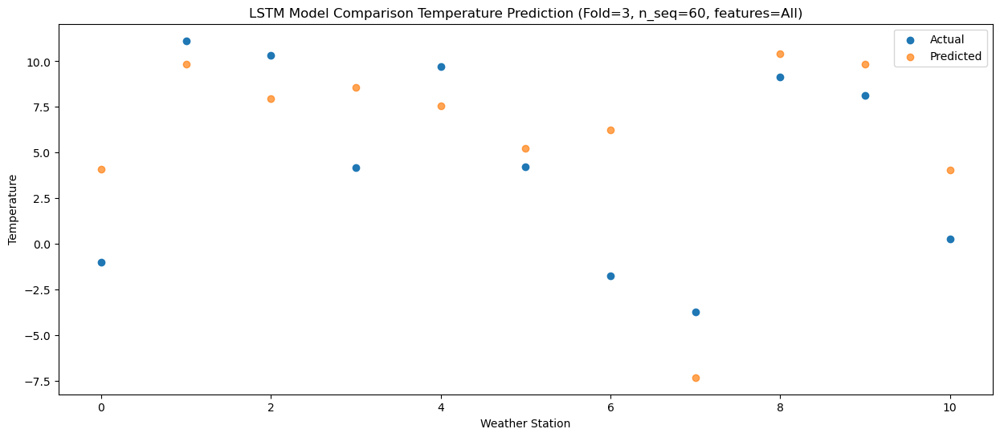

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -3.03  -2.331891
1                 1    3.90   3.439489
2                 2   -0.40   1.554922
3                 3    1.07   2.185166
4                 4    3.80   1.142987
5                 5   -2.33  -1.193414
6                 6   -9.46  -0.146188
7                 7  -15.17 -13.738446
8                 8    3.42   4.004372
9                 9    4.17   3.449042
10               10   -2.87  -2.364033


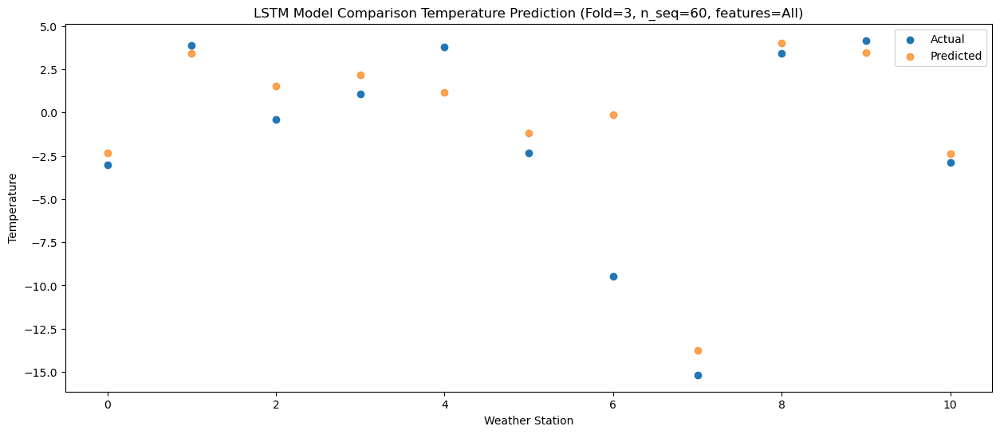

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -9.91  -7.129402
1                 1   -0.15  -1.355491
2                 2   -1.36  -3.233955
3                 3   -4.20  -2.606013
4                 4   -2.17  -3.648543
5                 5   -7.87  -5.987831
6                 6  -11.63  -4.942269
7                 7  -17.50 -18.532636
8                 8    2.22  -0.780685
9                 9   -2.19  -1.340484
10               10   -9.90  -7.158915


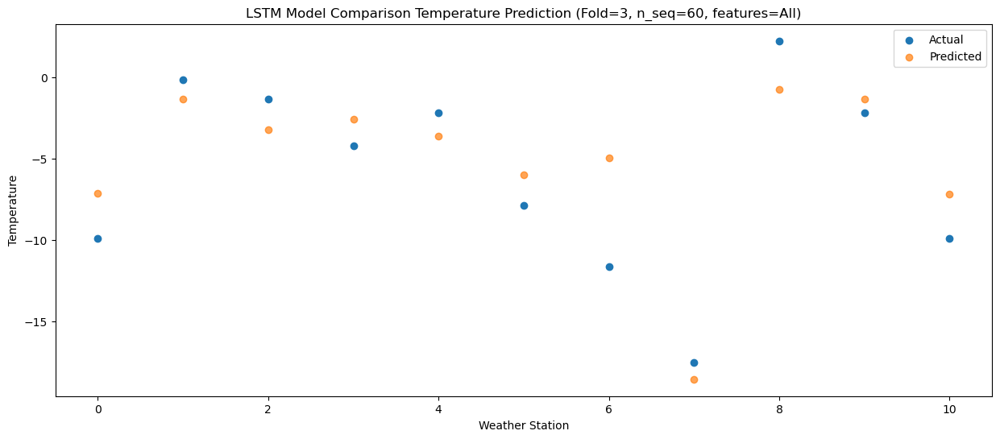

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -6.49  -5.768072
1                 1    0.55   0.011961
2                 2    0.03  -1.863808
3                 3   -2.45  -1.243553
4                 4   -0.45  -2.281193
5                 5   -5.73  -4.629860
6                 6  -12.36  -3.580621
7                 7  -18.01 -17.167104
8                 8    3.89   0.588320
9                 9   -0.21   0.029806
10               10   -7.25  -5.790924


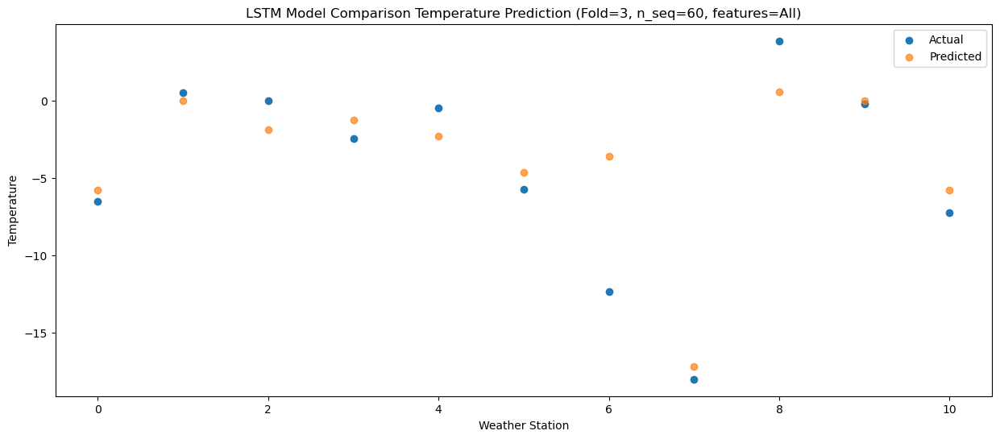

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -3.67  -5.033777
1                 1    2.51   0.733818
2                 2   -0.82  -1.128467
3                 3   -0.11  -0.514174
4                 4    6.07  -1.557285
5                 5   -4.01  -3.907218
6                 6  -12.33  -2.855642
7                 7  -17.10 -16.436524
8                 8    2.09   1.323353
9                 9   -1.94   0.759564
10               10   -7.04  -5.064545


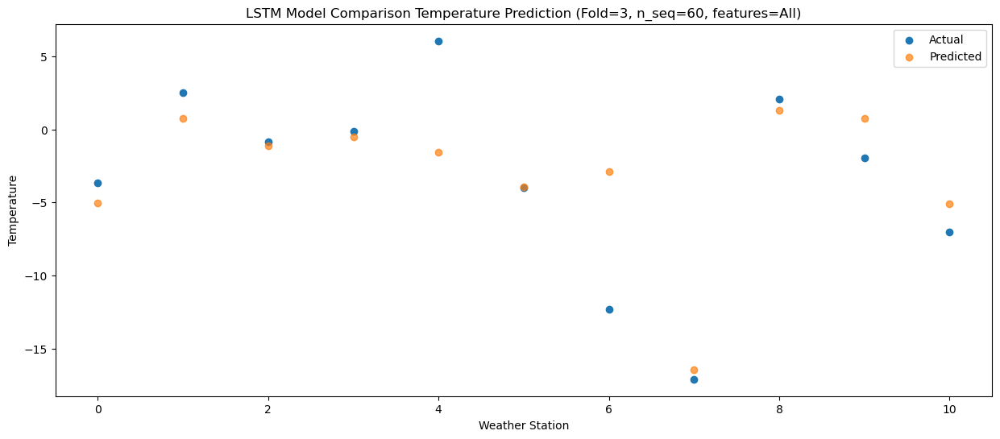

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -3.20  -2.100600
1                 1    5.11   3.672100
2                 2    2.05   1.808254
3                 3    0.13   2.419943
4                 4    3.11   1.383109
5                 5   -3.11  -0.973133
6                 6  -10.54   0.084642
7                 7  -14.27 -13.493897
8                 8    3.55   4.262982
9                 9    0.03   3.701443
10               10   -5.48  -2.125669


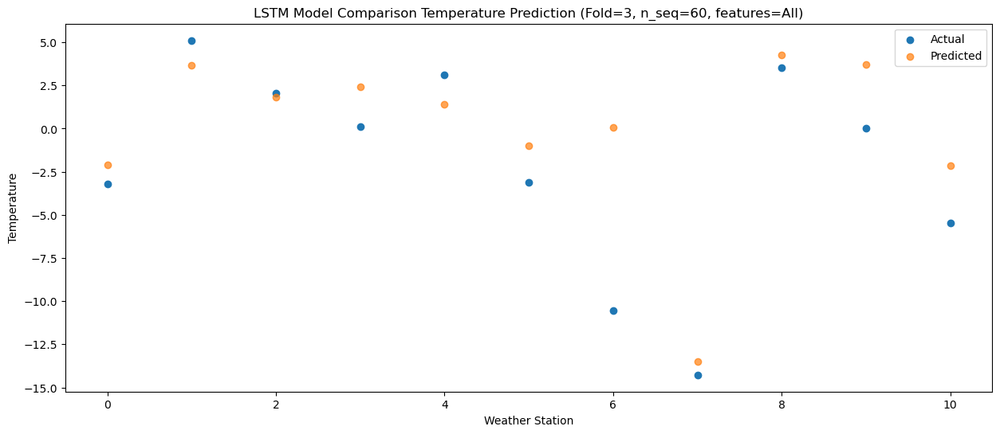

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    0.47   3.369161
1                 1   10.16   9.132664
2                 2    7.68   7.276758
3                 3    6.37   7.886511
4                 4   10.32   6.849352
5                 5    3.12   4.494866
6                 6   -5.20   5.555363
7                 7   -6.32  -8.024991
8                 8    7.63   9.724643
9                 9    6.08   9.169223
10               10    2.09   3.344857


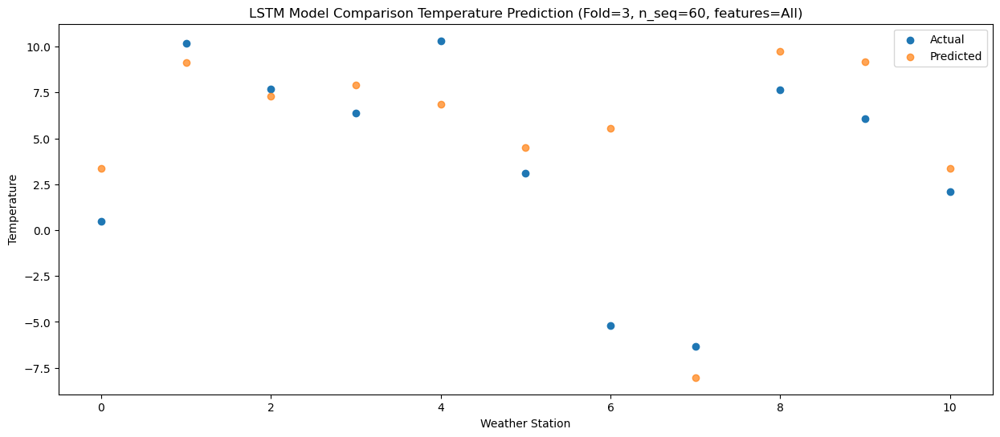

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    2.83   8.934783
1                 1   15.47  14.696182
2                 2   12.12  12.839502
3                 3    9.06  13.453386
4                 4   16.32  12.413868
5                 5    8.53  10.062450
6                 6    2.01  11.122525
7                 7   -0.52  -2.459237
8                 8    8.66  15.289640
9                 9    9.72  14.732287
10               10    4.56   8.905877


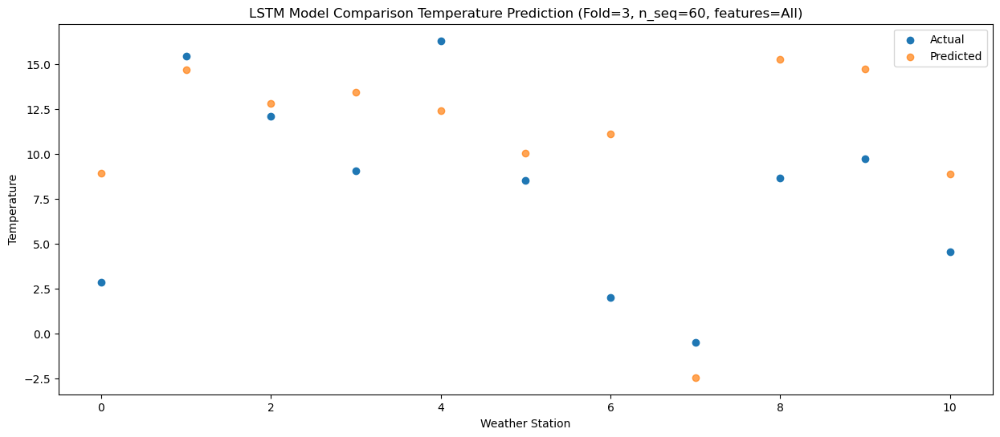

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    6.60  13.342180
1                 1   19.80  19.108665
2                 2   14.92  17.250669
3                 3   12.80  17.869637
4                 4   20.42  16.832989
5                 5   11.99  14.484778
6                 6    6.59  15.542123
7                 7    1.98   1.960912
8                 8   10.56  19.706948
9                 9   13.71  19.152514
10               10    8.49  13.325558


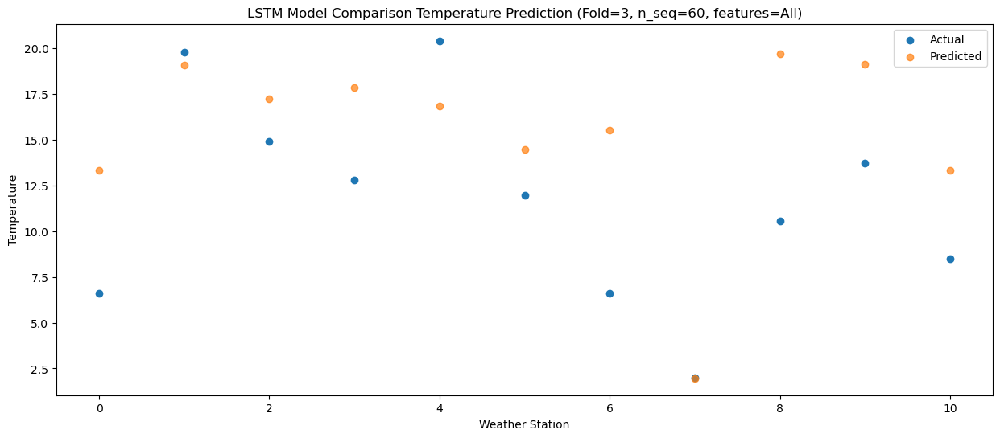

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   10.38  16.164385
1                 1   22.06  21.932944
2                 2   20.58  20.077805
3                 3   16.42  20.698562
4                 4   22.12  19.664443
5                 5   15.25  17.317597
6                 6   12.73  18.370399
7                 7   10.34   4.781744
8                 8   13.57  22.533986
9                 9   19.39  21.980261
10               10   13.33  16.152480


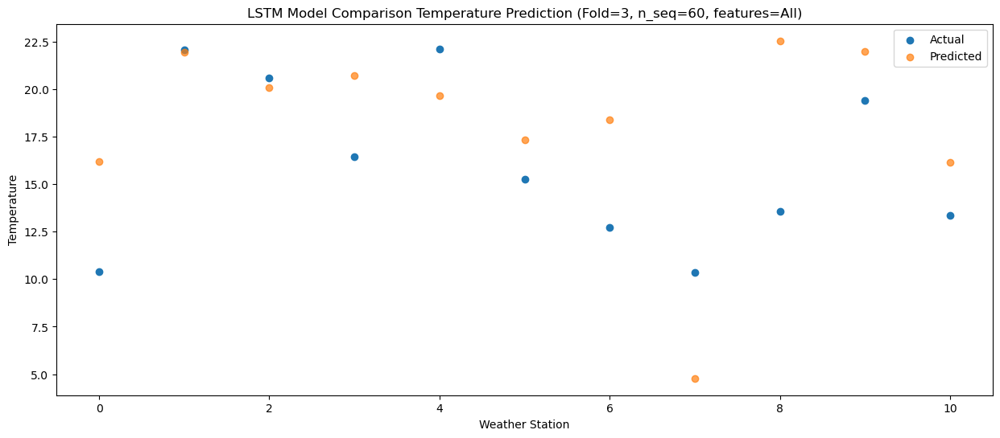

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    9.87  15.764431
1                 1   22.24  21.534351
2                 2   18.89  19.678534
3                 3   15.31  20.300721
4                 4   20.83  19.270982
5                 5   13.70  16.927010
6                 6   10.14  17.969759
7                 7    5.71   4.377786
8                 8   14.60  22.129524
9                 9   17.14  21.573487
10               10   11.36  15.744643


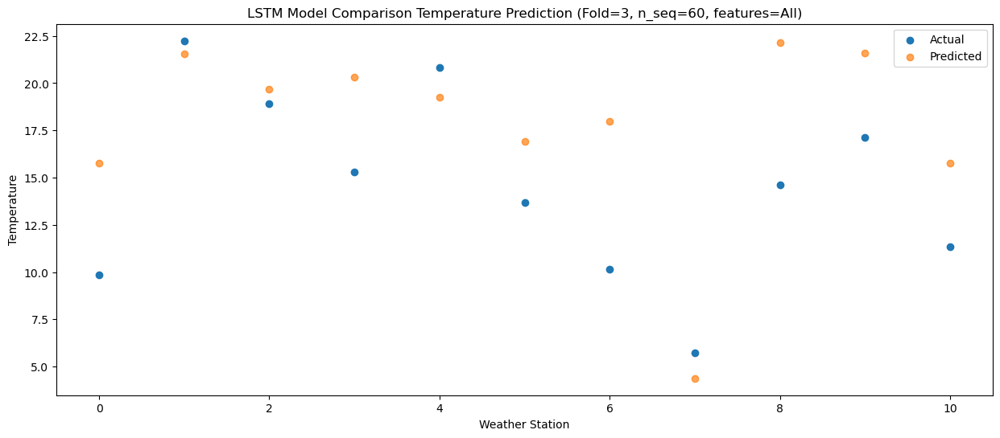

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    5.73  12.568824
1                 1   18.19  18.341358
2                 2   15.12  16.483834
3                 3   12.58  17.106973
4                 4   17.47  16.078117
5                 5   10.24  13.727277
6                 6    5.99  14.772772
7                 7    1.01   1.185744
8                 8   11.99  18.939786
9                 9   14.57  18.388076
10               10    8.07  12.557068


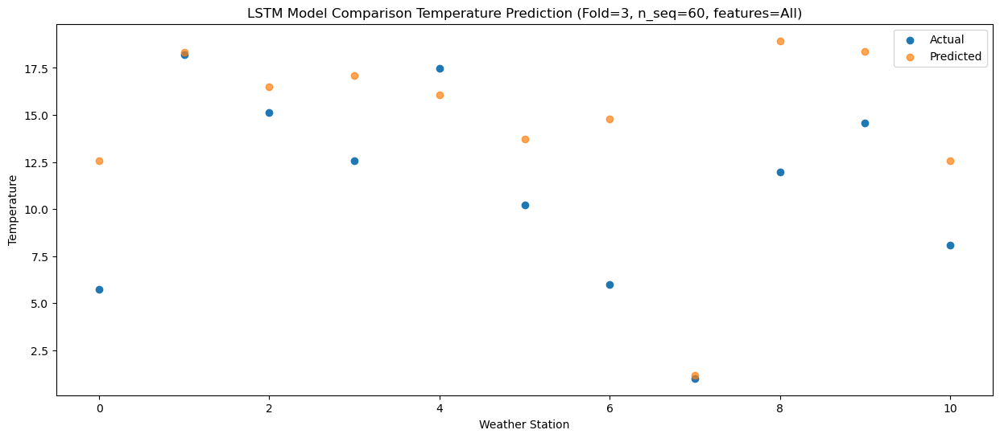

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    0.70   5.580283
1                 1   11.25  11.357370
2                 2    9.81   9.494262
3                 3    7.14  10.122947
4                 4   11.01   9.094803
5                 5    4.59   6.745878
6                 6   -0.14   7.781460
7                 7   -4.28  -5.804904
8                 8   10.53  11.953278
9                 9    9.14  11.392573
10               10    2.78   5.560851


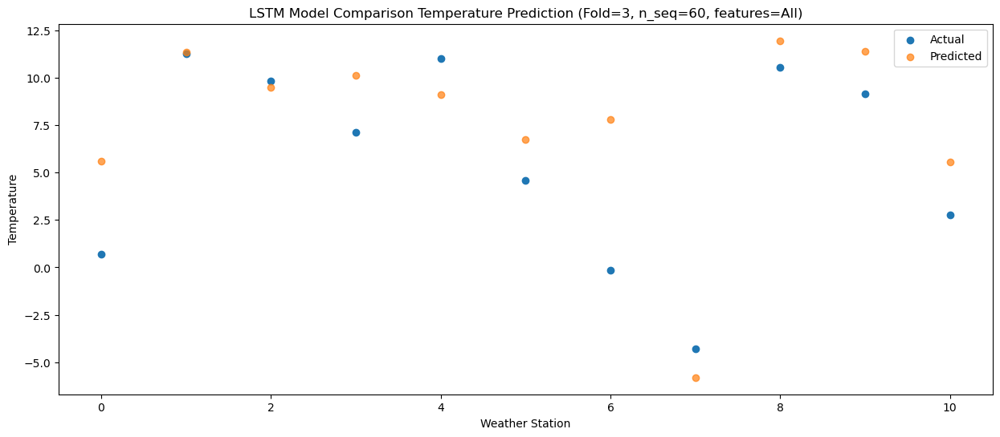

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -4.96  -1.135555
1                 1    5.47   4.641126
2                 2    2.90   2.775680
3                 3    0.75   3.407569
4                 4    4.06   2.383538
5                 5   -1.89   0.037601
6                 6   -6.00   1.072280
7                 7  -12.42 -12.515782
8                 8    6.49   5.232647
9                 9    1.29   4.675398
10               10   -5.49  -1.152614


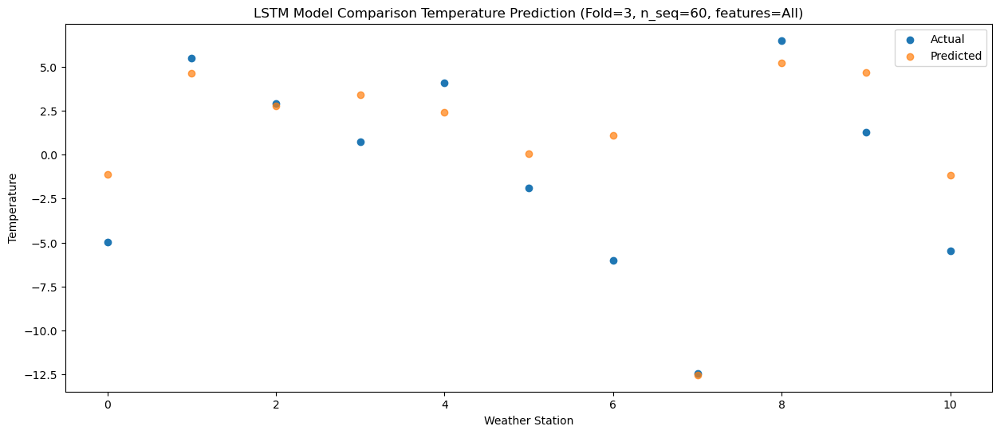

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -7.01  -3.372626
1                 1    2.12   2.407725
2                 2    1.06   0.528638
3                 3   -1.08   1.172957
4                 4    1.25   0.150445
5                 5   -4.35  -2.194803
6                 6   -9.63  -1.165052
7                 7  -15.55 -14.752068
8                 8    4.65   2.990108
9                 9    0.56   2.430022
10               10   -6.24  -3.391638


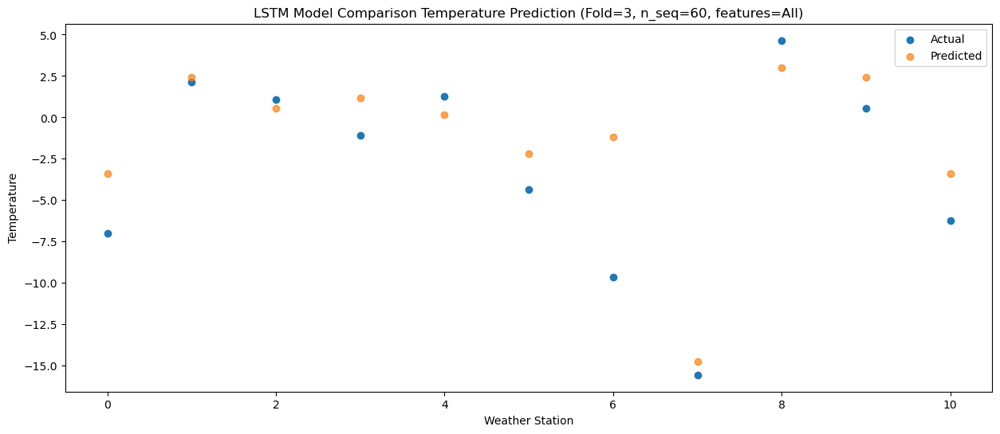

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -9.32  -8.550716
1                 1   -4.49  -2.772996
2                 2    0.85  -4.650123
3                 3   -6.24  -4.013209
4                 4   -5.25  -5.036428
5                 5  -10.51  -7.379166
6                 6  -11.77  -6.347848
7                 7  -17.27 -19.930922
8                 8    4.96  -2.195349
9                 9   -3.43  -2.754488
10               10   -9.26  -8.574363


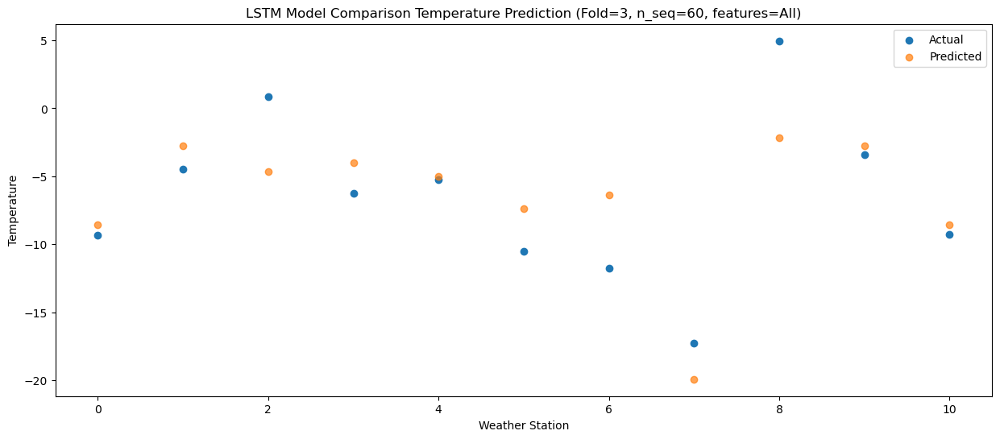

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -6.18  -2.590906
1                 1    5.16   3.192444
2                 2    2.34   1.309922
3                 3   -0.56   1.950911
4                 4    2.56   0.928343
5                 5   -3.88  -1.412626
6                 6   -9.61  -0.383752
7                 7  -14.91 -13.974840
8                 8    4.67   3.751871
9                 9   -2.86   3.197490
10               10   -7.22  -2.615945


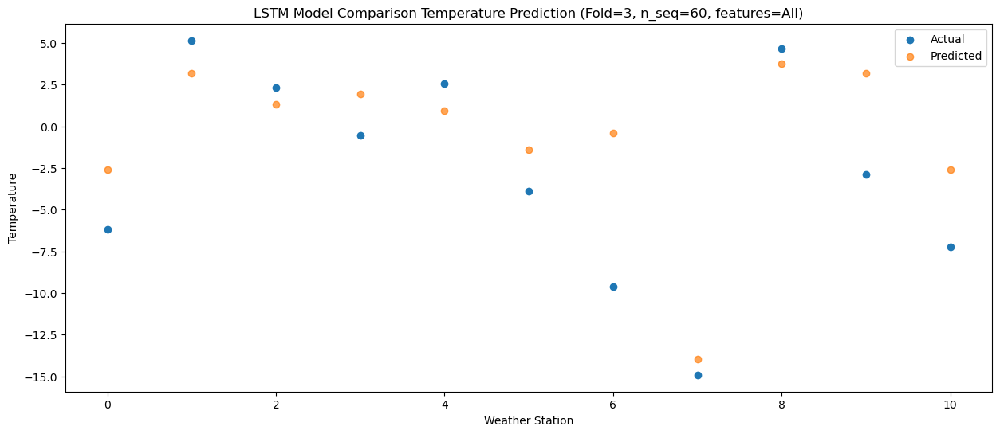

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -2.51   0.652379
1                 1    7.64   6.434599
2                 2    4.37   4.553047
3                 3    3.09   5.193374
4                 4    6.67   4.175344
5                 5    0.19   1.835938
6                 6   -7.87   2.861783
7                 7  -11.55 -10.733192
8                 8    5.60   6.992622
9                 9    1.84   6.445544
10               10   -2.56   0.635478


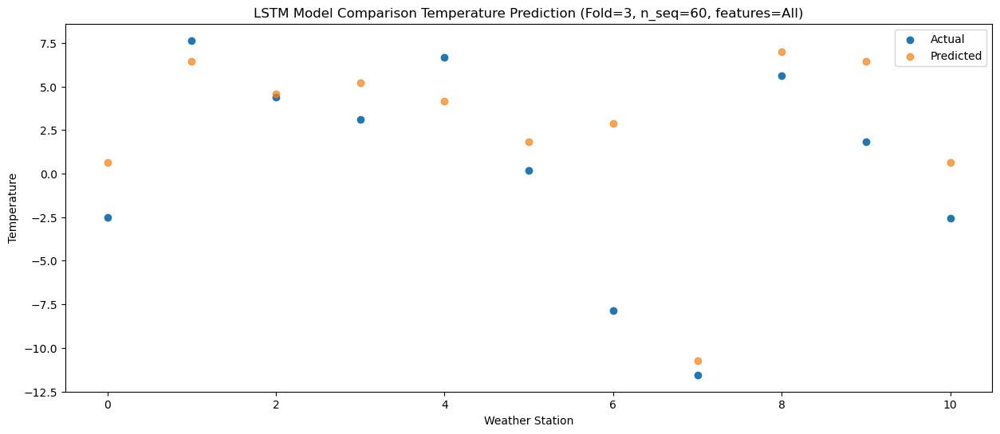

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    1.51   5.463481
1                 1   11.81  11.240960
2                 2    7.56   9.362931
3                 3    8.15  10.000560
4                 4   11.42   8.983459
5                 5    5.16   6.642920
6                 6   -2.89   7.666376
7                 7   -6.05  -5.926093
8                 8    7.83  11.799748
9                 9    4.71  11.255970
10               10    2.02   5.450275


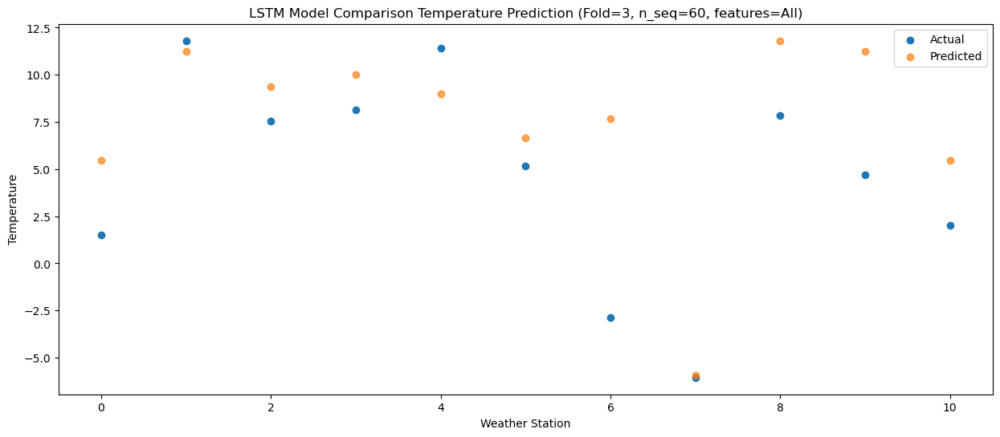

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    5.78  11.199667
1                 1   16.58  16.979730
2                 2   12.95  15.098937
3                 3   12.34  15.738826
4                 4   17.58  14.720402
5                 5   10.68  12.376849
6                 6    0.22  13.395775
7                 7   -0.42  -0.196696
8                 8   10.80  17.531219
9                 9   10.26  16.988733
10               10    7.69  11.183694


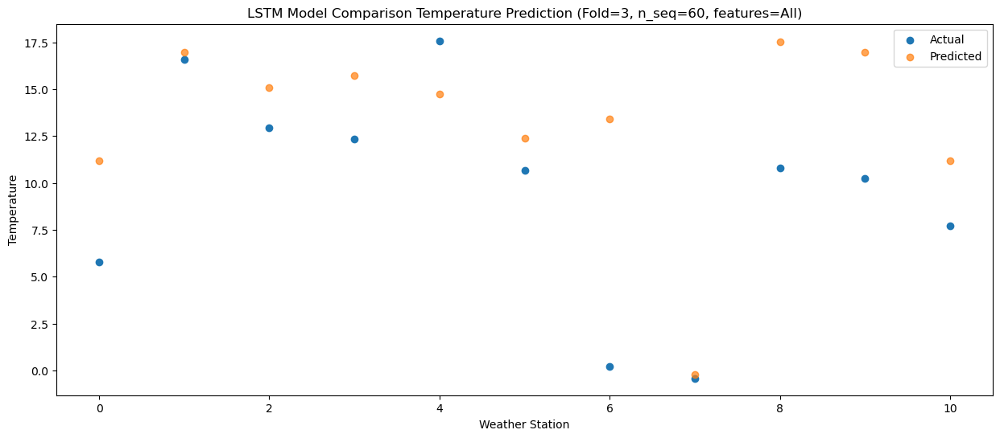

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    9.44  15.298590
1                 1   21.14  21.083423
2                 2   18.90  19.200649
3                 3   16.24  19.841109
4                 4   22.45  18.824593
5                 5   13.91  16.482952
6                 6    9.37  17.503891
7                 7    7.76   3.912741
8                 8   13.71  21.628350
9                 9   16.73  21.086327
10               10   13.06  15.286567


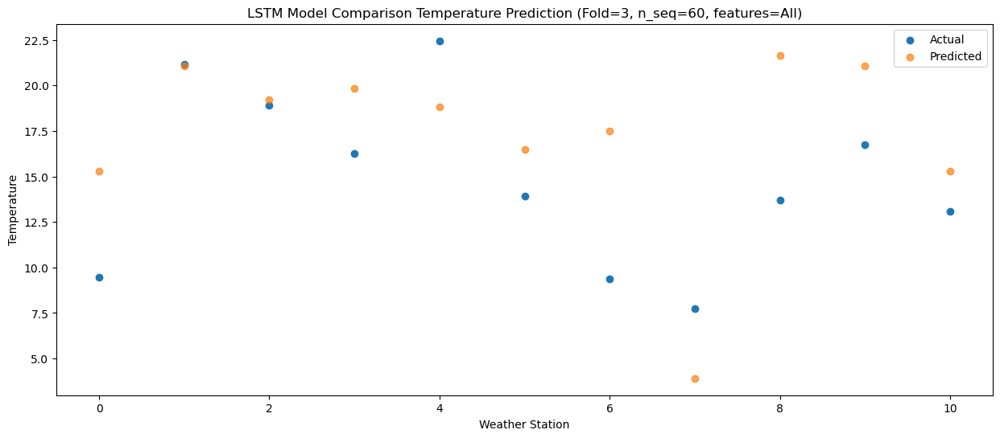

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   10.33  15.704519
1                 1   21.66  21.490086
2                 2   22.47  19.604994
3                 3   17.95  20.244964
4                 4   21.61  19.230297
5                 5   14.46  16.887947
6                 6   10.12  17.909193
7                 7   10.84   4.316164
8                 8   14.97  22.027864
9                 9   19.29  21.488571
10               10   15.72  15.688419


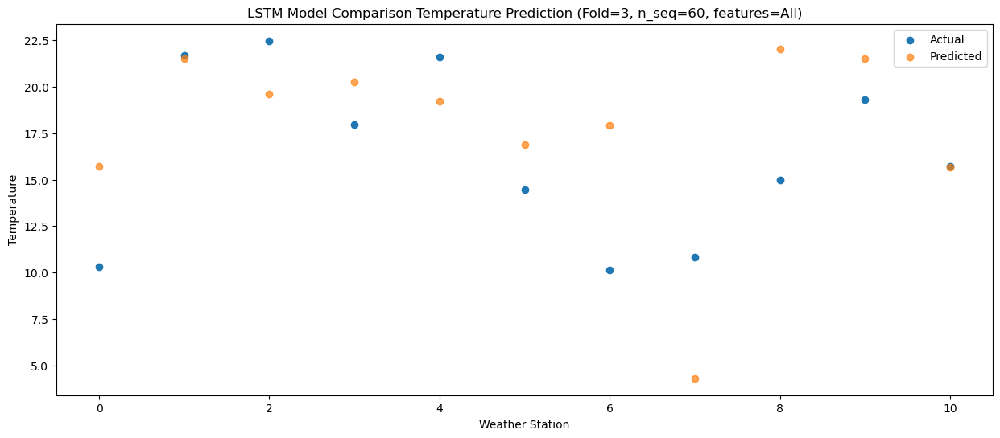

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    8.93  16.052747
1                 1   21.94  21.835123
2                 2   19.50  19.948684
3                 3   16.93  20.595661
4                 4   21.06  19.579655
5                 5   13.91  17.240582
6                 6    9.83  18.260892
7                 7    7.98   4.662434
8                 8   13.69  22.373053
9                 9   17.57  21.834899
10               10   12.58  16.031760


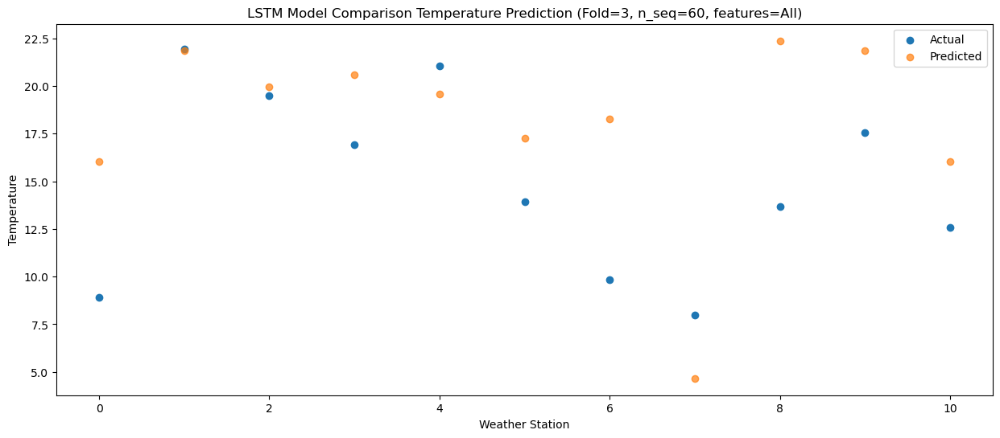

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    6.24  12.681139
1                 1   17.90  18.459834
2                 2   16.47  16.569133
3                 3   13.96  17.215090
4                 4   17.80  16.200022
5                 5   11.22  13.853045
6                 6    6.21  14.872905
7                 7    4.03   1.271615
8                 8   12.25  18.983728
9                 9   13.56  18.443411
10               10    8.99  12.642350


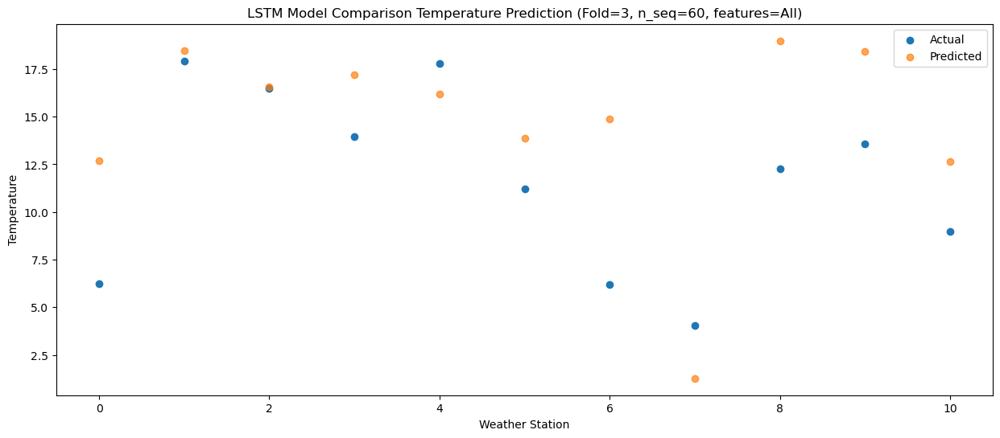

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    0.93   7.725336
1                 1   14.51  13.513557
2                 2   11.44  11.622162
3                 3    7.46  12.265984
4                 4   12.17  11.251492
5                 5    5.34   8.903625
6                 6    1.98   9.928089
7                 7   -1.86  -3.670223
8                 8   11.79  14.040886
9                 9    9.03  13.489997
10               10    3.75   7.686079


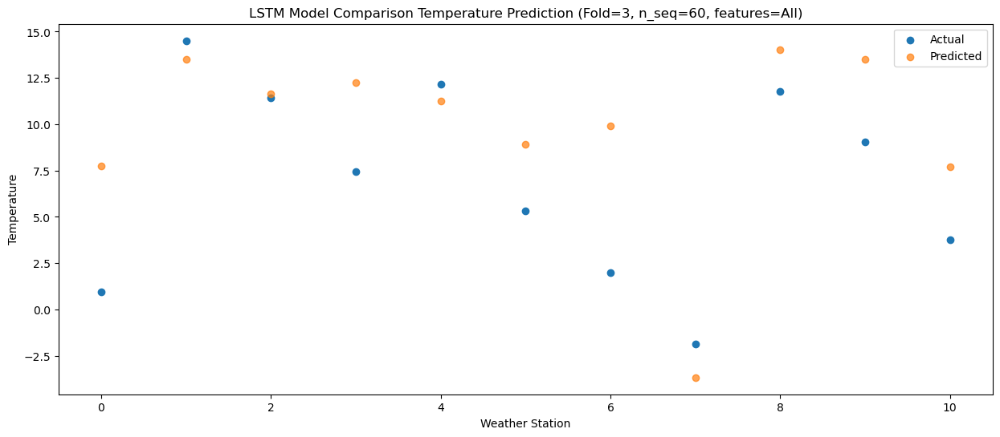

f, t:
[[-6.460e+00  2.220e+00  2.710e+00 -2.860e+00  3.310e+00 -5.820e+00
  -6.460e+00 -1.316e+01  5.280e+00  6.300e-01 -6.460e+00]
 [-7.240e+00  8.700e-01  1.800e-01 -2.850e+00  5.000e-02 -5.610e+00
  -1.213e+01 -1.789e+01  4.030e+00 -2.130e+00 -9.420e+00]
 [-7.660e+00  3.000e-02 -1.040e+00 -3.400e+00 -2.820e+00 -7.030e+00
  -1.222e+01 -1.673e+01  3.400e+00 -2.100e+00 -9.010e+00]
 [-6.650e+00  1.800e-01  1.380e+00 -3.750e+00 -1.670e+00 -7.440e+00
  -1.203e+01 -1.522e+01  5.420e+00 -1.660e+00 -8.090e+00]
 [-1.390e+00  7.670e+00  3.170e+00  3.160e+00  5.740e+00 -5.800e-01
  -7.100e+00 -1.211e+01  4.860e+00  1.920e+00 -3.680e+00]
 [-3.200e-01  8.590e+00  7.830e+00  3.800e+00  8.770e+00  1.690e+00
  -4.120e+00 -6.200e+00  8.480e+00  3.360e+00 -1.740e+00]
 [ 2.370e+00  1.299e+01  1.302e+01  8.370e+00  1.484e+01  7.100e+00
   2.990e+00  1.070e+00  1.088e+01  8.920e+00  4.030e+00]
 [ 7.690e+00  2.009e+01  1.637e+01  1.419e+01  2.189e+01  1.409e+01
   7.200e+00  4.530e+00  1.342e+01  1.590e+0

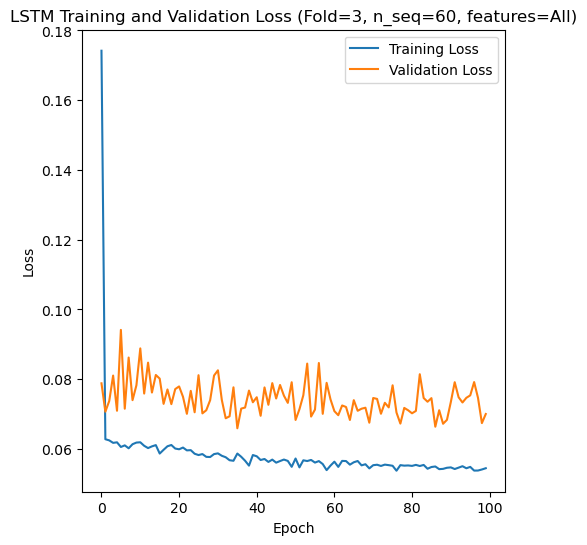

[[ 4.89  1.26  7.78 ... 22.59 18.46  9.82]
 [15.38 13.87 17.63 ... 26.66 22.89 20.2 ]
 [11.49  8.39 14.48 ... 24.97 20.83 17.82]
 ...
 [ 7.64  3.61 10.44 ... 21.3  17.62 11.34]
 [ 4.26  0.29  5.21 ... 21.47 15.54  9.34]
 [ 3.62 -0.32  6.05 ... 19.99 14.92  8.29]]
Epoch 1/100
84/84 [==============================] - 50s 280ms/step - loss: 0.2157 - accuracy: 0.2381 - mae: 0.1766 - rmse: 0.2157 - mape: inf - pearson: 0.5847 - val_loss: 0.0750 - val_accuracy: 0.0000e+00 - val_mae: 0.0593 - val_rmse: 0.0750 - val_mape: 14.2911 - val_pearson: 0.8363
Epoch 2/100
84/84 [==============================] - 14s 165ms/step - loss: 0.0608 - accuracy: 0.4167 - mae: 0.0481 - rmse: 0.0608 - mape: inf - pearson: 0.8236 - val_loss: 0.0601 - val_accuracy: 0.6000 - val_mae: 0.0481 - val_rmse: 0.0601 - val_mape: 11.2765 - val_pearson: 0.8607
Epoch 3/100
84/84 [==============================] - 14s 162ms/step - loss: 0.0617 - accuracy: 0.4643 - mae: 0.0483 - rmse: 0.0617 - mape: inf - pearson: 0.8266 - val_l

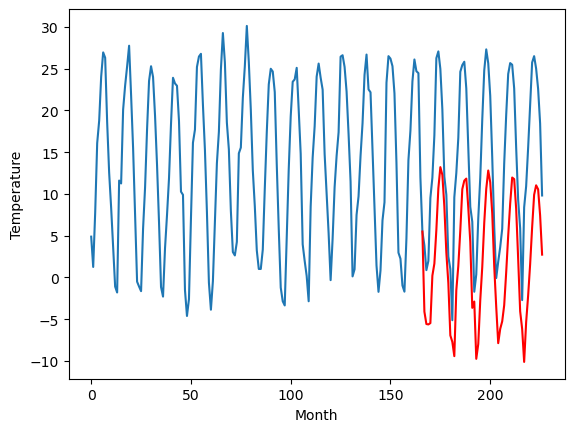

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.38		-2.82		-0.44
-2.56		-4.31		-1.75
-4.02		-4.36		-0.34
-2.47		-4.20		-1.73
1.60		1.48		-0.12
3.28		2.92		-0.36
4.68		6.97		2.29
6.44		11.92		5.48
6.76		14.45		7.69
6.61		13.53		6.92
6.03		9.74		3.71
4.53		4.21		-0.32
1.14		0.56		-0.58
-6.61		-5.72		0.89
-5.91		-6.48		-0.57
-2.48		-8.19		-5.71
-0.88		-0.30		0.58
0.56		2.59		2.03
4.60		6.84		2.24
6.23		11.77		5.54
6.60		12.79		6.19
6.88		13.04		6.16
5.59		9.56		3.97
3.75		5.45		1.70
-3.41		-2.46		0.95
-1.61		-1.71		-0.10
-6.37		-8.57		-2.20
-2.94		-6.80		-3.86
-0.12		-1.56		-1.44
2.22		2.42		0.20
5.04		7.71		2.67
6.76		11.75		4.99
7.13		13.96		6.83
7.08		12.54		5.46
5.64		8.85		3.21
1.81		2.50		0.69
0.35		-2.34		-2.69
-4.50		-6.72		-2.22
-4.65		-5.01		-0.36
-1.35		-4.11		-2.76
0.37		-2.19		-2.56
3.09		1.74		-1.35
3.87		6.10		2.23
6.08		9.94		3.86
7.69		13.07		5.38
8.20		12.88		4.68
6.10		9.30		3.20
2.45		3.32		0.87
-1.26		-2.95		-1.69
-3.3

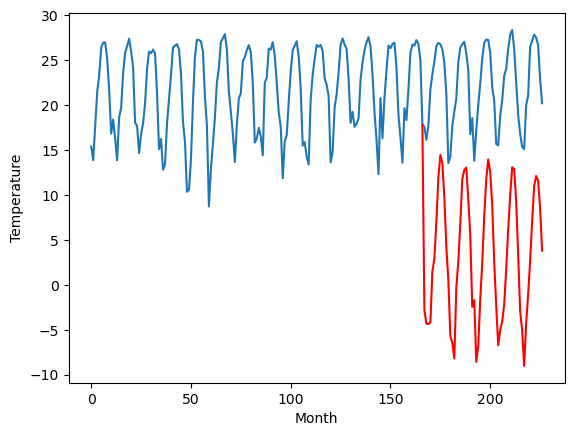

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.75		7.68		0.93
6.81		6.19		-0.62
6.62		6.14		-0.48
6.88		6.30		-0.58
14.68		11.98		-2.70
13.73		13.43		-0.30
17.61		17.47		-0.14
21.70		22.43		0.73
23.27		24.95		1.68
22.44		24.03		1.59
20.34		20.25		-0.09
15.00		14.72		-0.28
11.00		11.08		0.08
4.75		4.80		0.05
4.78		4.04		-0.74
2.86		2.32		-0.54
12.19		10.22		-1.97
13.26		13.11		-0.15
17.73		17.36		-0.37
21.99		22.29		0.30
22.65		23.31		0.66
23.30		23.55		0.25
20.18		20.08		-0.10
16.79		15.98		-0.81
8.12		8.07		-0.05
11.63		8.83		-2.80
3.35		1.96		-1.39
5.71		3.73		-1.98
10.45		8.97		-1.48
14.66		12.95		-1.71
20.46		18.24		-2.22
23.75		22.29		-1.46
23.95		24.50		0.55
22.41		23.08		0.67
20.34		19.38		-0.96
14.21		13.03		-1.18
9.62		8.19		-1.43
7.19		3.83		-3.36
7.60		5.53		-2.07
9.54		6.44		-3.10
11.69		8.36		-3.33
13.44		12.29		-1.15
18.30		16.66		-1.64
21.89		20.50		-1.39
23.67		23.64		-0.03
25.75		23.45		-2.30
22.00		19.87		-2.13
15.89		

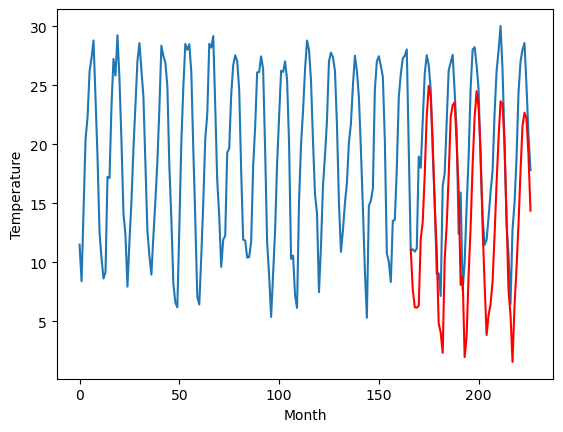

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.23		3.78		-0.45
2.58		2.30		-0.28
2.82		2.26		-0.56
2.49		2.41		-0.08
9.95		8.09		-1.86
10.61		9.54		-1.07
15.74		13.59		-2.15
20.70		18.54		-2.16
22.56		21.07		-1.49
22.31		20.15		-2.16
16.53		16.37		-0.16
10.80		10.84		0.04
8.19		7.20		-0.99
1.91		0.92		-0.99
0.99		0.15		-0.84
-2.47		-1.57		0.90
8.49		6.33		-2.16
10.18		9.22		-0.96
14.34		13.47		-0.87
20.02		18.42		-1.60
21.61		19.43		-2.18
21.98		19.67		-2.31
19.19		16.20		-2.99
14.54		12.10		-2.44
6.54		4.20		-2.34
8.54		4.96		-3.58
0.07		-1.91		-1.98
0.33		-0.13		-0.46
6.51		5.11		-1.40
12.56		9.09		-3.47
17.27		14.38		-2.89
21.82		18.43		-3.39
25.12		20.64		-4.48
22.39		19.21		-3.18
18.96		15.52		-3.44
12.09		9.16		-2.93
5.04		4.32		-0.72
2.35		-0.04		-2.39
3.34		1.66		-1.68
3.40		2.57		-0.83
7.93		4.50		-3.43
10.53		8.43		-2.10
16.21		12.81		-3.40
20.40		16.65		-3.75
22.95		19.78		-3.17
25.50		19.59		-5.91
20.80		16.01		-4.79
12.67		

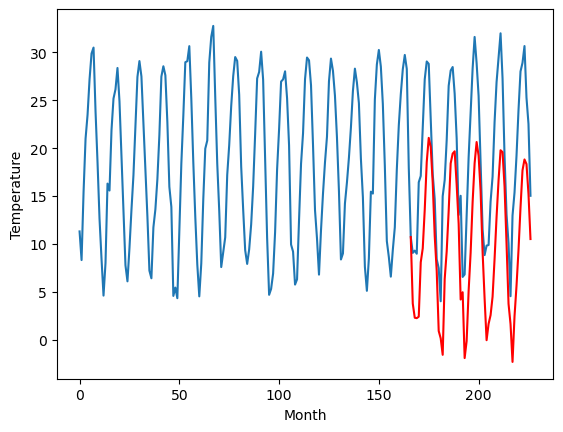

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.65		3.60		-0.05
1.87		2.12		0.25
2.49		2.07		-0.42
2.11		2.23		0.12
9.99		7.91		-2.08
10.68		9.36		-1.32
16.33		13.40		-2.93
21.04		18.36		-2.68
23.48		20.90		-2.58
22.80		19.96		-2.84
16.50		16.18		-0.32
10.75		10.66		-0.09
7.99		7.02		-0.97
1.42		0.74		-0.68
0.82		-0.03		-0.85
-3.07		-1.75		1.32
7.85		6.15		-1.70
10.03		9.04		-0.99
13.56		13.29		-0.27
20.41		18.24		-2.17
21.90		19.26		-2.64
22.27		19.49		-2.78
18.84		16.02		-2.82
13.97		11.93		-2.04
6.13		4.03		-2.10
7.87		4.79		-3.08
-1.03		-2.08		-1.05
-0.41		-0.30		0.11
6.51		4.94		-1.57
13.20		8.92		-4.28
18.03		14.22		-3.81
22.70		18.26		-4.44
26.12		20.47		-5.65
23.28		19.04		-4.24
19.19		15.35		-3.84
12.04		8.99		-3.05
4.95		4.15		-0.80
1.98		-0.21		-2.19
2.75		1.49		-1.26
2.98		2.40		-0.58
7.83		4.32		-3.51
10.48		8.26		-2.22
16.64		12.64		-4.00
21.75		16.48		-5.27
24.83		19.61		-5.22
26.70		19.42		-7.28
21.61		15.84		-5.77
12.78	

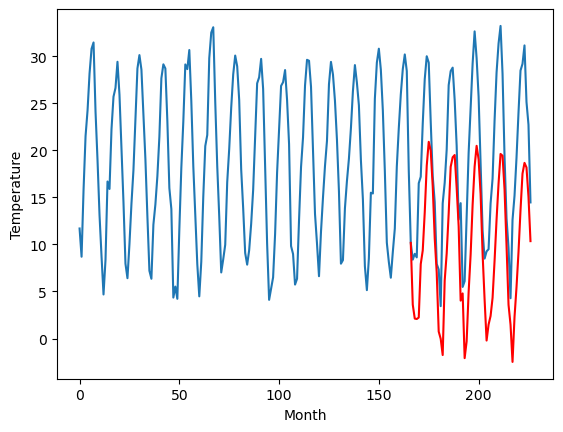

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.12		3.98		-1.14
3.48		2.50		-0.98
2.75		2.45		-0.30
1.99		2.61		0.62
9.55		8.29		-1.26
12.52		9.73		-2.79
19.09		13.78		-5.31
22.42		18.73		-3.69
25.25		21.27		-3.98
24.63		20.34		-4.29
16.90		16.56		-0.34
12.94		11.04		-1.90
9.06		7.40		-1.66
2.08		1.12		-0.96
0.98		0.35		-0.63
-0.59		-1.37		-0.78
8.66		6.54		-2.12
10.89		9.41		-1.48
16.38		13.68		-2.70
21.34		18.63		-2.71
21.08		19.64		-1.44
21.40		19.87		-1.53
20.71		16.40		-4.31
15.01		12.30		-2.71
8.07		4.40		-3.67
8.48		5.17		-3.31
1.11		-1.70		-2.81
0.91		0.08		-0.83
8.23		5.33		-2.90
15.74		9.31		-6.43
21.43		14.60		-6.83
23.80		18.65		-5.15
25.70		20.86		-4.84
22.40		19.42		-2.98
19.50		15.73		-3.77
12.69		9.38		-3.31
4.84		4.53		-0.31
3.24		0.17		-3.07
3.61		1.87		-1.74
3.78		2.78		-1.00
8.85		4.71		-4.14
13.07		8.64		-4.43
17.99		13.03		-4.96
24.47		16.87		-7.60
25.93		19.99		-5.94
26.02		19.80		-6.22
22.54		16.23		-6.31
14.01		1

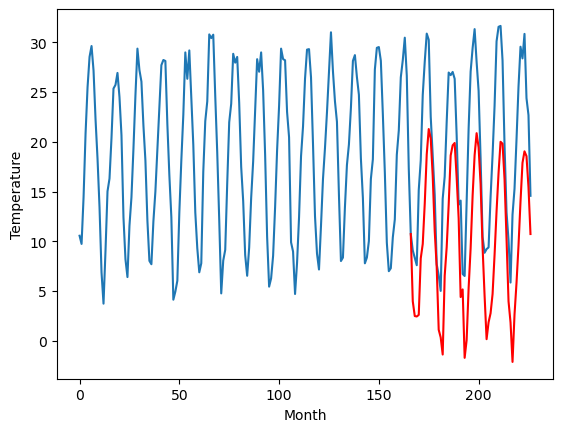

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.86		2.85		1.99
0.51		1.36		0.85
0.34		1.31		0.97
0.81		1.47		0.66
6.42		7.15		0.73
7.69		8.59		0.90
10.48		12.64		2.16
15.07		17.59		2.52
18.11		20.12		2.01
16.91		19.19		2.28
13.11		15.40		2.29
9.29		9.88		0.59
4.98		6.24		1.26
-2.27		-0.04		2.23
-2.04		-0.81		1.23
-1.37		-2.53		-1.16
5.03		5.37		0.34
7.76		8.25		0.49
11.21		12.50		1.29
15.23		17.45		2.22
16.97		18.46		1.49
17.10		18.70		1.60
13.13		15.22		2.09
9.33		11.13		1.80
1.17		3.22		2.05
3.08		3.98		0.90
-2.98		-2.89		0.09
1.30		-1.11		-2.41
4.86		4.13		-0.73
7.52		8.11		0.59
13.50		13.40		-0.10
16.71		17.45		0.74
17.98		19.66		1.68
16.46		18.23		1.77
13.37		14.53		1.16
6.50		8.18		1.68
3.80		3.33		-0.47
-2.15		-1.03		1.12
0.87		0.67		-0.20
4.29		1.58		-2.71
4.77		3.50		-1.27
7.88		7.43		-0.45
10.50		11.80		1.30
14.14		15.64		1.50
18.01		18.78		0.77
17.45		18.58		1.13
13.61		15.01		1.40
8.17		9.01		0.84
2.44		2.75		0.31
0.23		0.63	

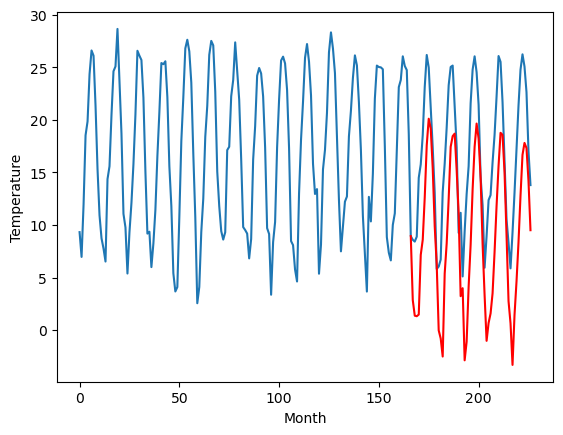

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.01		1.61		-0.40
1.20		0.13		-1.07
-0.45		0.08		0.53
0.12		0.24		0.12
7.05		5.91		-1.14
8.63		7.36		-1.27
12.73		11.40		-1.33
19.08		16.36		-2.72
21.62		18.90		-2.72
19.63		17.97		-1.66
16.05		14.18		-1.87
9.12		8.66		-0.46
6.57		5.01		-1.56
0.04		-1.27		-1.31
-1.63		-2.04		-0.41
-5.24		-3.76		1.48
7.03		4.15		-2.88
8.93		7.03		-1.90
12.97		11.28		-1.69
19.27		16.23		-3.04
20.56		17.23		-3.33
21.08		17.47		-3.61
18.04		13.99		-4.05
12.27		9.90		-2.37
4.33		2.00		-2.33
5.79		2.76		-3.03
-3.28		-4.11		-0.83
-1.22		-2.34		-1.12
5.44		2.90		-2.54
9.30		6.88		-2.42
14.97		12.18		-2.79
20.29		16.23		-4.06
23.99		18.44		-5.55
20.47		17.01		-3.46
16.88		13.32		-3.56
10.51		6.95		-3.56
3.96		2.11		-1.85
-0.89		-2.26		-1.37
0.76		-0.55		-1.31
2.90		0.36		-2.54
4.62		2.29		-2.33
10.24		6.22		-4.02
15.02		10.60		-4.42
19.10		14.44		-4.66
21.06		17.57		-3.49
20.87		17.38		-3.49
16.93		13.80		-3.13
11.03	

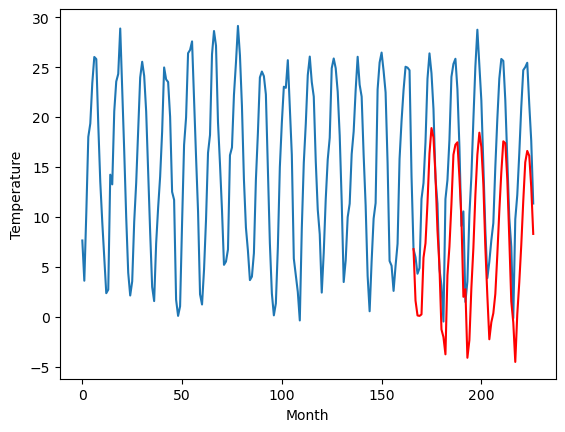

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.64		-0.07		2.57
-3.46		-1.55		1.91
-4.39		-1.60		2.79
-5.22		-1.44		3.78
1.60		4.24		2.64
4.59		5.68		1.09
10.17		9.73		-0.44
17.46		14.68		-2.78
19.50		17.22		-2.28
17.30		16.29		-1.01
13.54		12.50		-1.04
6.70		6.98		0.28
2.86		3.33		0.47
-4.65		-2.94		1.71
-6.23		-3.71		2.52
-9.59		-5.44		4.15
2.38		2.47		0.09
6.03		5.36		-0.67
10.44		9.61		-0.83
17.68		14.56		-3.12
18.25		15.57		-2.68
19.11		15.81		-3.30
15.62		12.33		-3.29
10.27		8.25		-2.02
-0.59		0.34		0.93
-0.27		1.10		1.37
-9.11		-5.77		3.34
-6.09		-4.00		2.09
1.38		1.24		-0.14
5.16		5.22		0.06
13.66		10.52		-3.14
18.14		14.57		-3.57
20.08		16.78		-3.30
17.85		15.35		-2.50
13.94		11.65		-2.29
6.45		5.29		-1.16
0.66		0.45		-0.21
-5.12		-3.91		1.21
-3.16		-2.21		0.95
-1.57		-1.30		0.27
-0.30		0.63		0.93
6.20		4.56		-1.64
11.91		8.94		-2.97
15.79		12.78		-3.01
18.52		15.91		-2.61
17.36		15.72		-1.64
14.27		12.14		-2.13
8.13		6.15		-1.

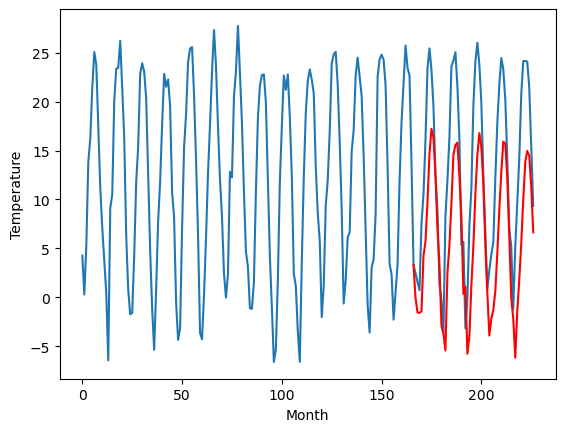

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.88		-3.45		1.43
-5.20		-4.93		0.27
-7.64		-4.98		2.66
-7.89		-4.82		3.07
-0.29		0.85		1.14
2.82		2.30		-0.52
8.70		6.35		-2.35
16.43		11.31		-5.12
17.64		13.85		-3.79
15.04		12.92		-2.12
11.14		9.14		-2.00
3.80		3.61		-0.19
1.16		-0.04		-1.20
-6.72		-6.31		0.41
-8.75		-7.09		1.66
-13.19		-8.82		4.37
0.67		-0.90		-1.57
4.38		1.99		-2.39
9.16		6.24		-2.92
16.55		11.19		-5.36
16.26		12.20		-4.06
16.54		12.44		-4.10
13.43		8.97		-4.46
7.97		4.87		-3.10
-2.34		-3.02		-0.68
-2.59		-2.27		0.32
-12.07		-9.14		2.93
-9.24		-7.37		1.87
-1.03		-2.12		-1.09
3.09		1.86		-1.23
11.62		7.16		-4.46
16.23		11.21		-5.02
17.05		13.42		-3.63
15.75		11.98		-3.77
11.61		8.30		-3.31
4.14		1.93		-2.21
-1.40		-2.92		-1.52
-8.13		-7.28		0.85
-5.89		-5.57		0.32
-4.70		-4.66		0.04
-2.16		-2.73		-0.57
5.17		1.22		-3.95
10.93		5.60		-5.33
15.24		9.44		-5.80
16.77		12.56		-4.21
15.51		12.38		-3.13
12.47		8.80		-3.67
6.06

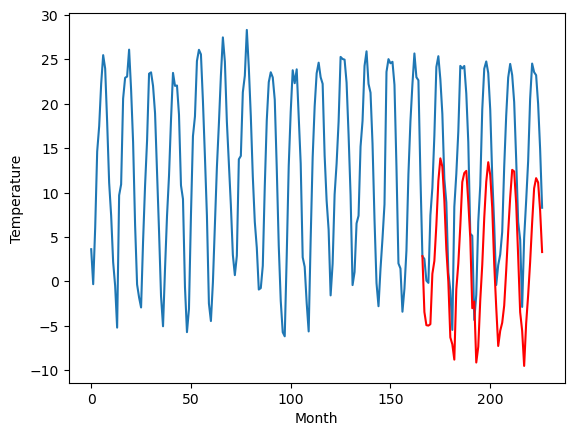

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.79		-4.09		2.70
-7.57		-5.57		2.00
-8.77		-5.63		3.14
-9.58		-5.47		4.11
-3.42		0.21		3.63
-2.04		1.65		3.69
4.70		5.70		1.00
11.19		10.66		-0.53
14.63		13.20		-1.43
12.22		12.27		0.05
8.23		8.48		0.25
2.07		2.96		0.89
-1.16		-0.69		0.47
-8.72		-6.96		1.76
-10.64		-7.73		2.91
-12.88		-9.46		3.42
-2.99		-1.55		1.44
0.81		1.35		0.54
5.34		5.59		0.25
12.23		10.54		-1.69
12.39		11.55		-0.84
13.59		11.79		-1.80
9.30		8.32		-0.98
5.77		4.23		-1.54
-4.63		-3.67		0.96
-5.49		-2.92		2.57
-14.32		-9.79		4.53
-10.76		-8.02		2.74
-4.79		-2.77		2.02
-0.79		1.21		2.00
7.79		6.51		-1.28
11.06		10.56		-0.50
13.66		12.77		-0.89
12.59		11.33		-1.26
8.54		7.64		-0.90
1.68		1.28		-0.40
-2.40		-3.56		-1.16
-9.11		-7.93		1.18
-7.48		-6.22		1.26
-7.34		-5.31		2.03
-6.46		-3.38		3.08
2.01		0.56		-1.45
5.70		4.94		-0.76
10.01		8.78		-1.23
13.10		11.90		-1.20
11.77		11.72		-0.05
9.43		8.14		-1.29
4.17		2.15		-2.02

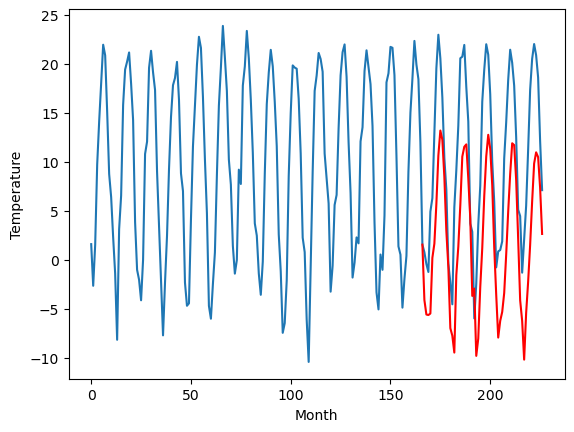

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -2.86  -4.094498
1                 1   -2.38  -2.822530
2                 2    6.75   7.675058
3                 3    4.23   3.780952
4                 4    3.65   3.598875
5                 5    5.12   3.977981
6                 6    0.86   2.849766
7                 7    2.01   1.613051
8                 8   -2.64  -0.069820
9                 9   -4.88  -3.452958
10               10   -6.79  -4.093705


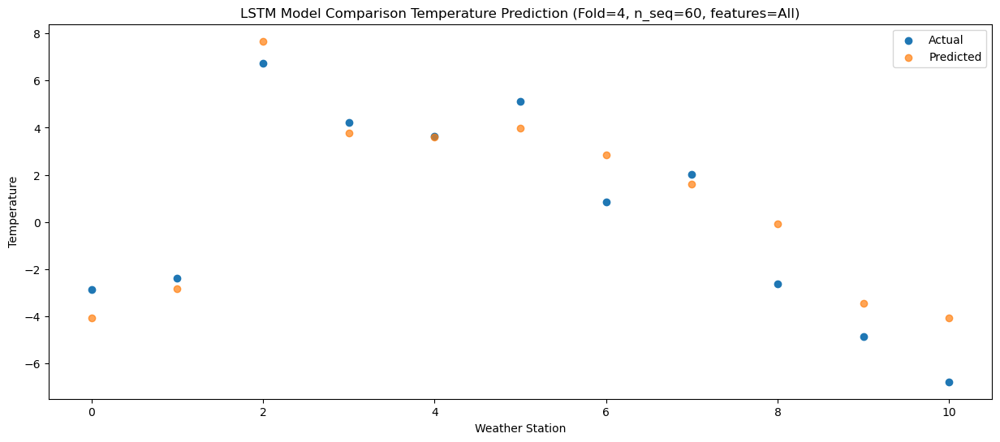

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -4.52  -5.575342
1                 1   -2.56  -4.313840
2                 2    6.81   6.186832
3                 3    2.58   2.300115
4                 4    1.87   2.120110
5                 5    3.48   2.495808
6                 6    0.51   1.364019
7                 7    1.20   0.130627
8                 8   -3.46  -1.548749
9                 9   -5.20  -4.934089
10               10   -7.57  -5.572164


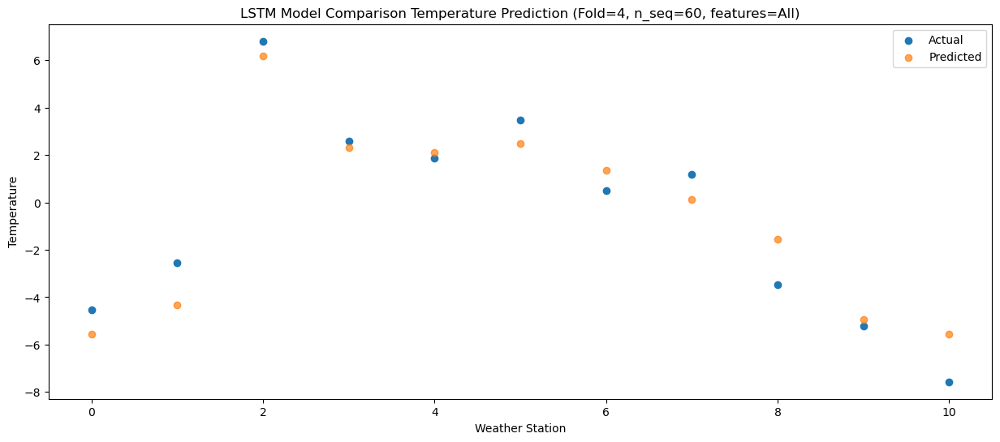

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -7.48  -5.625787
1                 1   -4.02  -4.363693
2                 2    6.62   6.144802
3                 3    2.82   2.255874
4                 4    2.49   2.072011
5                 5    2.75   2.450717
6                 6    0.34   1.313314
7                 7   -0.45   0.083592
8                 8   -4.39  -1.601127
9                 9   -7.64  -4.984517
10               10   -8.77  -5.625449


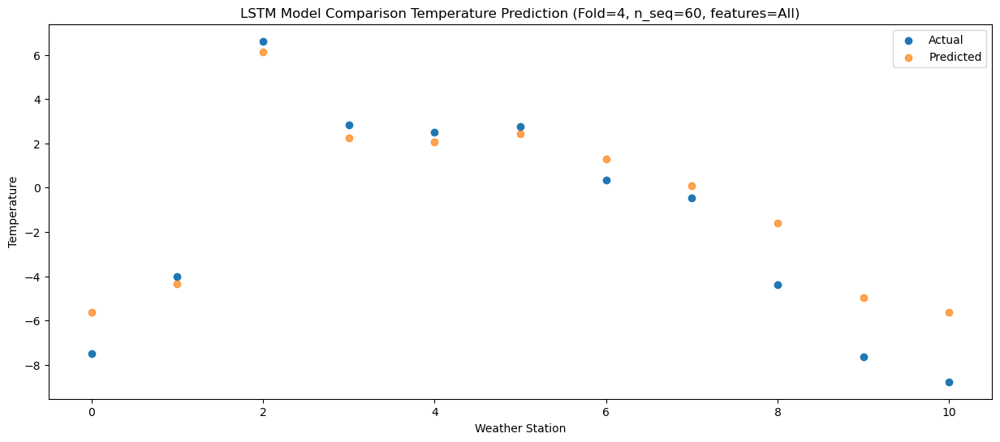

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -6.37  -5.464651
1                 1   -2.47  -4.200728
2                 2    6.88   6.300474
3                 3    2.49   2.412126
4                 4    2.11   2.230650
5                 5    1.99   2.611375
6                 6    0.81   1.469463
7                 7    0.12   0.237160
8                 8   -5.22  -1.440652
9                 9   -7.89  -4.823898
10               10   -9.58  -5.468139


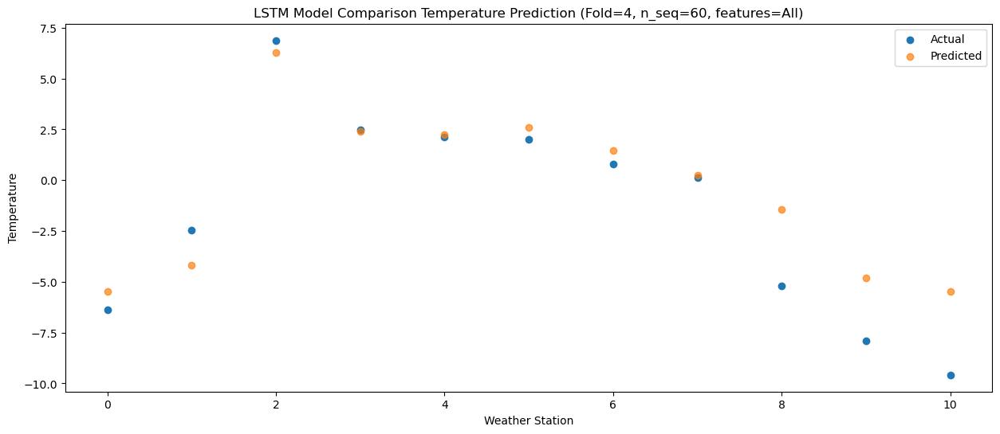

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    1.16   0.216232
1                 1    1.60   1.479676
2                 2   14.68  11.981948
3                 3    9.95   8.092715
4                 4    9.99   7.911695
5                 5    9.55   8.291788
6                 6    6.42   7.153422
7                 7    7.05   5.914373
8                 8    1.60   4.237943
9                 9   -0.29   0.854092
10               10   -3.42   0.214447


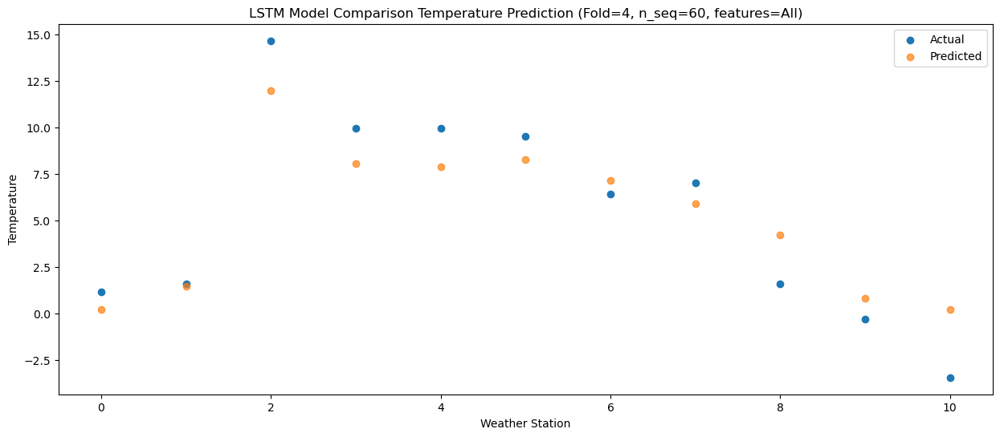

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.59   1.659274
1                 1    3.28   2.921238
2                 2   13.73  13.426634
3                 3   10.61   9.540330
4                 4   10.68   9.357678
5                 5   12.52   9.734479
6                 6    7.69   8.591870
7                 7    8.63   7.357148
8                 8    4.59   5.681479
9                 9    2.82   2.300714
10               10   -2.04   1.654518


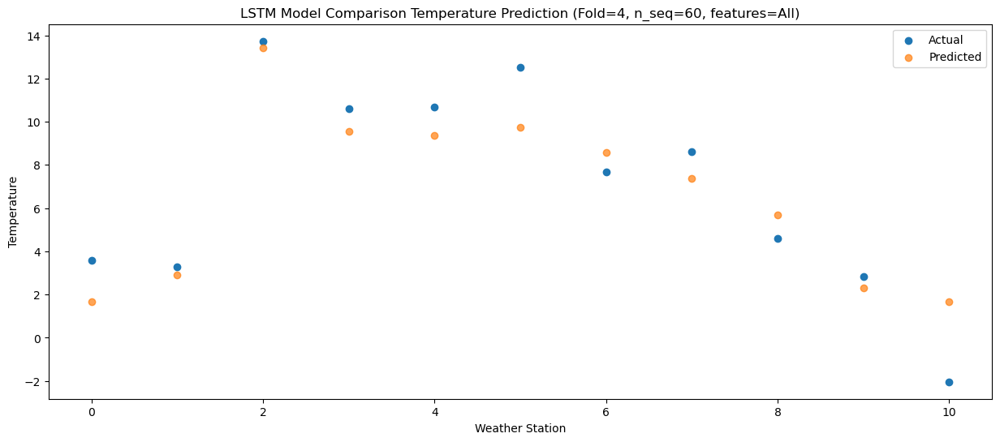

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.66   5.710367
1                 1    4.68   6.965211
2                 2   17.61  17.472192
3                 3   15.74  13.586442
4                 4   16.33  13.403658
5                 5   19.09  13.777759
6                 6   10.48  12.635672
7                 7   12.73  11.403882
8                 8   10.17   9.728949
9                 9    8.70   6.351243
10               10    4.70   5.702166


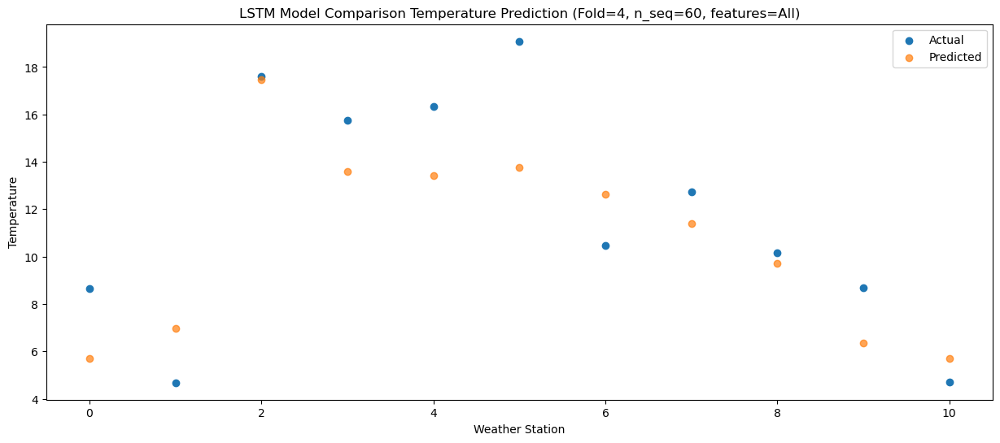

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   17.91  10.673861
1                 1    6.44  11.924020
2                 2   21.70  22.425997
3                 3   20.70  18.541288
4                 4   21.04  18.359501
5                 5   22.42  18.733732
6                 6   15.07  17.589605
7                 7   19.08  16.359518
8                 8   17.46  14.683682
9                 9   16.43  11.305858
10               10   11.19  10.655035


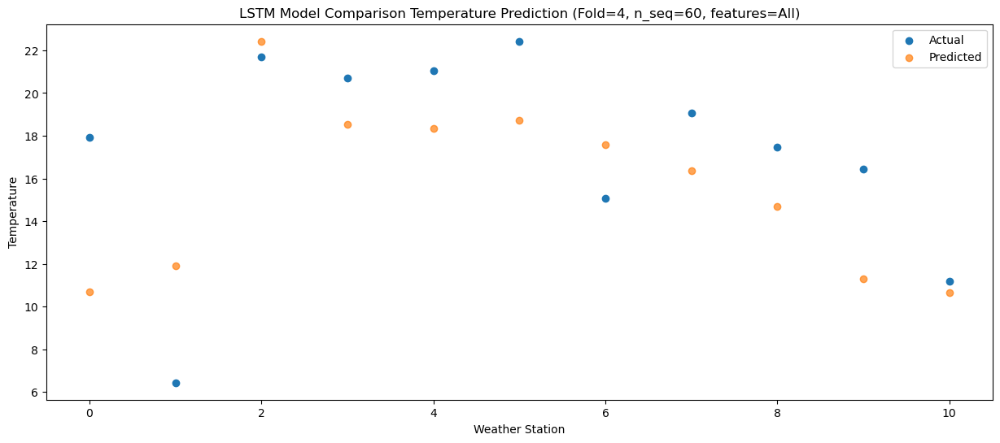

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   18.72  13.219890
1                 1    6.76  14.445928
2                 2   23.27  24.951048
3                 3   22.56  21.074597
4                 4   23.48  20.897238
5                 5   25.25  21.273633
6                 6   18.11  20.118955
7                 7   21.62  18.898485
8                 8   19.50  17.224258
9                 9   17.64  13.852044
10               10   14.63  13.201183


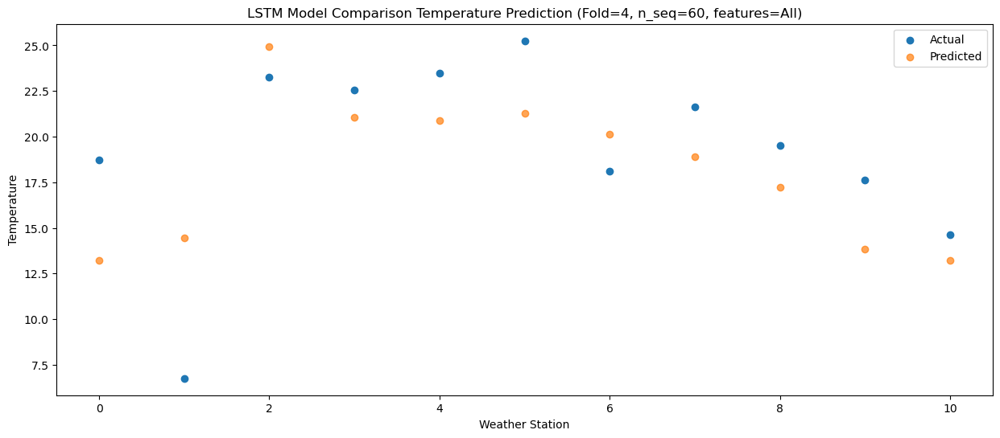

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   16.62  12.292478
1                 1    6.61  13.531827
2                 2   22.44  24.032211
3                 3   22.31  20.146370
4                 4   22.80  19.962614
5                 5   24.63  20.338902
6                 6   16.91  19.191363
7                 7   19.63  17.967210
8                 8   17.30  16.290296
9                 9   15.04  12.918117
10               10   12.22  12.270090


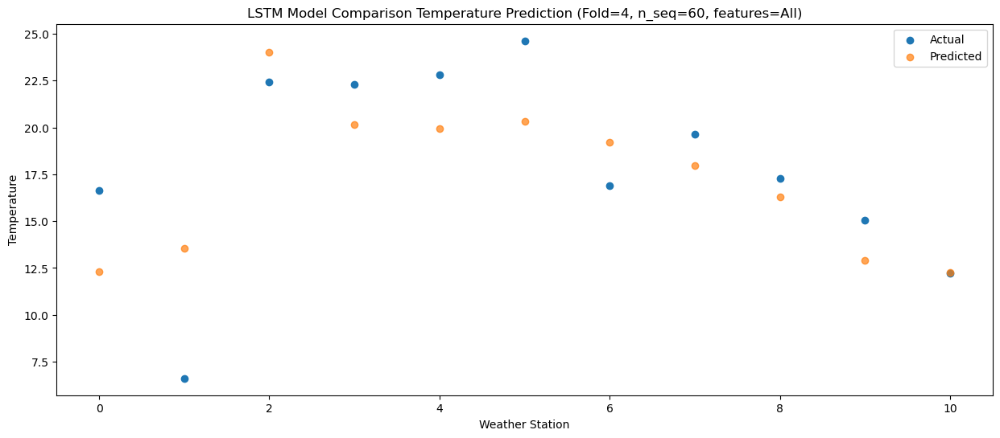

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   11.78   8.509798
1                 1    6.03   9.740269
2                 2   20.34  20.247791
3                 3   16.53  16.366828
4                 4   16.50  16.184437
5                 5   16.90  16.559691
6                 6   13.11  15.403295
7                 7   16.05  14.181376
8                 8   13.54  12.501015
9                 9   11.14   9.135594
10               10    8.23   8.483226


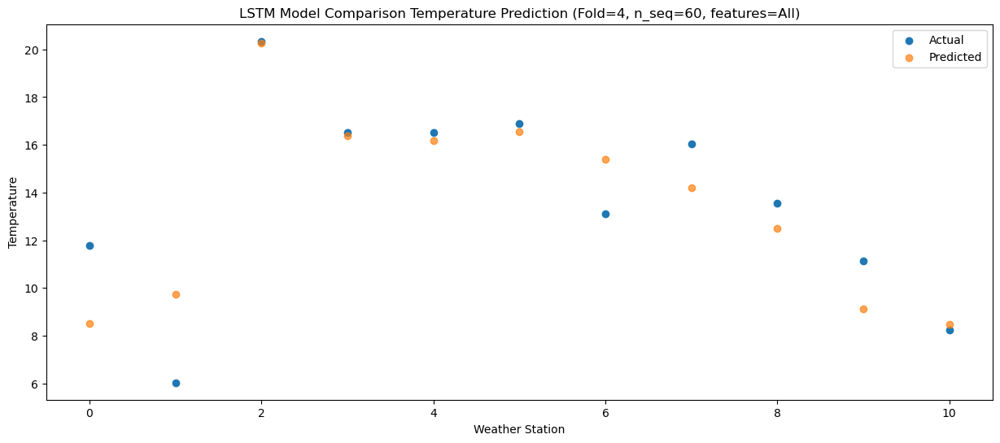

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    3.73   2.982947
1                 1    4.53   4.209146
2                 2   15.00  14.723824
3                 3   10.80  10.840862
4                 4   10.75  10.661464
5                 5   12.94  11.036599
6                 6    9.29   9.882225
7                 7    9.12   8.656430
8                 8    6.70   6.976546
9                 9    3.80   3.609118
10               10    2.07   2.957735


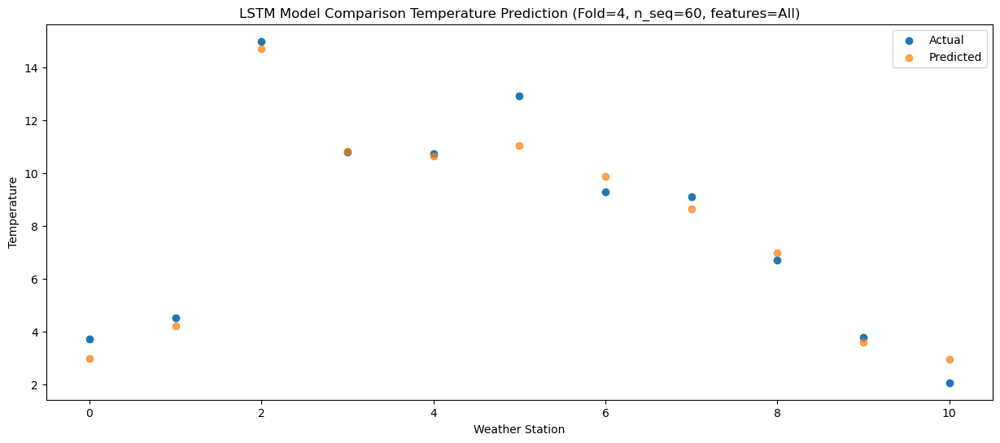

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.54  -0.666470
1                 1    1.14   0.559914
2                 2   11.00  11.078957
3                 3    8.19   7.196403
4                 4    7.99   7.018908
5                 5    9.06   7.395552
6                 6    4.98   6.240204
7                 7    6.57   5.013934
8                 8    2.86   3.333710
9                 9    1.16  -0.035359
10               10   -1.16  -0.689299


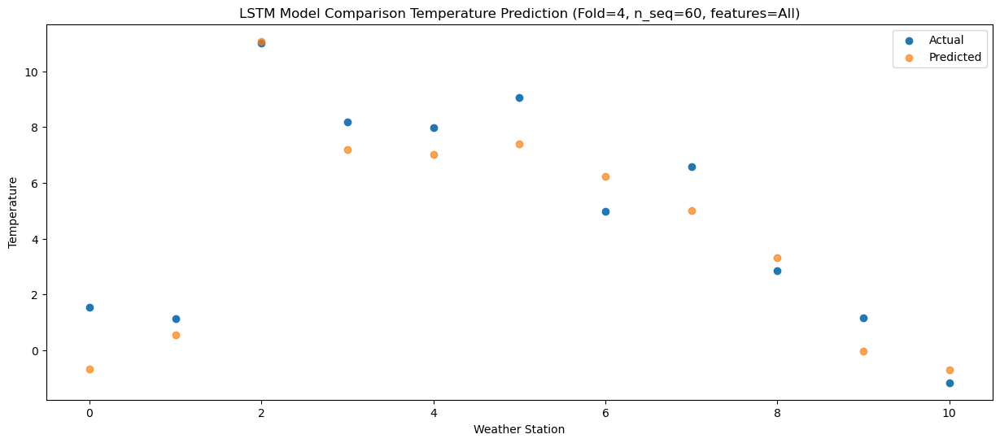

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -5.84  -6.939216
1                 1   -6.61  -5.718979
2                 2    4.75   4.804110
3                 3    1.91   0.918388
4                 4    1.42   0.740703
5                 5    2.08   1.118271
6                 6   -2.27  -0.037165
7                 7    0.04  -1.266135
8                 8   -4.65  -2.941363
9                 9   -6.72  -6.311734
10               10   -8.72  -6.963790


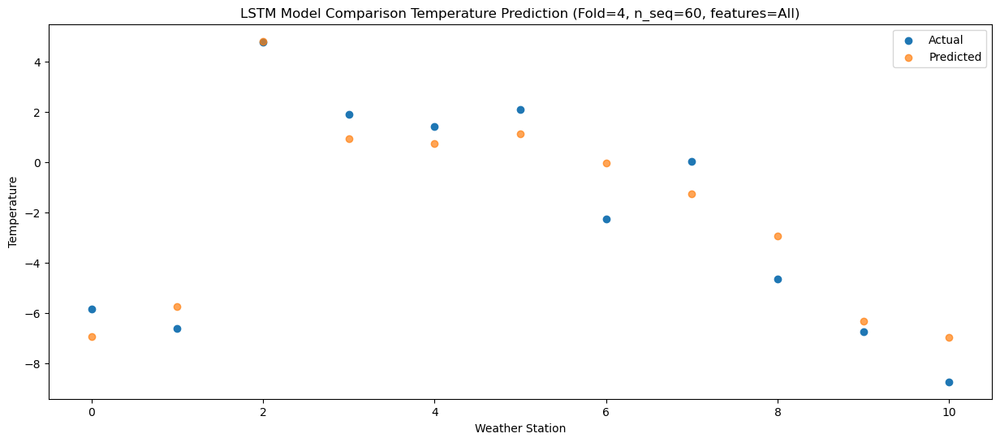

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -7.35  -7.709011
1                 1   -5.91  -6.475912
2                 2    4.78   4.043359
3                 3    0.99   0.152407
4                 4    0.82  -0.030935
5                 5    0.98   0.346029
6                 6   -2.04  -0.805067
7                 7   -1.63  -2.038968
8                 8   -6.23  -3.711684
9                 9   -8.75  -7.086081
10               10  -10.64  -7.732575


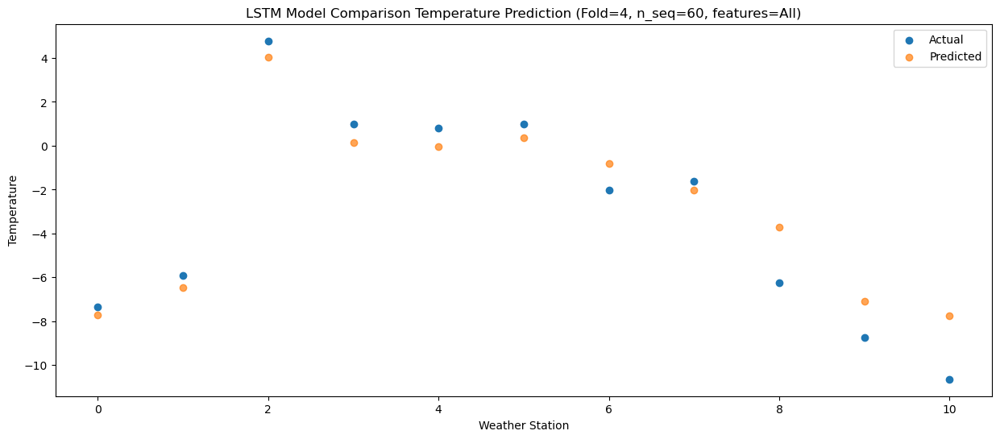

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0  -13.48  -9.424019
1                 1   -2.48  -8.191586
2                 2    2.86   2.320409
3                 3   -2.47  -1.570208
4                 4   -3.07  -1.754411
5                 5   -0.59  -1.368374
6                 6   -1.37  -2.525587
7                 7   -5.24  -3.762938
8                 8   -9.59  -5.436050
9                 9  -13.19  -8.815461
10               10  -12.88  -9.457077


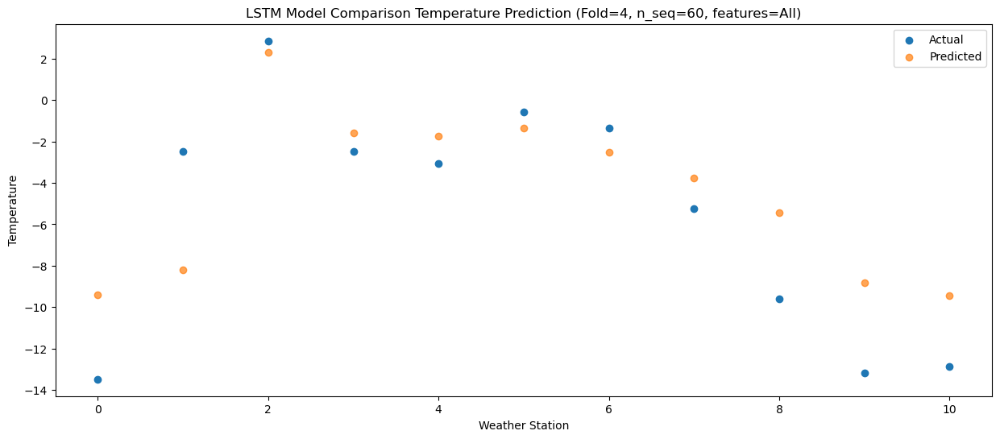

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    1.25  -1.517200
1                 1   -0.88  -0.304356
2                 2   12.19  10.217020
3                 3    8.49   6.333490
4                 4    7.85   6.152558
5                 5    8.66   6.535264
6                 6    5.03   5.370718
7                 7    7.03   4.145603
8                 8    2.38   2.472207
9                 9    0.67  -0.902632
10               10   -2.99  -1.545750


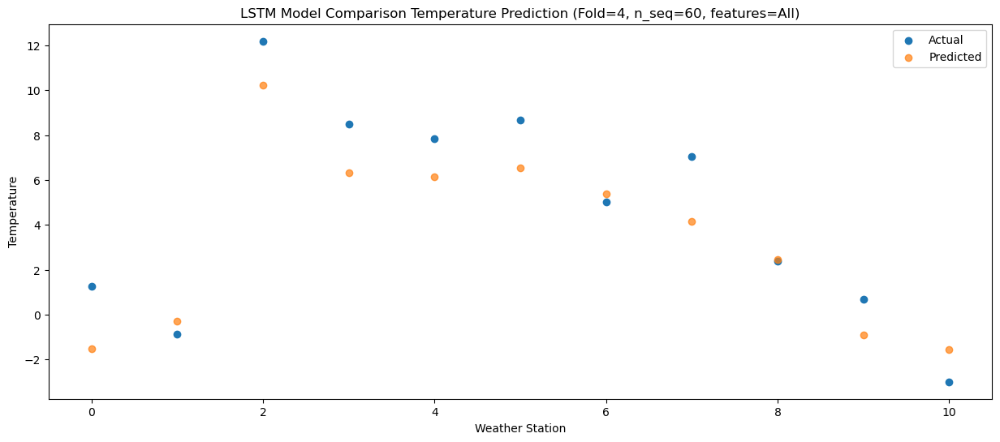

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.16   1.382344
1                 1    0.56   2.594385
2                 2   13.26  13.108535
3                 3   10.18   9.220027
4                 4   10.03   9.037566
5                 5   10.89   9.414682
6                 6    7.76   8.253865
7                 7    8.93   7.031388
8                 8    6.03   5.362250
9                 9    4.38   1.992430
10               10    0.81   1.347323


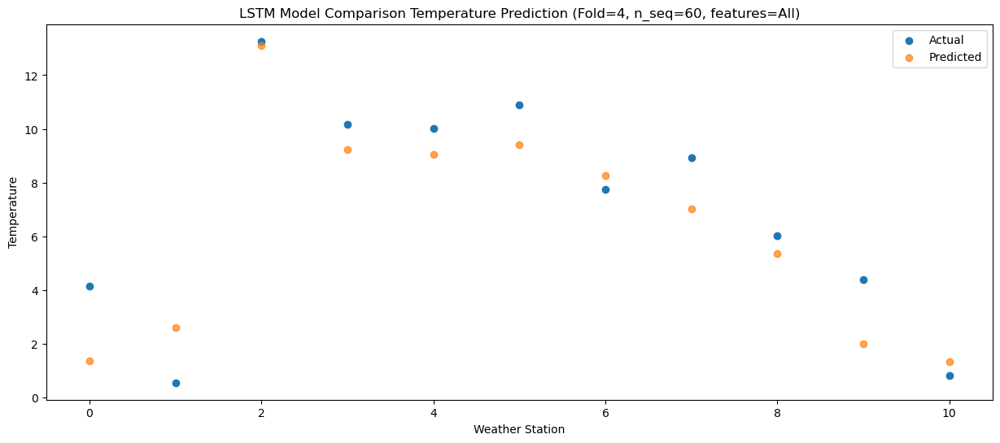

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.37   5.637122
1                 1    4.60   6.841448
2                 2   17.73  17.355757
3                 3   14.34  13.468397
4                 4   13.56  13.288997
5                 5   16.38  13.675076
6                 6   11.21  12.504355
7                 7   12.97  11.283357
8                 8   10.44   9.610637
9                 9    9.16   6.241759
10               10    5.34   5.594386


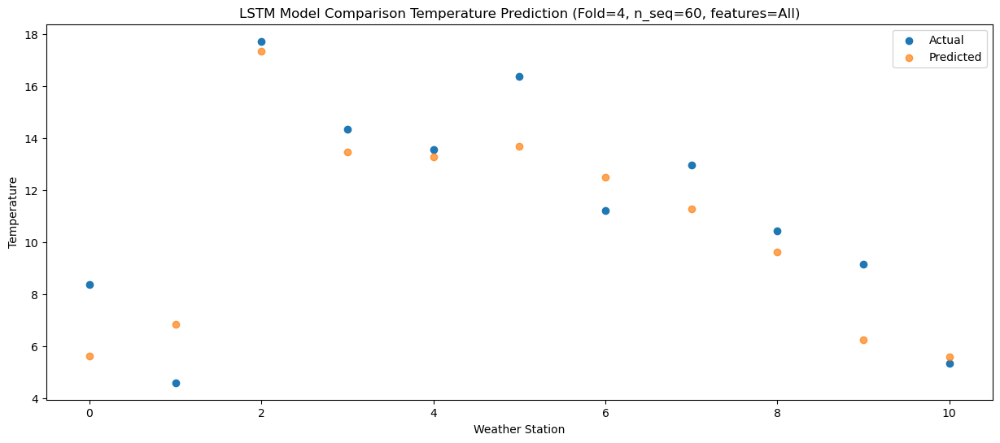

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   16.28  10.581130
1                 1    6.23  11.767977
2                 2   21.99  22.293942
3                 3   20.02  18.417737
4                 4   20.41  18.243382
5                 5   21.34  18.625300
6                 6   15.23  17.447315
7                 7   19.27  16.229409
8                 8   17.68  14.559358
9                 9   16.55  11.194273
10               10   12.23  10.544105


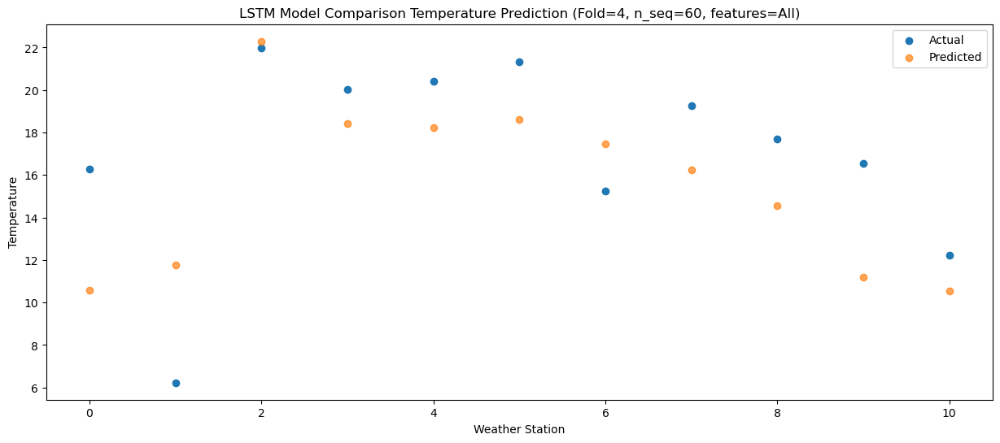

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   17.08  11.597389
1                 1    6.60  12.794042
2                 2   22.65  23.313148
3                 3   21.61  19.432101
4                 4   21.90  19.255081
5                 5   21.08  19.640165
6                 6   16.97  18.459905
7                 7   20.56  17.234040
8                 8   18.25  15.565074
9                 9   16.26  12.199626
10               10   12.39  11.548591


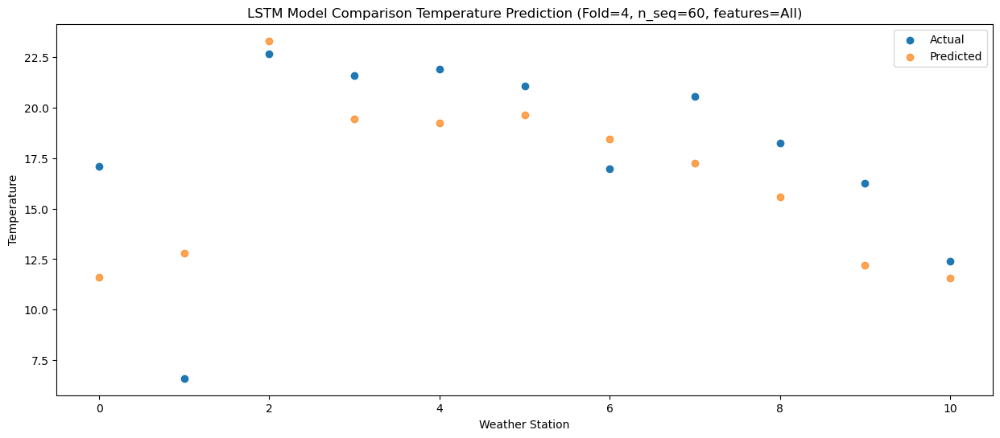

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   17.48  11.843254
1                 1    6.88  13.035623
2                 2   23.30  23.554750
3                 3   21.98  19.672637
4                 4   22.27  19.494158
5                 5   21.40  19.874319
6                 6   17.10  18.699644
7                 7   21.08  17.473375
8                 8   19.11  15.807211
9                 9   16.54  12.442256
10               10   13.59  11.790085


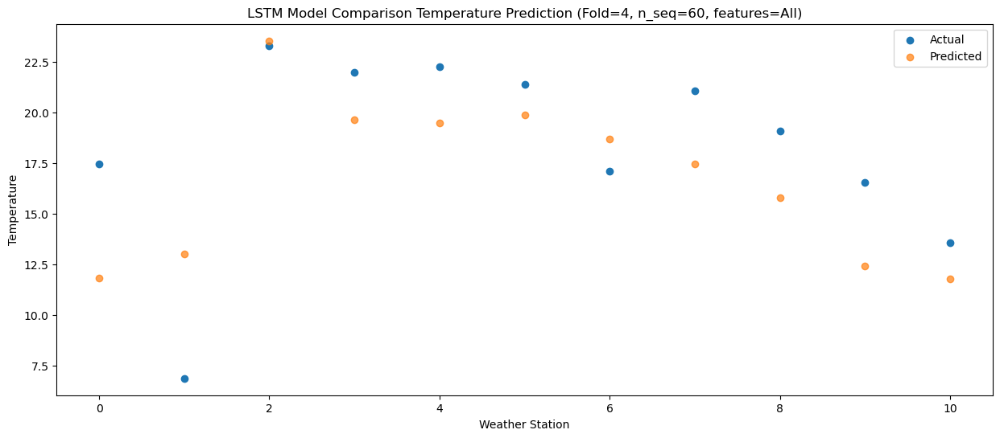

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   14.29   8.369469
1                 1    5.59   9.559956
2                 2   20.18  20.079838
3                 3   19.19  16.198842
4                 4   18.84  16.018672
5                 5   20.71  16.395267
6                 6   13.13  15.219820
7                 7   18.04  13.994801
8                 8   15.62  12.333817
9                 9   13.43   8.969743
10               10    9.30   8.318570


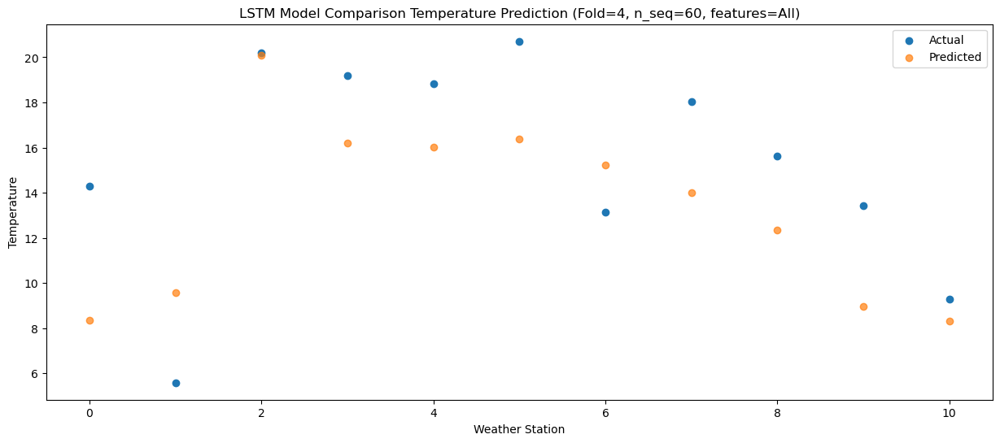

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.16   4.264372
1                 1    3.75   5.449831
2                 2   16.79  15.977191
3                 3   14.54  12.103732
4                 4   13.97  11.927999
5                 5   15.01  12.304090
6                 6    9.33  11.125314
7                 7   12.27   9.898697
8                 8   10.27   8.245790
9                 9    7.97   4.874231
10               10    5.77   4.227287


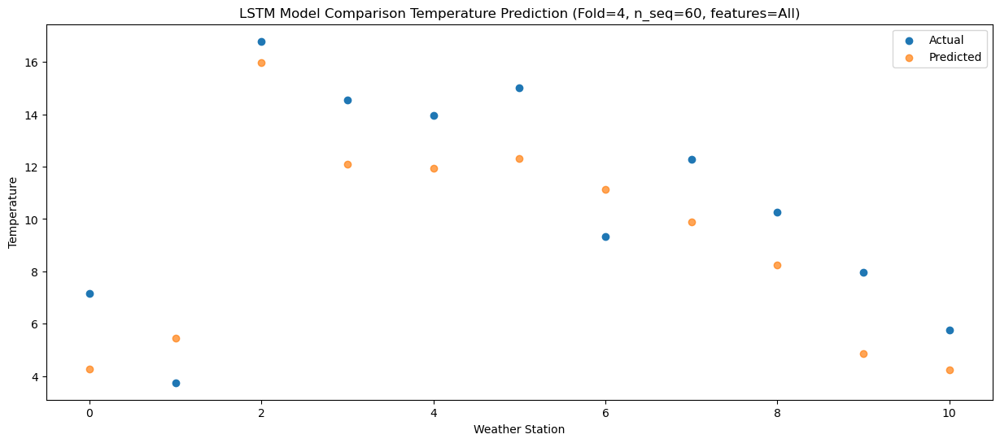

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.10  -3.634461
1                 1   -3.41  -2.457324
2                 2    8.12   8.071411
3                 3    6.54   4.201897
4                 4    6.13   4.028116
5                 5    8.07   4.404530
6                 6    1.17   3.221237
7                 7    4.33   1.999249
8                 8   -0.59   0.343631
9                 9   -2.34  -3.023168
10               10   -4.63  -3.673503


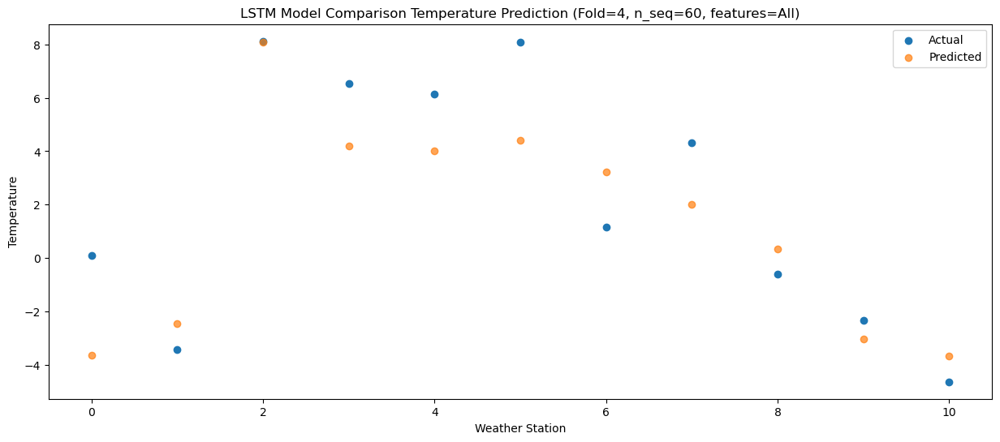

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -2.878527
1                 1   -1.61  -1.705403
2                 2   11.63   8.826883
3                 3    8.54   4.961379
4                 4    7.87   4.789450
5                 5    8.48   5.169058
6                 6    3.08   3.980361
7                 7    5.79   2.758757
8                 8   -0.27   1.098201
9                 9   -2.59  -2.266397
10               10   -5.49  -2.921285


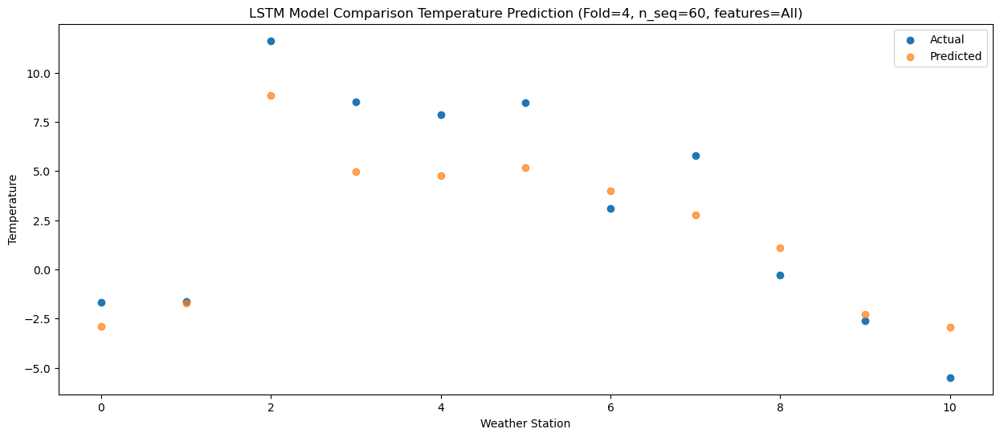

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -10.07  -9.744632
1                 1   -6.37  -8.567588
2                 2    3.35   1.960487
3                 3    0.07  -1.909121
4                 4   -1.03  -2.083638
5                 5    1.11  -1.699723
6                 6   -2.98  -2.886183
7                 7   -3.28  -4.107887
8                 8   -9.11  -5.769767
9                 9  -12.07  -9.139767
10               10  -14.32  -9.791822


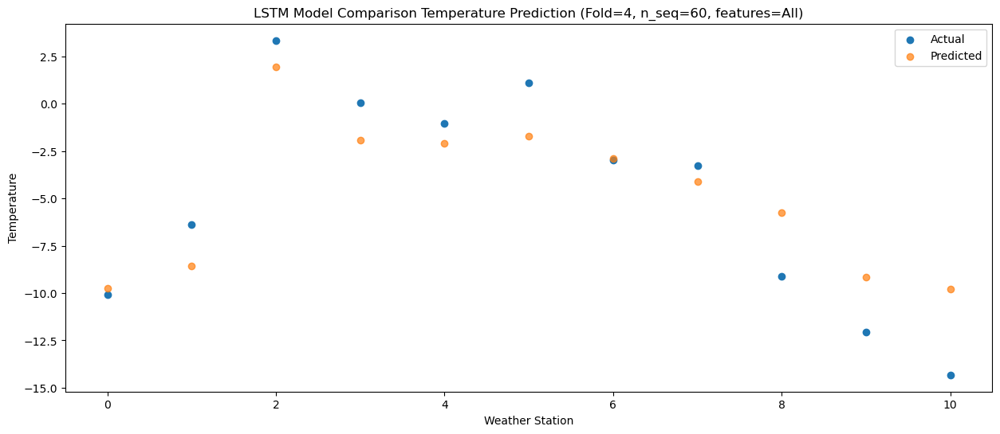

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -8.00  -7.971003
1                 1   -2.94  -6.798203
2                 2    5.71   3.731785
3                 3    0.33  -0.131979
4                 4   -0.41  -0.303956
5                 5    0.91   0.081301
6                 6    1.30  -1.110479
7                 7   -1.22  -2.339737
8                 8   -6.09  -4.000239
9                 9   -9.24  -7.367479
10               10  -10.76  -8.016152


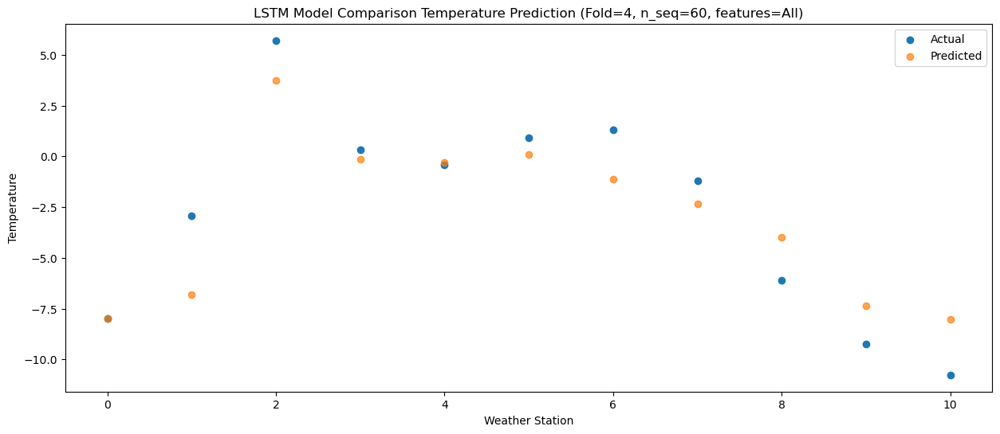

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -1.29  -2.727199
1                 1   -0.12  -1.560518
2                 2   10.45   8.970292
3                 3    6.51   5.107657
4                 4    6.51   4.938115
5                 5    8.23   5.326072
6                 6    4.86   4.131491
7                 7    5.44   2.900539
8                 8    1.38   1.240880
9                 9   -1.03  -2.122747
10               10   -4.79  -2.773893


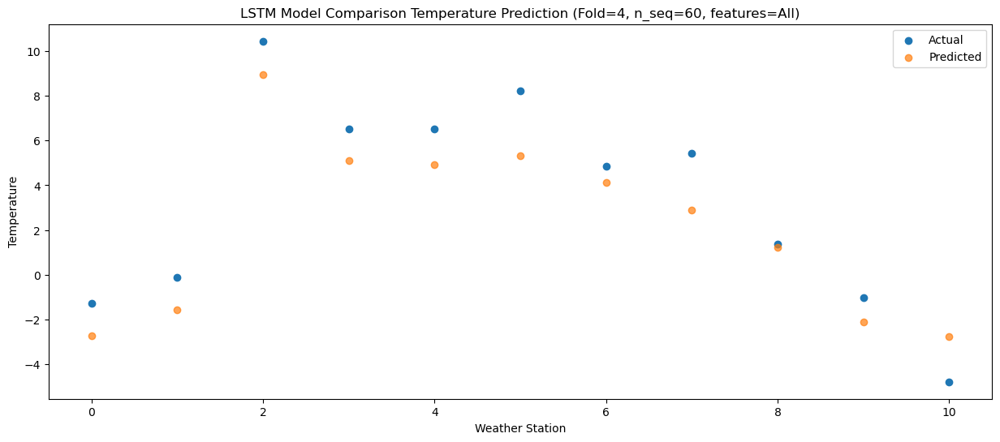

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    3.59   1.247195
1                 1    2.22   2.417263
2                 2   14.66  12.946817
3                 3   12.56   9.087896
4                 4   13.20   8.919037
5                 5   15.74   9.305548
6                 6    7.52   8.108086
7                 7    9.30   6.877706
8                 8    5.16   5.221810
9                 9    3.09   1.857767
10               10   -0.79   1.208085


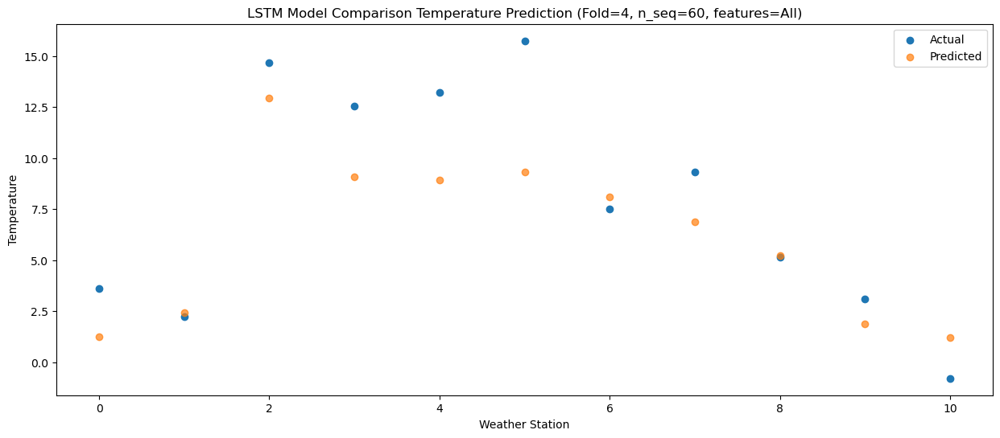

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.53   6.550928
1                 1    5.04   7.705406
2                 2   20.46  18.242205
3                 3   17.27  14.383595
4                 4   18.03  14.215600
5                 5   21.43  14.599978
6                 6   13.50  13.401321
7                 7   14.97  12.180214
8                 8   13.66  10.521464
9                 9   11.62   7.163189
10               10    7.79   6.510733


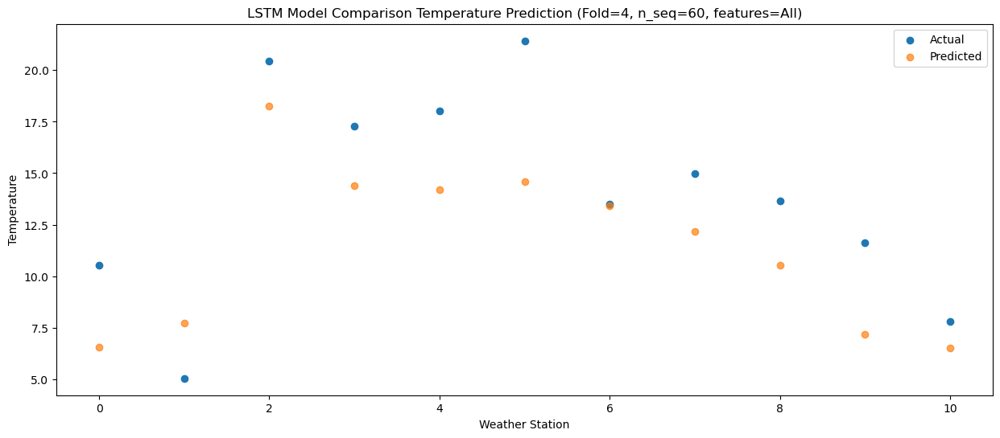

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   16.44  10.602208
1                 1    6.76  11.749414
2                 2   23.75  22.287012
3                 3   21.82  18.427262
4                 4   22.70  18.260862
5                 5   23.80  18.646985
6                 6   16.71  17.446220
7                 7   20.29  16.227232
8                 8   18.14  14.565692
9                 9   16.23  11.208832
10               10   11.06  10.557209


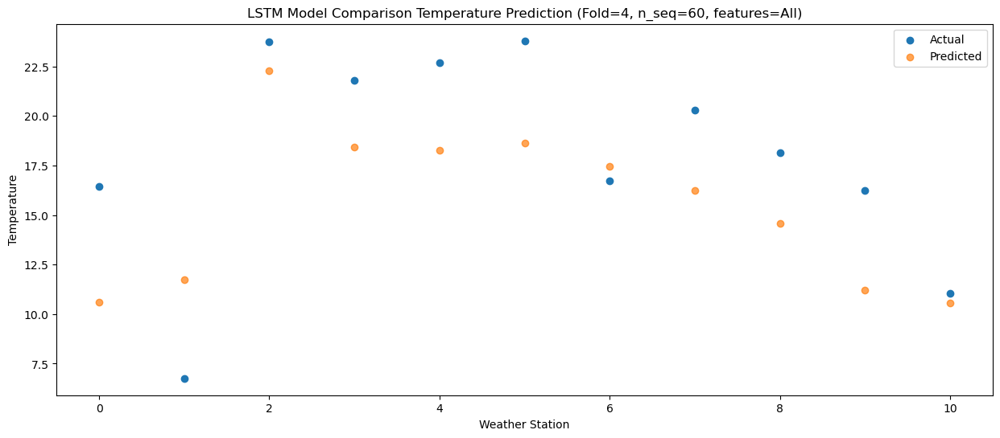

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   18.96  12.811840
1                 1    7.13  13.961030
2                 2   23.95  24.502736
3                 3   25.12  20.640617
4                 4   26.12  20.471838
5                 5   25.70  20.859697
6                 6   17.98  19.659308
7                 7   23.99  18.438291
8                 8   20.08  16.781525
9                 9   17.05  13.420132
10               10   13.66  12.768955


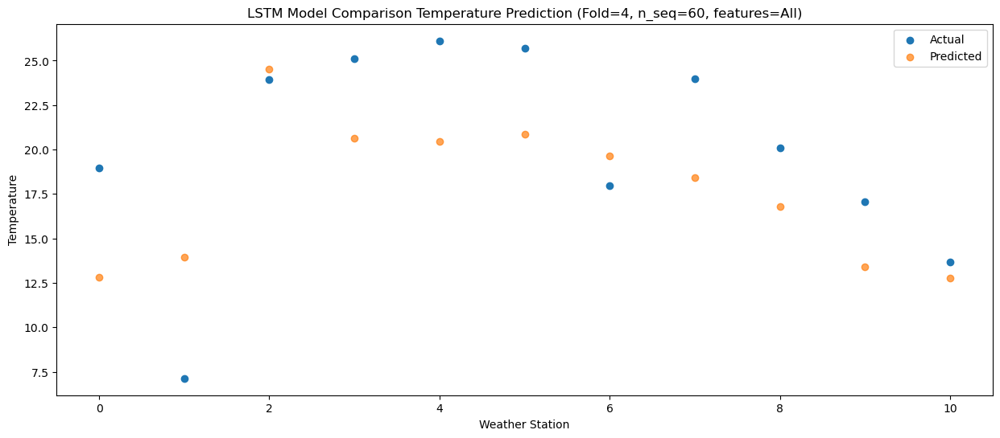

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   17.30  11.386063
1                 1    7.08  12.543986
2                 2   22.41  23.076396
3                 3   22.39  19.211523
4                 4   23.28  19.039715
5                 5   22.40  19.424729
6                 6   16.46  18.228051
7                 7   20.47  17.007732
8                 8   17.85  15.345152
9                 9   15.75  11.984956
10               10   12.59  11.331414


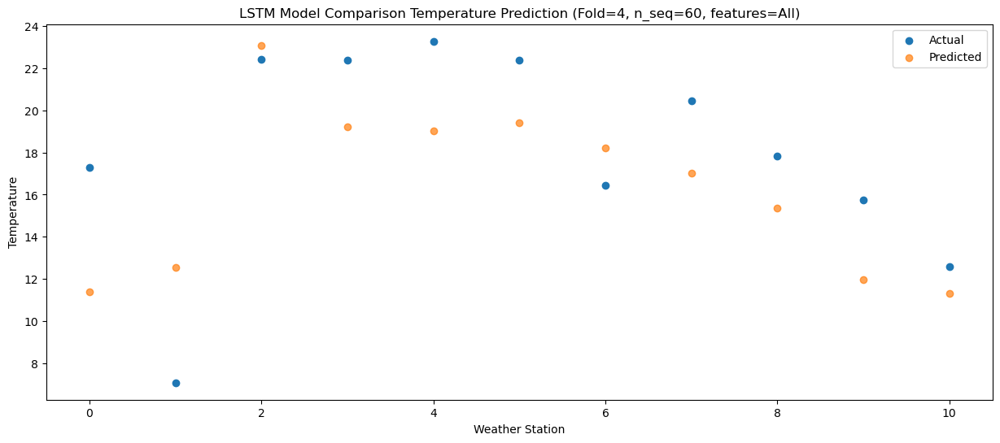

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   13.39   7.695326
1                 1    5.64   8.848303
2                 2   20.34  19.381296
3                 3   18.96  15.519837
4                 4   19.19  15.351227
5                 5   19.50  15.734450
6                 6   13.37  14.533447
7                 7   16.88  13.316383
8                 8   13.94  11.654257
9                 9   11.61   8.295652
10               10    8.54   7.642347


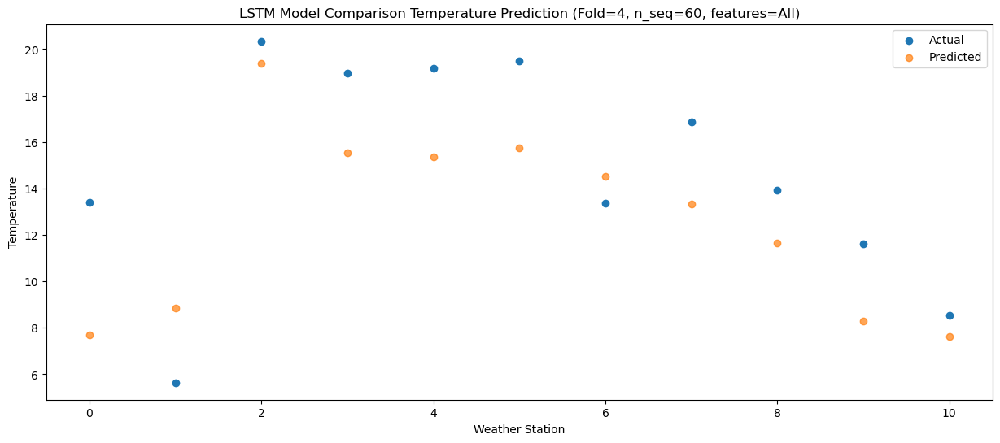

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    6.04   1.337960
1                 1    1.81   2.496401
2                 2   14.21  13.028707
3                 3   12.09   9.163474
4                 4   12.04   8.993462
5                 5   12.69   9.376433
6                 6    6.50   8.176426
7                 7   10.51   6.954669
8                 8    6.45   5.294132
9                 9    4.14   1.929724
10               10    1.68   1.280751


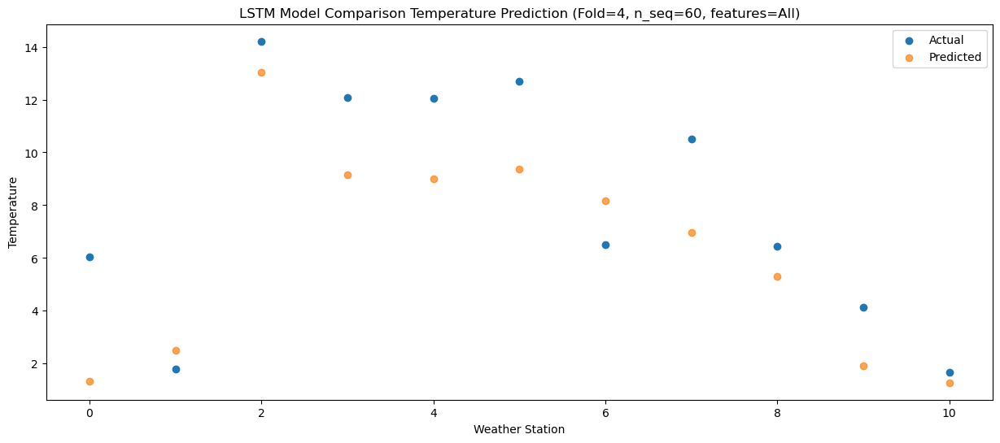

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -2.29  -3.506913
1                 1    0.35  -2.344510
2                 2    9.62   8.193403
3                 3    5.04   4.320600
4                 4    4.95   4.146675
5                 5    4.84   4.529333
6                 6    3.80   3.333954
7                 7    3.96   2.107897
8                 8    0.66   0.449659
9                 9   -1.40  -2.917585
10               10   -2.40  -3.563025


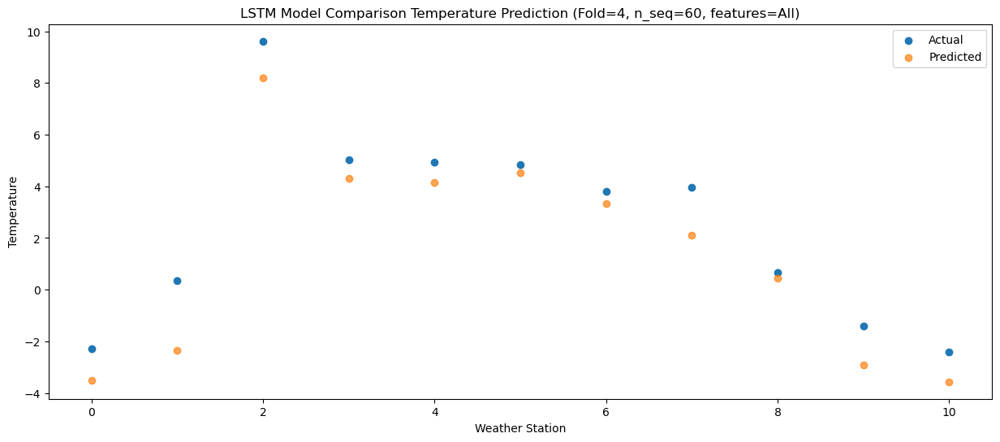

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -8.43  -7.868026
1                 1   -4.50  -6.716028
2                 2    7.19   3.826295
3                 3    2.35  -0.043250
4                 4    1.98  -0.214016
5                 5    3.24   0.173874
6                 6   -2.15  -1.030433
7                 7   -0.89  -2.255887
8                 8   -5.12  -3.914338
9                 9   -8.13  -7.276695
10               10   -9.11  -7.925939


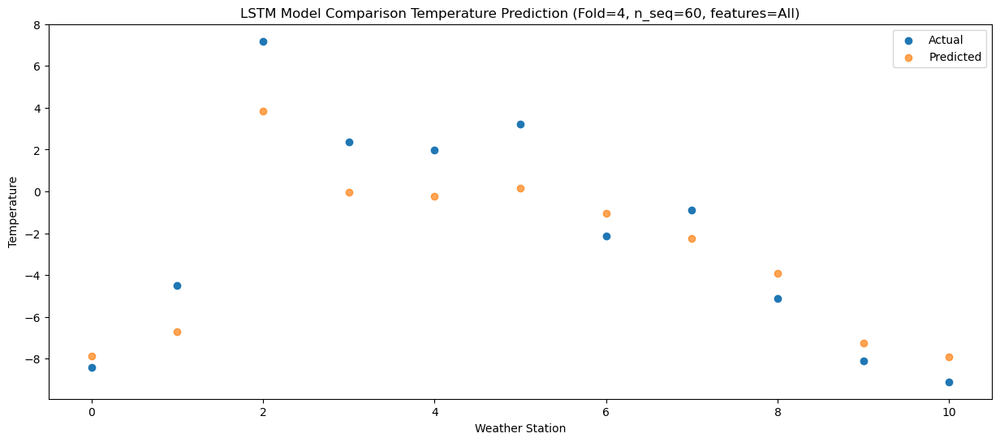

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -6.47  -6.162206
1                 1   -4.65  -5.011937
2                 2    7.60   5.533606
3                 3    3.34   1.661974
4                 4    2.75   1.488485
5                 5    3.61   1.873525
6                 6    0.87   0.667944
7                 7    0.76  -0.551729
8                 8   -3.16  -2.209317
9                 9   -5.89  -5.567284
10               10   -7.48  -6.218037


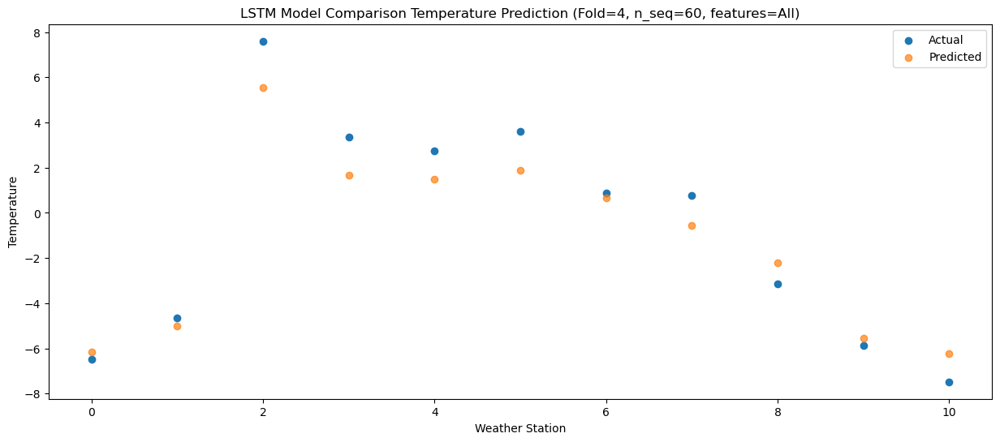

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -4.72  -5.252908
1                 1   -1.35  -4.105408
2                 2    9.54   6.444207
3                 3    3.40   2.570585
4                 4    2.98   2.395543
5                 5    3.78   2.781626
6                 6    4.29   1.577064
7                 7    2.90   0.356272
8                 8   -1.57  -1.300951
9                 9   -4.70  -4.659262
10               10   -7.34  -5.308327


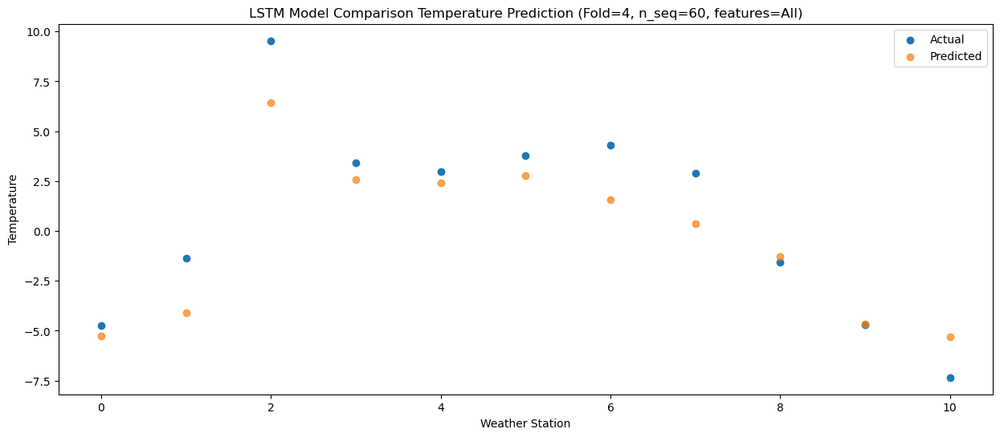

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -2.54  -3.317381
1                 1    0.37  -2.188106
2                 2   11.69   8.362031
3                 3    7.93   4.496513
4                 4    7.83   4.323711
5                 5    8.85   4.708751
6                 6    4.77   3.498172
7                 7    4.62   2.286199
8                 8   -0.30   0.625973
9                 9   -2.16  -2.725685
10               10   -6.46  -3.377984


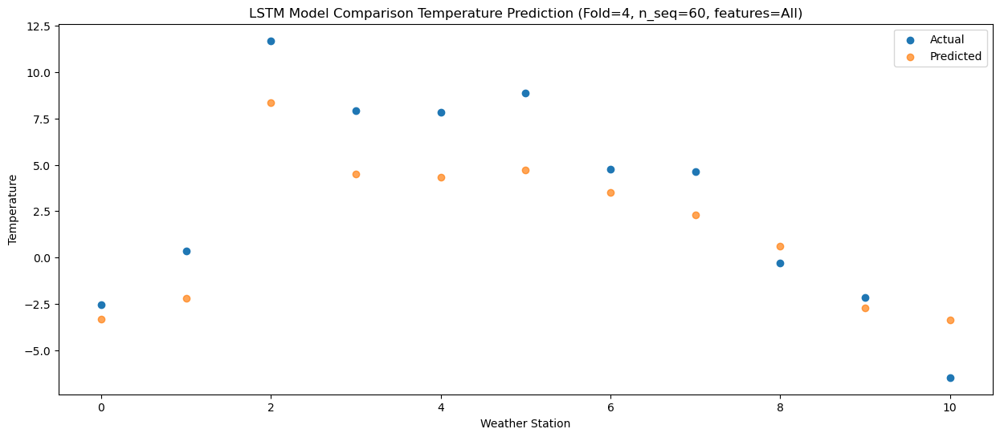

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    5.29   0.625969
1                 1    3.09   1.742647
2                 2   13.44  12.291453
3                 3   10.53   8.427784
4                 4   10.48   8.257285
5                 5   13.07   8.644686
6                 6    7.88   7.428582
7                 7   10.24   6.219481
8                 8    6.20   4.560786
9                 9    5.17   1.216737
10               10    2.01   0.562305


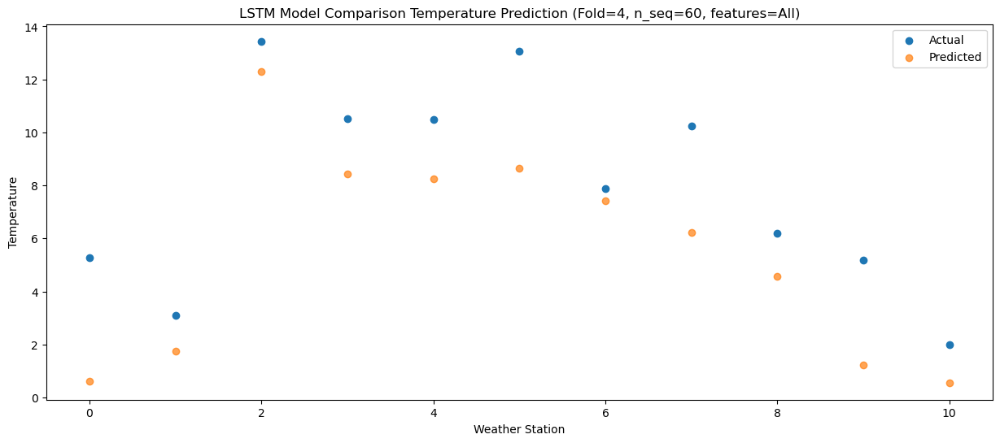

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   11.10   5.006733
1                 1    3.87   6.102587
2                 2   18.30  16.664800
3                 3   16.21  12.810796
4                 4   16.64  12.642378
5                 5   17.99  13.028805
6                 6   10.50  11.800930
7                 7   15.02  10.599427
8                 8   11.91   8.935636
9                 9   10.93   5.596784
10               10    5.70   4.935536


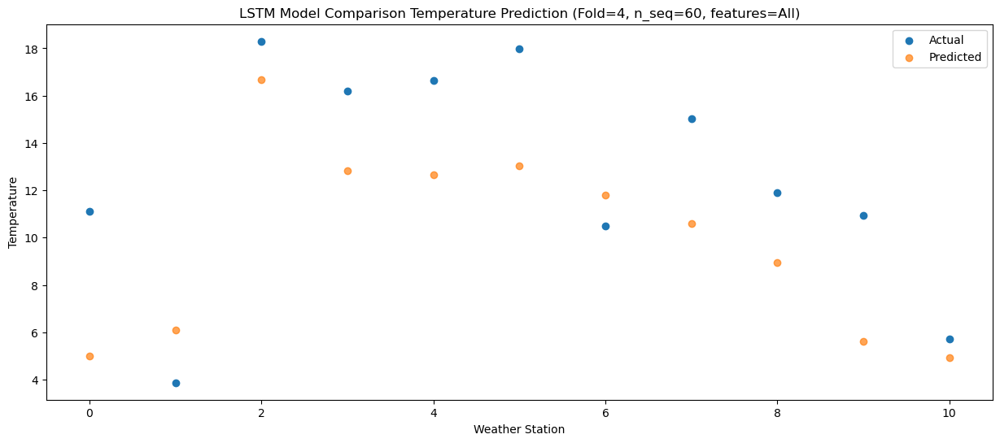

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   16.01   8.845728
1                 1    6.08   9.935703
2                 2   21.89  20.503737
3                 3   20.40  16.650353
4                 4   21.75  16.480490
5                 5   24.47  16.867130
6                 6   14.14  15.637800
7                 7   19.10  14.439507
8                 8   15.79  12.776772
9                 9   15.24   9.436462
10               10   10.01   8.776382


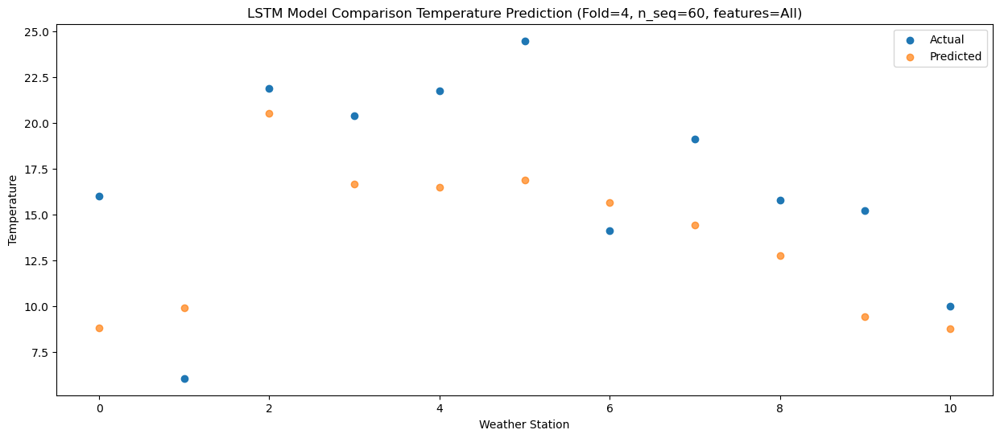

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   17.32  11.969746
1                 1    7.69  13.070168
2                 2   23.67  23.642528
3                 3   22.95  19.782904
4                 4   24.83  19.609326
5                 5   25.93  19.994644
6                 6   18.01  18.777196
7                 7   21.06  17.571652
8                 8   18.52  15.909108
9                 9   16.77  12.559280
10               10   13.10  11.903916


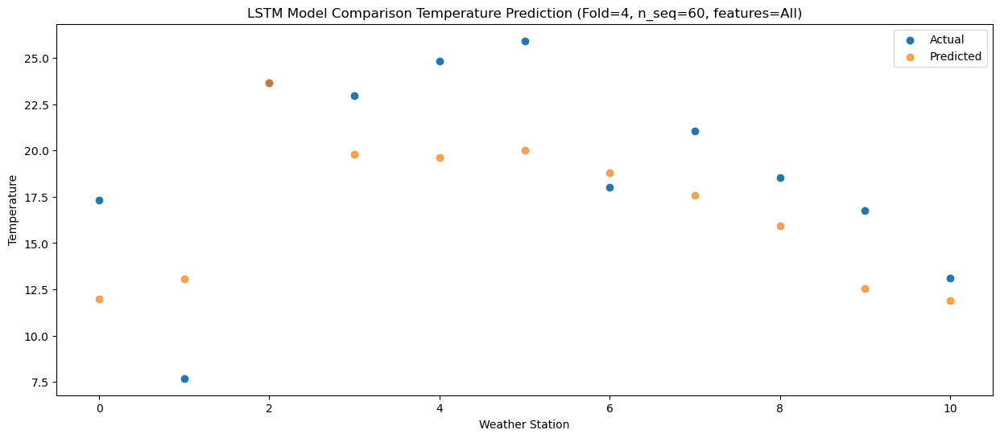

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   17.12  11.784972
1                 1    8.20  12.878688
2                 2   25.75  23.447547
3                 3   25.50  19.588644
4                 4   26.70  19.417769
5                 5   26.02  19.800194
6                 6   17.45  18.582382
7                 7   20.87  17.383132
8                 8   17.36  15.719833
9                 9   15.51  12.376697
10               10   11.77  11.719980


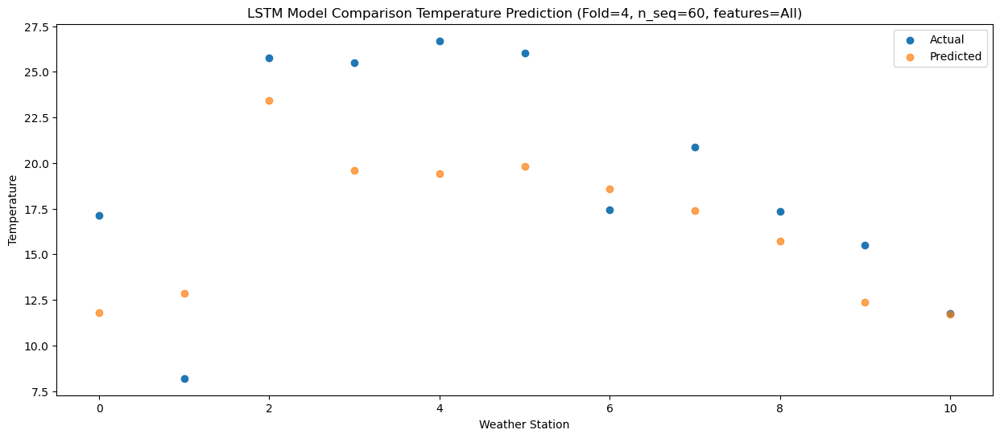

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   14.29   8.209736
1                 1    6.10   9.303064
2                 2   22.00  19.873913
3                 3   20.80  16.010772
4                 4   21.61  15.838846
5                 5   22.54  16.225066
6                 6   13.61  15.005628
7                 7   16.93  13.800529
8                 8   14.27  12.141956
9                 9   12.47   8.795518
10               10    9.43   8.143694


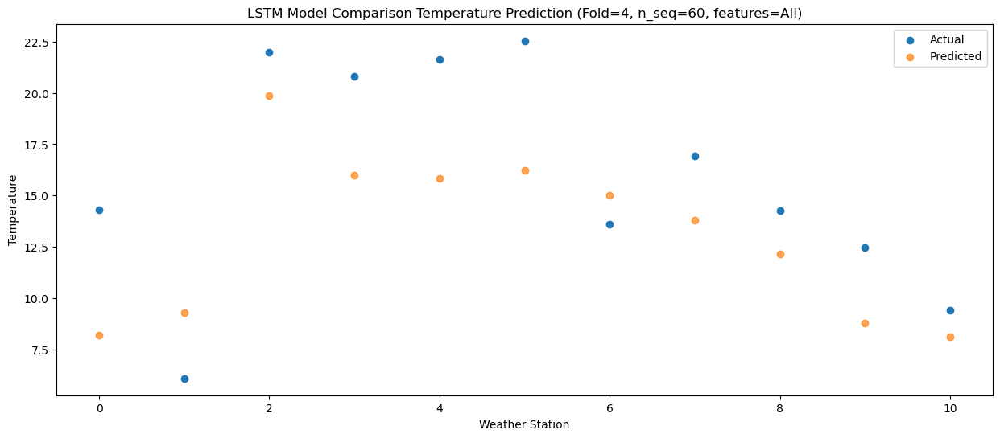

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    7.17   2.217148
1                 1    2.45   3.318701
2                 2   15.89  13.885985
3                 3   12.67  10.020813
4                 4   12.78   9.847500
5                 5   14.01  10.229563
6                 6    8.17   9.014637
7                 7   11.03   7.805426
8                 8    8.13   6.151848
9                 9    6.06   2.801274
10               10    4.17   2.150614


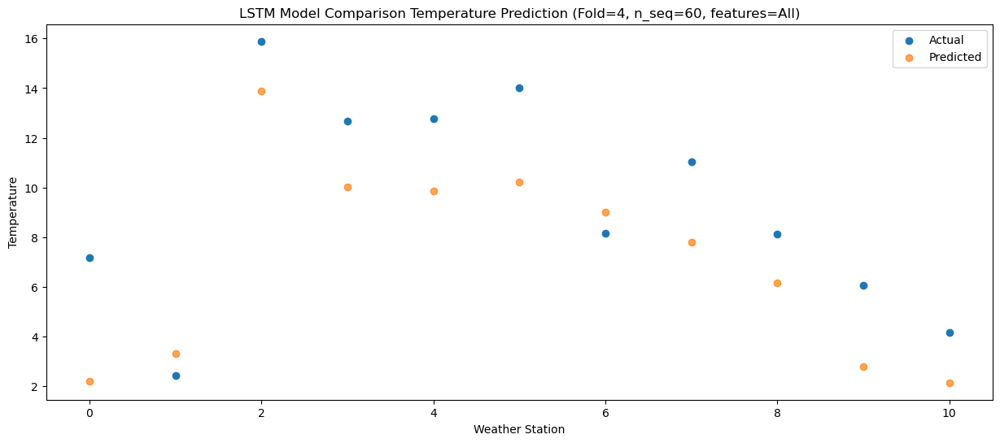

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.92  -4.053666
1                 1   -1.26  -2.948820
2                 2    8.93   7.620530
3                 3    6.60   3.756319
4                 4    6.25   3.582231
5                 5    7.30   3.968901
6                 6    2.44   2.745137
7                 7    5.13   1.535281
8                 8    1.06  -0.119231
9                 9   -1.03  -3.472851
10               10   -3.22  -4.123920


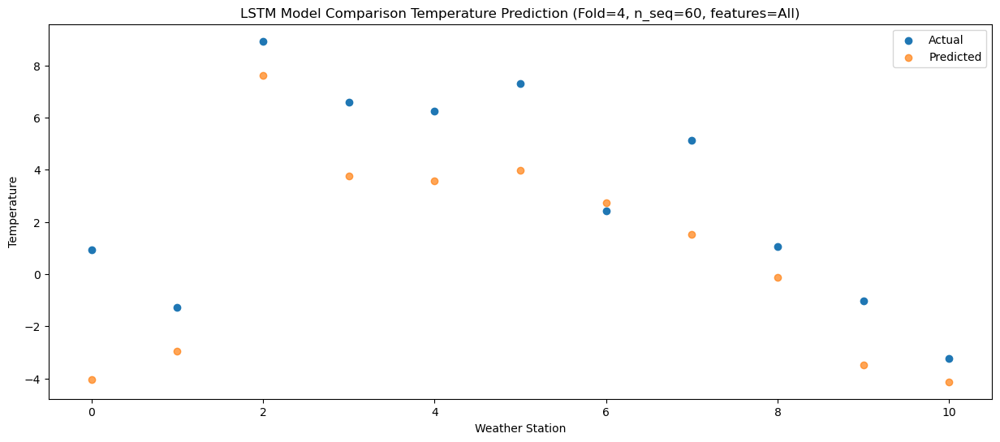

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -2.48  -6.162088
1                 1   -3.38  -5.069943
2                 2    6.38   5.503581
3                 3    3.58   1.645210
4                 4    3.12   1.473648
5                 5    4.50   1.852987
6                 6    0.23   0.630968
7                 7    2.25  -0.568504
8                 8   -0.83  -2.219577
9                 9   -3.02  -5.569855
10               10   -3.88  -6.221487


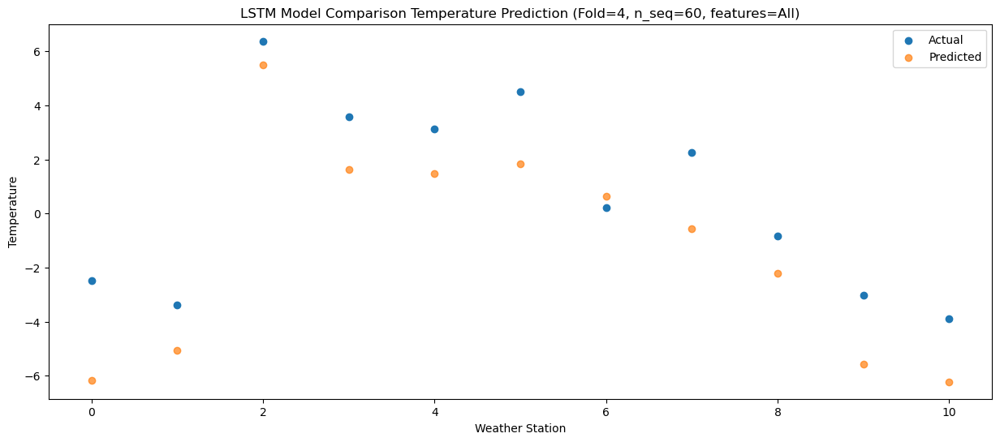

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0  -11.07 -10.114454
1                 1   -4.80  -9.025446
2                 2    2.19   1.550436
3                 3   -1.94  -2.311377
4                 4   -2.23  -2.485434
5                 5    0.25  -2.110286
6                 6   -2.21  -3.324099
7                 7   -4.91  -4.523408
8                 8   -7.11  -6.175711
9                 9  -10.60  -9.524391
10               10   -9.65 -10.175859


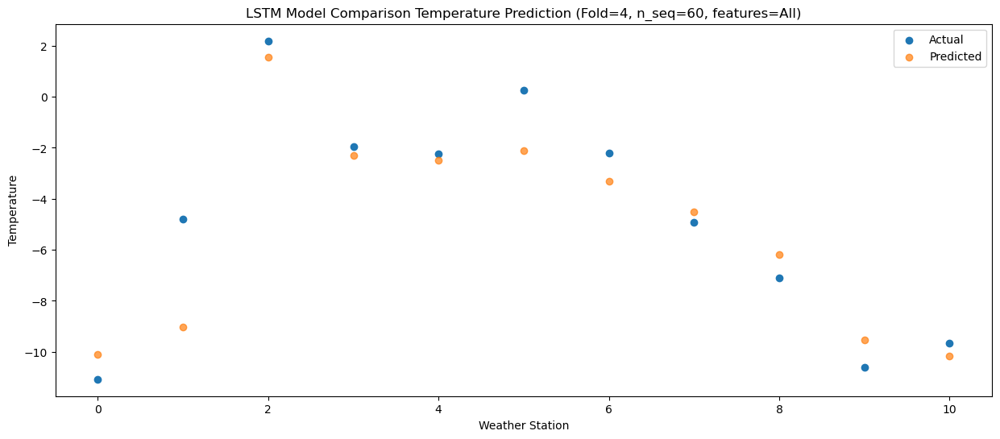

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    0.04  -5.350340
1                 1   -5.07  -4.272559
2                 2    8.51   6.308844
3                 3    6.47   2.453310
4                 4    6.09   2.281455
5                 5    7.07   2.653778
6                 6    1.20   1.432932
7                 7    5.00   0.238930
8                 8   -0.77  -1.409165
9                 9   -2.83  -4.753423
10               10   -6.17  -5.408522


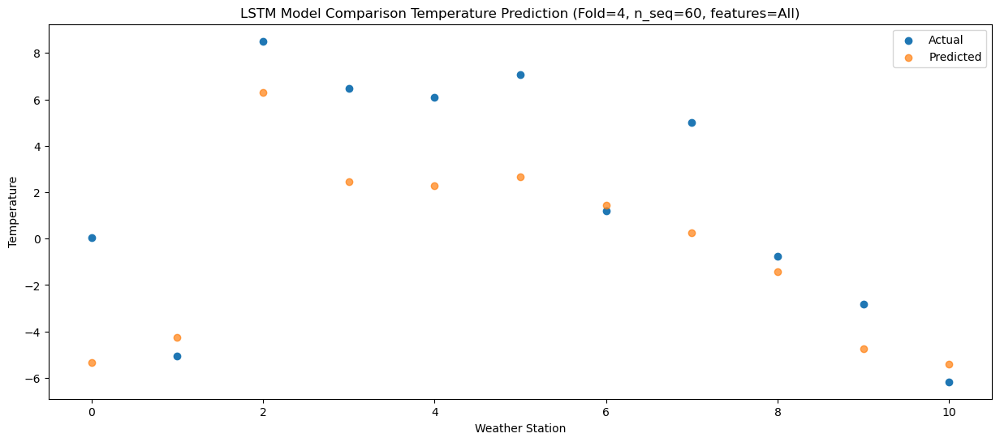

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.57  -2.159199
1                 1   -0.17  -1.081673
2                 2   10.74   9.495276
3                 3    8.88   5.634809
4                 4    8.66   5.462718
5                 5    9.67   5.832755
6                 6    4.99   4.620638
7                 7    7.43   3.421168
8                 8    3.67   1.772592
9                 9    1.32  -1.566878
10               10   -2.82  -2.223767


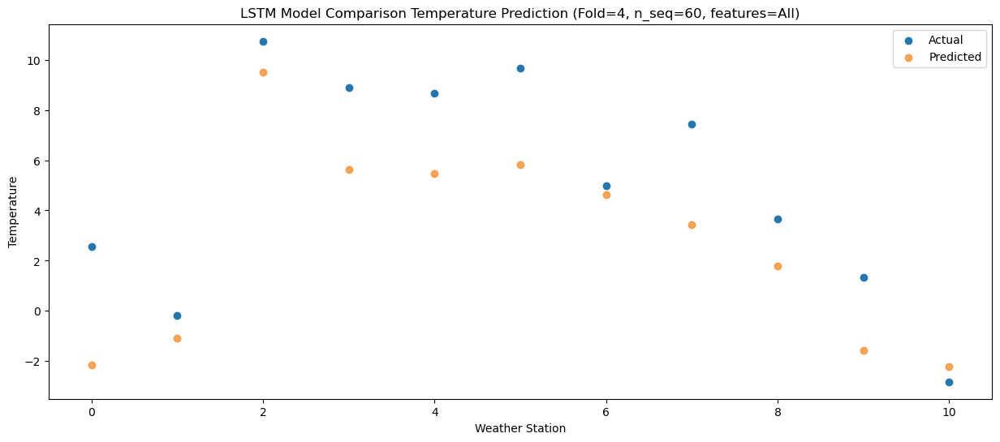

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    7.19   1.586731
1                 1    0.88   2.663021
2                 2   14.56  13.244411
3                 3   12.73   9.382566
4                 4   12.71   9.209669
5                 5   14.63   9.578197
6                 6    9.22   8.369979
7                 7   11.57   7.169371
8                 8    8.25   5.521700
9                 9    5.81   2.180324
10               10    2.90   1.524699


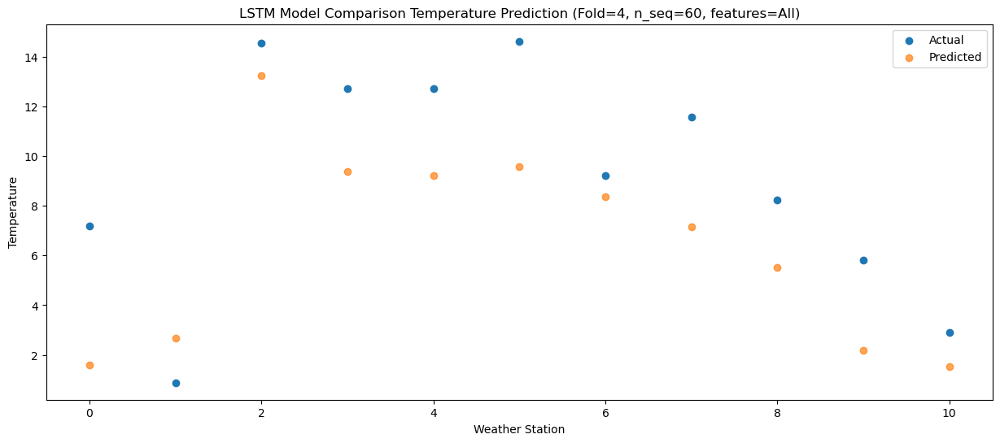

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   12.20   5.998104
1                 1    6.33   7.073934
2                 2   20.08  17.653024
3                 3   17.49  13.792039
4                 4   17.51  13.621339
5                 5   19.92  13.990558
6                 6   13.29  12.781446
7                 7   16.22  11.576466
8                 8   14.85   9.930364
9                 9   12.84   6.587871
10               10    9.00   5.936381


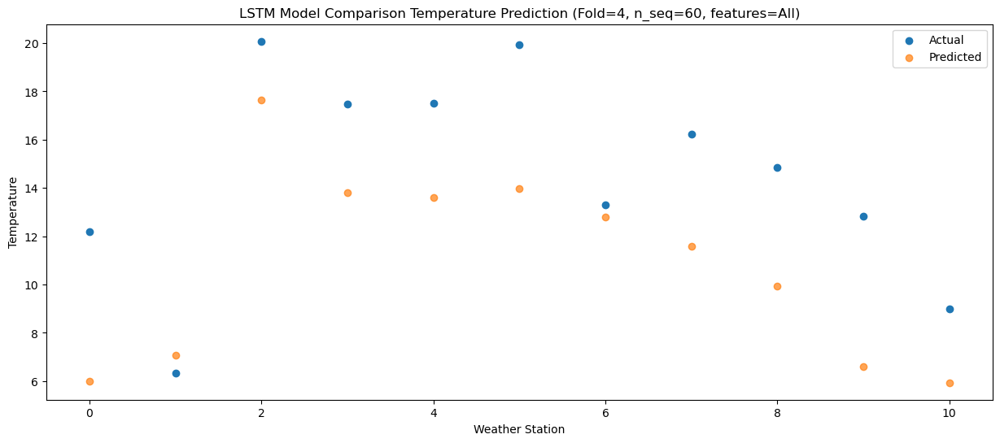

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.39   9.897310
1                 1    6.98  10.972093
2                 2   22.71  21.548676
3                 3   21.52  17.684194
4                 4   21.96  17.514240
5                 5   23.93  17.884337
6                 6   16.71  16.675767
7                 7   19.94  15.470234
8                 8   18.21  13.824273
9                 9   16.81  10.483938
10               10   12.16   9.837008


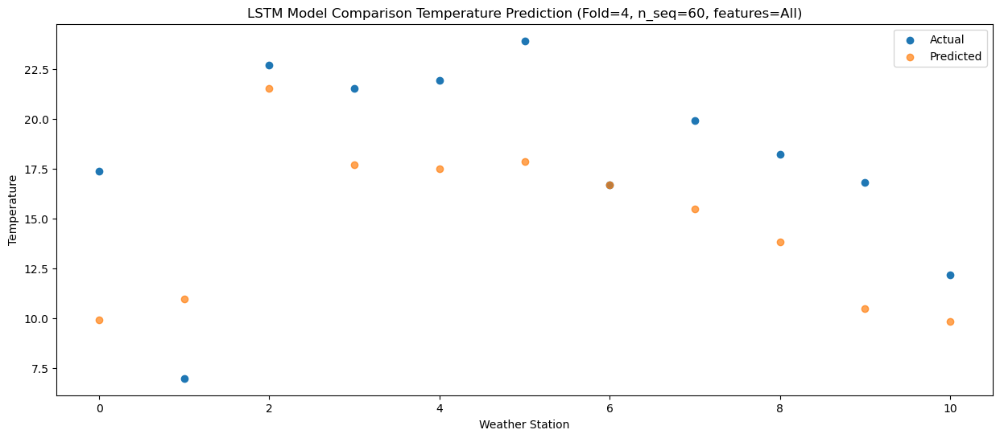

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   18.15  11.038715
1                 1    7.67  12.099798
2                 2   23.73  22.677442
3                 3   22.42  18.821529
4                 4   22.67  18.660223
5                 5   22.76  19.036654
6                 6   18.17  17.815239
7                 7   20.24  16.609143
8                 8   18.22  14.963333
9                 9   15.84  11.623167
10               10   13.68  10.979759


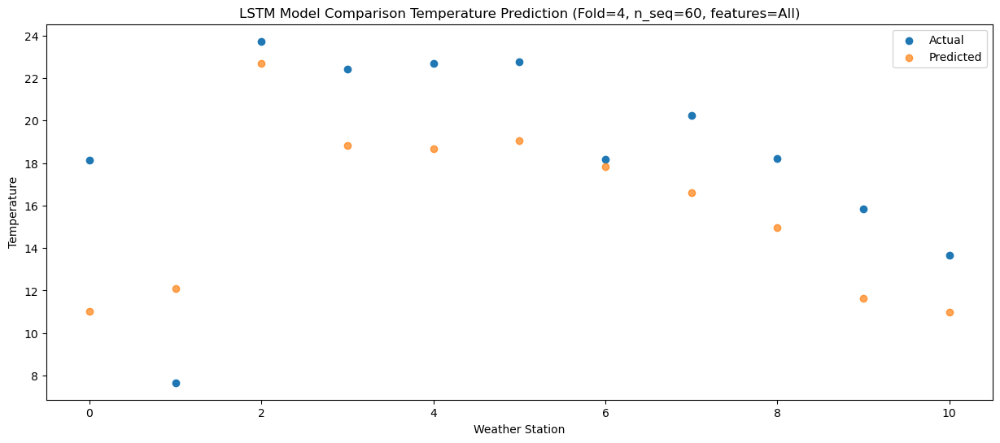

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   16.66  10.561953
1                 1    7.37  11.620516
2                 2   24.30  22.195719
3                 3   24.17  18.336691
4                 4   24.63  18.173913
5                 5   25.22  18.553717
6                 6   17.01  17.330130
7                 7   20.68  16.125852
8                 8   18.14  14.474264
9                 9   15.50  11.138188
10               10   12.54  10.494350


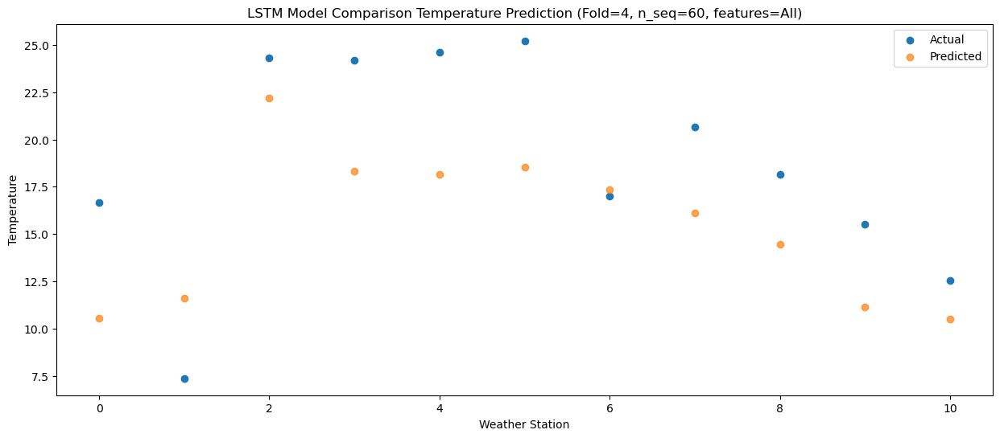

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.23   7.436634
1                 1    6.50   8.497278
2                 2   20.69  19.078741
3                 3   18.78  15.218691
4                 4   18.62  15.051113
5                 5   18.77  15.431646
6                 6   14.57  14.207209
7                 7   16.54  13.002878
8                 8   15.53  11.347605
9                 9   12.27   8.010790
10               10   10.27   7.362392


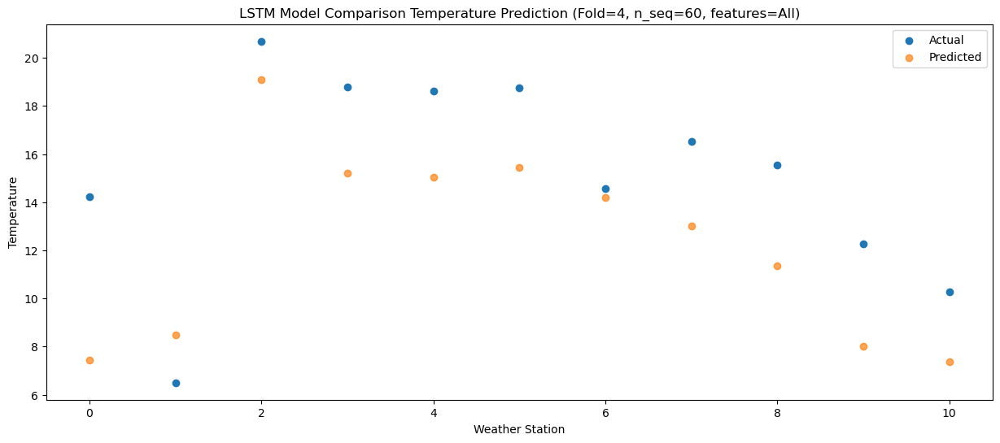

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   10.10   2.736099
1                 1    2.73   3.794805
2                 2   16.55  14.375037
3                 3   16.03  10.515236
4                 4   16.20  10.346644
5                 5   17.06  10.732557
6                 6    8.95   9.504019
7                 7   12.86   8.297159
8                 8    9.60   6.637670
9                 9    7.20   3.300841
10               10    3.80   2.651056


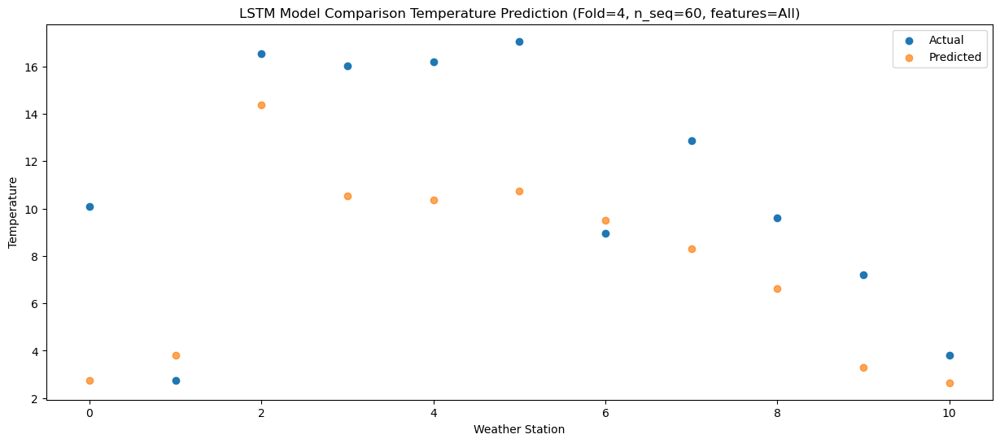

f, t:
[[ -2.86  -2.38   6.75   4.23   3.65   5.12   0.86   2.01  -2.64  -4.88
   -6.79]
 [ -4.52  -2.56   6.81   2.58   1.87   3.48   0.51   1.2   -3.46  -5.2
   -7.57]
 [ -7.48  -4.02   6.62   2.82   2.49   2.75   0.34  -0.45  -4.39  -7.64
   -8.77]
 [ -6.37  -2.47   6.88   2.49   2.11   1.99   0.81   0.12  -5.22  -7.89
   -9.58]
 [  1.16   1.6   14.68   9.95   9.99   9.55   6.42   7.05   1.6   -0.29
   -3.42]
 [  3.59   3.28  13.73  10.61  10.68  12.52   7.69   8.63   4.59   2.82
   -2.04]
 [  8.66   4.68  17.61  15.74  16.33  19.09  10.48  12.73  10.17   8.7
    4.7 ]
 [ 17.91   6.44  21.7   20.7   21.04  22.42  15.07  19.08  17.46  16.43
   11.19]
 [ 18.72   6.76  23.27  22.56  23.48  25.25  18.11  21.62  19.5   17.64
   14.63]
 [ 16.62   6.61  22.44  22.31  22.8   24.63  16.91  19.63  17.3   15.04
   12.22]
 [ 11.78   6.03  20.34  16.53  16.5   16.9   13.11  16.05  13.54  11.14
    8.23]
 [  3.73   4.53  15.    10.8   10.75  12.94   9.29   9.12   6.7    3.8
    2.07]
 [  1.54   1.

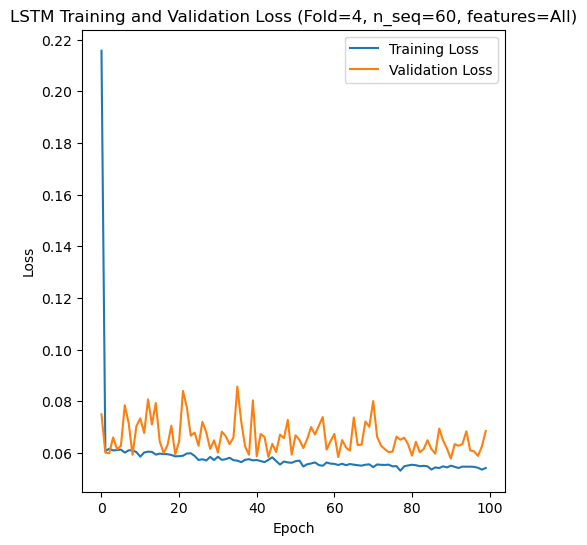

[[3.3485404094964295], [2.942426129146567], [3.1210794005874556], [3.9763831626218717], [2.951987086535728]]
[[array(3.34854041)], [array(2.94242613)], [array(3.1210794)], [array(3.97638316)], [array(2.95198709)]]
[[2.6798882651058116], [2.3984109162679217], [2.4693797082618794], [3.1089012979666375], [2.382429241869936]]
[[1.1295515688360303], [0.877933377997371], [1.4057420699168668], [1.911779091556908], [0.7992405960466554]]
[[0.8198602357774482], [0.8659554286952851], [0.8630580820751804], [0.8199452762373548], [0.8949277489948437]]
[[array(-0.02469584)], [array(0.34770709)], [array(-0.22369007)], [array(1.09244734)], [array(0.52242235)]]
[[array(0.91017874)], [array(0.89591837)], [array(0.88793631)], [array(0.85875554)], [array(0.92624996)]]
[-2.98 -3.45 -3.72 ... 12.54 10.27  3.8 ]
[-3.19031998 -4.43344637 -5.22373786 ... 10.49435033  7.36239232
  2.65105571]
Accuracy Results:
RMSE for each fold:
[[3.3485404094964295], [2.942426129146567], [3.1210794005874556], [3.97638316262187

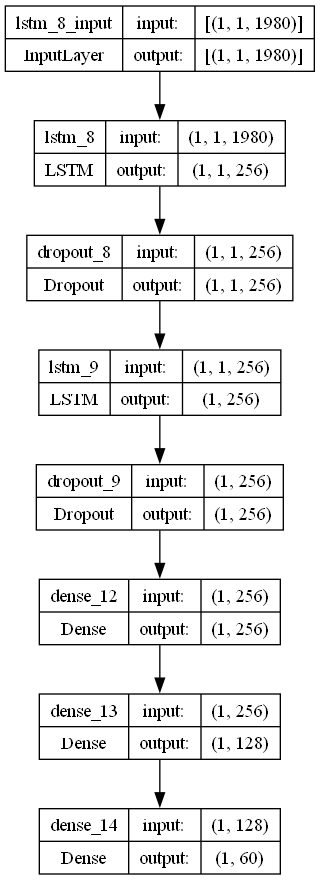

In [2]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def kmape (y_true, y_pred):
    return K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def kpearson (y_true, y_pred):
    mean_true = K.mean(y_true)
    mean_pred = K.mean(y_pred)
    return (K.square(K.mean((y_true - mean_true)*(y_pred - mean_pred))))/(K.mean(K.square(y_true - mean_true))*K.mean(K.square(y_pred - mean_pred)))

# fit best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from best model
    lr = 0.057985701700996824
    optimizer = SGD(learning_rate = lr)
    activation_function = 'sigmoid'
    lstm_units = 256
    dropout_rate = 0.2304602014121111

    # design network
    model = Sequential()
    #model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# Evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(actual, forecasts, n_lag, n_seq):

    t = np.array(actual).transpose()
    f = np.array(forecasts).transpose()

    print("f, t:")
    print(t)
    print(f)
    rmse_list = []
    mae_list = []
    skmape_list = []
    mape_list = []
    r2_list = []
    pearson_list = []
    actual_list = []

    for i in range(n_seq):
        act = [row for row in t[i]]
        predicted = [forecast for forecast in f[i]]
        rmse1 = sqrt(mean_squared_error(act, predicted))
        rmse2 = np.array(rmse(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        mae = mean_absolute_error(act, predicted)
        mse = mean_squared_error(act, predicted)
        skmape = mean_absolute_percentage_error(act, predicted)
        kmape1 = np.array(kmape(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        kpearson1 = np.array(kpearson(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        r2 = r2_score(act, predicted) 
        avg_actual = np.mean(act)
        print("Year at t+"+str(i+1)+":")
        print('t+%d SKRMSE: %f' % ((i+1), rmse1))
        print('t+%d KRMSE: %f' % ((i+1), rmse2))        
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d SKMAPE: %f' % ((i+1), skmape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))
        print('t+%d KMAPE: %f' % ((i+1), kmape1))
        print('t+%d PEARSON: %f' % ((i+1), kpearson1))
        print('t+%d AVERAGE ACTUAL: %f' % ((i+1), avg_actual))

    y_true = tf.convert_to_tensor(np.array(actual).flatten())
    y_pred = tf.convert_to_tensor(np.array(forecasts).flatten())

    rmse1 = sqrt(mean_squared_error(np.array(y_true), np.array(y_pred)))
    rmse2 = np.array(rmse(y_true, y_pred))
    mae = mean_absolute_error(np.array(y_true), np.array(y_pred))
    mse = mean_squared_error(np.array(y_true), np.array(y_pred))
    skmape = mean_absolute_percentage_error(np.array(y_true), np.array(y_pred))
    kmape1 = np.array(kmape(y_true, y_pred))
    kpearson1 = np.array(kpearson(y_true, y_pred))
    r2 = r2_score(np.array(y_true), np.array(y_pred)) 
    avg_actual = np.mean(np.array(y_true))
    rmse1_list.append(rmse1)
    rmse2_list.append(rmse2)
    mae_list.append(mae)
    skmape_list.append(skmape)
    pearson_list.append(kpearson1)
    mape_list.append(kmape1)
    r2_list.append(r2)
    actual_list.append(avg_actual)
    print("Metrics for this Fold:")
    print('SKRMSE: %f' % (rmse1))
    print('KRMSE: %f' % (rmse2))        
    print('MAE: %f' % (mae))
    print('SKMAPE: %f' % (skmape))
    print('R2_SCORE: %f' % (r2))
    print('KMAPE: %f' % (kmape1))
    print('PEARSON: %f' % (kpearson1))
    print('AVERAGE ACTUAL: %f' % (avg_actual))

    return rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, actual, n_test, n_seq, n_lag):
    # Plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # Plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Temperature")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse1_avg_list = []
rmse2_avg_list = []
mae_avg_list = []
skmape_avg_list = []
r2_score_avg_list = []
mape_avg_list = []
pearson_avg_list = []
actual_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]
    
    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    print(dataset)

    series = pd.Series(dataset[:, 0]) # Using first column (temperatures)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))
    
    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test, n_seq)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    print(results_df)
    
    print("Actual and Forecasts:")
    print(actual)
    print(forecasts)
    
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        actual_ws = actual[j]
        
        plot_forecasts(series_ws, forecasts_ws, actual_ws, n_test, n_seq, n_lag)

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)

        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='LSTM Model Comparison Temperature Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=All)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Temperature')
        plt.legend()
        plt.show()

    rmse1_list = [] # list stores sklearn's root mean squared errors for each future time prediction
    rmse2_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores mean absolute errors for each future time prediction
    skmape_list = [] # list stores sklearn's mean squared percentage errors for each future time prediction
    r2_list = [] # list stores sklearn's r2 pearson values for each future time prediction
    mape_list = [] # list stores mean squared percentage errors for each future time prediction
    pearson_list = [] # list stores r2 pearson values for each future time prediction
    actual_list = [] # list stores average actual values for each future time prediction

    # evaluate forecasts
    rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse1_avg_list.append(rmse1_list)
    rmse2_avg_list.append(rmse2_list)
    mae_avg_list.append(mae_list)
    skmape_avg_list.append(skmape_list)
    r2_score_avg_list.append(r2_list)
    mape_avg_list.append(mape_list)
    pearson_avg_list.append(pearson_list)
    actual_avg_list.append(actual_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)
            
    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=All)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse1_avg_list)
print(rmse2_avg_list)
print(mae_avg_list)
print(skmape_avg_list)
print(r2_score_avg_list)
print(mape_avg_list)
print(pearson_avg_list)
print(np.array(actual_results).flatten())
print(np.array(forecast_results).flatten())
a2 = np.array(actual_results).flatten()
f2 = np.array(forecast_results).flatten()
p1 = np.array(pearson(tf.convert_to_tensor(a2), tf.convert_to_tensor(f2)))
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse1_avg_list)
print("Average SKRMSE:"+str(np.mean(rmse1_avg_list)))
print("Average KRMSE:"+str(np.mean(rmse2_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average SKMAPE:"+str(np.mean(skmape_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average PEARSON:"+str(p1))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "lstm_model_optimized_CV_S60.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)